In [2]:
import numpy as np
from matplotlib import pyplot as plt
from numba import njit, prange
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import matplotlib as mpl
import pandas as pd
from sklearn.multiclass import OneVsRestClassifier as classifier
from sklearn.svm import SVC
from xgboost import XGBClassifier
from sklearn.preprocessing import MultiLabelBinarizer, LabelBinarizer
from sklearn.metrics import log_loss, roc_curve
import optuna
import matplotlib.colors as mcolors
from sklearn.cluster import AgglomerativeClustering as clustering
import umap 
from sklearn.preprocessing import StandardScaler
import networkx as nx
from pptx import Presentation
from pptx.util import Inches
import cairosvg
import plotly.express as px
import seaborn as sns
import warnings
from scipy.stats import pearsonr, linregress
from lifelines import CoxPHFitter
warnings.filterwarnings("ignore", "is_categorical_dtype")
warnings.filterwarnings("ignore", "use_inf_as_na")
import plotly.graph_objects as go

plt.rcParams['font.family'] = 'arial'
plt.rcParams['font.size'] = 20
plt.rcParams["text.usetex"] = False
base_filepath = "/Users/44749/Documents/PhD_work/datasets_for_analysis/"

Here, load simulations, and train a classifier to predict the 'scenario' (combination of selection strength, mutation rate, and heritability) belonging to each simulation. First, define the individual functions required:

In [2]:
#load data and binarise labels

#Binarise the labels corresponding to each 'scenario'.
def manual_label_conversion(ys, all_labels_in_order):
    num_samples, num_scen = len(ys), len(all_labels_in_order)
    bin_labels = np.zeros((num_samples, num_scen), dtype=np.int8)
    for s in range(num_samples):
        position = np.where(all_labels_in_order==ys[s])[0] #position of label in list
        bin_labels[s][position] = 1
    return bin_labels
    

#Define tr
def tt_split(X_tt, y_tt, test_size=0.5):
    #now take out the train/test split
    X_train, X_test, y_train, y_test = train_test_split(X_tt, y_tt, test_size=test_size)
    return X_train, X_test, y_train, y_test



#Create a binary classifier designed to answer the 'yes/no' question of whether a simulation arose from scenario i.
def classify_on_class(i, X_train, y_train_bin, objective='binary:logistic', max_depth=5, eta=0.3, reg_lambda=1, colsample_by_tree=0.5):
    #balance dataset- choose indices
    examples = np.where(y_train_bin[:, i] == 1)[0]
    counterexamples = np.where(y_train_bin[:, i] == 0)[0]
    #choose a random number of these to balance it
    chosen_counterexamples = counterexamples[np.random.choice(len(counterexamples), size=len(examples), replace=False)]
    all_indices = np.concatenate((examples, chosen_counterexamples))
    clf = xgb.XGBClassifier(objective=objective, max_depth=max_depth, eta=eta, reg_lambda=reg_lambda, colsample_bytree=colsample_by_tree)
    clf.fit(X_train[all_indices], y_train_bin[all_indices, i])
    return clf

#As above, but taking more general hyperparameters.
def classify_on_class_with_params(i, X_train, y_train_bin, params):
    #balance dataset- choose indices
    examples = np.where(y_train_bin[:, i] == 1)[0]
    counterexamples = np.where(y_train_bin[:, i] == 0)[0]
    min_size = min(len(examples), len(counterexamples))
    if len(examples) > min_size: #if there are more examples than counterexamples, choose them at random
        examples = examples[np.random.choice(len(examples), size=min_size, replace=False)]
        chosen_counterexamples = counterexamples
    else:
        chosen_counterexamples = counterexamples[np.random.choice(len(counterexamples), size=len(examples), replace=False)]
    all_indices = np.concatenate((examples, chosen_counterexamples))
    clf = xgb.XGBClassifier(**params, importance_type='gain')
    clf.fit(X_train[all_indices], y_train_bin[all_indices, i])
    return clf, len(examples) #so we can calculate sample weights later


#return probabilities for all test examples
def predict_on_test_set(classifiers, X_test):
    y_predict_prob = np.zeros((len(X_test), len(classifiers)))
    for i, clf in enumerate(classifiers):
        y_predict_prob[:, i] = clf.predict_proba(X_test)[:, 1] #probability that it is in that class
    return y_predict_prob


#Assign outcomes and normalise multiclass predictions.
@njit(parallel=True)
def assign_outcomes(y_predict_prob):
    num_points, num_classes = y_predict_prob.shape
    assigned_outcomes = np.zeros(num_points)
    #assign classified outcomes
    for s in prange(num_points):
        y_predict_prob[s] /= np.sum(y_predict_prob[s]) #normalise prediction prob
        assigned_outcomes[s] = np.argmax(y_predict_prob[s])
    return assigned_outcomes, y_predict_prob

#Generate matrices for performance.
def generate_confusion_and_classification_matrices(y_predict_prob, y_test_bin):
    num_points, num_classes = y_test_bin.shape
    class_matrix = np.zeros((num_classes, num_classes))
    confusion_matrix = np.zeros((num_classes, num_classes))
    #assign outcomes and normalise predictions
    assigned_outcomes, y_predict_prob = assign_outcomes(y_predict_prob)
    #now assigned to matrix
    for i in range(num_classes):
        pos = np.where(y_test_bin[:, i]==1)[0]
        num_here = len(pos)
        if num_here > 0:
            for j in range(num_classes):
                class_matrix[i][j] = len(np.where(assigned_outcomes[pos]==j)[0])/num_here #number assigned as j
                confusion_matrix[i][j] = np.average(y_predict_prob[pos, j]) #probability assigned to j
    return assigned_outcomes, y_predict_prob, class_matrix, confusion_matrix

#put this all together and create an entire pipeline
#with custom parameters
#also return ROC-AUC curve for each class
def train_model_opt(X_train, X_test, y_train_bin, y_test_bin, all_labels_in_order, params):
    #train as many classifiers as classes
    num_classes = len(all_labels_in_order)
    classifiers = []
    for i in range(num_classes):
        clf, no_samples = classify_on_class_with_params(i, X_train, y_train_bin, params)
        classifiers.append(clf)
    y_predict_prob = predict_on_test_set(classifiers, X_test)
    #assign outcomes and create matrices
    assigned_outcomes, y_predict_prob, class_matrix, confusion_matrix = generate_confusion_and_classification_matrices(y_predict_prob, y_test_bin)
    fprs, tprs, all_threshes = [], [], []
    for i in range(num_classes):
        true_bin_labels = y_test_bin[:, i] 
        predict_prob = y_predict_prob[:, i]
        #artifically rebalance the dataset to test ROC
        true_pos, true_neg = np.where(true_bin_labels==1)[0], np.where(true_bin_labels==0)[0]
        num_true_pos, num_true_neg = len(true_pos), len(true_neg)
        #negatives will always outnumber positives but just in case
        if num_true_pos < num_true_neg:
            rand_neg = np.random.choice(num_true_neg, size=num_true_pos, replace=False) #choose indices of the same number of true negatives
            indices_chosen = np.concatenate((true_pos, true_neg[rand_neg]))
        else: #unlikely but sure
            rand_pos = np.random.choice(num_true_pos, size=num_true_neg, replace=False) #choose indices of the same number of true negatives
            indices_chosen = np.concatenate((true_neg, true_pos[rand_pos]))
        true_bin_labels, predict_prob = true_bin_labels[indices_chosen], predict_prob[indices_chosen]
        fpr, tpr, threshes = roc_curve(true_bin_labels, predict_prob)
        fprs.append(fpr)
        tprs.append(tpr)
        all_threshes.append(threshes) #this is post-normalisation
    return classifiers, assigned_outcomes, class_matrix, confusion_matrix, fprs, tprs, all_threshes
    



Now combine the above into a single set of functions which loads in all simulations and generates predictions on a test set.

In [27]:

#load, with a train test split
def load_data(no_samples, prefix="27Jul"):
    plast_levels = ["0.0", "0.5", "0.75", "0.9", "0.95", "0.98", "1.0", "gen"]
    sel_levels = ["nosel", "lowsel", "highsel"]
    mut_rates = [0.4, 0.6]
    all_file_names = []
    all_labels = []
    for mut in mut_rates:
        for sel in sel_levels:
            for plast in plast_levels:
                if plast == "gen" or sel != "nosel":
                    all_file_names.append(prefix + "_" + plast + "_" + str(mut) + "_" + sel)
                    all_labels.append(plast + "_" + str(mut) + "_" + sel)
    print(all_file_names)
    Xs, ys = np.array([]), np.array([])
    for filename, label in zip(all_file_names, all_labels):
        stats = np.load(base_filepath+filename+"_"+str(no_samples)+"_samples.npy", allow_pickle=True)
        labels = np.tile(label, (len(stats), 1))
        print(filename, label, len(stats))
        if len(Xs)==0:
            Xs = stats
            ys = labels
        else:
            Xs = np.concatenate((Xs, stats))
            ys = np.concatenate((ys, labels))
    #get a unique list of all the labels
    all_labels_in_order = np.unique(ys, axis=0)
    return Xs, ys, all_labels_in_order
    
def get_all_data(no_samples, valid_size=0.1, prefix="27Jul"):
    Xs, ys, all_labels_in_order =  load_data(no_samples, prefix=prefix)
    X_tt, X_valid, y_tt, y_valid = train_test_split(Xs, ys, test_size=valid_size)
    return X_tt, X_valid, y_tt, y_valid, all_labels_in_order

    

#run for 10 train/test splits, consider consistency of outcomes
def test_and_validate_full_problem(savename, no_samples, params, num_trials=10, test_size=0.2, valid_size=0.1, prefix="27Jul"):
    X_tt, X_valid, y_tt, y_valid, all_labels_in_order =  get_all_data(no_samples, valid_size=valid_size, prefix=prefix)
    y_tt_bin, y_valid_bin = manual_label_conversion(y_tt, all_labels_in_order), manual_label_conversion(y_valid, all_labels_in_order)
    stat_names = ["TMB", "TMB-priv"] + ["F"+str(s) for s in range(1, no_samples)]+ ["F-priv"] + ["A"+str(s) for s in range(2, no_samples+1)]
    overall_outcomes_assigned = []
    total_importances = []
    #save the validation set, since these are the relative values you want to test
    np.save(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_X_valid.npy", X_valid)
    np.save(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_y_valid.npy", y_valid)
    for no_trial in range(num_trials):
        X_train, X_test, y_train, y_test = tt_split(X_tt, y_tt_bin, test_size=test_size) #split a different way, keeping validation set
        classifiers, assigned_outcomes, class_matrix, confusion_matrix, fprs, tprs, all_threshes = train_model_opt(X_train, X_test, y_train, y_test, all_labels_in_order, params)
        y_pred_valid = predict_on_test_set(classifiers, X_valid)
        valid_assigned_outcomes, y_pred_valid_norm = assign_outcomes(y_pred_valid) #normalise predictions and make classifications
        overall_outcomes_assigned.append(valid_assigned_outcomes) #these should all be the same
        np.save(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_trial_"+str(no_trial)+"_rocs_per_class.npy", np.array([fprs, tprs, all_threshes], dtype=object))
        np.save(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_trial_"+str(no_trial)+"_matrices.npy", [class_matrix, confusion_matrix])
        all_importances = []
        for label, clf in zip(all_labels_in_order[:, 0], classifiers):
            importances = clf.feature_importances_
            all_importances.append(importances)
        total_importances.append(all_importances)
    num_valid_points, num_classes = y_valid_bin.shape
    y_as_number = np.array([np.where(y_valid_bin[n]==1)[0][0] for n in range(num_valid_points)])
    return y_as_number, overall_outcomes_assigned, all_labels_in_order, total_importances
    

Run this pipeline on all simulated tumours, varying the number of samples available from 2 to 8.

In [4]:
def train_classifiers(savename, no_samples, params= {'learning_rate': 0.2, 'max_depth': 3, 'subsample': 0.6, 'colsample_bytree': 0.8, 'min_child_weight': 1, 'reg_alpha': 0.1, 'reg_lambda': 1, 'gamma': 0.5, 'n_estimators': 100}, num_trials=10, test_size=0.2, valid_size=0.1):
    y_as_number, overall_outcomes_assigned, all_labels_in_order, total_importances = test_and_validate_full_problem(savename, no_samples, params, num_trials=num_trials, test_size=test_size, valid_size=valid_size)
    np.save(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_y_as_number.npy", y_as_number) #numerical labels
    np.save(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_overall_outcomes_assigned.npy", np.array(overall_outcomes_assigned)) #results of classification
    np.save(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_all_labels_in_order.npy", all_labels_in_order) 
    np.save(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_total_importances.npy", np.array(total_importances)) #all importances across runs

#trial this for all sample numbers
for no_samples in range(2, 9):
    train_classifiers("1Aug", no_samples)
    

['27Jul_gen_0.4_nosel', '27Jul_0.0_0.4_lowsel', '27Jul_0.5_0.4_lowsel', '27Jul_0.75_0.4_lowsel', '27Jul_0.9_0.4_lowsel', '27Jul_0.95_0.4_lowsel', '27Jul_0.98_0.4_lowsel', '27Jul_1.0_0.4_lowsel', '27Jul_gen_0.4_lowsel', '27Jul_0.0_0.4_highsel', '27Jul_0.5_0.4_highsel', '27Jul_0.75_0.4_highsel', '27Jul_0.9_0.4_highsel', '27Jul_0.95_0.4_highsel', '27Jul_0.98_0.4_highsel', '27Jul_1.0_0.4_highsel', '27Jul_gen_0.4_highsel', '27Jul_gen_0.6_nosel', '27Jul_0.0_0.6_lowsel', '27Jul_0.5_0.6_lowsel', '27Jul_0.75_0.6_lowsel', '27Jul_0.9_0.6_lowsel', '27Jul_0.95_0.6_lowsel', '27Jul_0.98_0.6_lowsel', '27Jul_1.0_0.6_lowsel', '27Jul_gen_0.6_lowsel', '27Jul_0.0_0.6_highsel', '27Jul_0.5_0.6_highsel', '27Jul_0.75_0.6_highsel', '27Jul_0.9_0.6_highsel', '27Jul_0.95_0.6_highsel', '27Jul_0.98_0.6_highsel', '27Jul_1.0_0.6_highsel', '27Jul_gen_0.6_highsel']
27Jul_gen_0.4_nosel gen_0.4_nosel 5000
27Jul_0.0_0.4_lowsel 0.0_0.4_lowsel 5000
27Jul_0.5_0.4_lowsel 0.5_0.4_lowsel 4992
27Jul_0.75_0.4_lowsel 0.75_0.4_lowse

(10, 16799)


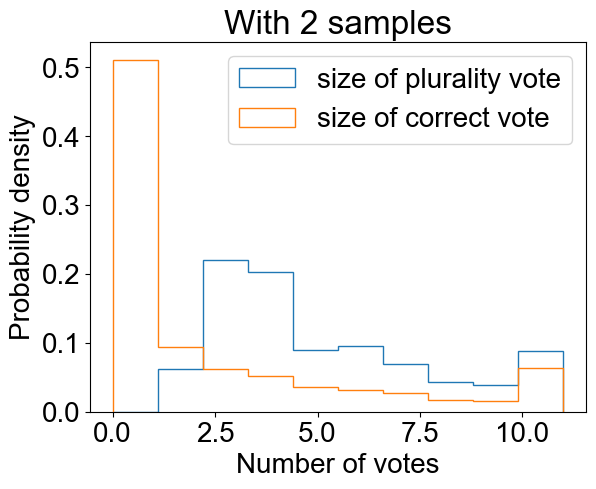

Fraction of validation set which is consistently assigned any outcome 0.0971486397999881
Fraction of validation set which is consistently assigned the correct outcome 0.06964700279778559
(10, 16800)


<Figure size 640x480 with 0 Axes>

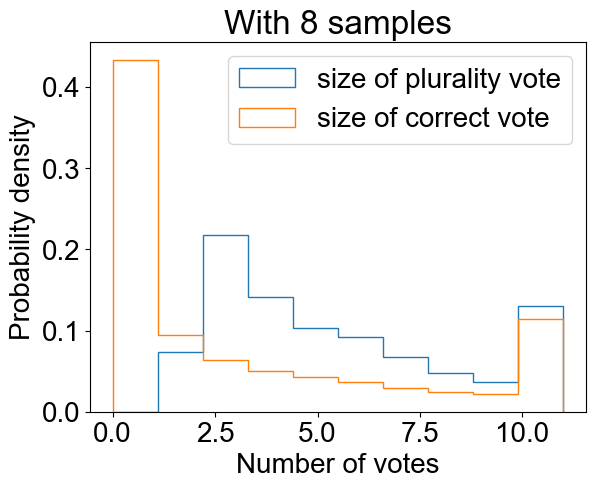

Fraction of validation set which is consistently assigned any outcome 0.14297619047619048
Fraction of validation set which is consistently assigned the correct outcome 0.12517857142857142


<Figure size 640x480 with 0 Axes>

In [24]:
def check_consistency_of_assignment(savename, no_samples):
    y_as_number = np.load(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_y_as_number.npy", allow_pickle=True)
    overall_outcomes_assigned = np.load(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_overall_outcomes_assigned.npy", allow_pickle=True)
    print(overall_outcomes_assigned.shape)
    
    #convert all of these to numerical labels
    num_valid_points, num_classes = len(y_as_number), max(y_as_number)+1
    num_trials = len(overall_outcomes_assigned)

    #y_as_number = np.array([np.where(y_valid_bin[n]==1)[0] for n in range(num_valid_points)])
    
    #count, for every point, the highest number of votes for any single classification
    plurality_votes = np.zeros(num_valid_points)
    correct_counts = np.zeros(num_valid_points)
    for n in range(num_valid_points):
        outcomes_here = [overall_outcomes_assigned[m][n] for m in range(num_trials)]
        vals, counts = np.unique(outcomes_here, return_counts=True)
        plurality_votes[n] = max(counts)
        where_correct = np.where(vals==y_as_number[n])[0]
        if len(where_correct)==1: #if the correct value has been assigned even once
            correct_counts[n] = counts[where_correct[0]]
        #otherwise it's just set to zero
    
    #count, for every point, the highest number of votes for the correct classification
    fig, ax = plt.subplots()
    ax.hist(plurality_votes, bins=10, range=(0, num_trials+1), histtype='step', density=True, label='size of plurality vote')
    ax.hist(correct_counts, bins=10, range=(0, num_trials+1), histtype='step', density=True, label='size of correct vote')
    plt.xlabel("Number of votes")
    plt.ylabel("Probability density")
    plt.title("With "+str(no_samples) +" samples")
    plt.legend()
    plt.show()
    fig.savefig(base_filepath+"/figs_0512"+"/"+savename+"_samples_"+str(no_samples)+"_consistency_plot.png", dpi=300)
    plt.clf()
    
    
    fraction_consistent = len(np.where(plurality_votes==num_trials)[0])/num_valid_points
    fraction_consistent_and_correct = len(np.where(correct_counts==num_trials)[0])/num_valid_points
    
    print("Fraction of validation set which is consistently assigned any outcome", fraction_consistent)
    print("Fraction of validation set which is consistently assigned the correct outcome", fraction_consistent_and_correct)
    
#trial this for all sample numbers
for no_samples in [2, 8]:
    check_consistency_of_assignment("1Aug", no_samples)
    


Plot the importance matrices.

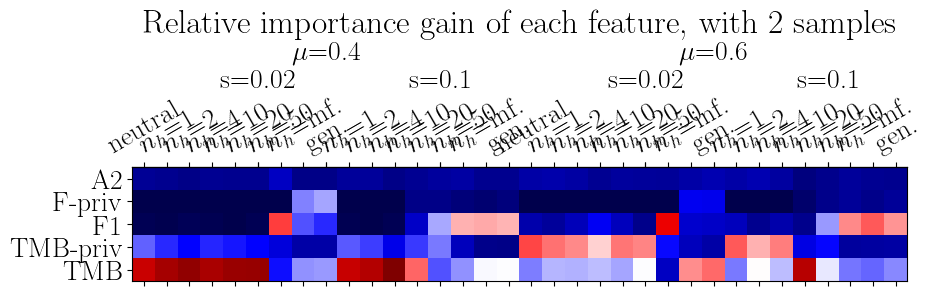

<Figure size 640x480 with 0 Axes>

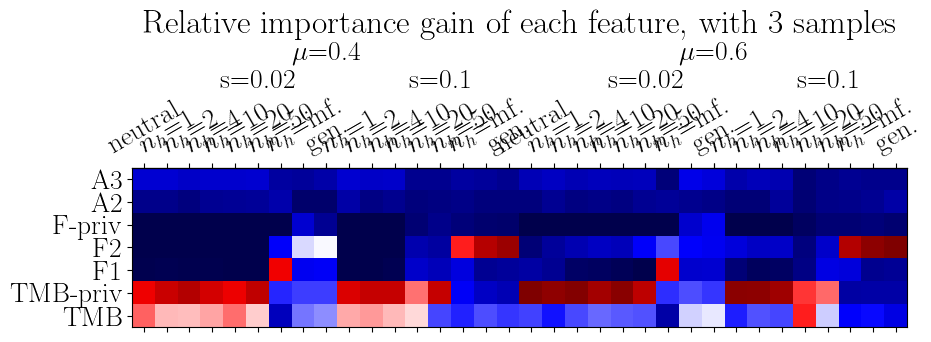

<Figure size 640x480 with 0 Axes>

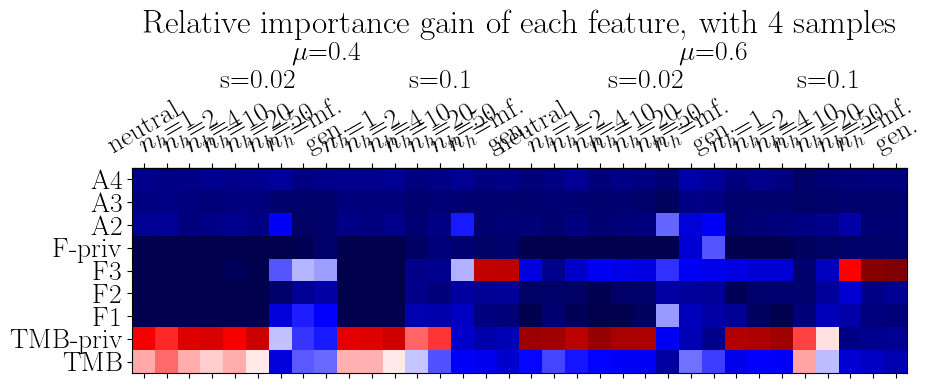

<Figure size 640x480 with 0 Axes>

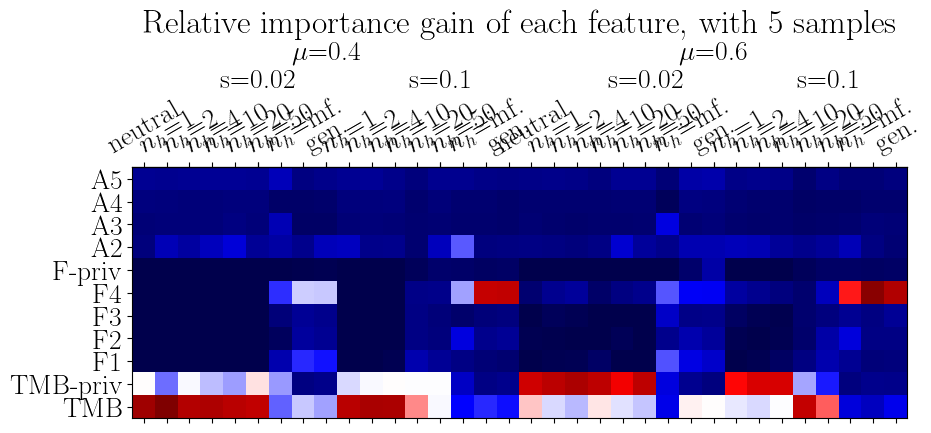

<Figure size 640x480 with 0 Axes>

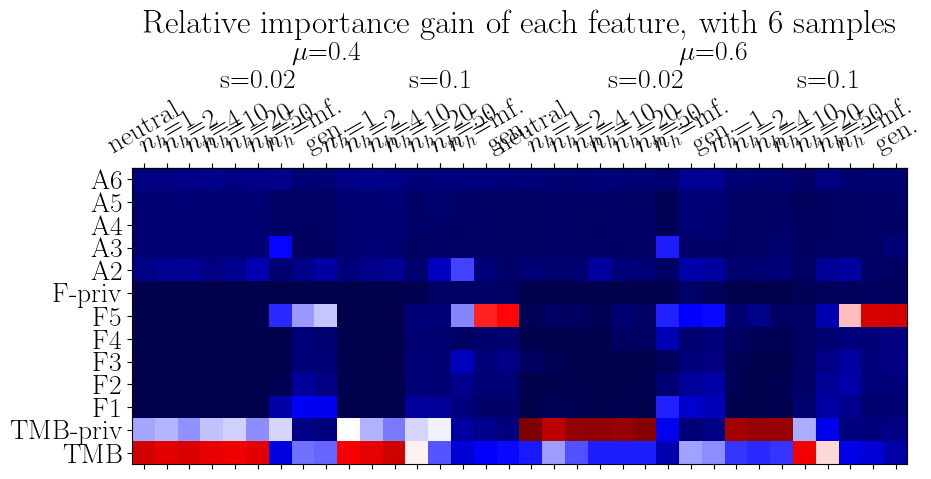

<Figure size 640x480 with 0 Axes>

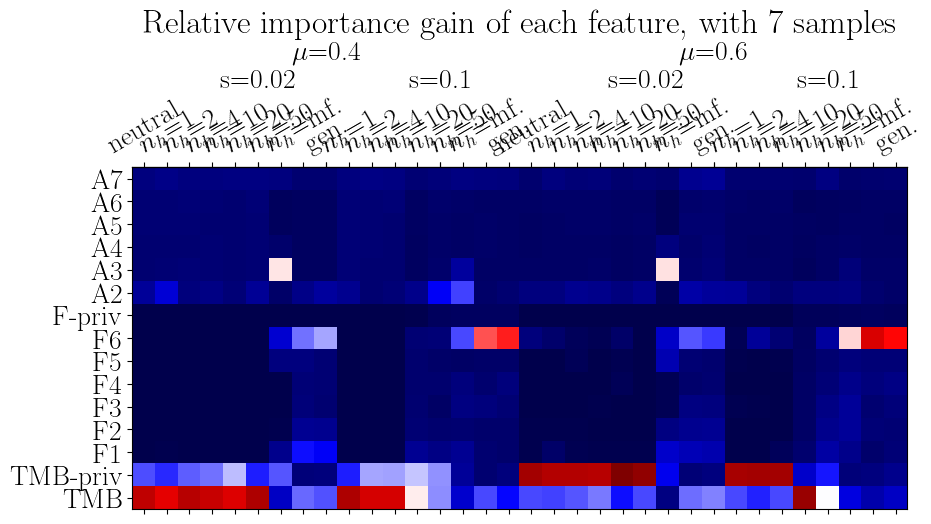

<Figure size 640x480 with 0 Axes>

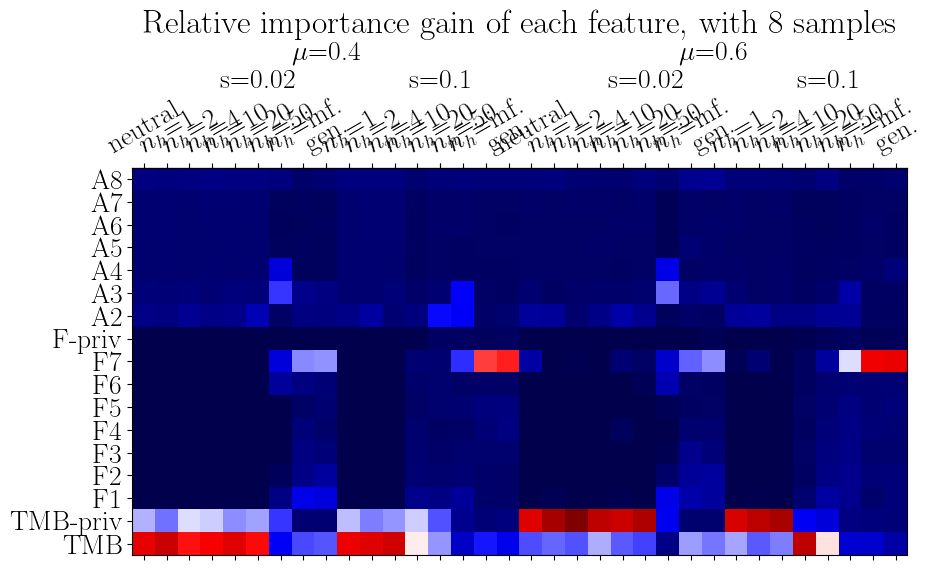

<Figure size 640x480 with 0 Axes>

In [6]:
def plot_importances_individual_scen(savename, no_samples, level_mut = 70, level_sel = 50):

    all_labels_in_order = np.load(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_all_labels_in_order.npy", allow_pickle=True)
    total_importances = np.load(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_total_importances.npy", allow_pickle=True)
    num_runs, num_groups, num_features = total_importances.shape
    
    stat_names = ["TMB", "TMB-priv"] + ["F"+str(s) for s in range(1, no_samples)]+ ["F-priv"] + ["A"+str(s) for s in range(2, no_samples+1)]

    #this is averaged across groups
    importance_matrix = np.zeros((num_features, num_groups))
    for n in range(num_groups):
        for m in range(num_features):
            importance_matrix[m][n] = np.average(total_importances[:, n, m])
        importance_matrix[:, n] /= np.sum(importance_matrix[:, n])

    #rearrange scenarios:
    plast_levels = ["0.0", "0.5", "0.75", "0.9", "0.95", "0.98", "1.0", "gen"]
    sel_levels = ["nosel", "lowsel", "highsel"]
    mut_rates = [0.4, 0.6]
    ordered_labels = []
    for mut in mut_rates:
        for sel in sel_levels:
            for plast in plast_levels:
                if plast == "gen" or sel != "nosel":
                    ordered_labels.append(plast + "_" + str(mut) + "_" + sel)
                    
    rearranged_importance_matrix = np.zeros((num_features, num_groups))
    for n, label in enumerate(ordered_labels):
        for m, label_ in enumerate(all_labels_in_order[:, 0]):
            if label_ == label:
                rearranged_importance_matrix[:, n] = importance_matrix[:, m]

    plast_labels_for_plot = ["neutral", 
                "$n_h$"+"=1", "$n_h$"+"=2", "$n_h$"+"=4", "$n_h$"+"=10", "$n_h$"+"=20","$n_h$"+"=50", "$n_h$"+"=inf.", "gen.",
               "$n_h$"+"=1", "$n_h$"+"=2", "$n_h$"+"=4", "$n_h$"+"=10", "$n_h$"+"=20","$n_h$"+"=50", "$n_h$"+"=inf.", "gen."]*2
    
    fig, ax = plt.subplots(figsize=(10, 10))
    ax.matshow(rearranged_importance_matrix, origin='lower', cmap=mpl.cm.seismic)
    ax.set_xticks(range(len(ordered_labels)), labels=plast_labels_for_plot, rotation=60)
    ax.set_yticks(range(len(stat_names)), labels=stat_names, rotation=0)
    ax2 =ax.secondary_xaxis(location='top')
    ax2.set_xticks([5, 13, 22, 30], labels=[ 's=0.02', 's=0.1',  's=0.02', 's=0.1'])
    #ax2.spines['top'].set_position(('outward', level_sel))
    ax2.tick_params(axis='x', which='major', pad=level_sel)
    ax3 = ax.secondary_xaxis(location='top')
    ax3.set_xticks([8, 25], labels=[ r'$\mu$'+"=0.4",  r'$\mu$'+"=0.6"])
    ax3.tick_params(axis='x', which='major', pad=level_mut)
    plt.xticks(rotation=30)
    ax.set_yticks(range(num_features), labels=stat_names)
    plt.title("Relative importance gain of each feature, with "+str(no_samples)+ " samples")
    fig.savefig(base_filepath+"/figs_0512"+"/"+savename+"_samples_"+str(no_samples)+"_importance_plot.png", dpi=300)
    plt.show()
    plt.clf()


for no_samples in range(2, 9):
    plot_importances_individual_scen("1Aug", no_samples)

Reliance on mutation rate true for neutral growth; reliance on fixed mutations more true for high selection, low plasticity growth; more intermediate forms of information (how many appear in 3 samples, etc) are used more as we have more samples. Fixed in M-1 samples tends to be most important to identifying low-plasticity tumours. Some categories have a fairly even informational reliance (light blue).

When M=2, number of mutations tends to be most important for low-sel/high-plast tumours. Reliance becomes heavier on fixed mutations as plasticity decreases + selection increases.


Below is the comparison heatmap: the relative *values* of each feature within each scenario, to compare with their importance. 

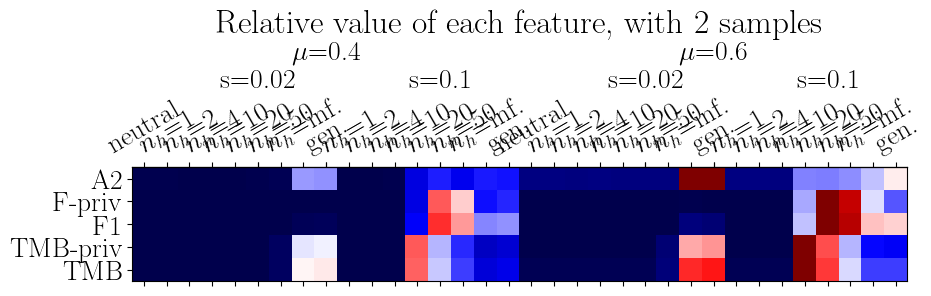

<Figure size 640x480 with 0 Axes>

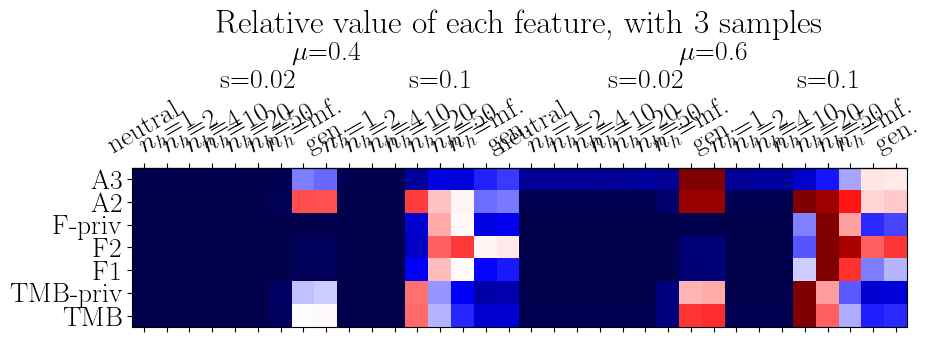

<Figure size 640x480 with 0 Axes>

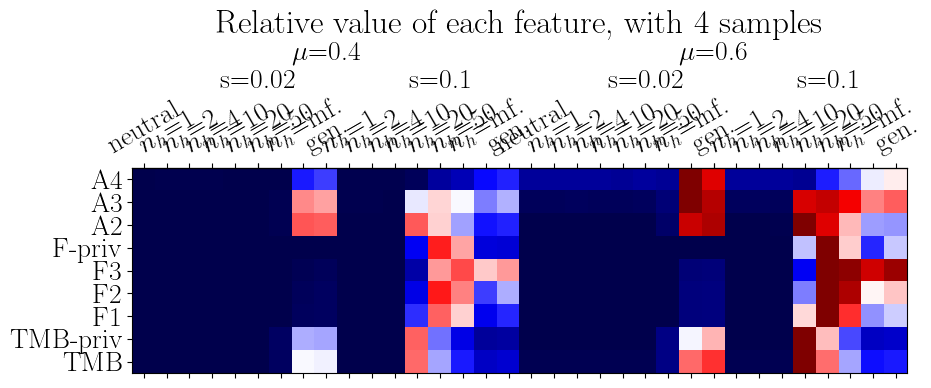

<Figure size 640x480 with 0 Axes>

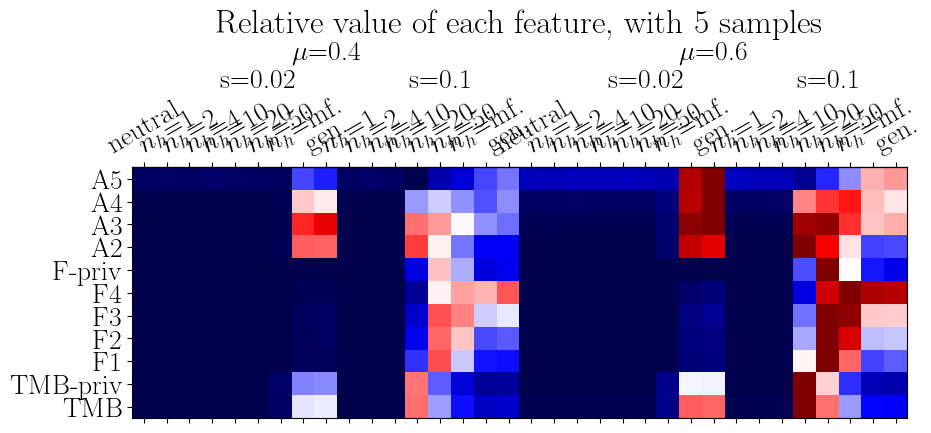

<Figure size 640x480 with 0 Axes>

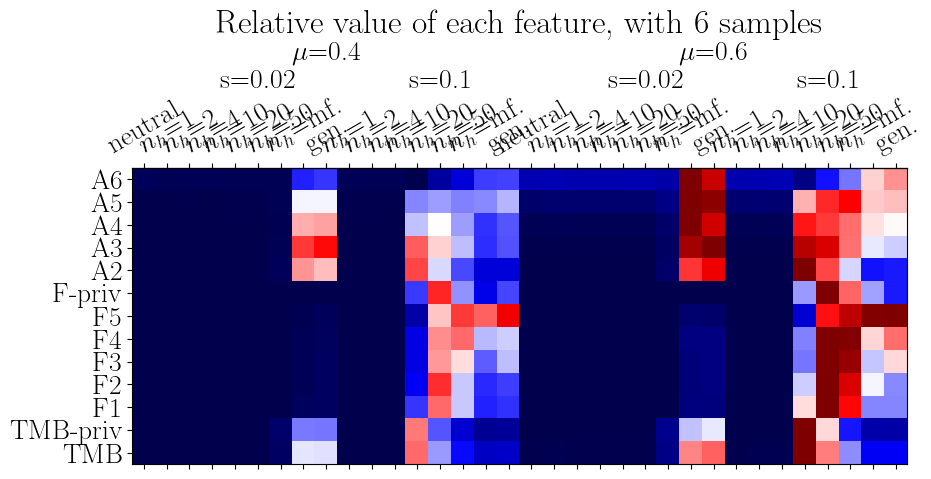

<Figure size 640x480 with 0 Axes>

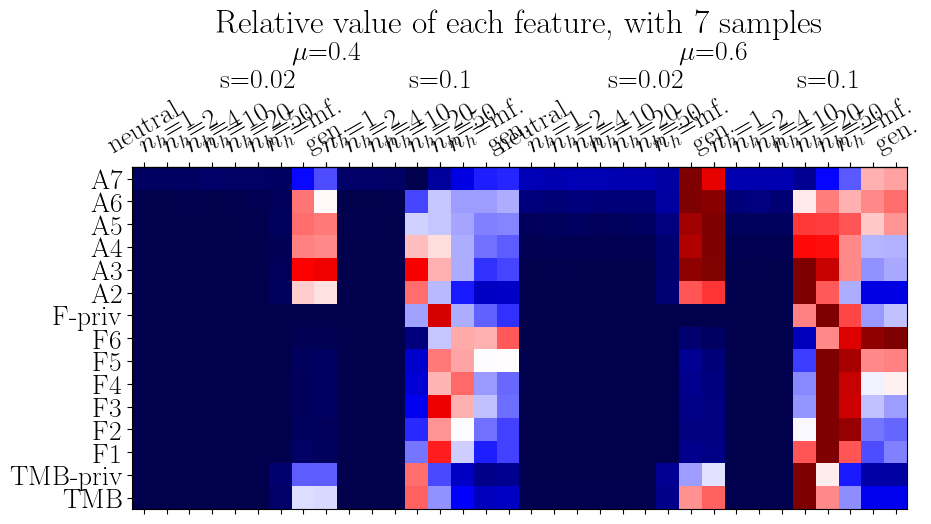

<Figure size 640x480 with 0 Axes>

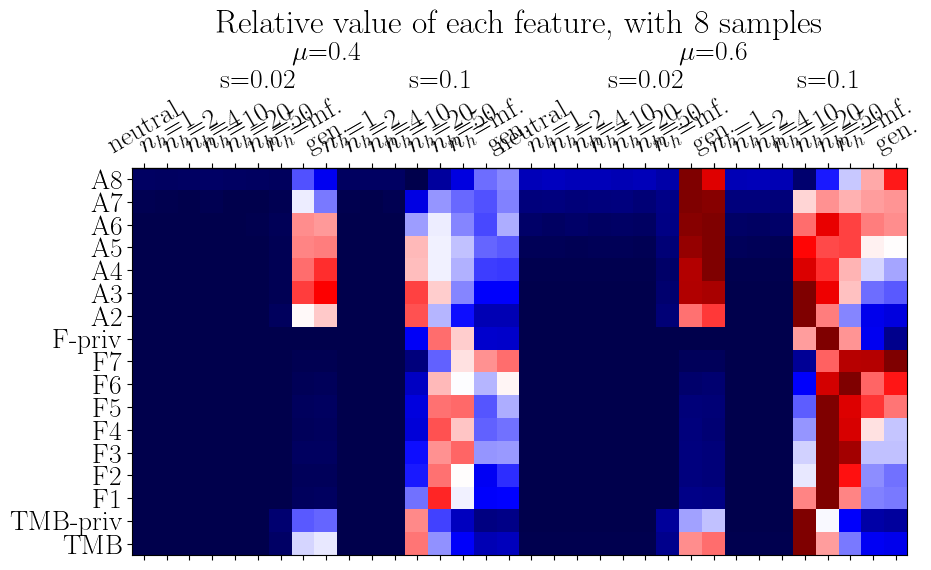

<Figure size 640x480 with 0 Axes>

In [7]:
def plot_relative_values_individual_scen(savename, no_samples, level_mut = 70, level_sel = 50):
    X_valid, y_valid = np.load(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_X_valid.npy", allow_pickle=True), np.load(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_y_valid.npy", allow_pickle=True)
    stat_names = ["TMB", "TMB-priv"] + ["F"+str(s) for s in range(1, no_samples)]+ ["F-priv"] + ["A"+str(s) for s in range(2, no_samples+1)]

    
    #rearrange scenarios:
    plast_levels = ["0.0", "0.5", "0.75", "0.9", "0.95", "0.98", "1.0", "gen"]
    sel_levels = ["nosel", "lowsel", "highsel"]
    mut_rates = [0.4, 0.6]
    ordered_labels = []
    for mut in mut_rates:
        for sel in sel_levels:
            for plast in plast_levels:
                if plast == "gen" or sel != "nosel":
                    ordered_labels.append(plast + "_" + str(mut) + "_" + sel)

    num_groups = len(ordered_labels)
    num_features = len(stat_names)

    value_matrix = np.zeros((len(stat_names), len(ordered_labels))) #initially this holds the average value of each sum stat for each scenario

    for m, label in enumerate(ordered_labels): #for each scenario
        indices = np.where(y_valid==label)[0] #find relevant stats
        rel_stats = X_valid[indices]
        for n in range(len(stat_names)):
            value_matrix[n][m] = np.average(rel_stats[:, n]) #the average of the nth summary statistic

    #now scale the averages across scenarios, to show their relative values
    #note that importance gain is normalised across STATISTICS for each SCENARIO
    #this is normalised across SCENARIOS for each statistic
    for n in range(len(stat_names)):
        rel_min, rel_max = np.min(value_matrix[n]), np.max(value_matrix[n])
        for m in range(len(ordered_labels)):
            value_matrix[n][m] = (value_matrix[n][m] - rel_min)/(rel_max-rel_min) #the scenario with the highest value summary stat has value 1 here, and min has value 0

    plast_labels_for_plot = ["neutral", 
                "$n_h$"+"=1", "$n_h$"+"=2", "$n_h$"+"=4", "$n_h$"+"=10", "$n_h$"+"=20","$n_h$"+"=50", "$n_h$"+"=inf.", "gen.",
               "$n_h$"+"=1", "$n_h$"+"=2", "$n_h$"+"=4", "$n_h$"+"=10", "$n_h$"+"=20","$n_h$"+"=50", "$n_h$"+"=inf.", "gen."]*2

    
    fig, ax = plt.subplots(figsize=(10, 10))
    ax.matshow(value_matrix, origin='lower', cmap=mpl.cm.seismic)
    ax.set_xticks(range(len(ordered_labels)), labels=plast_labels_for_plot, rotation=60)
    ax.set_yticks(range(len(stat_names)), labels=stat_names, rotation=0)
    ax2 =ax.secondary_xaxis(location='top')
    ax2.set_xticks([5, 13, 22, 30], labels=[ 's=0.02', 's=0.1',  's=0.02', 's=0.1'])
    #ax2.spines['top'].set_position(('outward', level_sel))
    ax2.tick_params(axis='x', which='major', pad=level_sel)
    ax3 = ax.secondary_xaxis(location='top')
    ax3.set_xticks([8, 25], labels=[ r'$\mu$'+"=0.4",  r'$\mu$'+"=0.6"])
    ax3.tick_params(axis='x', which='major', pad=level_mut)
    plt.xticks(rotation=30)
    ax.set_yticks(range(num_features), labels=stat_names)
    plt.title("Relative value of each feature, with "+str(no_samples)+ " samples")
    fig.savefig(base_filepath+"/figs_0512"+"/"+savename+"_samples_"+str(no_samples)+"_relative_value_plot.png", dpi=300)
    plt.show()
    plt.clf()

    

for no_samples in range(2, 9):
    plot_relative_values_individual_scen("1Aug", no_samples)

Maximally fixed mutations happen at high selection/mid plasticity, before high selection concentrates cells amongst relatively few lineages. Maximum mutations appear at low sel, high mut rate.

Plot classification and confusion matrices (here 'classification' is the rate at which simulations from scenario i is assigned to scenario j, and 'confusion' is the average probability of arising from scenario j assigned to scenario i).

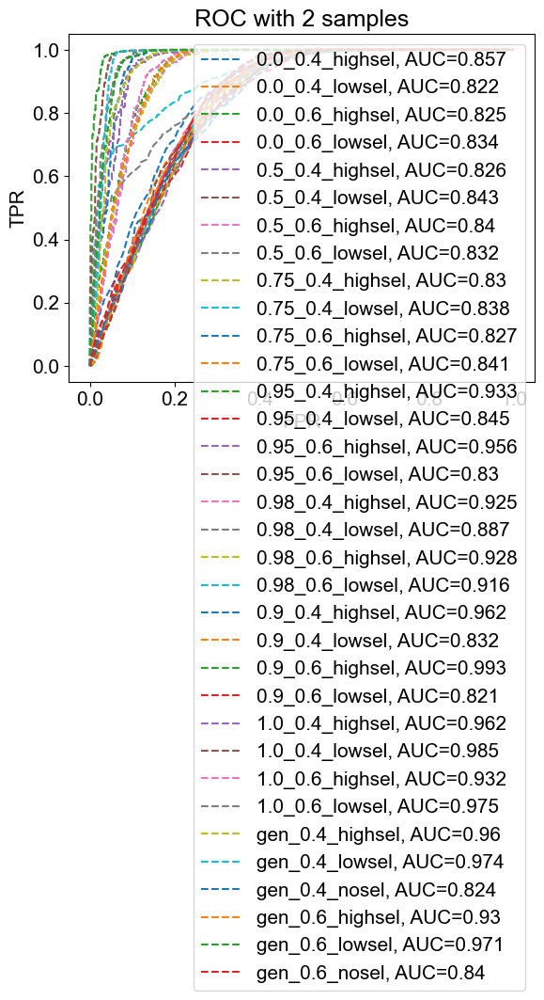

<Figure size 640x480 with 0 Axes>

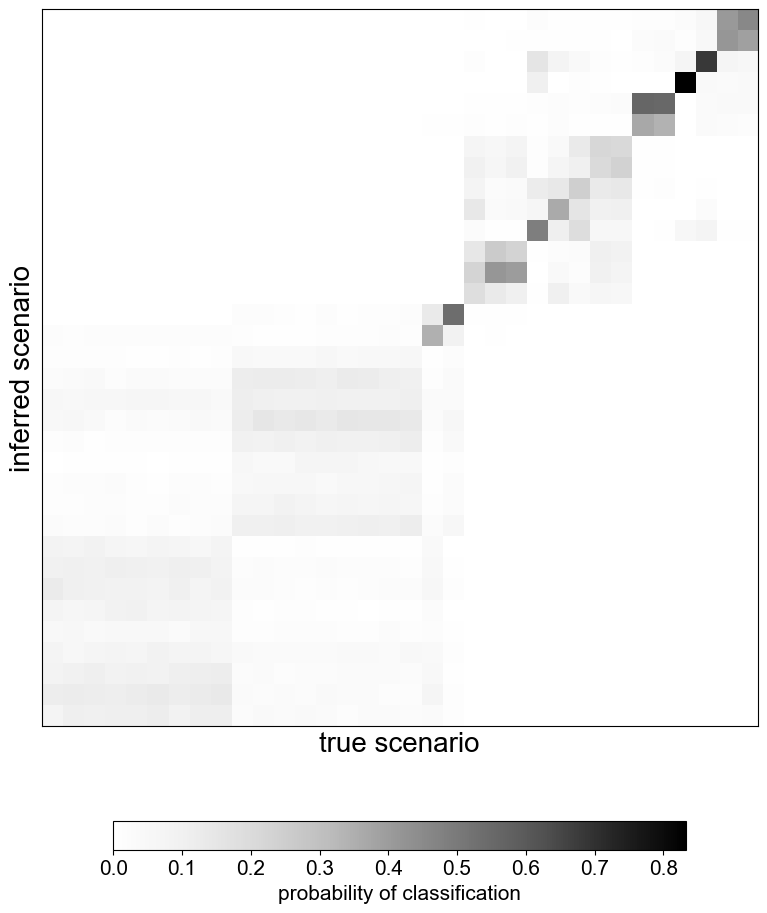

<Figure size 640x480 with 0 Axes>

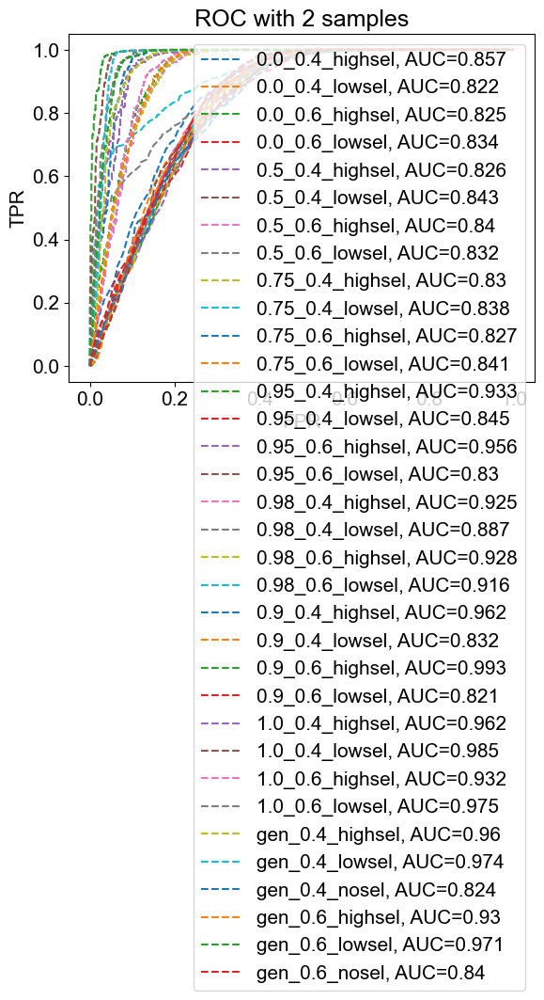

<Figure size 640x480 with 0 Axes>

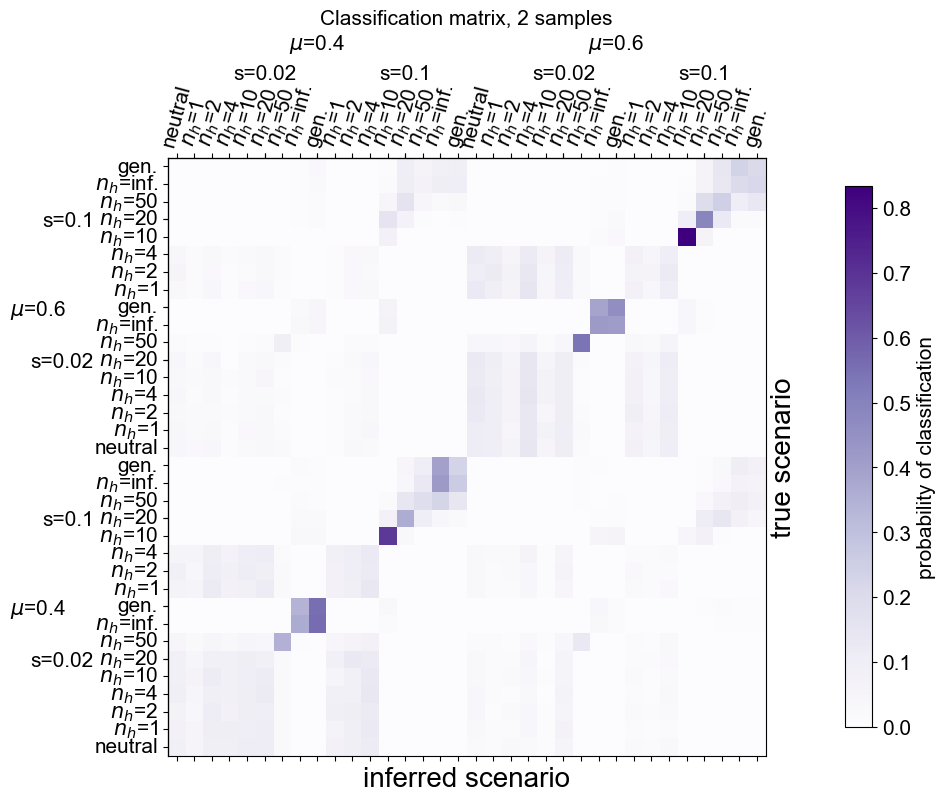

<Figure size 640x480 with 0 Axes>

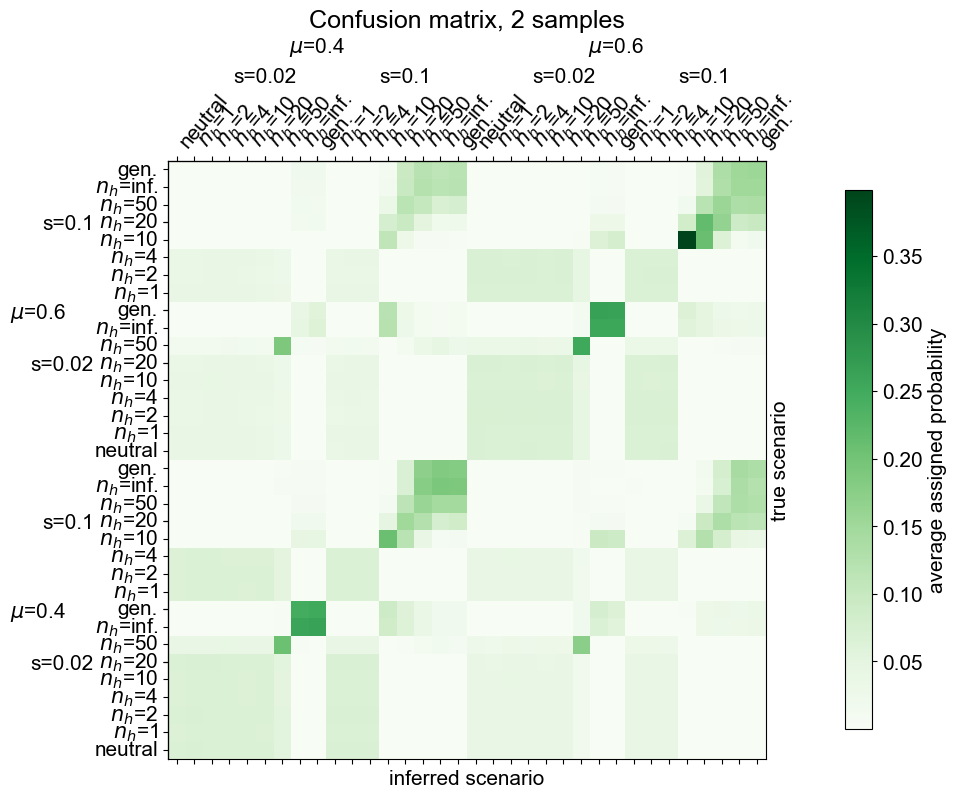

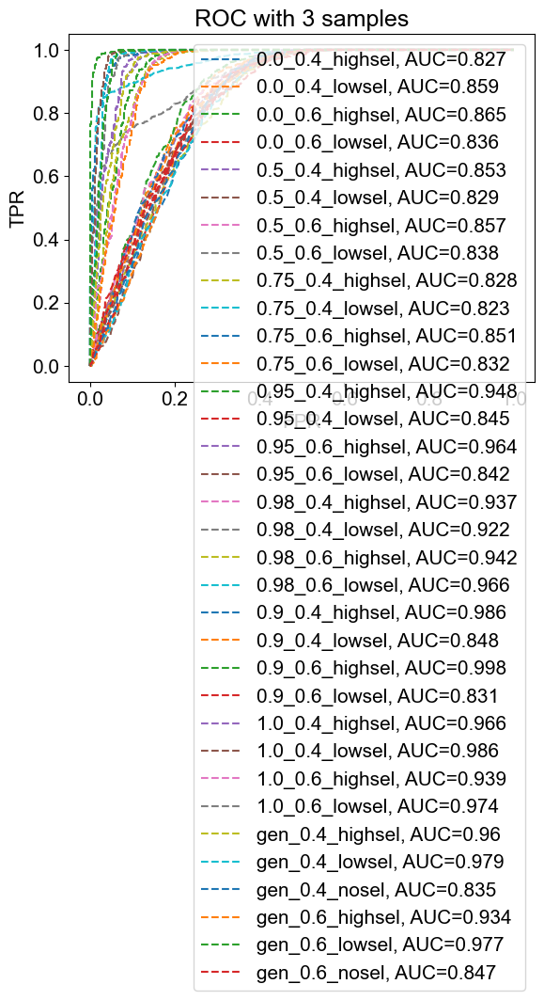

<Figure size 640x480 with 0 Axes>

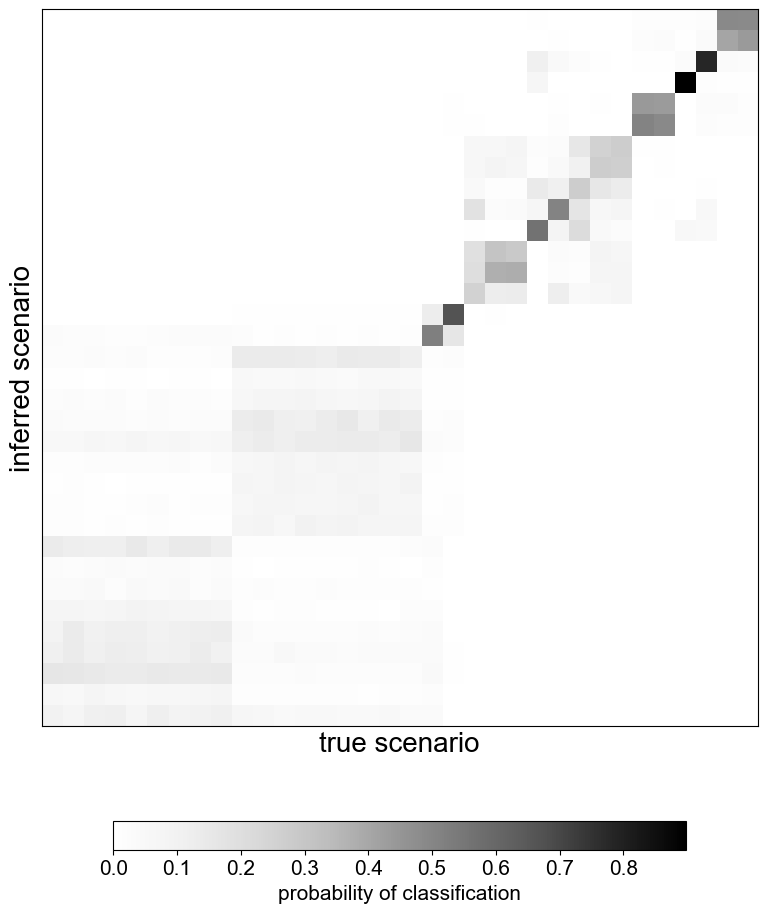

<Figure size 640x480 with 0 Axes>

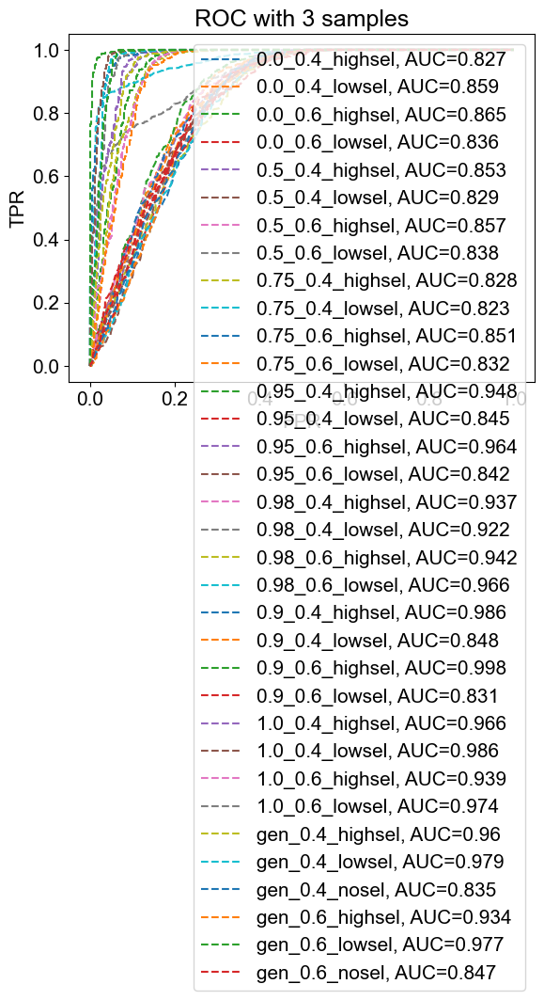

<Figure size 640x480 with 0 Axes>

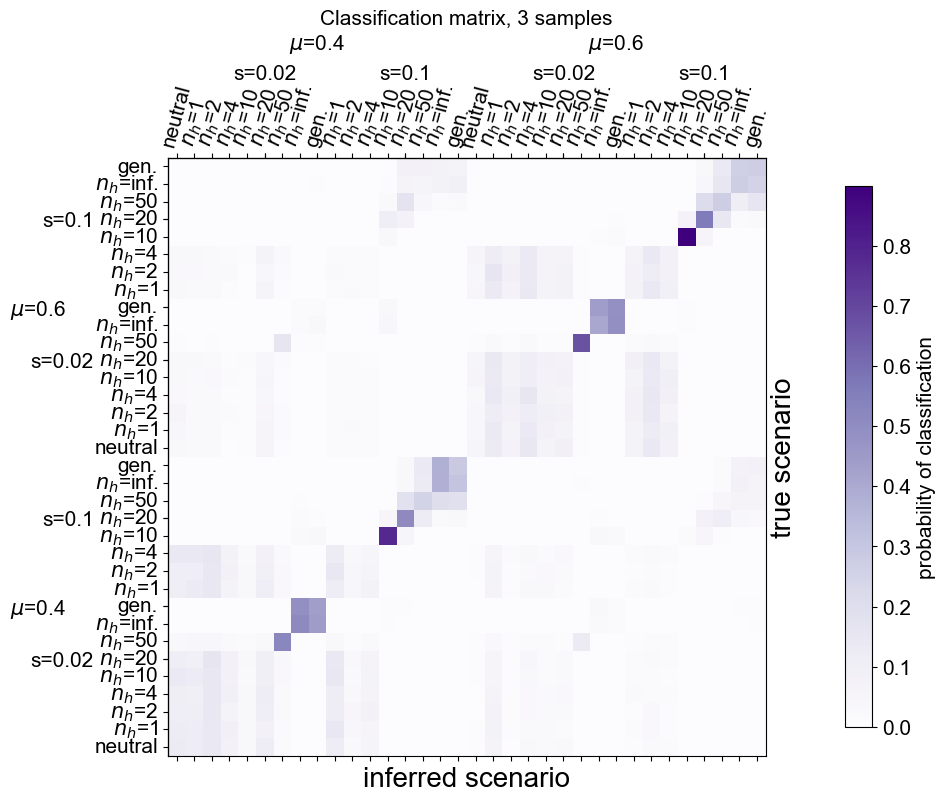

<Figure size 640x480 with 0 Axes>

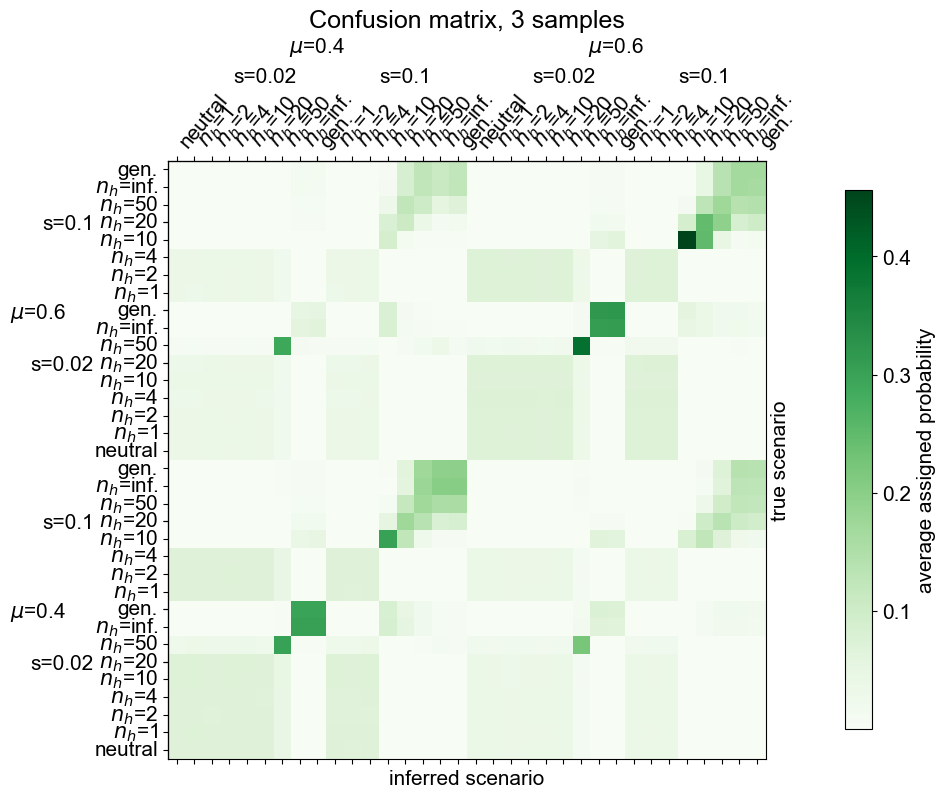

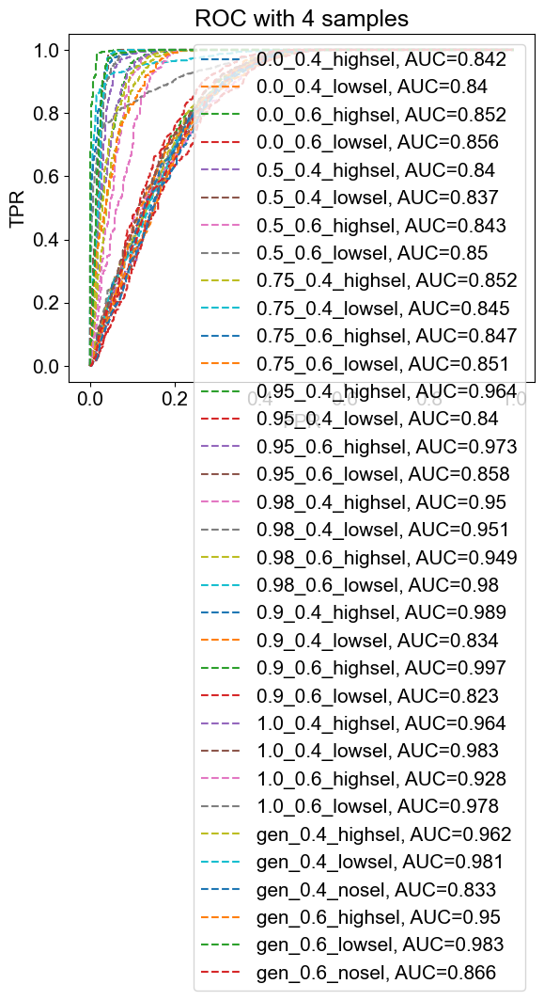

<Figure size 640x480 with 0 Axes>

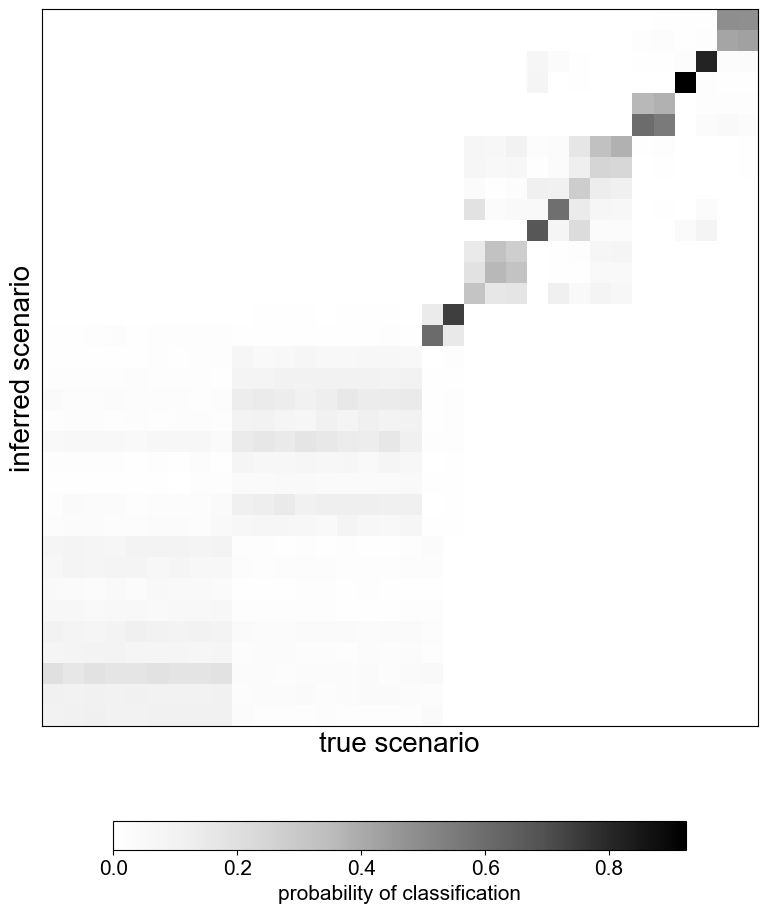

<Figure size 640x480 with 0 Axes>

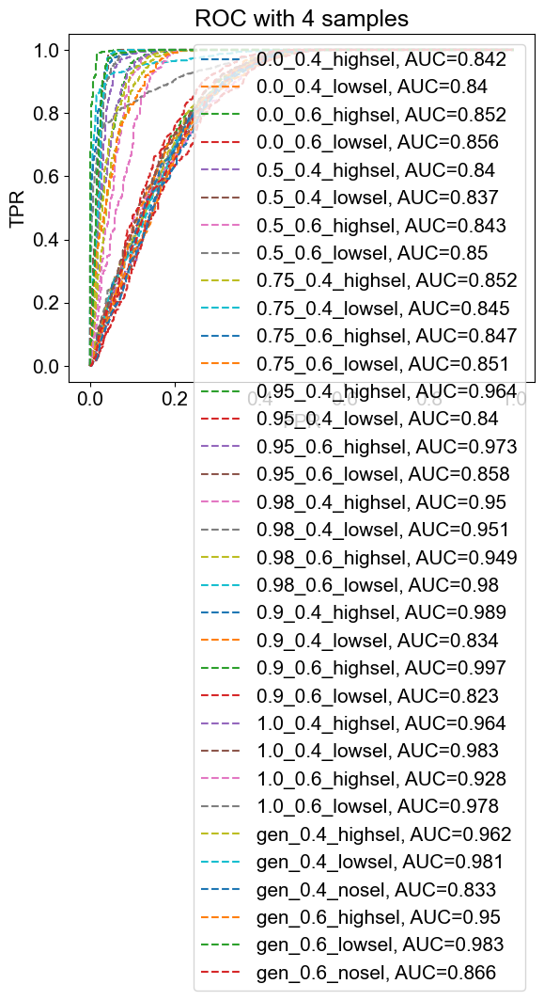

<Figure size 640x480 with 0 Axes>

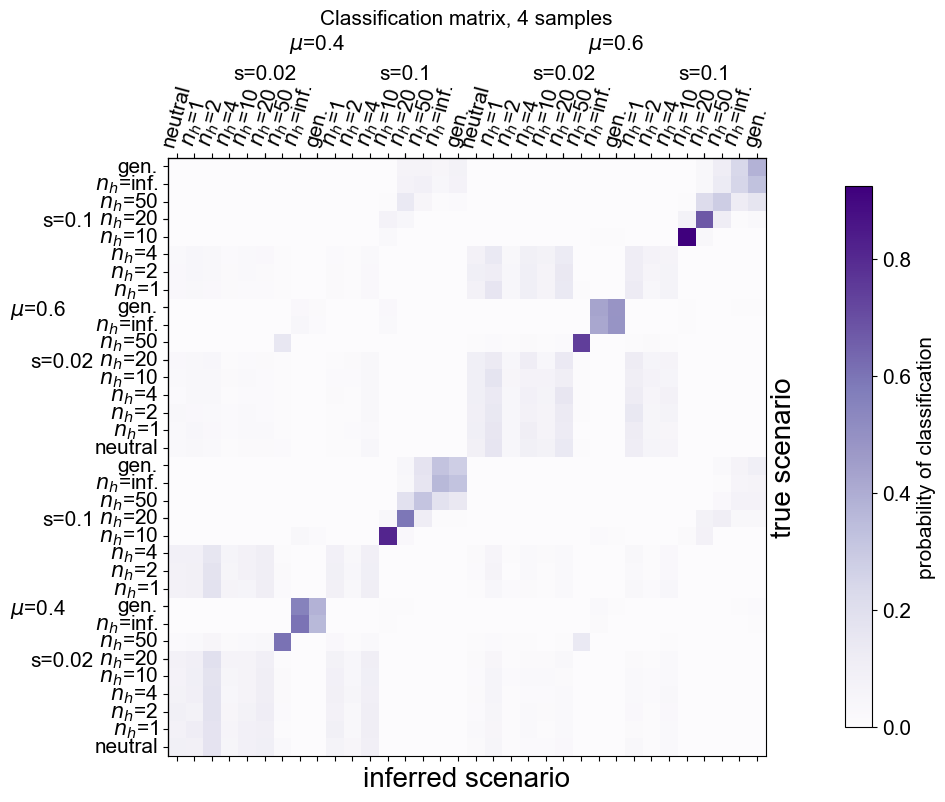

<Figure size 640x480 with 0 Axes>

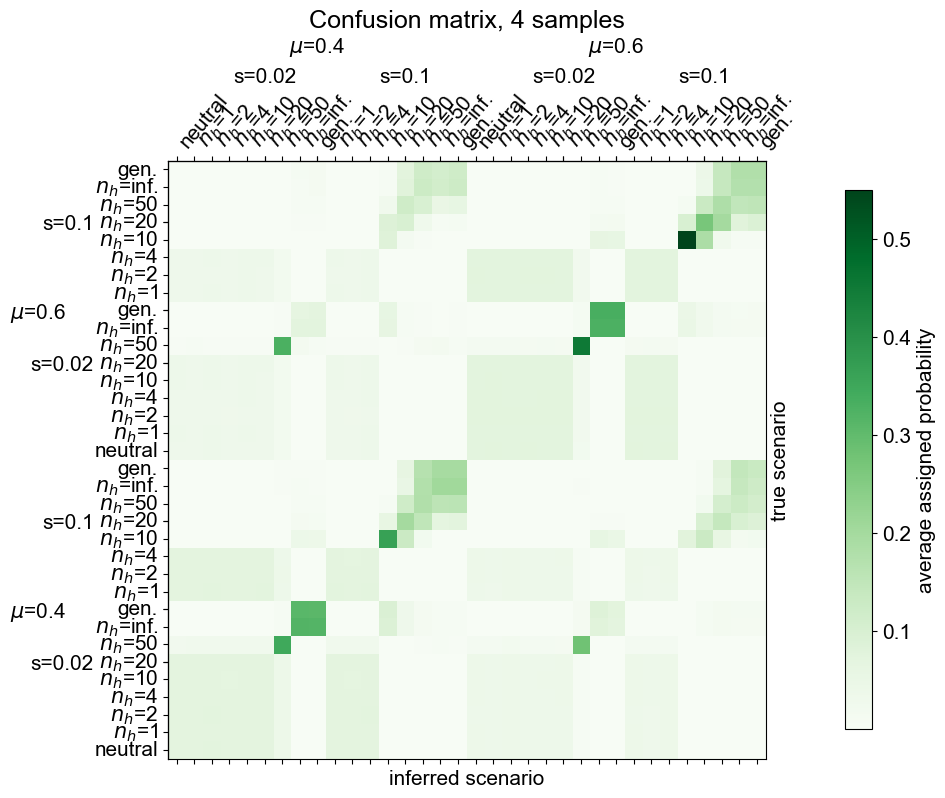

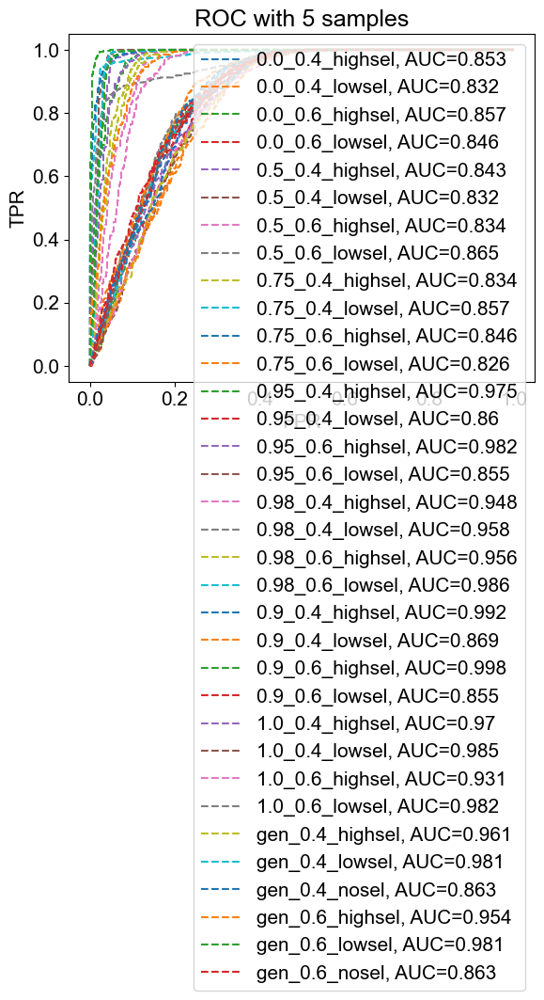

<Figure size 640x480 with 0 Axes>

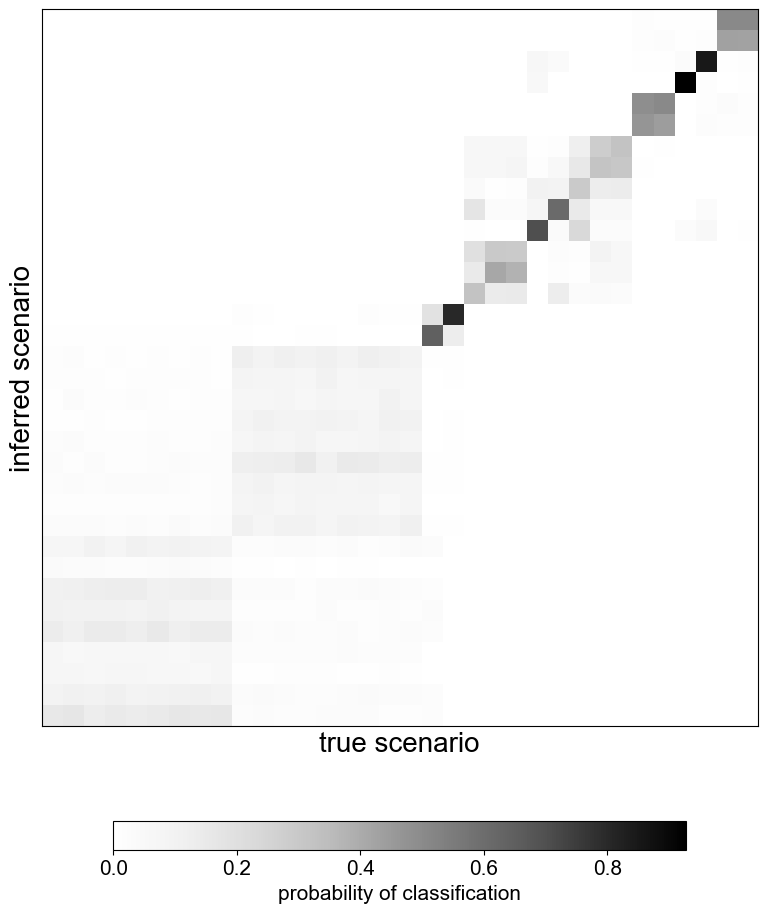

<Figure size 640x480 with 0 Axes>

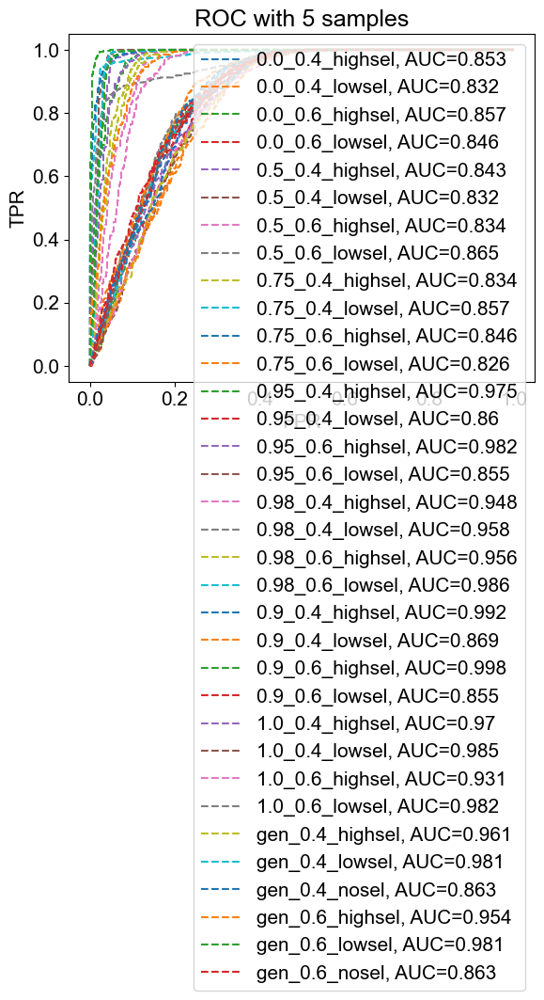

<Figure size 640x480 with 0 Axes>

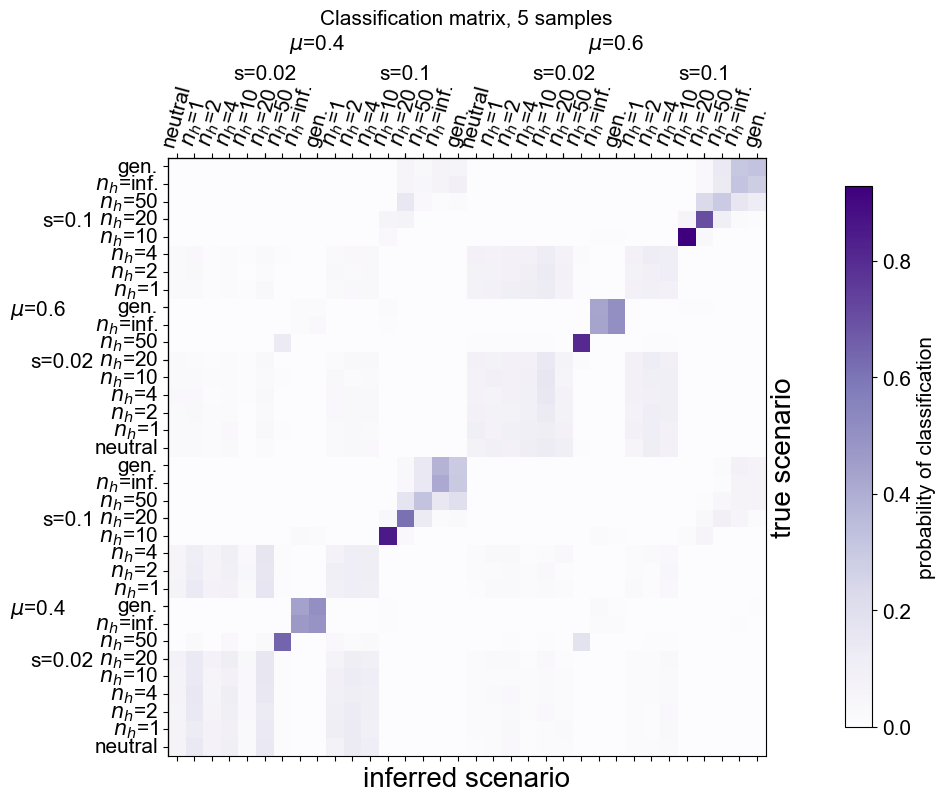

<Figure size 640x480 with 0 Axes>

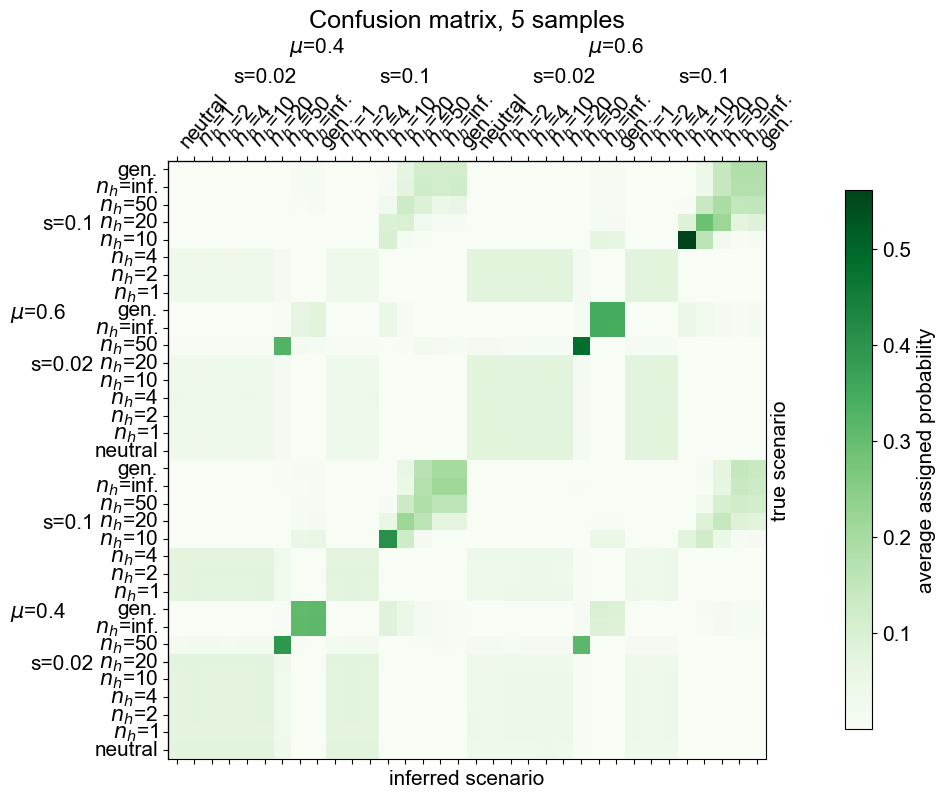

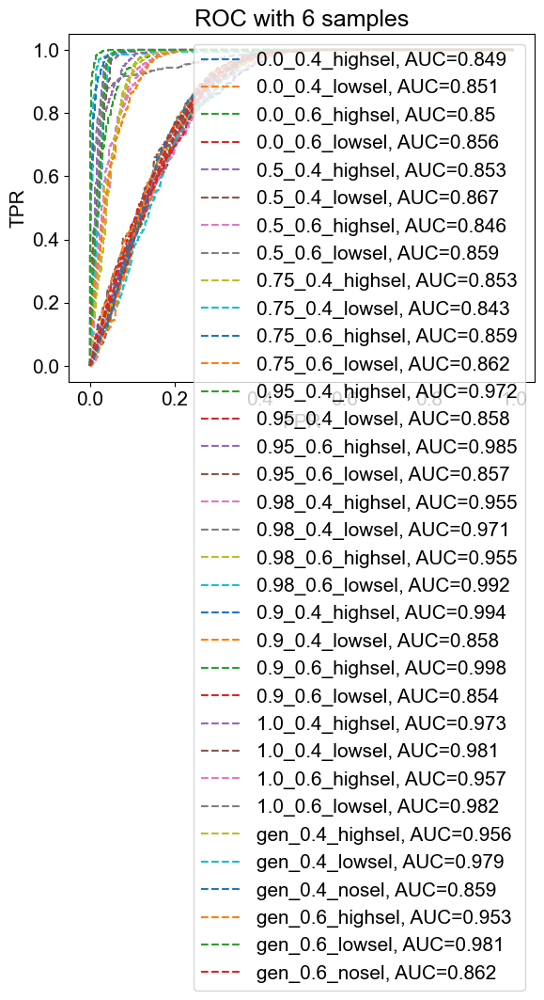

<Figure size 640x480 with 0 Axes>

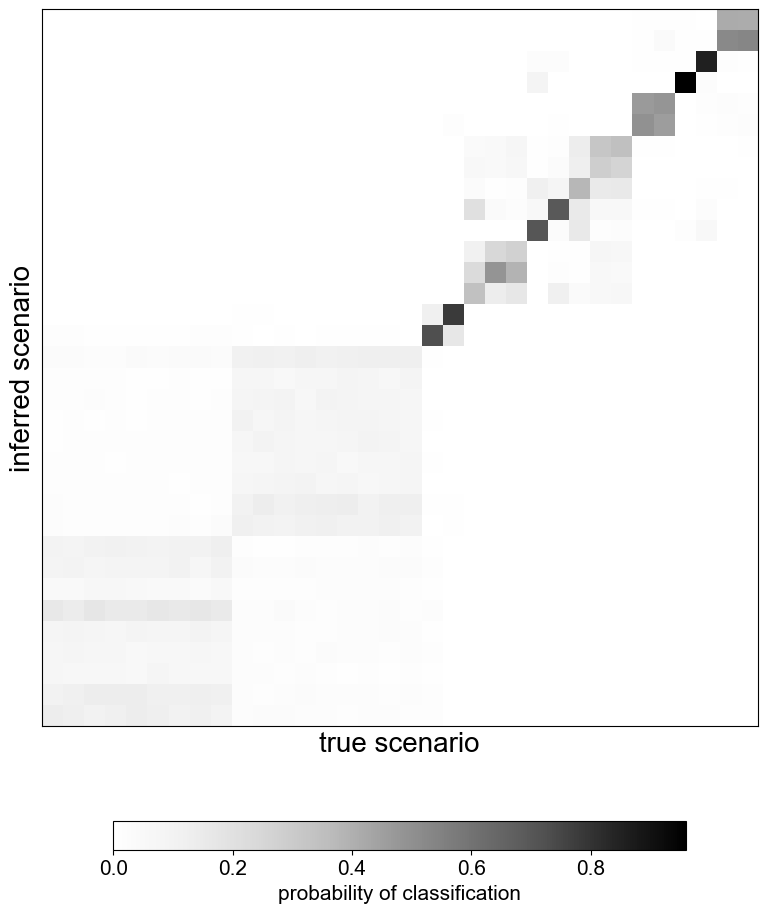

<Figure size 640x480 with 0 Axes>

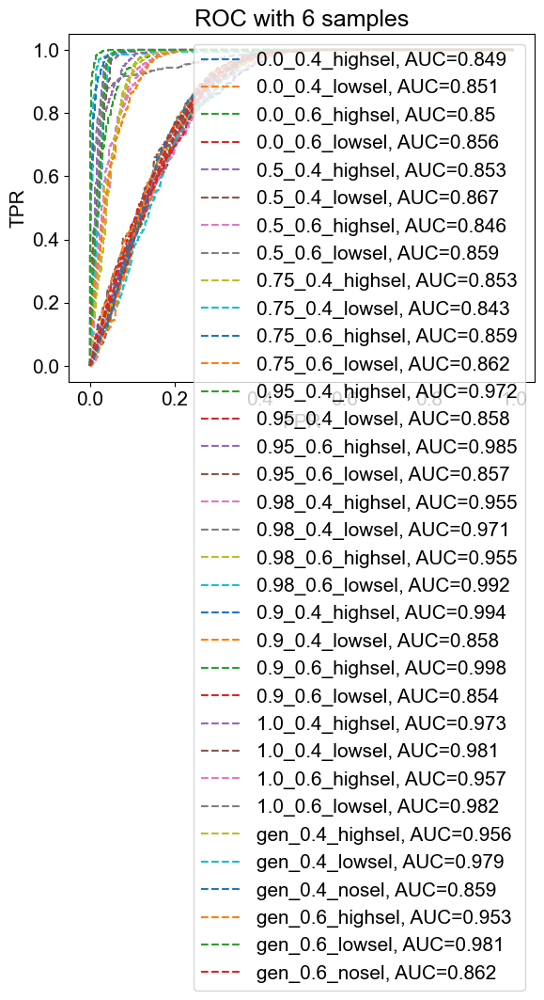

<Figure size 640x480 with 0 Axes>

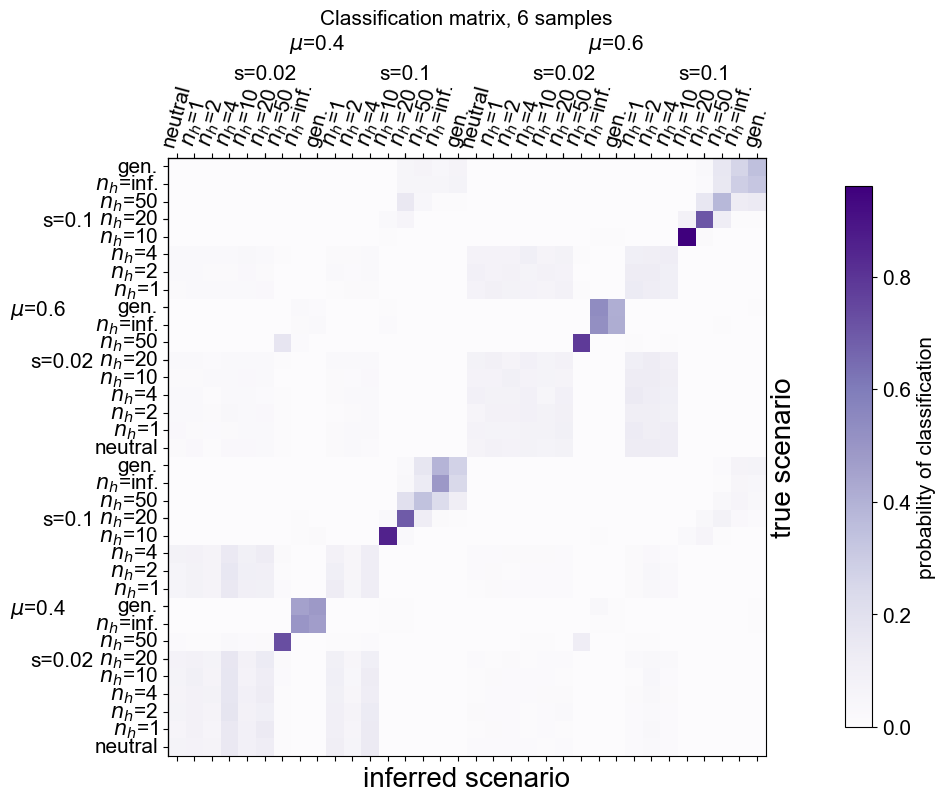

<Figure size 640x480 with 0 Axes>

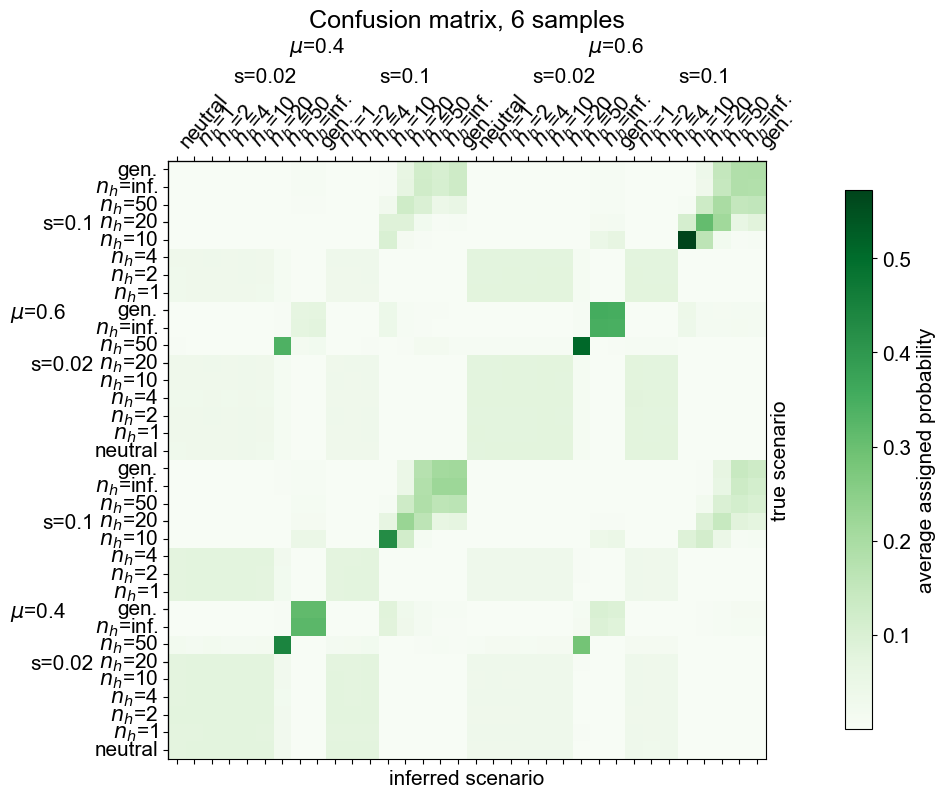

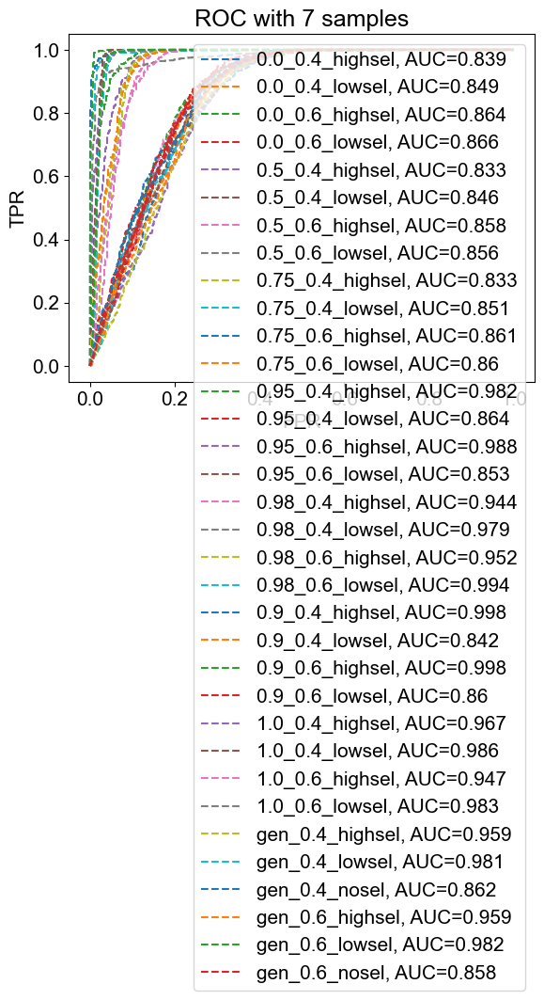

<Figure size 640x480 with 0 Axes>

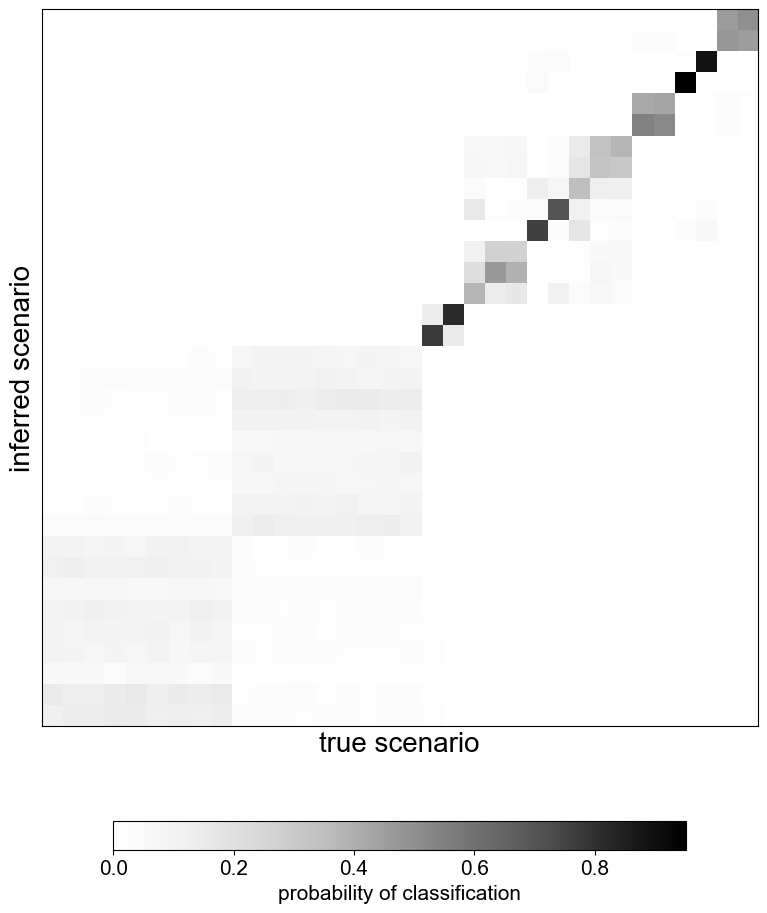

<Figure size 640x480 with 0 Axes>

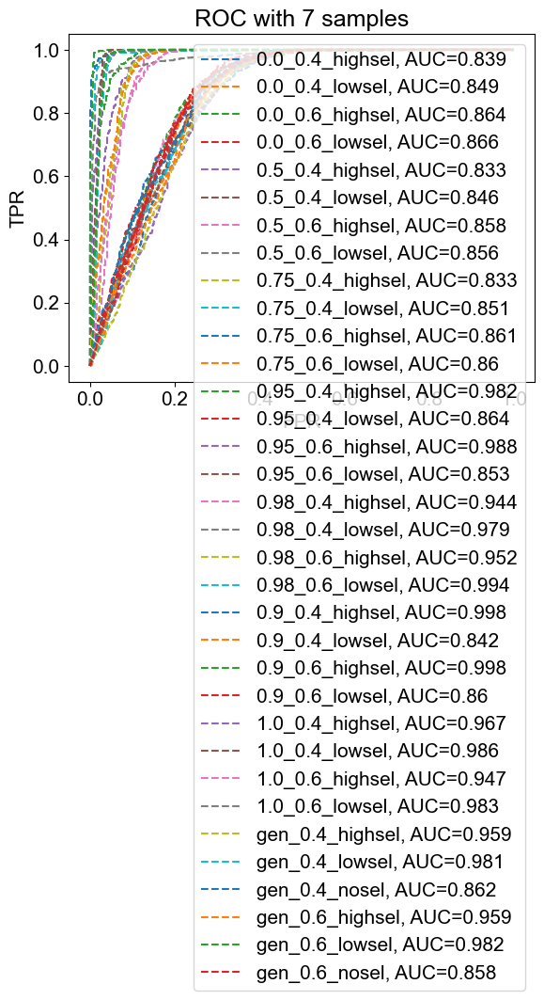

<Figure size 640x480 with 0 Axes>

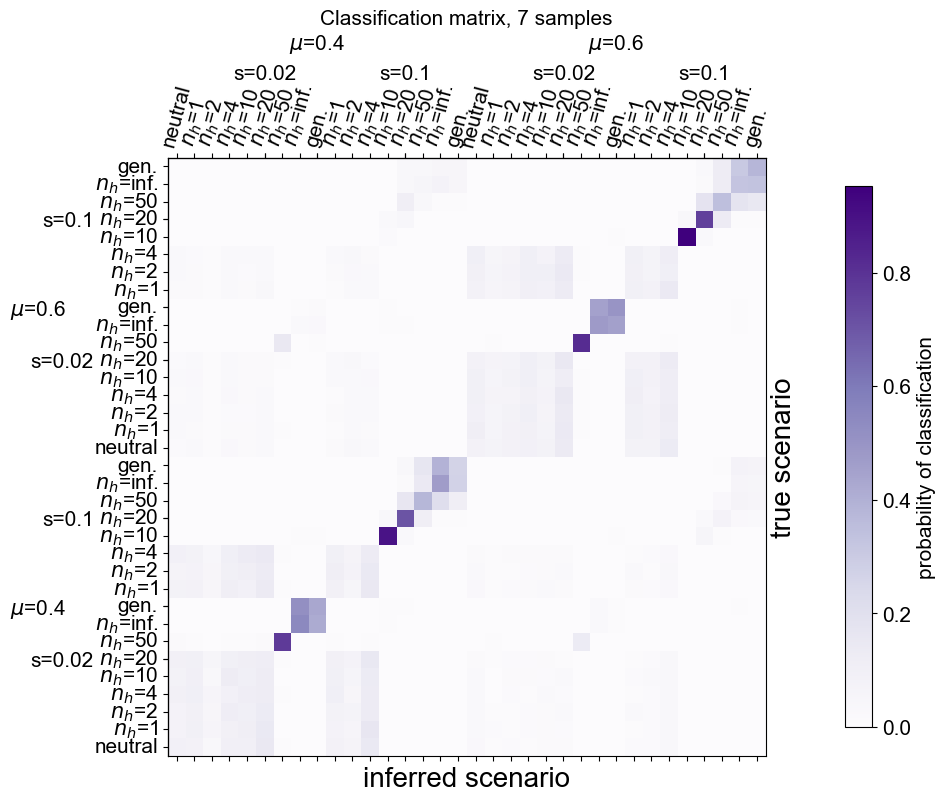

<Figure size 640x480 with 0 Axes>

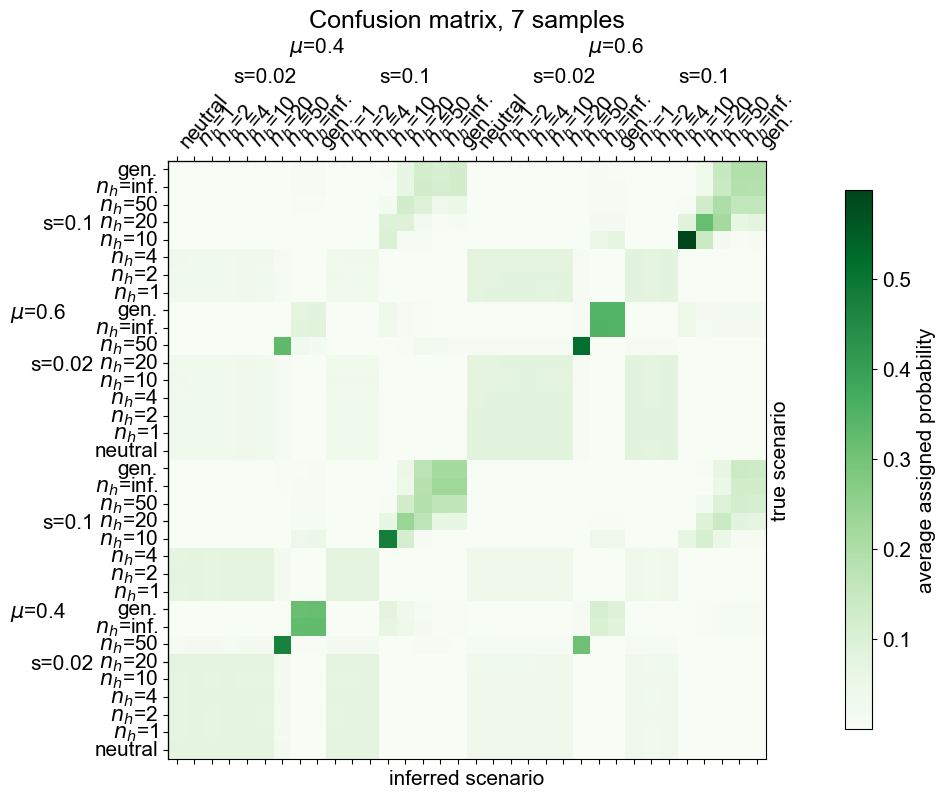

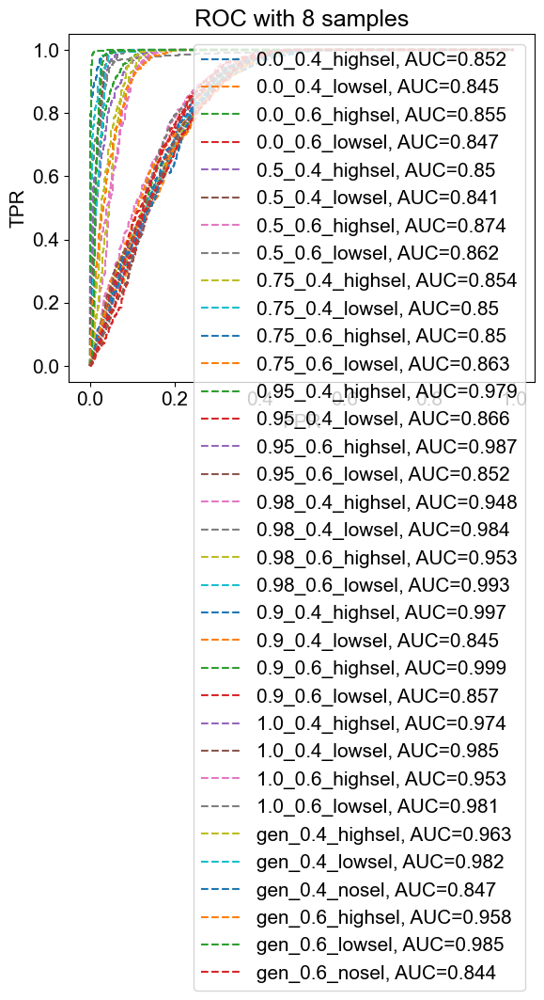

<Figure size 640x480 with 0 Axes>

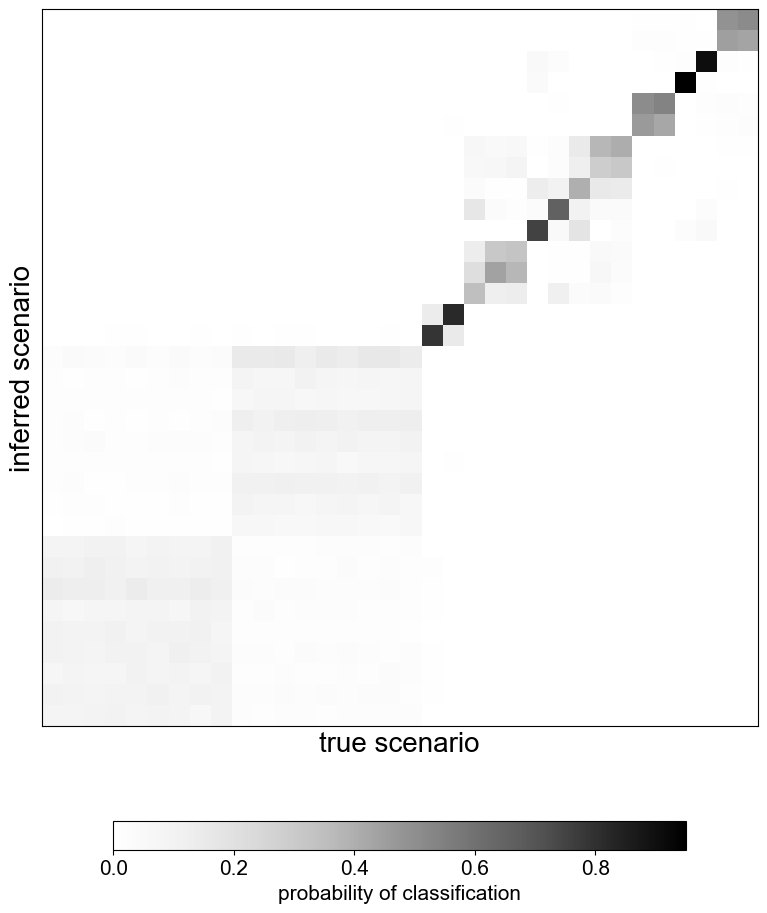

<Figure size 640x480 with 0 Axes>

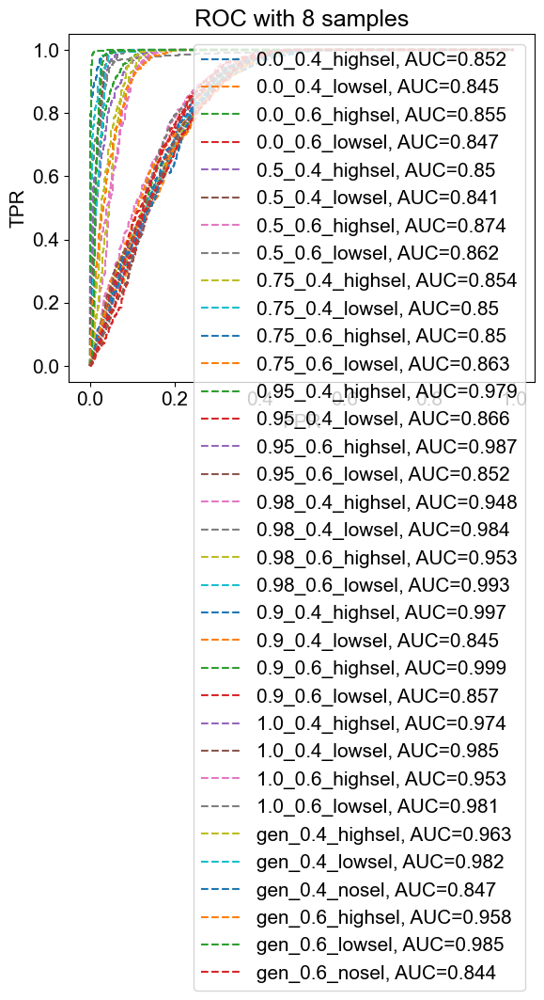

<Figure size 640x480 with 0 Axes>

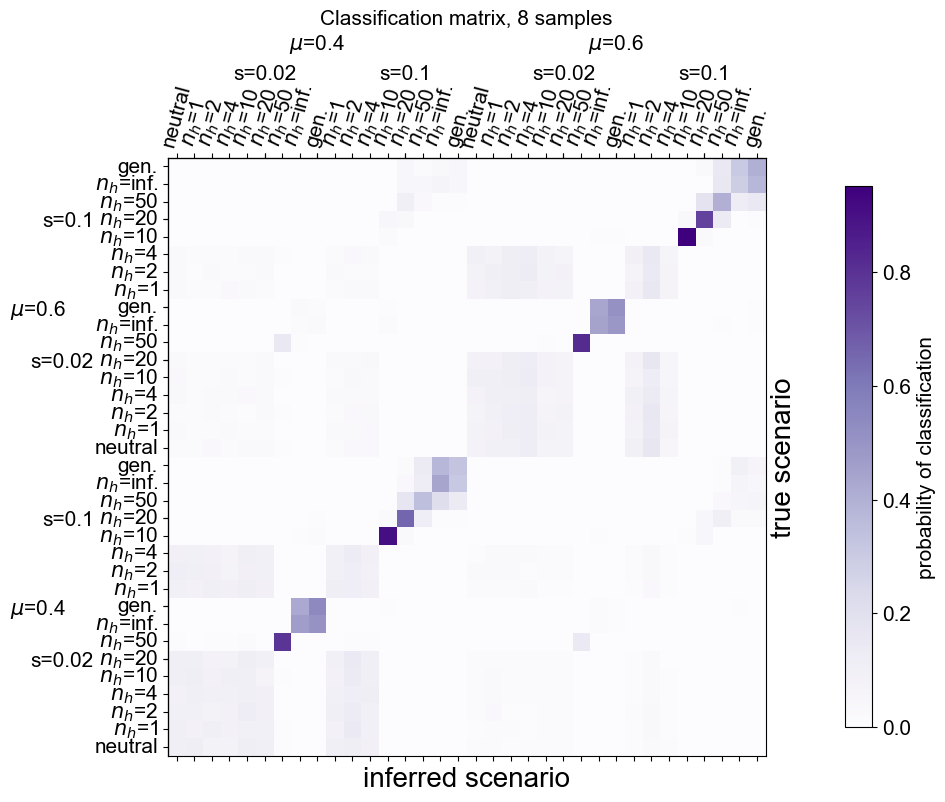

<Figure size 640x480 with 0 Axes>

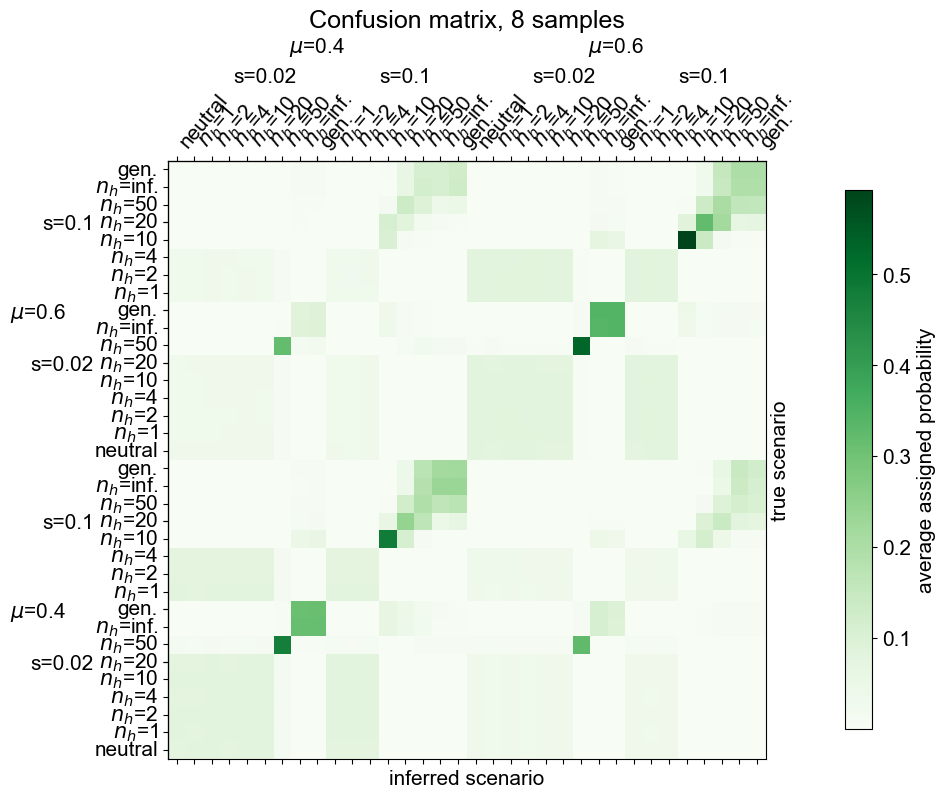

In [5]:
plt.rcParams['font.size'] = 15

def plot_classification_matrix_individual_scen(savename, no_samples, trial_num=0, level_sel=50, level_mut=70, dend_order=False):
    
    [fprs, tprs, all_threshes] = np.load(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_trial_"+str(trial_num)+"_rocs_per_class.npy", allow_pickle=True)
    [class_matrix, confusion_matrix]= np.load(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_trial_"+str(trial_num)+"_matrices.npy", allow_pickle=True)
    labels = np.load(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_all_labels_in_order.npy", allow_pickle=True)#ing order to be the same across trials, which it is
    
    labels=labels[:, 0] #use text labels
    num_classes = len(labels)

    #rearrange scenarios
    if not dend_order:
        plast_levels = ["0.0", "0.5", "0.75", "0.9", "0.95", "0.98", "1.0", "gen"]
        sel_levels = ["nosel", "lowsel", "highsel"]
        mut_rates = [0.4, 0.6]
        ordered_labels = []
        for mut in mut_rates:
            for sel in sel_levels:
                for plast in plast_levels:
                    if plast == "gen" or sel != "nosel":
                        ordered_labels.append(plast + "_" + str(mut) + "_" + sel)
        
    fig, ax = plt.subplots()
    for i in range(num_classes):
        auc = np.trapz(y=tprs[i], x=fprs[i])
        ax.plot(fprs[i], tprs[i], '--', label=labels[i]+ ", AUC="+str(np.around(auc, decimals=3)))
    ax.set_xlabel("FPR")
    ax.set_ylabel("TPR")
    ax.set_title("ROC with "+str(no_samples) + " samples")
    fig.savefig(base_filepath+"/figs_0512"+"/"+savename+"_samples_"+str(no_samples)+"_roc.png", dpi=300)
    plt.legend()
    plt.show()
    plt.clf()

    plast_labels_for_plot = ["neutral", 
            "$n_h$"+"=1", "$n_h$"+"=2", "$n_h$"+"=4", "$n_h$"+"=10", "$n_h$"+"=20","$n_h$"+"=50", "$n_h$"+"=inf.", "gen.",
           "$n_h$"+"=1", "$n_h$"+"=2", "$n_h$"+"=4", "$n_h$"+"=10", "$n_h$"+"=20","$n_h$"+"=50", "$n_h$"+"=inf.", "gen."]*2

    rearranged_class_matrix = np.zeros_like(class_matrix)
    rearranged_conf_matrix = np.zeros_like(confusion_matrix)

    rearrangement_dict = {}

    if dend_order:
        ordered_labels = np.load("dendrogram_ordered_labels.npy", allow_pickle=True)
    
    for n, label in enumerate(ordered_labels):
        for m, label_ in enumerate(labels):
            if label_ == label:
                rearrangement_dict[m] = n
                
    for n, label in enumerate(ordered_labels):
        n_ = rearrangement_dict[n]
        for m, label_ in enumerate(ordered_labels):
            m_ = rearrangement_dict[m]
            rearranged_class_matrix[n_][m_] = class_matrix[n][m]
            rearranged_conf_matrix[n_][m_] = confusion_matrix[n][m]

    #np.save(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_trial_"+str(trial_num)+"_rearranged_class_and_conf_matrices.npy", [rearranged_class_matrix, rearranged_conf_matrix])
    
    fig, ax = plt.subplots(figsize=(10, 10)) 
    im = ax.matshow(rearranged_class_matrix.T if dend_order else rearranged_class_matrix, origin='lower', cmap=mpl.cm.Purples if not dend_order else mpl.cm.Grays)
    # Loop through all matrix elements and superimpose the values
    # for i in range(num_classes):
    #     for j in range(num_classes):
    #         ax.text(j, i, str(np.around(class_matrix[i, j], decimals=3)), va='center', ha='center', color='black', fontsize='xx-small')
    cbar=plt.colorbar(im, label='probability of classification', location='bottom' if dend_order else 'right', pad=0.1, shrink=0.6)
    if not dend_order:
        ax.set_xticks(range(len(plast_labels_for_plot)), labels=plast_labels_for_plot)
        ax.set_yticks(range(len(plast_labels_for_plot)), labels=plast_labels_for_plot, horizontalalignment='right', verticalalignment='center')
        ax.yaxis.set_label_position("right")
        ax.set_ylabel("true scenario", fontsize=20)
        ax.set_xlabel("inferred scenario", fontsize=20)
    else:
        ax.set_xticks([], [])
        ax.set_yticks([], [])
        ax.set_xlabel("true scenario", fontsize=20)
        ax.set_ylabel("inferred scenario", fontsize=20) #if dend order, true is along the x axis
    if not dend_order:
        ax2 =ax.secondary_xaxis(location='top')
        ax4 =ax.secondary_yaxis(location='left')
        ax2.set_xticks([5, 13, 22, 30], labels=[ 's=0.02', 's=0.1',  's=0.02', 's=0.1'])
        ax4.set_yticks([5, 13, 22, 30], labels=[ 's=0.02', 's=0.1',  's=0.02', 's=0.1'])
        #ax2.spines['top'].set_position(('outward', level_sel))
        ax2.tick_params(axis='x', which='major', pad=level_sel)
        ax4.tick_params(axis='y', which='major', pad=level_sel)
        ax3 = ax.secondary_xaxis(location='top')
        ax5 = ax.secondary_yaxis(location='left')
        ax3.set_xticks([8, 25], labels=[ r'$\mu$'+"=0.4",  r'$\mu$'+"=0.6"])
        ax5.set_yticks([8, 25], labels=[ r'$\mu$'+"=0.4",  r'$\mu$'+"=0.6"])
        ax3.tick_params(axis='x', which='major', pad=level_mut)
        ax5.tick_params(axis='y', which='major', pad=level_mut)
        plt.xticks(rotation=75)
        ax.set_title("Classification matrix, "+str(no_samples)+" samples", fontsize=15)
    plt.tight_layout()
    plt.show()
    #save the class matrix as svg
    #fig.savefig(base_filepath+"/figs_0512"+"/"+savename+"_samples_"+str(no_samples)+"_class_matrix.svg", format="svg")
    #cairosvg.svg2emf(url=base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_class_matrix.svg", write_to=base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_class_matrix.emf")
    if not dend_order:
        fig.savefig(base_filepath+"/figs_0512"+"/"+savename+"_samples_"+str(no_samples)+"_class_matrix.png", dpi=300)
    else:
        fig.savefig(base_filepath+"/figs_0512"+"/"+savename+"_samples_"+str(no_samples)+"_class_matrix_dend_order.png", dpi=300)
    plt.clf()

    if not dend_order:
        fig, ax = plt.subplots(figsize=(10, 10))
        
        im = ax.matshow(rearranged_conf_matrix, origin='lower', cmap=mpl.cm.Greens)
        cbar=plt.colorbar(im, label='average assigned probability', location='right', pad=0.1, shrink=0.6)
        ax.set_xticks(range(len(plast_labels_for_plot)), labels=plast_labels_for_plot, horizontalalignment='left', verticalalignment='bottom')
        ax.set_yticks(range(len(plast_labels_for_plot)), labels=plast_labels_for_plot, horizontalalignment='right', verticalalignment='center')
        ax.yaxis.set_label_position("right")
        ax.set_ylabel("true scenario")
        ax.set_xlabel("inferred scenario")

        ax2 =ax.secondary_xaxis(location='top')
        ax4 =ax.secondary_yaxis(location='left')
        ax2.set_xticks([5, 13, 22, 30], labels=[ 's=0.02', 's=0.1',  's=0.02', 's=0.1'])
        ax4.set_yticks([5, 13, 22, 30], labels=[ 's=0.02', 's=0.1',  's=0.02', 's=0.1'])
        #ax2.spines['top'].set_position(('outward', level_sel))
        ax2.tick_params(axis='x', which='major', pad=level_sel)
        ax4.tick_params(axis='y', which='major', pad=level_sel)
        ax3 = ax.secondary_xaxis(location='top')
        ax5 = ax.secondary_yaxis(location='left')
        ax3.set_xticks([8, 25], labels=[ r'$\mu$'+"=0.4",  r'$\mu$'+"=0.6"])
        ax5.set_yticks([8, 25], labels=[ r'$\mu$'+"=0.4",  r'$\mu$'+"=0.6"])
        ax3.tick_params(axis='x', which='major', pad=level_mut)
        ax5.tick_params(axis='y', which='major', pad=level_mut)
        plt.xticks(rotation=50)
        ax.set_title("Confusion matrix, "+str(no_samples)+" samples")
        plt.tight_layout()
        fig.savefig(base_filepath+"/figs_0512"+"/"+savename+"_samples_"+str(no_samples)+"_conf_matrix.png", dpi=300)
        plt.show()

    #now save these in rearranged order
    if not dend_order:
        np.save(base_filepath+"/"+savename+"_ordered_labels.npy", ordered_labels)
        np.save(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_trial_"+str(trial_num)+"_rearranged_class_matrix.npy", rearranged_class_matrix)
        np.save(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_trial_"+str(trial_num)+"_rearranged_conf_matrix.npy", rearranged_conf_matrix)

for no_samples in range(2, 9):
    plot_classification_matrix_individual_scen("1Aug", no_samples, dend_order=True)
    plot_classification_matrix_individual_scen("1Aug", no_samples, dend_order=False)

Make the consistency matrix (what proportion of samples assigned to class i on the first run will be assigned to class j on the second?)

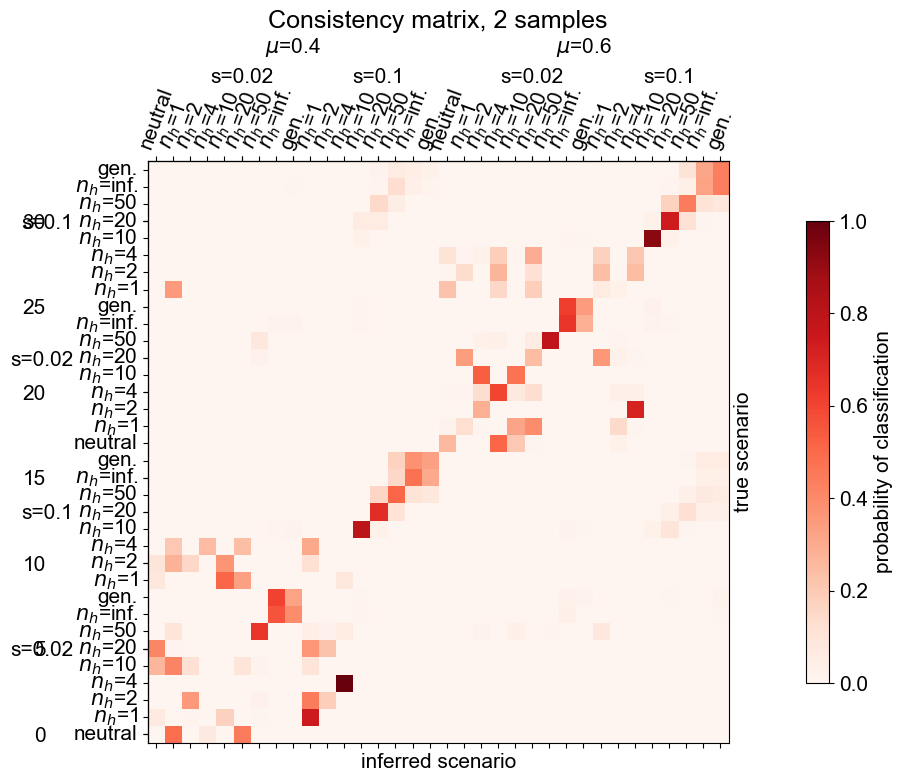

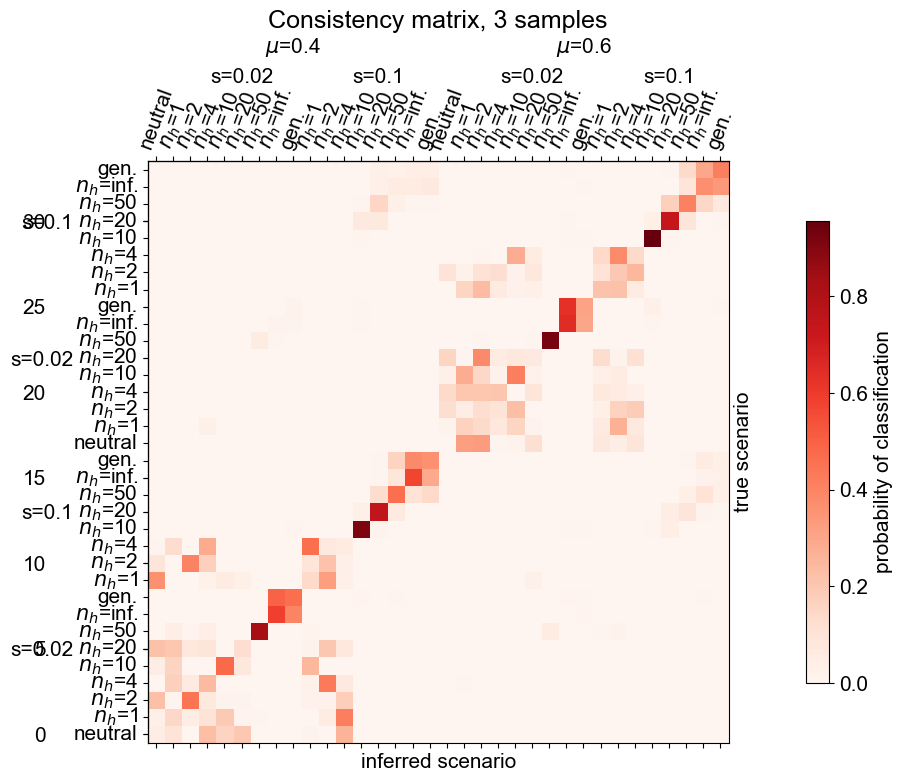

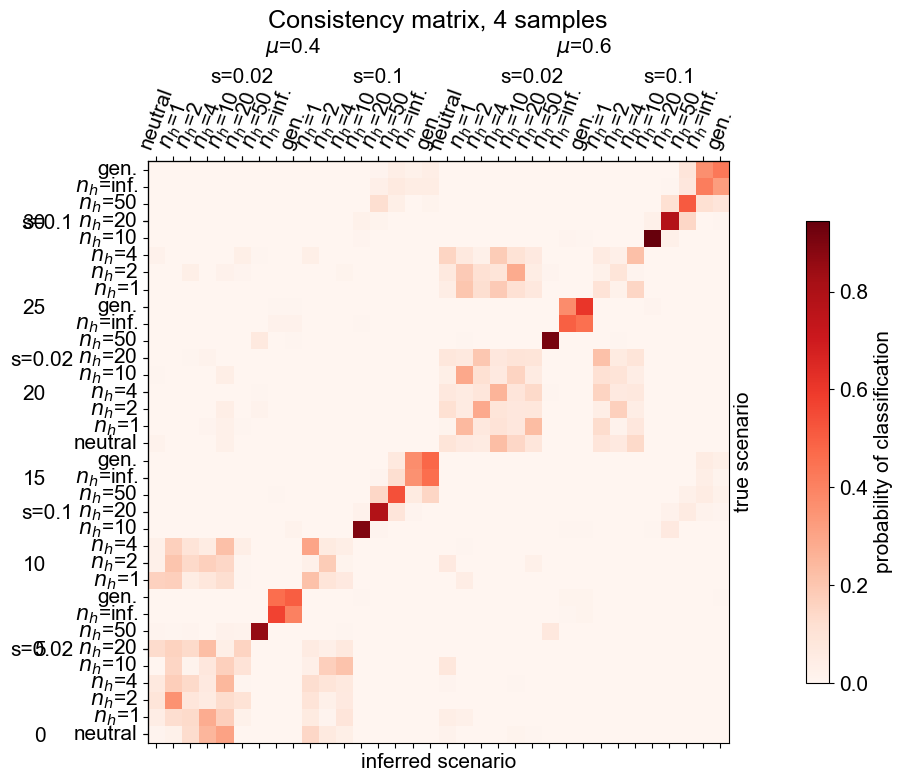

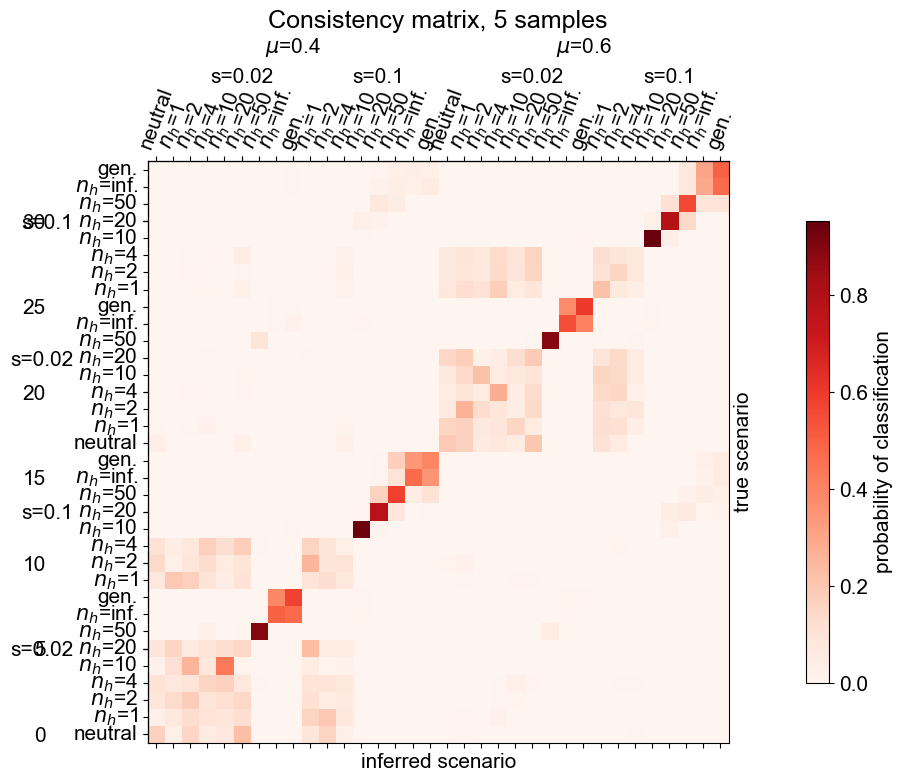

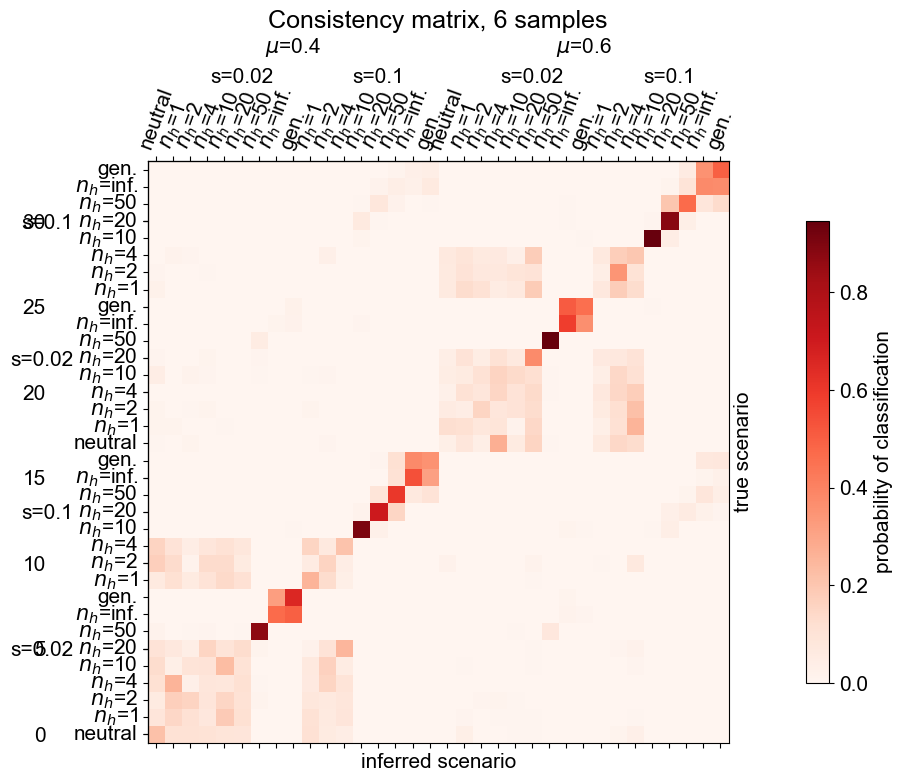

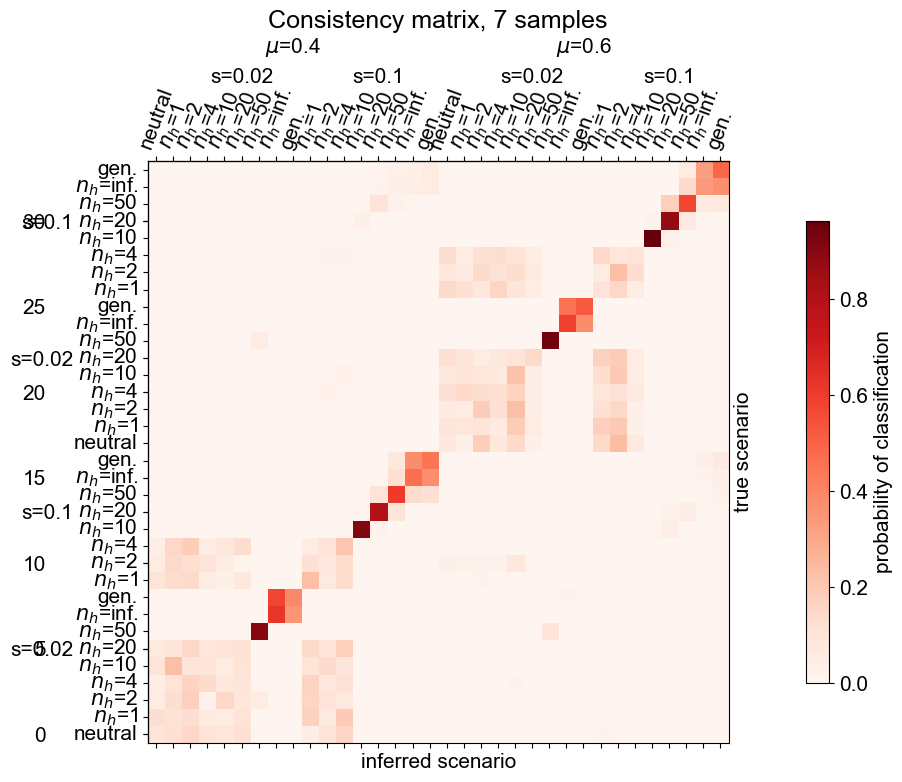

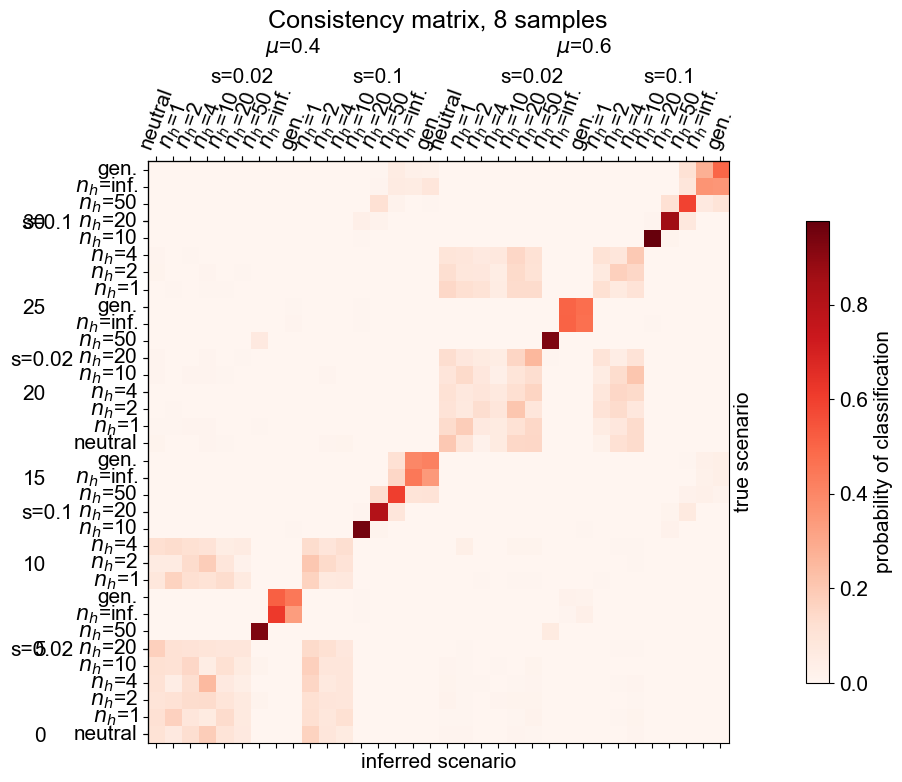

In [16]:
def plot_consistency_matrix(savename, no_samples, level_sel=50, level_mut=70): #plot the consistency between first and second trials
    overall_outcomes_assigned = np.load(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_overall_outcomes_assigned.npy", allow_pickle=True)
    
    ooa_1, ooa_2 = overall_outcomes_assigned[0].astype(int), overall_outcomes_assigned[1].astype(int)
    
    labels = np.load(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_all_labels_in_order.npy", allow_pickle=True)#ing order to be the same across trials, which it is
    
    labels=labels[:, 0] #use text labels
    num_classes = len(labels)

    #rearrange scenarios:
    plast_levels = ["0.0", "0.5", "0.75", "0.9", "0.95", "0.98", "1.0", "gen"]
    sel_levels = ["nosel", "lowsel", "highsel"]
    mut_rates = [0.4, 0.6]
    ordered_labels = []
    for mut in mut_rates:
        for sel in sel_levels:
            for plast in plast_levels:
                if plast == "gen" or sel != "nosel":
                    ordered_labels.append(plast + "_" + str(mut) + "_" + sel)
                    
    consistency_matrix = np.zeros((num_classes, num_classes))
    for (m, n) in zip(ooa_1, ooa_2):
        consistency_matrix[m][n] += 1
    
    for m in range(num_classes):
        consistency_matrix[m] /= np.sum(consistency_matrix[m])

    plast_labels_for_plot = ["neutral", 
            "$n_h$"+"=1", "$n_h$"+"=2", "$n_h$"+"=4", "$n_h$"+"=10", "$n_h$"+"=20","$n_h$"+"=50", "$n_h$"+"=inf.", "gen.",
           "$n_h$"+"=1", "$n_h$"+"=2", "$n_h$"+"=4", "$n_h$"+"=10", "$n_h$"+"=20","$n_h$"+"=50", "$n_h$"+"=inf.", "gen."]*2

    rearranged_consist_matrix = np.zeros_like(consistency_matrix)

    rearrangement_dict = {}
    
    for n, label in enumerate(ordered_labels):
        for m, label_ in enumerate(labels):
            if label_ == label:
                rearrangement_dict[m] = n
                
    for n, label in enumerate(ordered_labels):
        n_ = rearrangement_dict[n]
        for m, label_ in enumerate(ordered_labels):
            m_ = rearrangement_dict[m]
            rearranged_consist_matrix[n_][m_] = consistency_matrix[n][m]

    
    #Consistency matrix answers the question: what proportion of samples assigned to class i on the first run will be assigned to class 2 on the second?

    
    fig, ax = plt.subplots(figsize=(10, 10))
    im = ax.matshow(rearranged_consist_matrix, origin='lower', cmap=mpl.cm.Reds)
    # Loop through all matrix elements and superimpose the values
    # for i in range(num_classes):
    #     for j in range(num_classes):
    #         ax.text(j, i, str(np.around(consistency_matrix[i, j], decimals=3)), va='center', ha='center', color='black', fontsize='xx-small')
    #plt.colorbar(im)
    cbar=plt.colorbar(im, label='probability of classification', location='right', pad=0.1, shrink=0.6)
    ax.set_xticks(range(len(plast_labels_for_plot)), labels=plast_labels_for_plot)
    ax.set_yticks(range(len(plast_labels_for_plot)), labels=plast_labels_for_plot, horizontalalignment='right', verticalalignment='center')
    ax.yaxis.set_label_position("right")
    ax.set_ylabel("true scenario")
    ax.set_xlabel("inferred scenario")

    ax2 =ax.secondary_xaxis(location='top')
    ax4 =ax.secondary_yaxis(location='left')
    ax2.set_xticks([5, 13, 22, 30], labels=[ 's=0.02', 's=0.1',  's=0.02', 's=0.1'])
    ax4.set_yticks([5, 13, 22, 30], labels=[ 's=0.02', 's=0.1',  's=0.02', 's=0.1'])
    #ax2.spines['top'].set_position(('outward', level_sel))
    ax2.tick_params(axis='x', which='major', pad=level_sel)
    ax4.tick_params(axis='y', which='major', pad=level_sel)
    ax3 = ax.secondary_xaxis(location='top')
    ax5 = ax.secondary_yaxis(location='left')
    ax3.set_xticks([8, 25], labels=[ r'$\mu$'+"=0.4",  r'$\mu$'+"=0.6"])
    #ax5.set_yticks([8, 25], labels=[ r'$\mu$'+"=0.4",  r'$\mu$'+"=0.6"])
    ax3.tick_params(axis='x', which='major', pad=level_mut)
    ax5.tick_params(axis='y', which='major', pad=level_mut)
    plt.xticks(rotation=70)
    ax.set_title("Consistency matrix, "+str(no_samples)+" samples")
    fig.savefig(base_filepath+"/figs_0512"+"/"+savename+"_samples_"+str(no_samples)+"_consist_matrix.png", dpi=300)
    plt.show()

    np.save(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_rearranged_consist_matrix.npy", rearranged_consist_matrix)
    


for no_samples in range(2, 9):
    plot_consistency_matrix("1Aug", no_samples)

Plot the individual correlations between matrix elements, to demonstrate that the shape of the correlation matrix is independent of how we measure 'correlation' (i.e. with a classification matrix [C1], a confusion matrix [C2] or consistency matrix [C3]).

slope 0.5543700286088917
intercept 0.01310676386444436


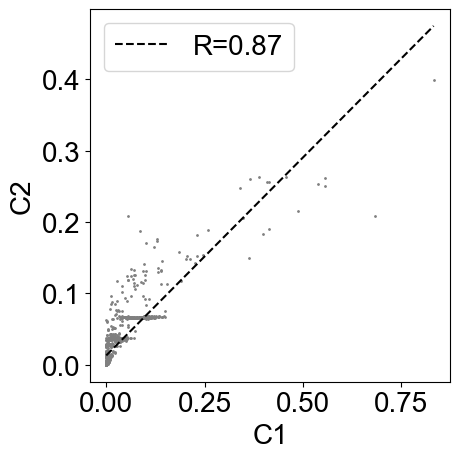

slope 1.1709693569556665
intercept -0.0050285104986960705


<Figure size 640x480 with 0 Axes>

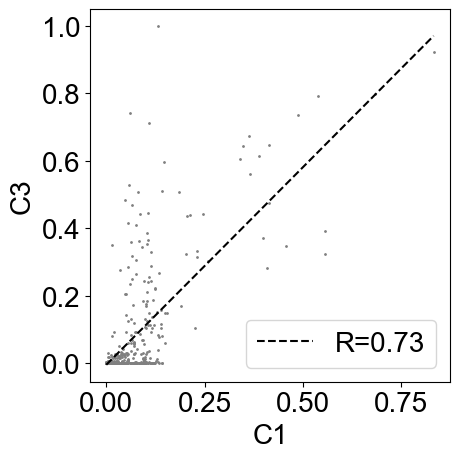

slope 0.5786881802346405
intercept 0.012391524110745868


<Figure size 640x480 with 0 Axes>

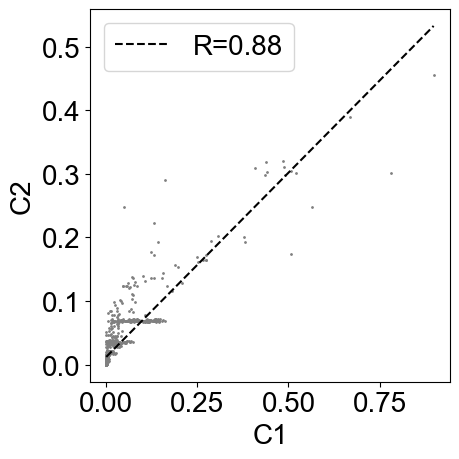

slope 1.128752524007995
intercept -0.003786838941411616


<Figure size 640x480 with 0 Axes>

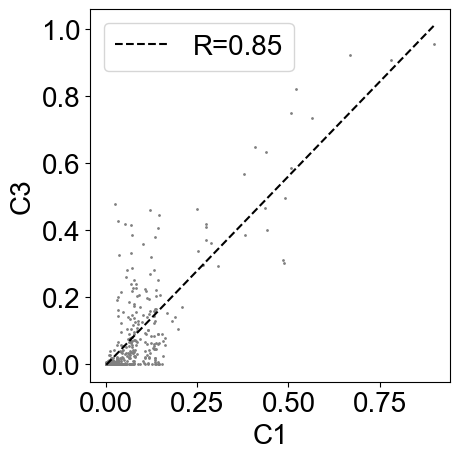

slope 0.5932721154578192
intercept 0.011962584839475904


<Figure size 640x480 with 0 Axes>

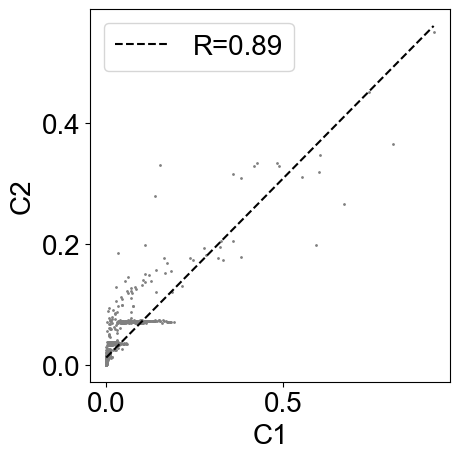

slope 1.0976825705388449
intercept -0.002873016780554259


<Figure size 640x480 with 0 Axes>

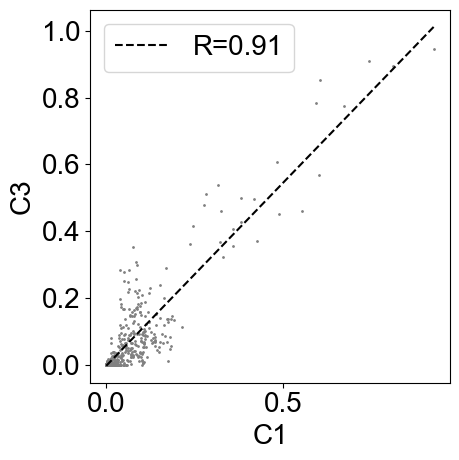

slope 0.6098991731703797
intercept 0.01147355373028295


<Figure size 640x480 with 0 Axes>

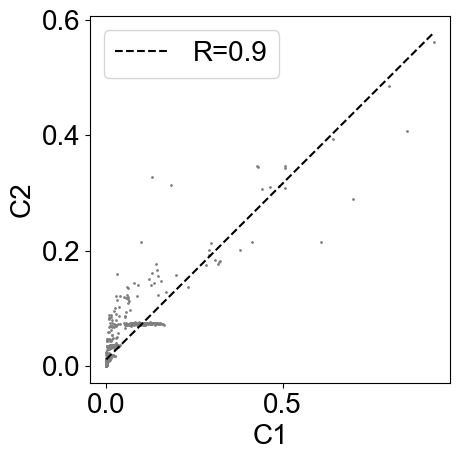

slope 1.0916493491292099
intercept -0.0026955690920355824


<Figure size 640x480 with 0 Axes>

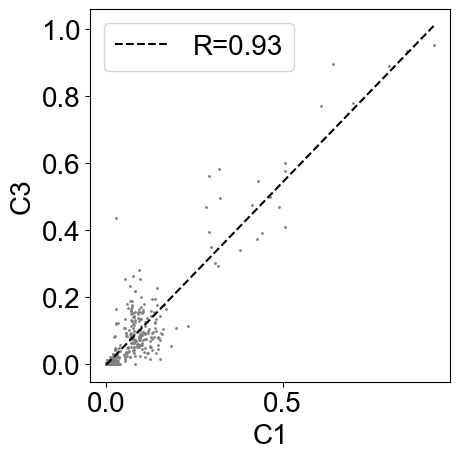

slope 0.6117312933013411
intercept 0.011419667844078201


<Figure size 640x480 with 0 Axes>

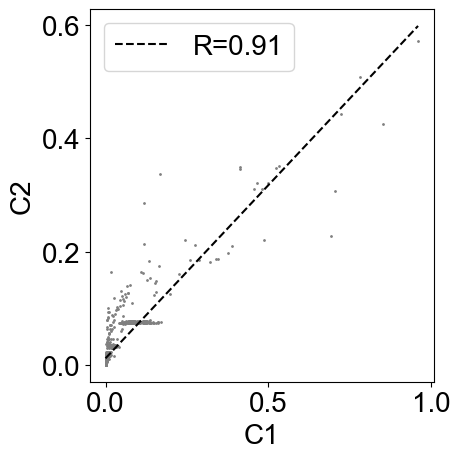

slope 1.081432807035483
intercept -0.0023950825598671455


<Figure size 640x480 with 0 Axes>

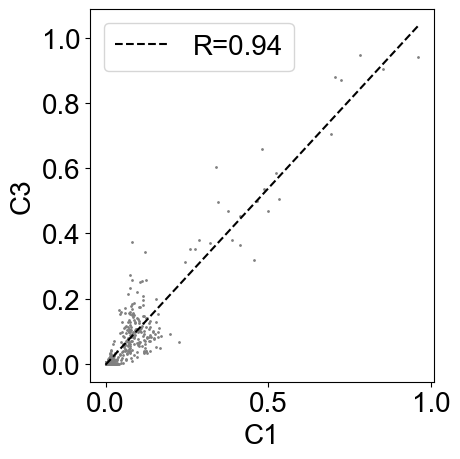

slope 0.6128396778585901
intercept 0.011387068298276761


<Figure size 640x480 with 0 Axes>

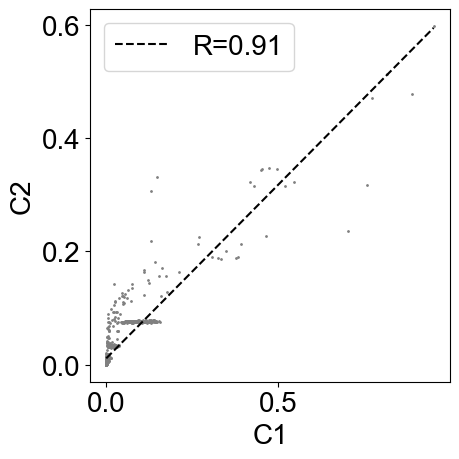

slope 1.073278707718101
intercept -0.0021552561093559075


<Figure size 640x480 with 0 Axes>

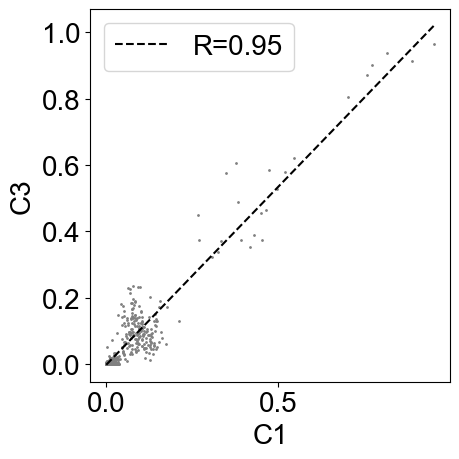

slope 0.6180813233556544
intercept 0.011232902254245461


<Figure size 640x480 with 0 Axes>

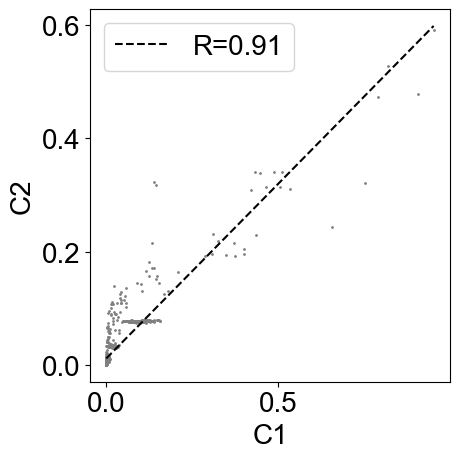

slope 1.075188746534842
intercept -0.0022114337216129973


<Figure size 640x480 with 0 Axes>

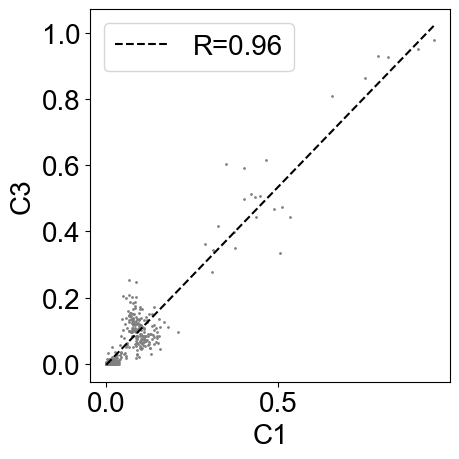

<Figure size 640x480 with 0 Axes>

In [26]:
def correlate_matrices(savename, no_samples, trial_num=0):
    #load class_matrix
    class_mat = np.load(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_trial_"+str(trial_num)+"_rearranged_class_matrix.npy", allow_pickle=True)
    #load confusion matrix
    conf_mat = np.load(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_trial_"+str(trial_num)+"_rearranged_conf_matrix.npy", allow_pickle=True)
    #load consistency matrix
    consist_mat = np.load(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_rearranged_consist_matrix.npy", allow_pickle=True)

    c1, c2, c3 = np.ndarray.flatten(class_mat), np.ndarray.flatten(conf_mat), np.ndarray.flatten(consist_mat)

    fig, ax = plt.subplots(figsize=(5, 5))
    ax.scatter(c1, c2, s=1, color='grey')
    res = linregress(c1, c2)
    xs = np.linspace(0, max(c1))
    #ax.plot(xs, xs)
    print("slope", res.slope)
    print("intercept", res.intercept)
    ax.plot(xs, res.slope*xs + res.intercept, linestyle='--', color='black', label="R="+str(np.around(res.rvalue, decimals=2)))
    plt.xlabel("C1")
    plt.ylabel("C2")
    plt.legend()
    plt.tight_layout()
    plt.show()
    fig.savefig(base_filepath+"/figs_0512"+"/"+savename+"_samples_"+str(no_samples)+"_c1_v_c2.png", dpi=300)
    plt.clf()

    # fig, ax = plt.subplots(figsize=(5, 5))
    # ax.scatter(c2, c3, s=1, color='grey')
    # res = linregress(c2, c3)
    # xs = np.linspace(0, max(c2))
    # ax.plot(xs, res.slope*xs + res.intercept, linestyle='--', color='black', label="R="+str(np.around(res.rvalue, decimals=2)))
    # plt.xlabel("C2")
    # plt.ylabel("C3")
    # plt.legend()
    # plt.tight_layout()
    # plt.show()
    # fig.savefig(base_filepath+"/figs_0512"+"/"+savename+"_samples_"+str(no_samples)+"_c2_v_c3.png", dpi=300)
    # plt.clf()

    fig, ax = plt.subplots(figsize=(5, 5))
    plt.scatter(c1, c3, s=1, color='grey')
    res = linregress(c1, c3)
    print("slope", res.slope)
    print("intercept", res.intercept)
    xs = np.linspace(0, max(c1))
    ax.plot(xs, res.slope*xs + res.intercept, linestyle='--', color='black', label="R="+str(np.around(res.rvalue, decimals=2)))
    plt.xlabel("C1")
    plt.ylabel("C3")
    plt.legend()
    plt.tight_layout()
    plt.show()
    fig.savefig(base_filepath+"/figs_0512"+"/"+savename+"_samples_"+str(no_samples)+"_c1_v_c3.png", dpi=300)
    plt.clf()
    

for no_samples in range(2, 9):
    correlate_matrices("1Aug", no_samples)

C2 (confusion) has a clear thresholding effect, as small probabilities (around 10%) are consistently assigned to unlikely modes, without those modes being easily distinguished. C3 is much more variable than either, and will amplify the effects of stochasticity.

Now plot our ability to distinguish each scenario (i.e. the rate at which scenario i can be correctly classified). 

Maximum 0.8503688092729189
Minimum 0.035830618892508145
Average 0.2378504073429577


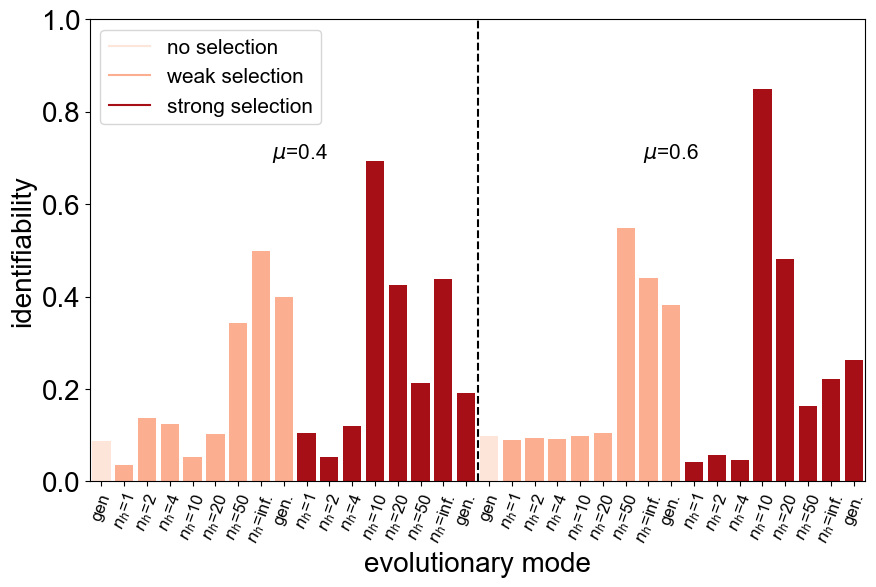

Maximum 0.9031531531531531
Minimum 0.031746031746031744
Average 0.26595158427433313


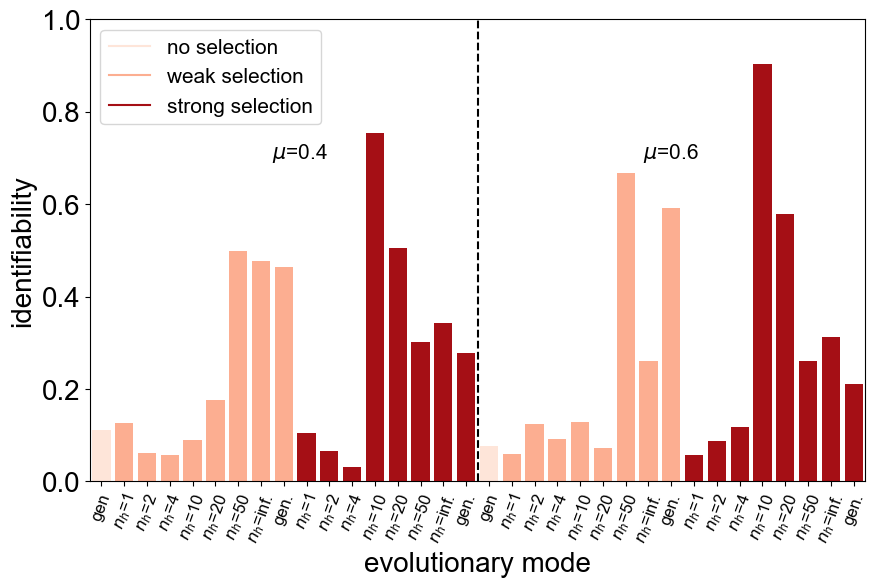

Maximum 0.9151047409040793
Minimum 0.04462242562929062
Average 0.28410733607287914


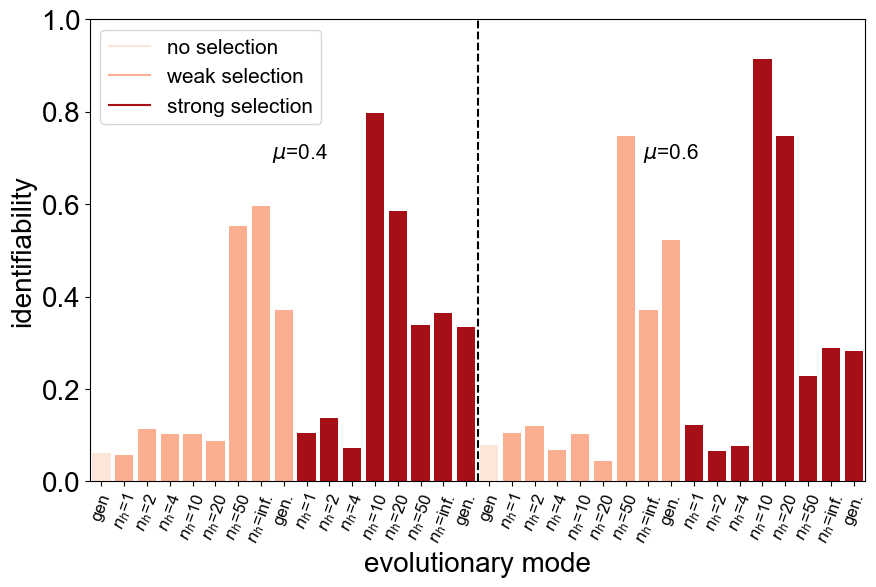

Maximum 0.9302059496567505
Minimum 0.05530973451327434
Average 0.2964670778495176


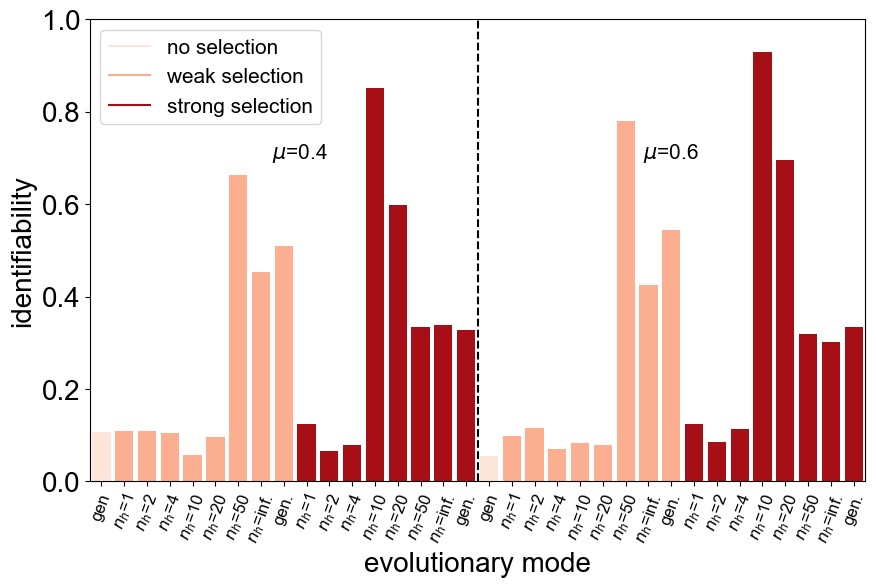

Maximum 0.9388209121245829
Minimum 0.051643192488262914
Average 0.3042267865397761


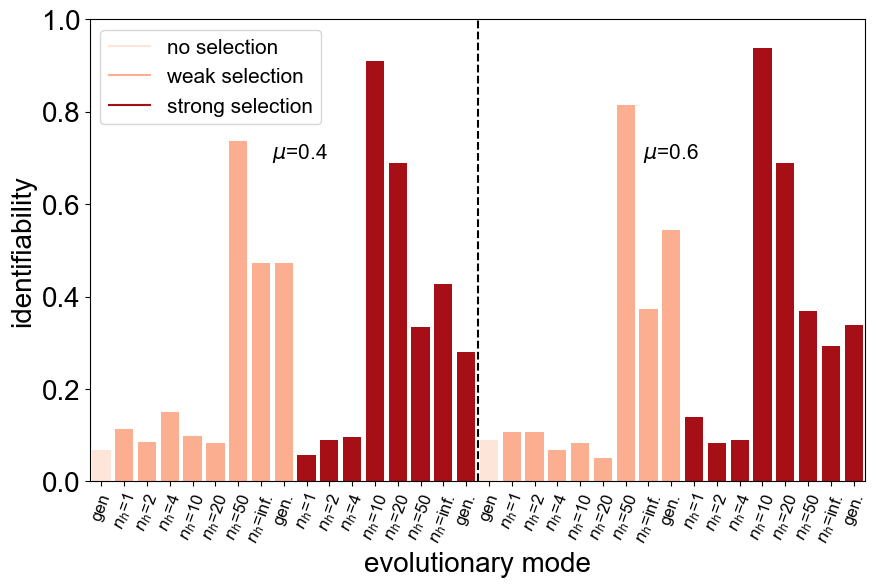

Maximum 0.9552083333333333
Minimum 0.06179775280898876
Average 0.31140476224049024


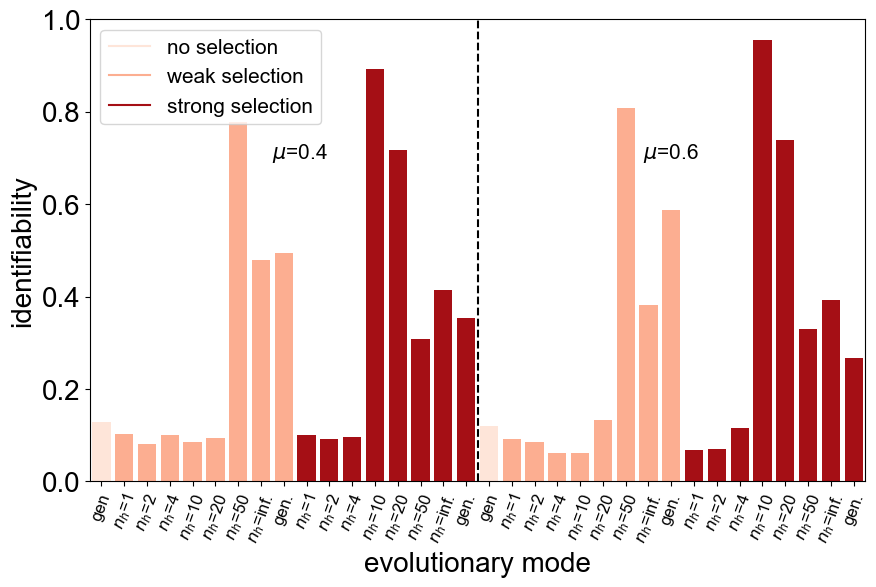

Maximum 0.9581447963800905
Minimum 0.04767184035476718
Average 0.312508309711788


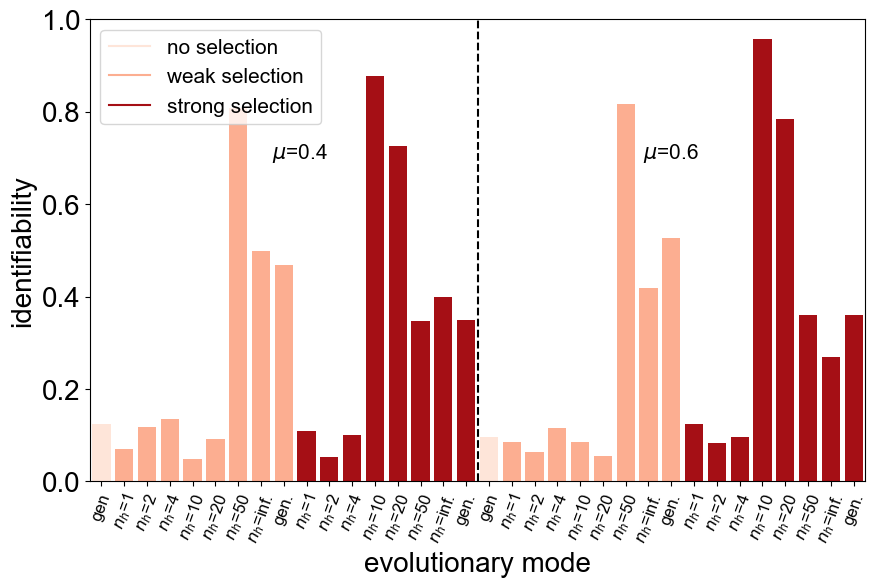

In [10]:
#Define 'accuracy' as the rate at which scenario i can be reliably identified.
def accuracy_barchart(savename, no_samples, trial_num=0, neut_color="#FEE5D9", low_color="#FCAE91", high_color="#A50F15"):
    #load class_matrix
    class_mat = np.load(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_trial_"+str(trial_num)+"_rearranged_class_matrix.npy", allow_pickle=True)
    #load confusion matrix
    conf_mat = np.load(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_trial_"+str(trial_num)+"_rearranged_conf_matrix.npy", allow_pickle=True)
    #load consistency matrix
    consist_mat = np.load(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_rearranged_consist_matrix.npy", allow_pickle=True)

    class_acc = [class_mat[n][n] for n in range(len(class_mat))]
    print("Maximum", np.max(class_acc))
    print("Minimum", np.min(class_acc))
    print("Average", np.average(class_acc))
    conf_acc = [conf_mat[n][n] for n in range(len(class_mat))]
    consist_acc = [consist_mat[n][n] for n in range(len(class_mat))]
    labels_for_display = (["gen"] + 2* ["$n_h$"+"=1", "$n_h$"+"=2", "$n_h$"+"=4", "$n_h$"+"=10", "$n_h$"+"=20","$n_h$"+"=50", "$n_h$"+"=inf.", "gen."])*2
    colors_for_display = ([neut_color] + 8*[low_color] + 8*[high_color])*2
    fig, ax = plt.subplots(figsize=(10, 6))
    plt.rcParams['font.size'] = 15
    ax.bar(range(len(class_acc)), class_acc, color=colors_for_display)
    ax.set_xticks(range(len(class_acc)), labels_for_display, rotation=70, fontsize=12)
    plt.xlabel("evolutionary mode")
    plt.ylabel("identifiability")
    plt.ylim(0, 1)
    plt.xlim(-0.5, 33.5)
    plt.plot([-1], [-1], color=neut_color, label="no selection")
    plt.plot([-1], [-1], color=low_color, label="weak selection")
    plt.plot([-1], [-1], color=high_color, label="strong selection")
    plt.legend()
    ax.text(7.5, 0.7,  r'$\mu$'+"=0.4", color="black")
    ax.text(23.75, 0.7,  r'$\mu$'+"=0.6", color="black")
    ax.axvline(x=16.5, color='black', linestyle='--')
    fig.savefig(base_filepath+"/figs_0512"+"/"+savename+"_accuracy_bar_ind_"+str(no_samples)+".png", format="png", dpi=300)
    fig.savefig(base_filepath+"/figs_0512"+"/"+savename+"_accuracy_bar_ind_"+str(no_samples)+".pdf", format="pdf", dpi=300)
    plt.show()r
    plt.rcParams['font.size'] = 20


for no_samples in range(2, 9):
    accuracy_barchart("1Aug", no_samples)

Note that in all cases there is a bit more cross-mutation confusion at high selection, high mut rate.

Now cluster scenarios. Scenario i is described using a vector; each element j describes the rate at which scenario i is assigned to scenario j. Use hierarchical clustering to cluster them together.

In [17]:

#Define a function that takes a distance threshold and produces a clustering sheme.
def categorise(class_matrix, labels, distance_threshold=0.1):
    clustered = clustering(n_clusters=None, metric='euclidean', linkage='ward', distance_threshold=distance_threshold, compute_full_tree=True)
    cluster_labels = clustered.fit_predict(class_matrix)
    unique_labels = np.unique(cluster_labels)
    text_labels_by_cluster = []
    for index in unique_labels:
        indices = np.where(cluster_labels == index)[0]
        text_labels_by_cluster.append(labels[indices])
    return clustered, cluster_labels, text_labels_by_cluster


In [18]:
#If we take this categorisation, what is the accuracy with which scenarios can be clustered into their categories?
#we want a set of categories where each simulation has AT LEAST a 90% chance of being categorised correctly
#which means the SUM of out-of-scenario confusion must be <10% for each category

#measure the confusion between different categories
def maximum_between_categ_confusion(class_matrix, cluster_labels):
    max_confusion = 0
    av_confusion = []
    for i, row in enumerate(class_matrix):
        label_here = cluster_labels[i]
        out_of_category = np.where(cluster_labels != label_here)[0] 
        max_confusion_here = np.sum(row[out_of_category]) if len(out_of_category) > 0 else 0
        av_confusion.append(max_confusion_here)
        if max_confusion_here > max_confusion:
            max_confusion = max_confusion_here
    return max_confusion, np.average(av_confusion)
        


#calibrate based on maximum between-scenario confusion
def calibrate_distance_function_by_max(class_matrix, labels, min_dist=0.0, max_dist=2, gran=1000):
    dists = np.linspace(min_dist, max_dist, num=gran)
    max_confusions, av_confusions, num_groups = np.zeros(gran), np.zeros(gran),  np.zeros(gran)
    for i, dist in enumerate(dists):
        clustered, cluster_labels, text_labels_by_cluster = categorise(class_matrix, labels, distance_threshold=dist)
        num_groups[i] = len(np.unique(cluster_labels))
        max_confusions[i], av_confusions[i] = maximum_between_categ_confusion(class_matrix, cluster_labels) 
    return dists, max_confusions, av_confusions, num_groups

Measure the effect of clustering parameters (i.e. distance) on maximum between-scenario confusion.

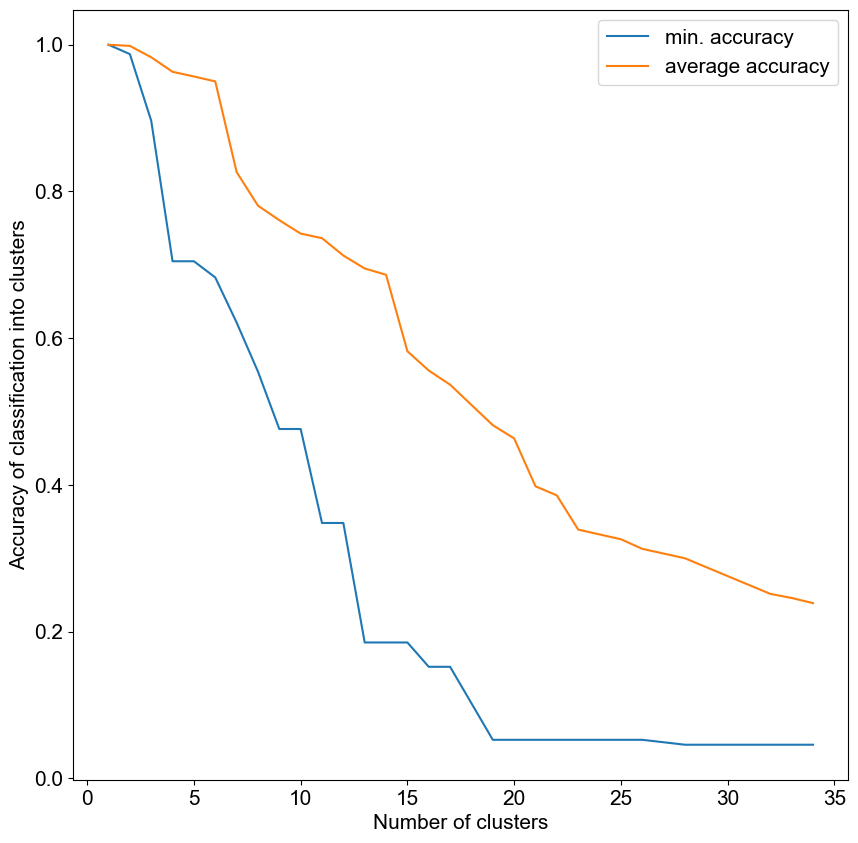

0.0 34.0 groups min accuracy 0.045810055865921795 av accuracy 0.23880149562192632
0.002002002002002002 34.0 groups min accuracy 0.045810055865921795 av accuracy 0.23880149562192632
0.004004004004004004 34.0 groups min accuracy 0.045810055865921795 av accuracy 0.23880149562192632
0.006006006006006006 34.0 groups min accuracy 0.045810055865921795 av accuracy 0.23880149562192632
0.008008008008008008 34.0 groups min accuracy 0.045810055865921795 av accuracy 0.23880149562192632
0.01001001001001001 34.0 groups min accuracy 0.045810055865921795 av accuracy 0.23880149562192632
0.012012012012012012 34.0 groups min accuracy 0.045810055865921795 av accuracy 0.23880149562192632
0.014014014014014014 34.0 groups min accuracy 0.045810055865921795 av accuracy 0.23880149562192632
0.016016016016016016 34.0 groups min accuracy 0.045810055865921795 av accuracy 0.23880149562192632
0.018018018018018018 34.0 groups min accuracy 0.045810055865921795 av accuracy 0.23880149562192632
0.02002002002002002 34.0 gro

<Figure size 640x480 with 0 Axes>

In [20]:
savename = "1Aug"
no_samples= 2
trial_num = 0

labels, class_matrix = np.load(base_filepath+"/"+savename+"_ordered_labels.npy", allow_pickle=True), np.load(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_trial_"+str(trial_num)+"_rearranged_class_matrix.npy", allow_pickle=True)
dists, max_confusions, av_confusions, num_groups =  calibrate_distance_function_by_max(class_matrix, labels, min_dist=0.0, max_dist=2, gran=1000)

fig, ax = plt.subplots(figsize=(10, 10))
plt.plot(num_groups, 1-max_confusions, label='min. accuracy')
plt.plot(num_groups, 1-av_confusions, label='average accuracy')
plt.xlabel("Number of clusters")
plt.ylabel("Accuracy of classification into clusters")
plt.legend()
#plt.hlines(0.8, xmin=min(num_groups), xmax=max(num_groups), linestyle='--', color='black')
#plt.hlines(0.9, xmin=min(num_groups), xmax=max(num_groups), linestyle='--', color='black')
#plt.hlines(0.95, xmin=min(num_groups), xmax=max(num_groups), linestyle='--', color='black')
fig.savefig(base_filepath+"/figs_0512"+"/"+savename+"_samples_clustering_accuracy.png", dpi=300)
plt.show()
plt.clf()

for n, (dist, conf) in enumerate(zip(dists, max_confusions)):
    print(dist, num_groups[n], "groups", "min accuracy", 1-conf, "av accuracy", 1-av_confusions[n]) #this prints accuracy


The smallest number of groups that includes one group which does not include genetic selection, i.e. one group which is definitely plastic,  is 5.  This gives us a minimum accuracy of 71% and an average accuracy of 96%. Thus this is the highest possible accuracy at which plasticity can be detected, i.e. at which a single category is definitely plastic-- this is where we set the threshold.

In [15]:
clustered, cluster_labels, text_labels_by_cluster = categorise(class_matrix, labels, distance_threshold=1)

label_dict_by_sample_number = {}
for n, text_labels in enumerate(text_labels_by_cluster):
    print(text_labels)
    for label in text_labels:
        label_dict_by_sample_number[label] = n

np.save(base_filepath+"/clustering_labels_"+str(no_samples)+".npy", label_dict_by_sample_number)

# np.save(base_filepath+"/clustering_labels_108.npy", labels)
# np.save(base_filepath+"/clustered_child_matrix_for_tree_plotting_108.npy", clustered.children_)
# np.save(base_filepath+"/clustered_labels_for_tree_plotting_108.npy", clustered.labels_)
# np.save(base_filepath+"/clustered_distances_for_tree_plotting_108.npy", clustered.distances_)
# np.save(base_filepath+"/clustering_model_108.npy", clustered)

['0.9_0.4_highsel' '1.0_0.6_lowsel' 'gen_0.6_lowsel']
['gen_0.4_nosel' '0.0_0.4_lowsel' '0.5_0.4_lowsel' '0.75_0.4_lowsel'
 '0.9_0.4_lowsel' '0.95_0.4_lowsel' '0.98_0.4_lowsel' '0.0_0.4_highsel'
 '0.5_0.4_highsel' '0.75_0.4_highsel' 'gen_0.6_nosel' '0.0_0.6_lowsel'
 '0.5_0.6_lowsel' '0.75_0.6_lowsel' '0.9_0.6_lowsel' '0.95_0.6_lowsel'
 '0.98_0.6_lowsel' '0.0_0.6_highsel' '0.5_0.6_highsel' '0.75_0.6_highsel']
['0.95_0.4_highsel' '0.98_0.4_highsel' '1.0_0.4_highsel' 'gen_0.4_highsel'
 '0.95_0.6_highsel' '0.98_0.6_highsel' '1.0_0.6_highsel' 'gen_0.6_highsel']
['1.0_0.4_lowsel' 'gen_0.4_lowsel']
['0.9_0.6_highsel']



Group 1: high mut, low selection / moderate plasticity, strong selection, low mut rate
Group 2: high plasticity/neutral evolution, at both mutation rates
Group 3: 95% heritability and over
Group 4: low selection, no plasticity, greater mutation rate
Group 5: specific type of plasticity (90% at high mut rate, strong selection).

NOTES: low mutation rate can cause confusion of low plasticity with strong selection. 

Name the groups in the order they appear in the clustering labels above. 

In [16]:
group_names = ["LS1", "NS", "HS", "LS2", "P"]
print(group_names)


label_dict = {}

for i, text_labels in enumerate(text_labels_by_cluster):
    for text_label in text_labels:
        label_dict[text_label] = group_names[i]

np.save(base_filepath+"/clustering_label_dict_108.npy", label_dict) #the names used for each group

['LS1', 'NS', 'HS', 'LS2', 'P']


Now repeat the classification pipeline: but here, instead of classifying scenarios, we're telling apart *groups* of scenarios.

In [17]:


#just convert labels through a dictionary
def convert_labels(ys, label_dict):
    new_labels = []
    for s in range(len(ys)):
        new_labels.append([label_dict[ys[s][0]]])
    return np.array(new_labels)

#run for 10 train/test splits, consider consistency of outcomes
def test_and_validate_full_problem_with_labels(savename, no_samples, params, label_dict, num_trials=10, test_size=0.2, valid_size=0.2, prefix="27Jul"):
    X_tt, X_valid, y_tt, y_valid, all_labels_in_order =  get_all_data(no_samples, valid_size=valid_size, prefix=prefix)
    #print(all_labels_in_order)
    y_tt, y_valid = convert_labels(y_tt, label_dict), convert_labels(y_valid, label_dict) #superimpose labels
    np.save(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_X_valid.npy", X_valid)
    np.save(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_y_valid.npy", y_valid)
    all_labels_in_order = np.array(np.sort(list(set(list(label_dict.values()))))) #recompute after superimposition
    #print(y_tt, all_labels_in_order)
    #print(all_labels_in_order)
    y_tt_bin, y_valid_bin = manual_label_conversion(y_tt, all_labels_in_order), manual_label_conversion(y_valid, all_labels_in_order)
    #print(y_tt_bin.shape, len(all_labels_in_order))
    overall_outcomes_assigned = []
    total_importances = []
    np.save(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_labels.npy", all_labels_in_order)
    for no_trial in range(num_trials):
        X_train, X_test, y_train, y_test = tt_split(X_tt, y_tt_bin, test_size=test_size) #split a different way, keeping validation set
        classifiers, assigned_outcomes, class_matrix, confusion_matrix, fprs, tprs, all_threshes = train_model_opt(X_train, X_test, y_train, y_test, all_labels_in_order, params)
        y_pred_valid = predict_on_test_set(classifiers, X_valid)
        valid_assigned_outcomes, y_pred_valid_norm = assign_outcomes(y_pred_valid)
        overall_outcomes_assigned.append(valid_assigned_outcomes) #these should all be the same
        np.save(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_trial_"+str(no_trial)+"_rocs_per_class.npy", np.array([fprs, tprs, all_threshes], dtype=object))
        np.save(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_trial_"+str(no_trial)+"_matrices.npy", [class_matrix, confusion_matrix])
        #np.save(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_trial_"+str(no_trial)+"_labels.npy", all_labels_in_order)
        all_importances = []
        for label, clf in zip(all_labels_in_order, classifiers):
            importances = clf.feature_importances_
            all_importances.append(importances)
        total_importances.append(all_importances)
    num_valid_points, num_classes = y_valid_bin.shape
    y_as_number = np.array([np.where(y_valid_bin[n]==1)[0][0] for n in range(num_valid_points)])
    return y_as_number, overall_outcomes_assigned, all_labels_in_order, total_importances

Now test this and make importance and consistency matrix.

In [18]:
def distinguish_groups(savename, no_samples, label_dict, params = {'learning_rate': 0.2, 'max_depth': 3, 'subsample': 0.6, 'colsample_bytree': 0.8, 'min_child_weight': 1, 'reg_alpha': 0.1, 'reg_lambda': 1, 'gamma': 0.5, 'n_estimators': 100}, num_trials=10, test_size=0.2, valid_size=0.1):

    y_as_number, overall_outcomes_assigned, all_labels_in_order, total_importances = test_and_validate_full_problem_with_labels(savename, no_samples, params, label_dict, num_trials=num_trials, test_size=test_size, valid_size=valid_size)
    np.save(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_y_as_number.npy", y_as_number) #numerical labels
    np.save(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_overall_outcomes_assigned.npy", np.array(overall_outcomes_assigned)) #results of classification
    np.save(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_all_labels_in_order.npy", all_labels_in_order) 
    np.save(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_total_importances.npy", np.array(total_importances)) #all importances across runs

label_dict = np.load(base_filepath+"/clustering_label_dict_108.npy", allow_pickle=True).item()
for no_samples in range(2, 9):
    distinguish_groups("1Aug_with_labels", no_samples, label_dict)

['27Jul_gen_0.4_nosel', '27Jul_0.0_0.4_lowsel', '27Jul_0.5_0.4_lowsel', '27Jul_0.75_0.4_lowsel', '27Jul_0.9_0.4_lowsel', '27Jul_0.95_0.4_lowsel', '27Jul_0.98_0.4_lowsel', '27Jul_1.0_0.4_lowsel', '27Jul_gen_0.4_lowsel', '27Jul_0.0_0.4_highsel', '27Jul_0.5_0.4_highsel', '27Jul_0.75_0.4_highsel', '27Jul_0.9_0.4_highsel', '27Jul_0.95_0.4_highsel', '27Jul_0.98_0.4_highsel', '27Jul_1.0_0.4_highsel', '27Jul_gen_0.4_highsel', '27Jul_gen_0.6_nosel', '27Jul_0.0_0.6_lowsel', '27Jul_0.5_0.6_lowsel', '27Jul_0.75_0.6_lowsel', '27Jul_0.9_0.6_lowsel', '27Jul_0.95_0.6_lowsel', '27Jul_0.98_0.6_lowsel', '27Jul_1.0_0.6_lowsel', '27Jul_gen_0.6_lowsel', '27Jul_0.0_0.6_highsel', '27Jul_0.5_0.6_highsel', '27Jul_0.75_0.6_highsel', '27Jul_0.9_0.6_highsel', '27Jul_0.95_0.6_highsel', '27Jul_0.98_0.6_highsel', '27Jul_1.0_0.6_highsel', '27Jul_gen_0.6_highsel']
27Jul_gen_0.4_nosel gen_0.4_nosel 5000
27Jul_0.0_0.4_lowsel 0.0_0.4_lowsel 5000
27Jul_0.5_0.4_lowsel 0.5_0.4_lowsel 4992
27Jul_0.75_0.4_lowsel 0.75_0.4_lowse

['HS' 'LS1' 'LS2' 'NS' 'P']


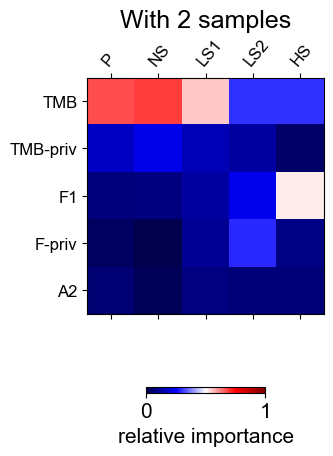

['HS' 'LS1' 'LS2' 'NS' 'P']


<Figure size 640x480 with 0 Axes>

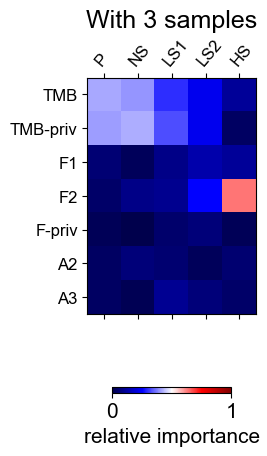

['HS' 'LS1' 'LS2' 'NS' 'P']


<Figure size 640x480 with 0 Axes>

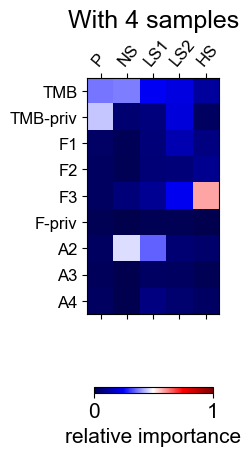

['HS' 'LS1' 'LS2' 'NS' 'P']


<Figure size 640x480 with 0 Axes>

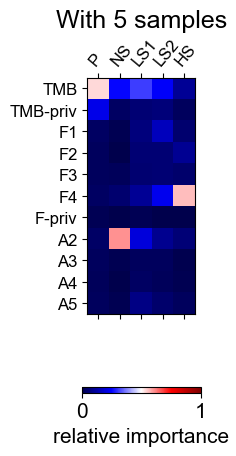

['HS' 'LS1' 'LS2' 'NS' 'P']


<Figure size 640x480 with 0 Axes>

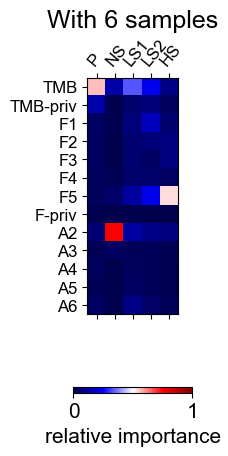

['HS' 'LS1' 'LS2' 'NS' 'P']


<Figure size 640x480 with 0 Axes>

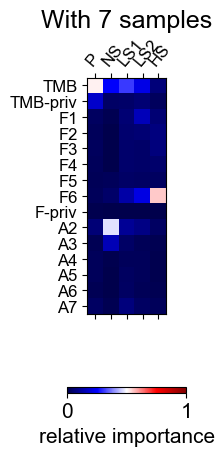

['HS' 'LS1' 'LS2' 'NS' 'P']


<Figure size 640x480 with 0 Axes>

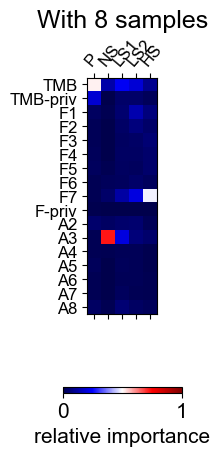

<Figure size 640x480 with 0 Axes>

In [53]:
def plot_importances_group(savename, no_samples, level_mut = 70, level_sel = 50):

    all_labels_in_order = np.load(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_all_labels_in_order.npy", allow_pickle=True)
    total_importances = np.load(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_total_importances.npy", allow_pickle=True)
    num_runs, num_groups, num_features = total_importances.shape

    print(all_labels_in_order)
    
    stat_names = ["TMB", "TMB-priv"] + ["F"+str(s) for s in range(1, no_samples)]+ ["F-priv"] + ["A"+str(s) for s in range(2, no_samples+1)]

    desired_order =np.array(["P", "NS", "LS1", "LS2", "HS"])

    
    importance_matrix = np.zeros((num_features, num_groups))
    for n in range(num_groups):
        for m in range(num_features):
            importance_matrix[m][n] = np.average(total_importances[:, n, m])
        importance_matrix[:, n] /= np.sum(importance_matrix[:, n])

    for n in range(num_groups):
        for m in range(num_features):
            importance_matrix[m][n] = np.average(total_importances[:, n, m])
        importance_matrix[:, n] /= np.sum(importance_matrix[:, n])

    #reorder all columns in this matrix
    reordered_imp_matrix = np.zeros((num_features, num_groups))
    for n in range(num_groups):
        n_ = np.where(desired_order==all_labels_in_order[n])[0][0]
        #print(all_labels_in_order[n], n_, num_features, num_groups)
        reordered_imp_matrix[:, n_] = importance_matrix[:, n]
    
    fig, ax = plt.subplots()
    im = ax.matshow(reordered_imp_matrix, origin='lower', cmap=mpl.cm.seismic, vmin=0, vmax=1)
    cbar=plt.colorbar(im, label='relative importance', location='bottom', pad=0.2, shrink=0.2)
    ax.set_xticks(range(num_groups), labels=desired_order, fontsize=12)
    plt.xticks(rotation=50, rotation_mode='anchor', horizontalalignment='left', verticalalignment='bottom')
    ax.set_yticks(range(num_features), labels=stat_names, fontsize=12)
    plt.title("With "+str(no_samples) + " samples")
    plt.tight_layout()
    ax.invert_yaxis()
    fig.savefig(base_filepath+"/figs_0512"+"/"+savename+"_importance_gain_"+str(no_samples)+".png", format="png", dpi=300)
    fig.savefig(base_filepath+"/figs_0512"+"/"+savename+"_importance_gain_"+str(no_samples)+".pdf", format="pdf", dpi=300)
    plt.show()
    plt.clf()

                    


for no_samples in range(2, 9):
    plot_importances_group("1Aug_with_labels", no_samples)



Now plot the relative value of each feature from each group.

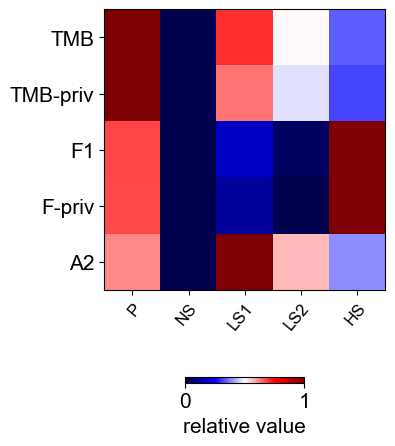

<Figure size 640x480 with 0 Axes>

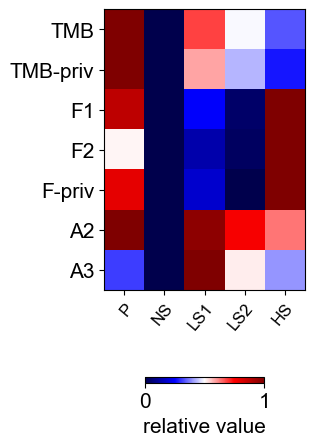

<Figure size 640x480 with 0 Axes>

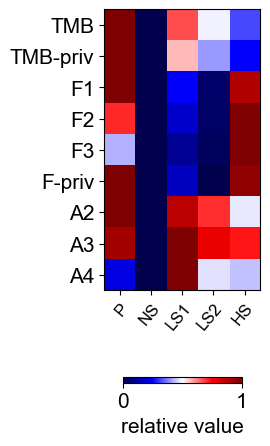

<Figure size 640x480 with 0 Axes>

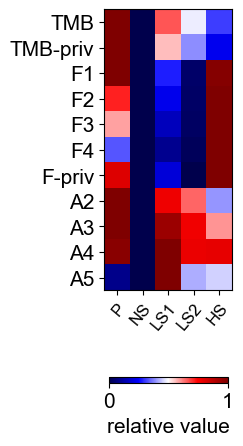

<Figure size 640x480 with 0 Axes>

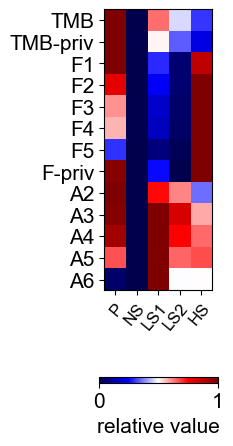

<Figure size 640x480 with 0 Axes>

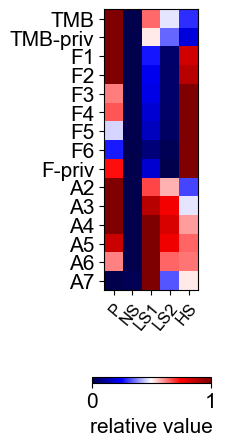

<Figure size 640x480 with 0 Axes>

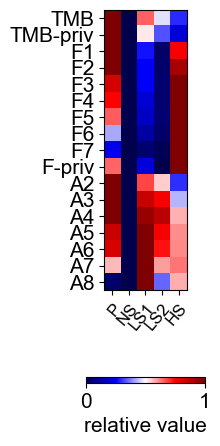

<Figure size 640x480 with 0 Axes>

In [60]:
def plot_relative_values_groups(savename, no_samples, level_mut = 70, level_sel = 50, trial_num=0):
    X_valid, y_valid = np.load(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_X_valid.npy", allow_pickle=True), np.load(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_y_valid.npy", allow_pickle=True)
    stat_names = ["TMB", "TMB-priv"] + ["F"+str(s) for s in range(1, no_samples)]+ ["F-priv"] + ["A"+str(s) for s in range(2, no_samples+1)]

    overall_outcomes_assigned, all_labels_in_order = np.load(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_overall_outcomes_assigned.npy", allow_pickle=True), np.load(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_all_labels_in_order.npy", allow_pickle=True)

    #arrange scenarios
    ordered_labels =   np.array(["P", "NS", "LS1", "LS2", "HS"])

    num_groups = len(ordered_labels)
    num_features = len(stat_names)

    value_matrix = np.zeros((len(stat_names), len(ordered_labels))) #initially this holds the average value of each sum stat for each scenario

    for m, label in enumerate(ordered_labels): #for each scenario
        outcome_index = np.where(all_labels_in_order==label)[0][0] #find index in list
        indices = np.where(overall_outcomes_assigned[trial_num]==outcome_index)[0] #find relevant stats- those assigned to this category during one run
        rel_stats = X_valid[indices]
        for n in range(len(stat_names)):
            value_matrix[n][m] = np.average(rel_stats[:, n]) #the average of the nth summary statistic

    #now scale the averages across scenarios, to show their relative values
    #note that importance gain is normalised across STATISTICS for each SCENARIO
    #this is normalised across SCENARIOS for each statistic
    for n in range(len(stat_names)):
        rel_min, rel_max = np.min(value_matrix[n]), np.max(value_matrix[n])
        for m in range(len(ordered_labels)):
            value_matrix[n][m] = (value_matrix[n][m] - rel_min)/(rel_max-rel_min) #the scenario with the highest value summary stat has value 1 here, and min has value 0


    fig, ax = plt.subplots()
    im= ax.matshow(value_matrix, origin='lower', cmap=mpl.cm.seismic, vmin=0, vmax=1)
    cbar=plt.colorbar(im, label='relative value', location='bottom', pad=0.2, shrink=0.2)
    ax.tick_params(top=False, bottom=True,
                   labeltop=False, labelbottom=True)
    ax.set_xticks(range(num_groups), labels=ordered_labels, fontsize=10)
    plt.xticks(rotation=50, rotation_mode='anchor', horizontalalignment='right', verticalalignment='top', fontsize=12)
    ax.set_yticks(range(num_features), labels=stat_names, fontsize=15)
    #plt.title("Relative value, with "+str(no_samples) + " samples", fontsize=15)
    plt.tight_layout()
    ax.invert_yaxis()
    fig.savefig(base_filepath+"/figs_0512"+"/"+savename+"_value_"+str(no_samples)+".png", format="png", dpi=300)
    fig.savefig(base_filepath+"/figs_0512"+"/"+savename+"_value_"+str(no_samples)+".pdf", format="pdf", dpi=300)
    plt.show()
    plt.clf()

    

for no_samples in range(2, 9):
    plot_relative_values_groups("1Aug_with_labels", no_samples)

Make the classification and confusion matrix, and the ROC curves, at the group level.

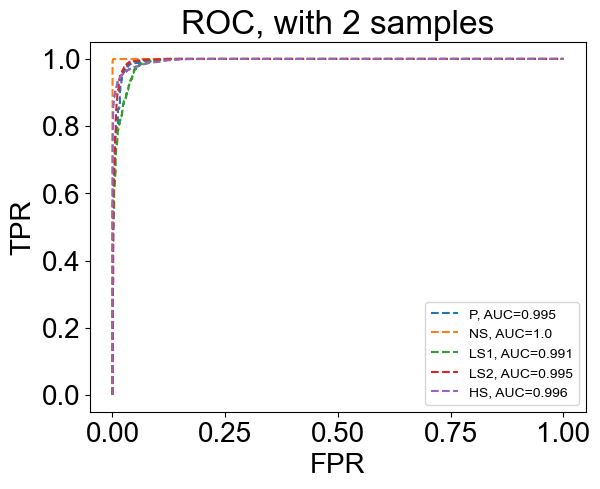

<Figure size 640x480 with 0 Axes>

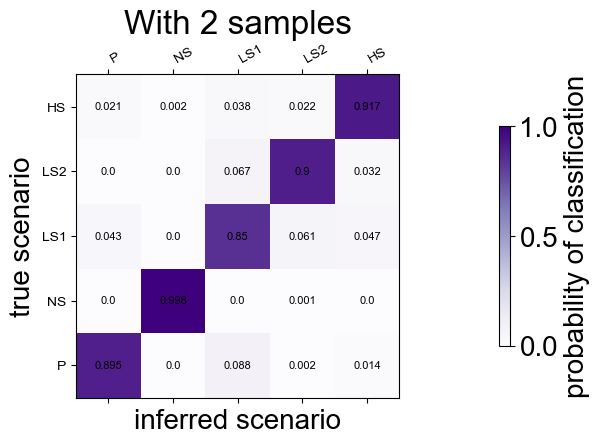

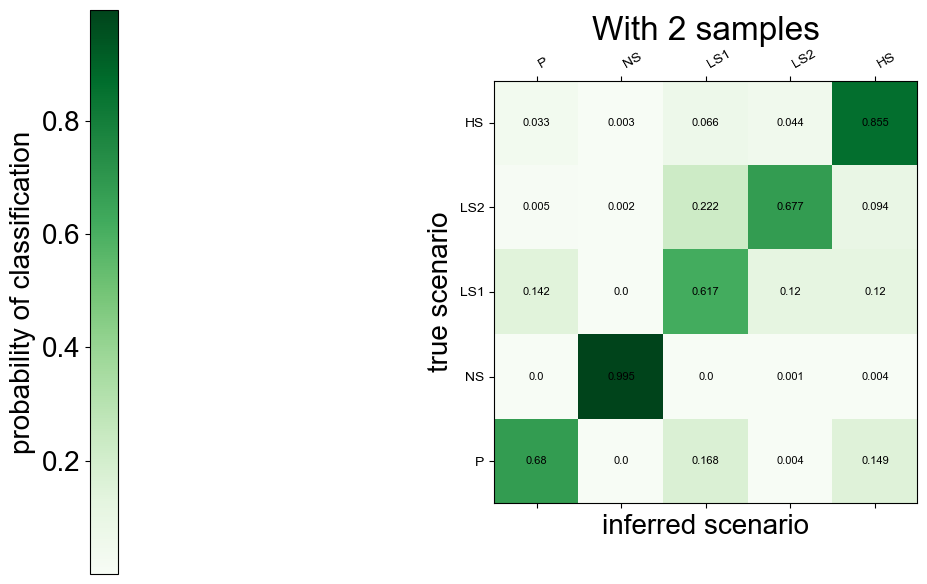

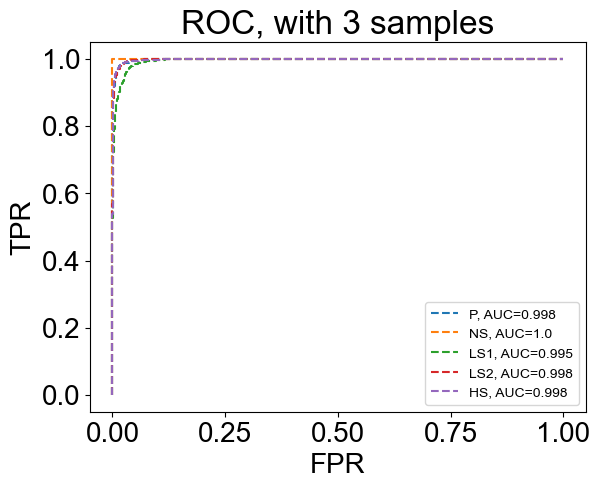

<Figure size 640x480 with 0 Axes>

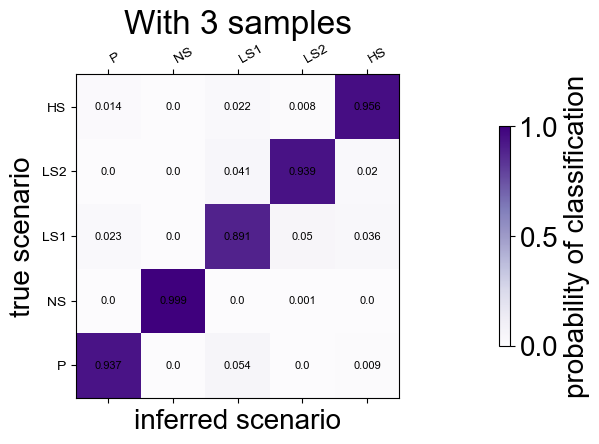

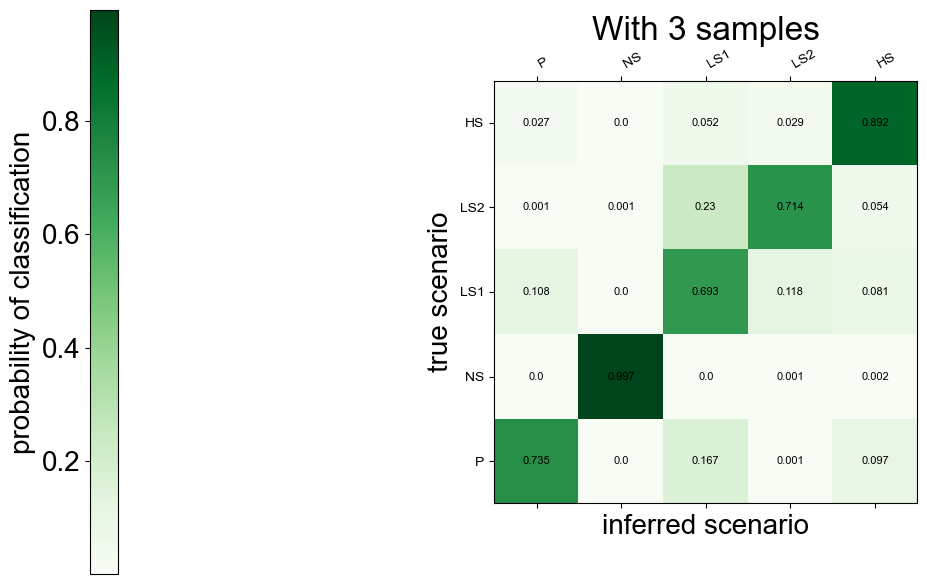

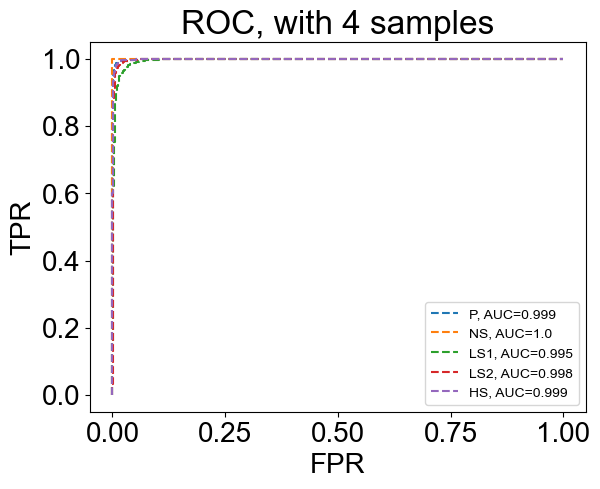

<Figure size 640x480 with 0 Axes>

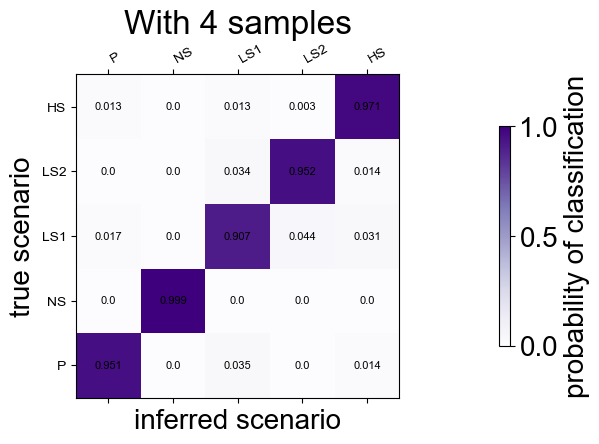

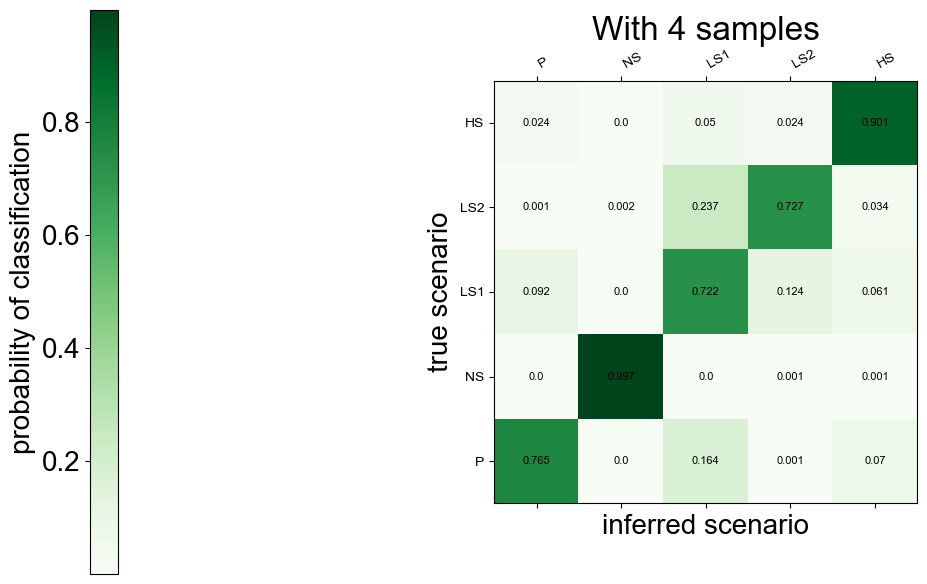

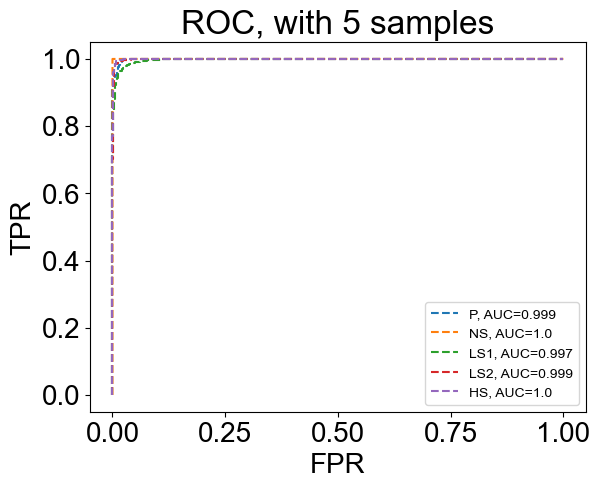

<Figure size 640x480 with 0 Axes>

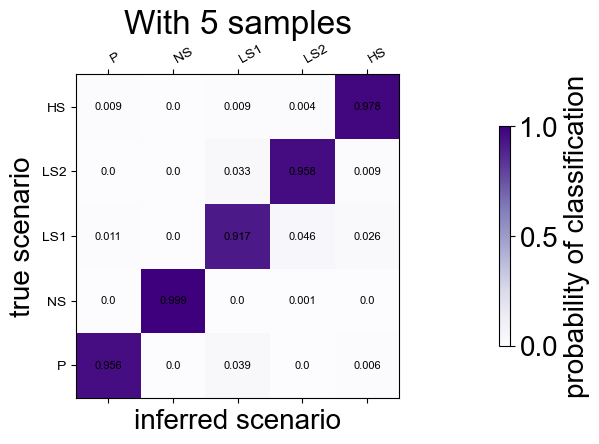

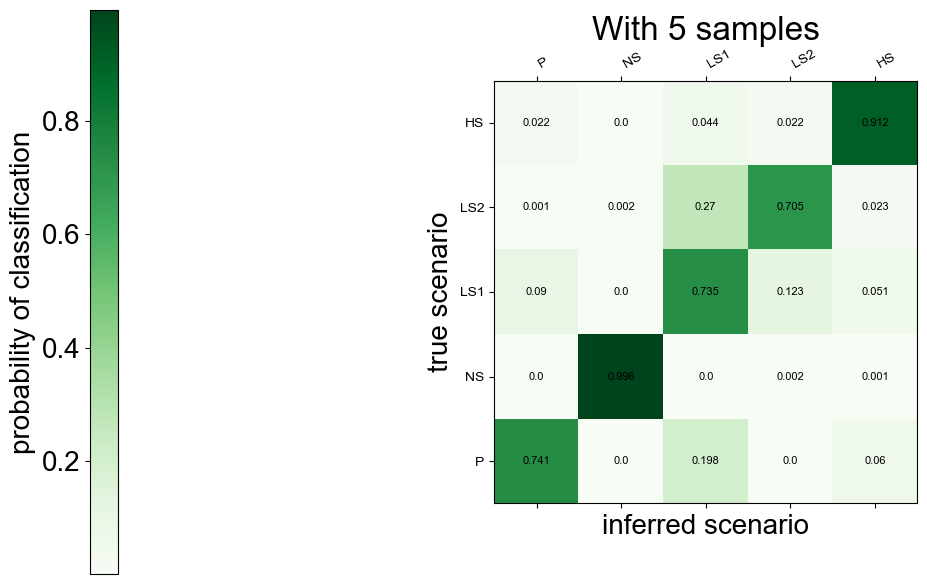

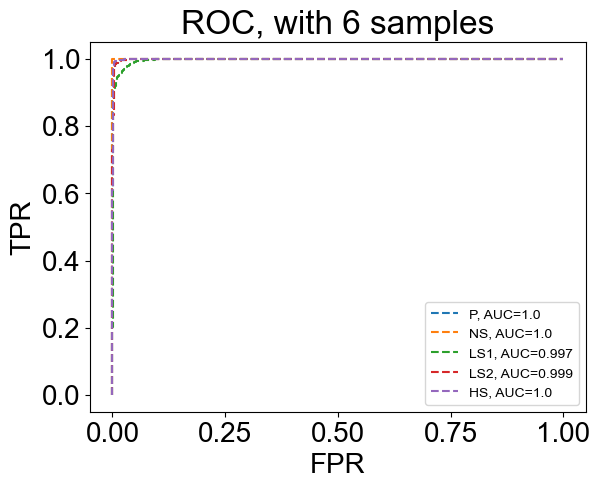

<Figure size 640x480 with 0 Axes>

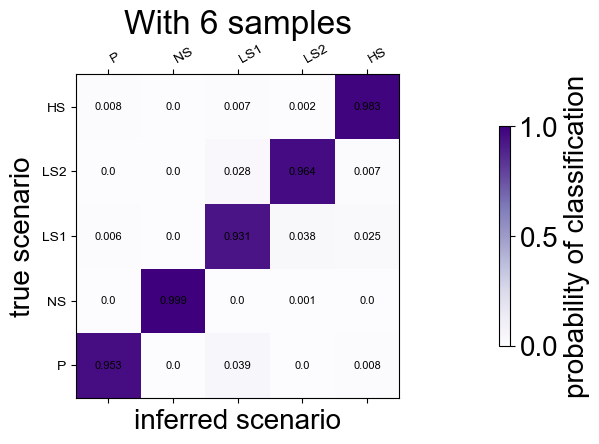

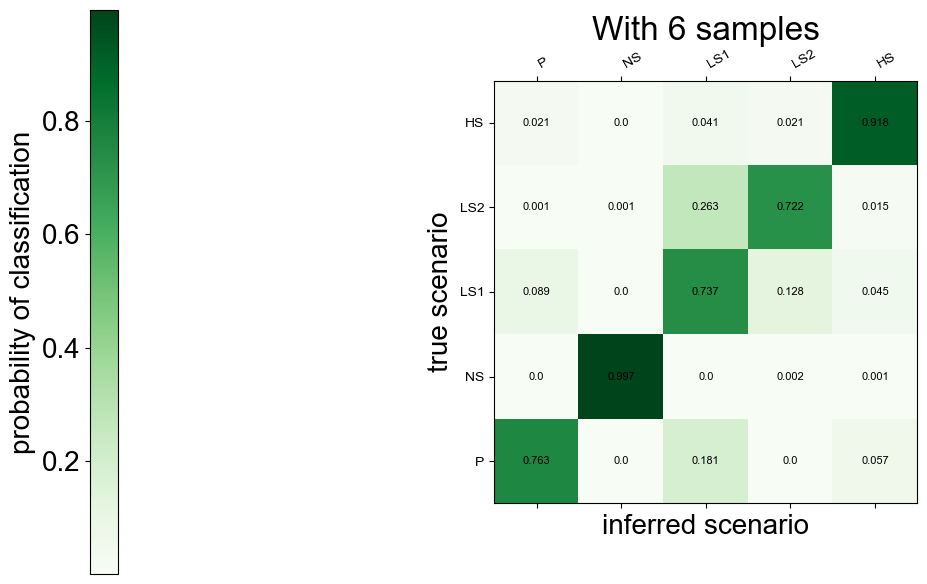

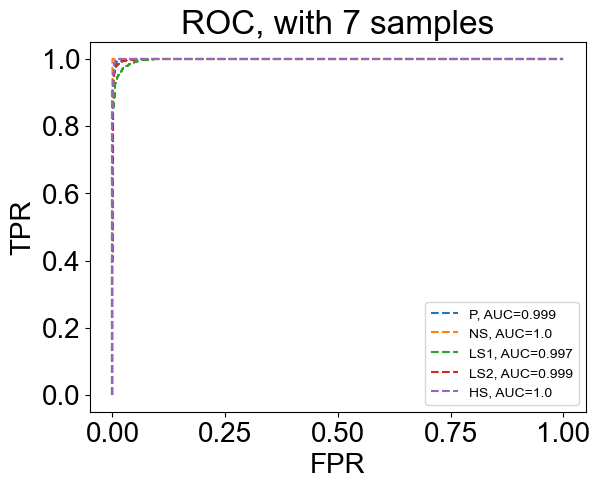

<Figure size 640x480 with 0 Axes>

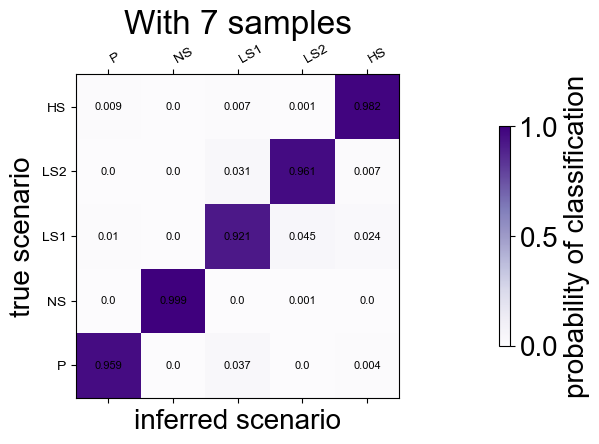

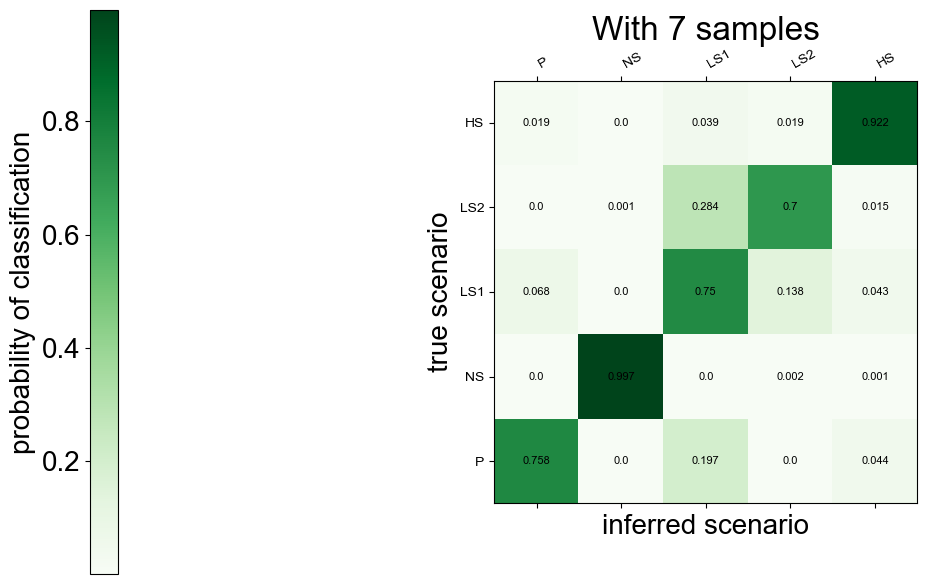

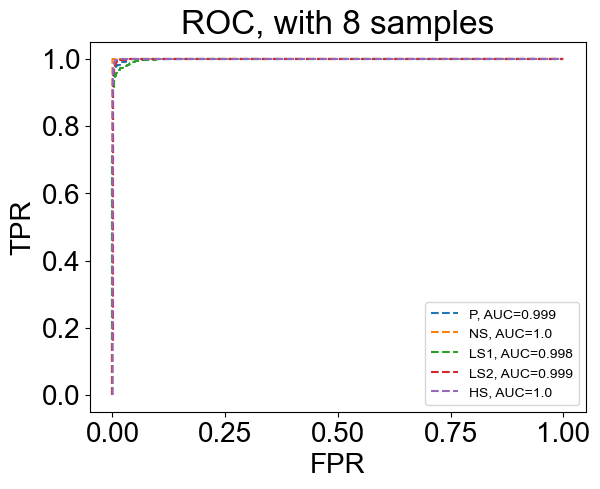

<Figure size 640x480 with 0 Axes>

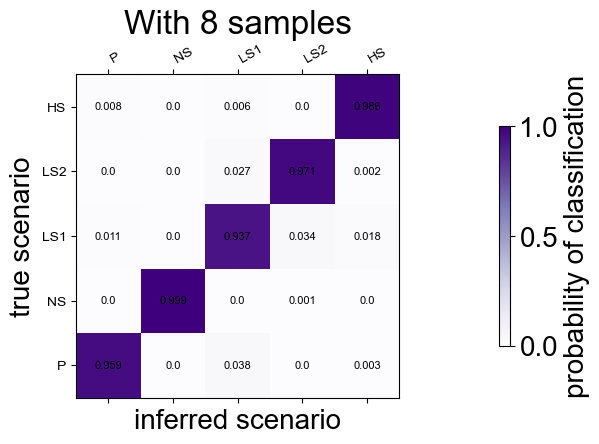

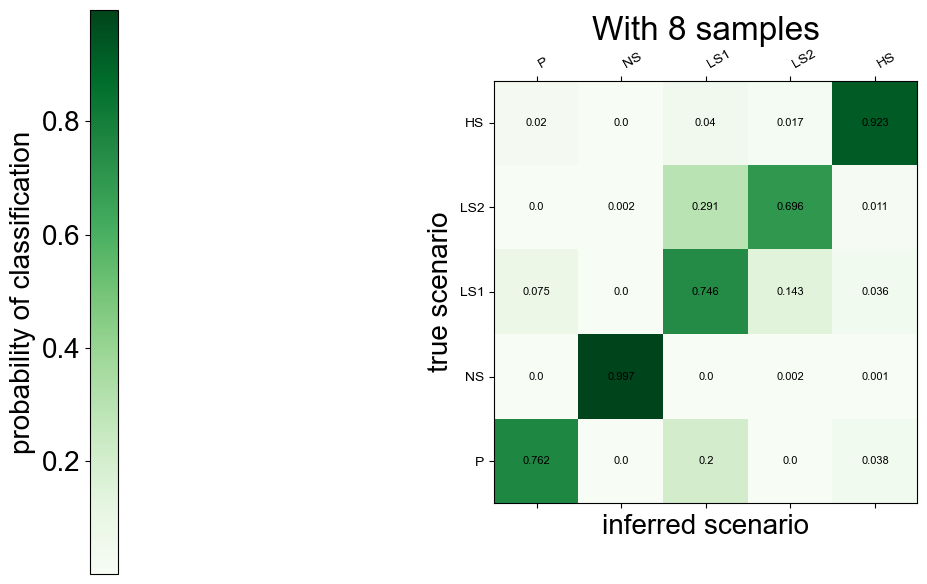

In [38]:
def plot_confusion_group(savename, no_samples, trial_num=0):

    
    [fprs, tprs, all_threshes] = np.load(base_filepath+savename+"_samples_"+str(no_samples)+"_trial_"+str(trial_num)+"_rocs_per_class.npy", allow_pickle=True)
    [class_matrix, confusion_matrix]= np.load(base_filepath+savename+"_samples_"+str(no_samples)+"_trial_"+str(trial_num)+"_matrices.npy", allow_pickle=True)
    labels = np.load(base_filepath+savename+"_samples_"+str(no_samples)+"_labels.npy", allow_pickle=True)
    
     #use text labels
    num_classes = len(labels)
    
    group_names =  np.array(["P", "NS", "LS1", "LS2", "HS"])
        
    
    #arrange
    positions_dict = {}
    for n, label in enumerate(group_names):
        index = np.where(labels==label)[0][0]
        positions_dict[index] = n #links positions in the returned list to desired position
    
    rearranged_class_matrix = np.zeros_like(class_matrix)
    rearranged_conf_matrix =  np.zeros_like(confusion_matrix)
    
    for m in range(len(rearranged_class_matrix)):
        m_ = positions_dict[m]
        for n in range(len(rearranged_class_matrix)):
            n_ = positions_dict[n]
            rearranged_class_matrix[m_][n_] = class_matrix[m][n]
            rearranged_conf_matrix[m_][n_] = confusion_matrix[m][n]
        
    np.save(base_filepath+savename+"_samples_"+str(no_samples)+"_trial_"+str(trial_num)+"_rearranged_class_matrix.npy", rearranged_class_matrix)
    
    fig, ax = plt.subplots()
    for label in group_names:
        i = np.where(labels==label)[0][0]
        auc = np.trapz(y=tprs[i], x=fprs[i])
        ax.plot(fprs[i], tprs[i], '--', label=label+ ", AUC="+str(np.around(auc, decimals=3)))
    ax.set_xlabel("FPR")
    ax.set_ylabel("TPR")
    ax.set_title("ROC, with "+str(no_samples)+" samples")
    plt.legend(fontsize=10)
    fig.savefig(base_filepath+"/figs_0512"+"/"+savename+"_roc_curve_"+str(no_samples)+".png", format="png", dpi=300)
    plt.show()
    plt.clf()
    
    #plt.rc('font', size=10) # This line makes it work!
    
    fig, ax = plt.subplots()
    im = ax.matshow(rearranged_class_matrix, origin='lower', cmap=mpl.cm.Purples, vmin=0, vmax=1)
    # Loop through all matrix elements and superimpose the values
    for i in range(num_classes):
        for j in range(num_classes):
            ax.text(j, i, str(np.around(rearranged_class_matrix[i, j], decimals=3)), va='center', ha='center', color='black', fontsize=8)
    plt.colorbar(im, label='probability of classification', location='right', pad=0.2, shrink=0.6)
    ax.set_xticks(range(num_classes), labels=group_names, fontsize=10)
    ax.set_yticks(range(num_classes), labels=group_names, fontsize=10)
    #ax.set_yticks(range(num_classes), labels=labels, fontsize='x-small')
    ax.set_ylabel("true scenario")
    ax.set_xlabel("inferred scenario")
    plt.xticks(rotation=30, rotation_mode='default', ha="left")
    ax.set_title("With "+str(no_samples)+" samples")
    plt.tight_layout()
    fig.savefig(base_filepath+"/figs_0512"+"/"+savename+"_class_matrix_"+str(no_samples)+".png", format="png", dpi=300)
    plt.show()

    fig, ax = plt.subplots(figsize=(10, 10))
    im = ax.matshow(rearranged_conf_matrix, origin='lower', cmap=mpl.cm.Greens)
    # Loop through all matrix elements and superimpose the values
    for i in range(num_classes):
        for j in range(num_classes):
            ax.text(j, i, str(np.around(rearranged_conf_matrix[i, j], decimals=3)), va='center', ha='center', color='black', fontsize=8)
    plt.colorbar(im, label='probability of classification', location='left', pad=0.4, shrink=0.6)
    ax.set_xticks(range(num_classes), labels=group_names, fontsize=10)
    ax.set_yticks(range(num_classes), labels=group_names, fontsize=10)
    #ax.set_yticks(range(num_classes), labels=labels, fontsize='x-small')
    ax.set_ylabel("true scenario")
    ax.set_xlabel("inferred scenario")
    plt.xticks(rotation=30, rotation_mode='default', ha="left")
    ax.set_title("With "+str(no_samples)+" samples")
    plt.tight_layout()
    fig.savefig(base_filepath+"/figs_0512"+"/"+savename+"_conf_matrix_"+str(no_samples)+".png", format="png", dpi=300)
    #ax.set_title("Classification matrix, "+str(no_samples)+" samples")
    plt.show()

for no_samples in range(2, 9):
    plot_confusion_group("1Aug_with_labels", no_samples)

Now make accuracy barchart at the group level.

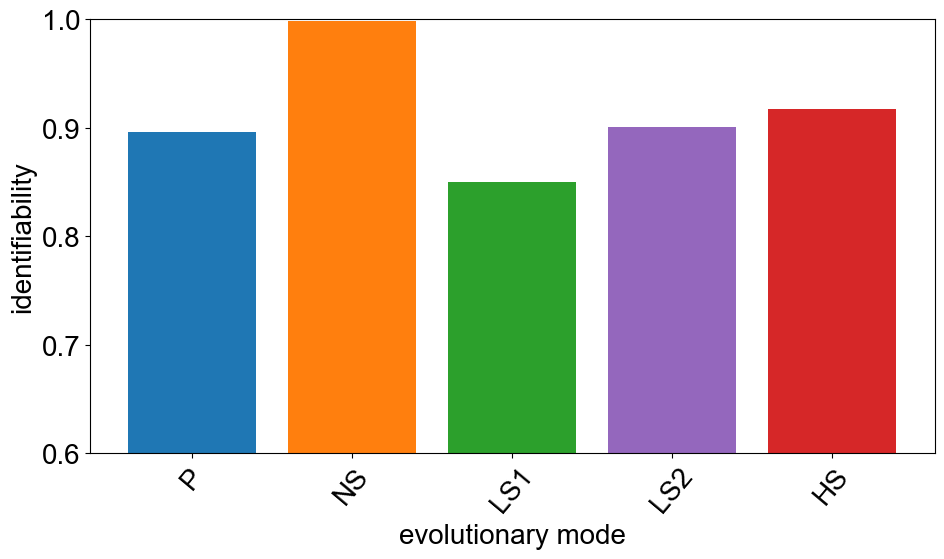

<Figure size 640x480 with 0 Axes>

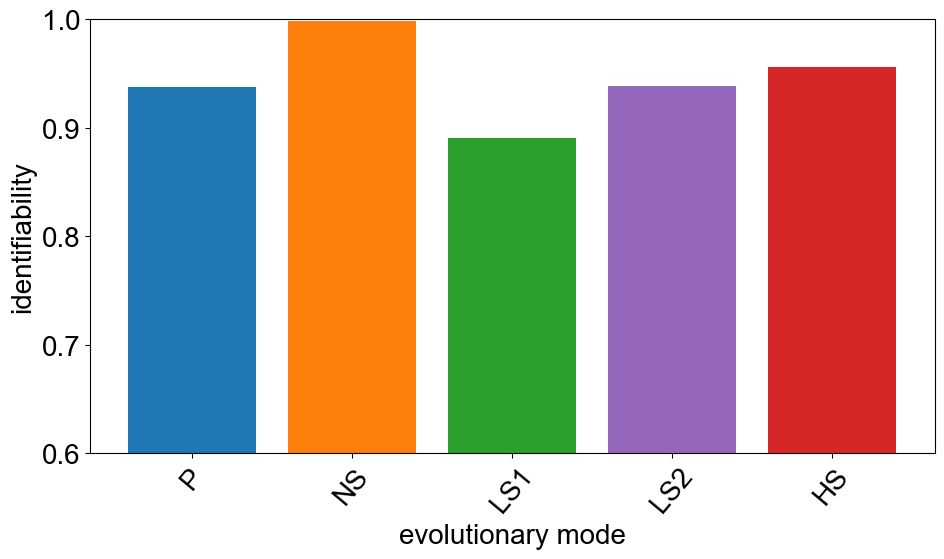

<Figure size 640x480 with 0 Axes>

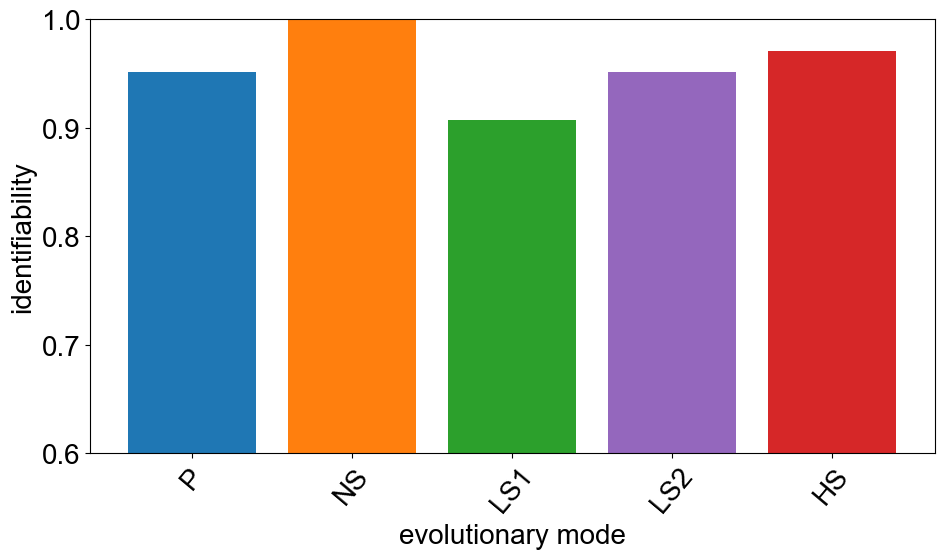

<Figure size 640x480 with 0 Axes>

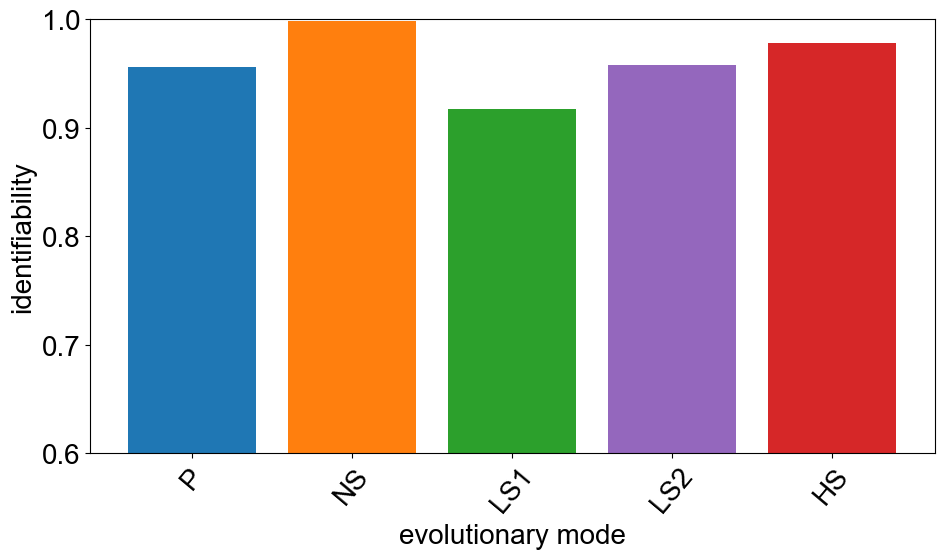

<Figure size 640x480 with 0 Axes>

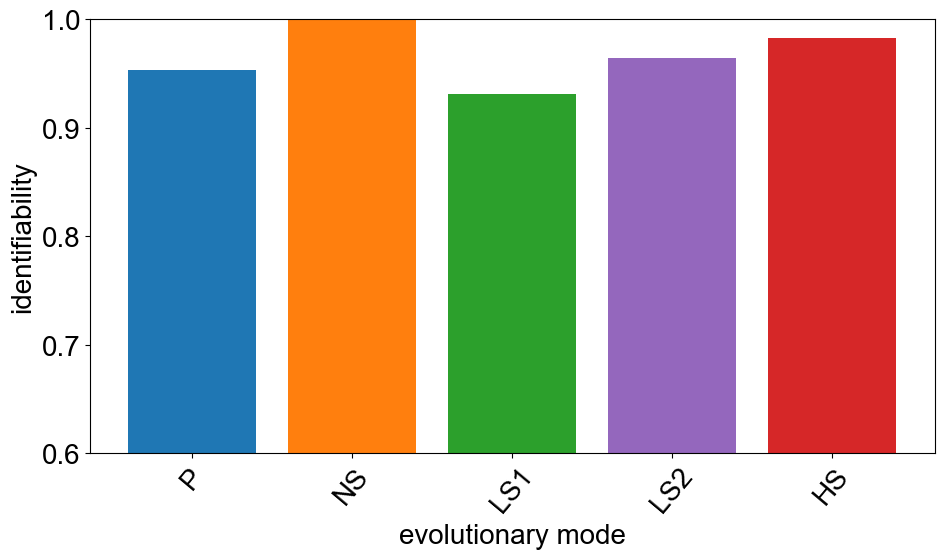

<Figure size 640x480 with 0 Axes>

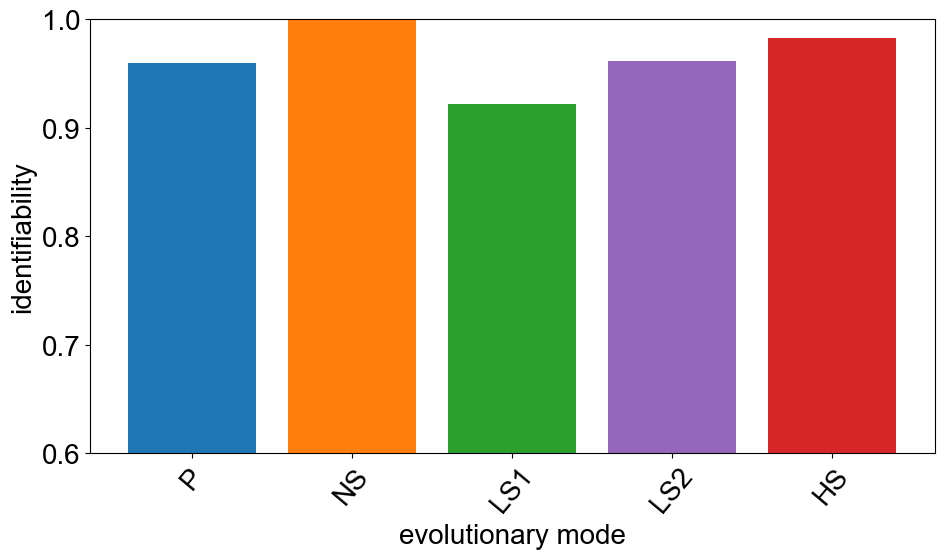

<Figure size 640x480 with 0 Axes>

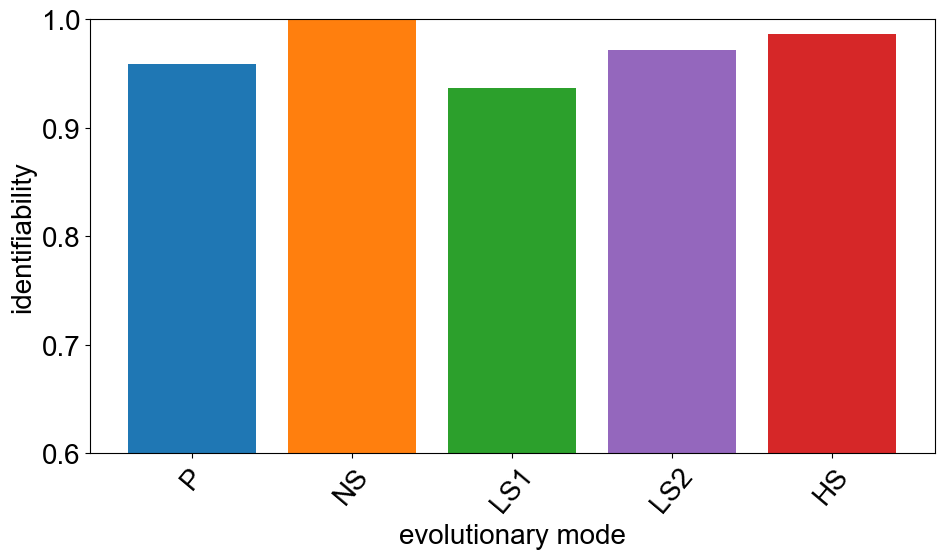

<Figure size 640x480 with 0 Axes>

In [29]:
def accuracy_barchart_group(savename, no_samples, trial_num=0, default_colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#9467bd', '#d62728']):
    #load class_matrix
    class_mat = np.load(base_filepath+savename+"_samples_"+str(no_samples)+"_trial_"+str(trial_num)+"_rearranged_class_matrix.npy", allow_pickle=True)
    class_acc = [class_mat[n][n] for n in range(len(class_mat))]

    labels_for_display = np.array(["P", "NS", "LS1", "LS2", "HS"])

    fig, ax = plt.subplots(figsize=(10, 6))
    ax.bar(range(len(class_acc)), class_acc, color=default_colors)
    ax.set_xticks(range(len(class_acc)), labels_for_display, rotation=50)
    plt.xlabel("evolutionary mode")
    plt.ylabel("identifiability")
    plt.ylim(0.6, 1)
    plt.tight_layout()
    #plt.xlim(-0.5, 6)
    plt.show()
    fig.savefig(base_filepath+"/figs_0512"+"/"+savename+"_accuracy_bar_group_"+str(no_samples)+".png", format="png", dpi=300)
    plt.clf()
    
plt.rcParams['font.size'] = 20

for no_samples in range(2, 9):
    accuracy_barchart_group("1Aug_with_labels", no_samples)

Okay, this is about an 88% confidence, increased by retraining on scenario-group labels.

Now classify each REAL tumour into each group.


In [24]:
def generate_model(no_samples, params, label_dict, valid_size=0.1, prefix="27Jul"):
    X_tt, X_valid, y_tt, y_valid, all_labels_in_order =  get_all_data(no_samples, valid_size=valid_size, prefix=prefix) #valid_sizeno validation size
    y_tt, y_valid = convert_labels(y_tt, label_dict), convert_labels(y_valid, label_dict) #superimpose labels
    all_labels_in_order = np.array(np.sort(list(set(list(label_dict.values()))))) #recompute after superimposition, should ensure same order
    #print(y_tt, all_labels_in_order)
    #print(all_labels_in_order)
    y_tt_bin, y_valid_bin = manual_label_conversion(y_tt, all_labels_in_order), manual_label_conversion(y_valid, all_labels_in_order)
    num_categs = len(all_labels_in_order)
    classifiers = []
    for i in range(num_categs):
        clf, no_samples = classify_on_class_with_params(i, X_tt, y_tt_bin, params)
        #discard information on sample number
        classifiers.append(clf)
    return classifiers, all_labels_in_order

In [25]:
patient_index_dict = np.load("patient_index_dict.npy", allow_pickle=True).item() #the index a patient's clinical data is stored in, in the clinical matrix
clinical_var_matrix = np.load("clinical_var_matrix.npy", allow_pickle=True) #clinical data stored at the relevant index

num_samples = np.load("num_samples_by_tumour_name.npy", allow_pickle=True).item() #each patient's ID is the key, the number of relevant samples is the index
#tIDs = np.load("all_tumour_names.npy", allow_pickle=True) #tumour IDs
num_patients = len(clinical_var_matrix)

repeats = 50
num_groups = len(group_names)

assigned_frequencies = np.zeros((num_patients, repeats, num_groups)) #record the posterior probabilities assigned to each patient
num_subclonal_mutations = np.zeros(num_patients, dtype=np.int64)
params = {'learning_rate': 0.2, 'max_depth': 3, 'subsample': 0.6, 'colsample_bytree': 0.8, 'min_child_weight': 1, 'reg_alpha': 0.1, 'reg_lambda': 1, 'gamma': 0.5, 'n_estimators': 100}

base_labels = []

#for each number of samples, train up our model
for r in range(repeats):
    for no_samples in range(2, 9):
        classifiers, labels = generate_model(no_samples, params, label_dict, valid_size=0.1)
        if len(base_labels) == 0:
            base_labels = labels
        else:
            if not np.array_equal(labels, base_labels):
                raise Exception("Labels have been re-ordered.")
        for tumour_name, rel_index in patient_index_dict.items(): #go through each tumour
            num_regions = num_samples[tumour_name] #patient-index is the more restrictive dictionary
            if num_regions == no_samples:
                rel_index = patient_index_dict[tumour_name]
                input_stats = np.array([np.load(base_filepath+"/"+tumour_name+"_ss_4424.npy", allow_pickle=True)])
                num_subclonal_mutations[rel_index] = input_stats[0][0] #this is always 'number of observed mutations', which is always subclonal
                freqs = predict_on_test_set(classifiers, input_stats) #returns non-normalised freqs
                assigned_frequencies[rel_index][r] = freqs/np.sum(freqs) #normalise these probabilities
                print(tumour_name, labels[np.argmax(assigned_frequencies[rel_index][r])])

np.save("cruk_deduced_classifier_probs_108.npy", assigned_frequencies)
np.save("cruk_deduced_classifier_labels_108.npy", base_labels)
np.save("cruk_number_subclonal_mutations_108.npy", num_subclonal_mutations)


['27Jul_gen_0.4_nosel', '27Jul_0.0_0.4_lowsel', '27Jul_0.5_0.4_lowsel', '27Jul_0.75_0.4_lowsel', '27Jul_0.9_0.4_lowsel', '27Jul_0.95_0.4_lowsel', '27Jul_0.98_0.4_lowsel', '27Jul_1.0_0.4_lowsel', '27Jul_gen_0.4_lowsel', '27Jul_0.0_0.4_highsel', '27Jul_0.5_0.4_highsel', '27Jul_0.75_0.4_highsel', '27Jul_0.9_0.4_highsel', '27Jul_0.95_0.4_highsel', '27Jul_0.98_0.4_highsel', '27Jul_1.0_0.4_highsel', '27Jul_gen_0.4_highsel', '27Jul_gen_0.6_nosel', '27Jul_0.0_0.6_lowsel', '27Jul_0.5_0.6_lowsel', '27Jul_0.75_0.6_lowsel', '27Jul_0.9_0.6_lowsel', '27Jul_0.95_0.6_lowsel', '27Jul_0.98_0.6_lowsel', '27Jul_1.0_0.6_lowsel', '27Jul_gen_0.6_lowsel', '27Jul_0.0_0.6_highsel', '27Jul_0.5_0.6_highsel', '27Jul_0.75_0.6_highsel', '27Jul_0.9_0.6_highsel', '27Jul_0.95_0.6_highsel', '27Jul_0.98_0.6_highsel', '27Jul_1.0_0.6_highsel', '27Jul_gen_0.6_highsel']
27Jul_gen_0.4_nosel gen_0.4_nosel 5000
27Jul_0.0_0.4_lowsel 0.0_0.4_lowsel 5000
27Jul_0.5_0.4_lowsel 0.5_0.4_lowsel 4992
27Jul_0.75_0.4_lowsel 0.75_0.4_lowse

In [26]:
labels = np.load("cruk_deduced_classifier_labels_108.npy", allow_pickle=True)
print(labels)

['HS' 'LS1' 'LS2' 'NS' 'P']


Make a histogram describing the distribution of scenarios assigned to TRACERx tumours. Here they appear in the order given by the classifier.

In [69]:
assigned_frequencies = np.load("cruk_deduced_classifier_probs_108.npy", allow_pickle=True)
num_patients, num_repeats, num_categs = assigned_frequencies.shape

print(assigned_frequencies)

#print(num_patients, num_repeats, num_categs)
#average and normalise
processed_frequencies = np.array([[np.average(assigned_frequencies[i, :, j]) for j in range(num_categs)] for i in range(num_patients)])

#renormalise after averaging
processed_frequencies = np.array([freqs/np.sum(freqs) for freqs in processed_frequencies])



#rearrange so they appear the order we want
group_names =  ["P", "NS", "LS1", "LS2", "HS"]
rearranged_processed_frequencies = np.zeros_like(processed_frequencies)
for n, name in enumerate(group_names):
    for m, label in enumerate(labels):
        if name == label:
           rearranged_processed_frequencies[:, n] = processed_frequencies[:, m]

processed_frequencies = rearranged_processed_frequencies
np.save("cruk_rearranged_proc_freqs_108.npy", processed_frequencies)

[[[5.84309269e-01 2.46833423e-08 2.98317743e-07 4.59656552e-07
   4.15689948e-01]
  [5.77678231e-01 4.64958639e-08 7.03551451e-07 5.29724685e-07
   4.22320489e-01]
  [5.10088104e-01 6.31908001e-09 1.35683474e-07 2.83397388e-07
   4.89911470e-01]
  ...
  [6.20136981e-01 3.52963095e-08 1.30115610e-06 7.07247558e-07
   3.79860975e-01]
  [5.42332482e-01 5.03075087e-08 2.57435233e-06 7.49784989e-07
   4.57664144e-01]
  [6.26630162e-01 9.54818734e-09 1.92034178e-06 1.88725941e-07
   3.73367719e-01]]

 [[9.82423236e-01 7.18507762e-04 8.05908846e-05 1.67482306e-02
   2.94347335e-05]
  [9.96422743e-01 4.30906277e-04 1.40220989e-04 2.92637723e-03
   7.97524832e-05]
  [9.98815458e-01 3.32207434e-04 3.54334763e-05 7.60343162e-04
   5.65581684e-05]
  ...
  [9.95066243e-01 2.89301176e-04 4.53489670e-05 4.56202784e-03
   3.70790127e-05]
  [9.96734119e-01 1.14082001e-03 4.24785744e-05 2.02849669e-03
   5.40859242e-05]
  [9.97644346e-01 5.08780251e-04 1.04860457e-04 1.67949890e-03
   6.25144039e-05]]



In [70]:
#Save these probabilities in a reusable way.
#of the form [tumour_name, prob_neut, prob_plast, prob_gen]

import csv
patient_index_dict = np.load("patient_index_dict.npy", allow_pickle=True).item() #the index a patient's clinical data is stored in, in the clinical matrix
#and thus where it is stored in this list


#group_names =["Neutral/high plast.",  "Low selection, no plast., low mut.", "Low selection, no plast. (high mut.) or moderate plast. (low mut.)", "Moderate plast. (high mut.)", "High selection, low plast."]
labels = list(np.load("cruk_deduced_classifier_labels_108.npy", allow_pickle=True))
col_names = ["Tumour ID"] + group_names

tumour_df = [col_names]

for (tumour_name, rel_index) in patient_index_dict.items():
    tumour_df.append([tumour_name] + list(processed_frequencies[rel_index]))



#print(tumour_df)

with open(base_filepath+"/probabilities_by_tumour_108.csv", mode='w', newline='') as file:
    writer = csv.writer(file)
    for row in tumour_df:
        print(row)
        writer.writerow(row)


['Tumour ID', 'P', 'NS', 'LS1', 'LS2', 'HS']
['CRUK0001', 0.3419580178699279, 4.5547050847077136e-07, 6.503519933050162e-08, 1.3730854580855497e-06, 0.6580400885389062]
['CRUK0002', 5.0448362587052175e-05, 0.0033265045442813874, 0.0007617474100277518, 0.00010479995133363745, 0.9957564997317703]
['CRUK0003', 0.00021197974573738788, 8.444715501970999e-07, 0.0010824403945100943, 0.0014283259776551752, 0.9972764094105472]
['CRUK0004', 8.90406976082337e-05, 1.242976399255385e-06, 0.00011613460288040129, 0.00011767696724717362, 0.9996759047558649]
['CRUK0005', 0.0747137615523966, 5.226167097936503e-05, 1.1735726399583222e-08, 4.409514718241233e-09, 0.9252339606313829]
['CRUK0006', 0.2739615310371393, 1.0863074252468381e-06, 4.9274484024258175e-06, 2.807909821920356e-05, 0.7260043761088137]
['CRUK0008', 0.00011129048316870943, 7.503370237729615e-05, 5.556270984605172e-05, 0.0009919704721379162, 0.9987661426324701]
['CRUK0009', 3.8121318560324797e-06, 1.3415350559097536e-06, 1.7484760777144587

Create a list of the number of samples per patient in the same order as everything else (i.e. as processed_frequencies).

In [72]:
num_samples = np.load("num_samples_by_tumour_name.npy", allow_pickle=True).item() #each patient's ID is the key, the number of relevant samples is the index
patient_index_dict = np.load("patient_index_dict.npy", allow_pickle=True).item() #the index a patient's clinical data is stored in, in the clinical matrix
#and thus where it is stored in this list
processed_freq = np.load("cruk_rearranged_proc_freqs_108.npy", allow_pickle=True)

samples_per_tumour = np.zeros(len(processed_freq))

for (tumour_name, rel_index) in patient_index_dict.items():
    samples_per_tumour[rel_index] = num_samples[tumour_name]

np.save("samples_per_tumour.npy", c)
    

0 P
1 NS
2 LS1
3 LS2
4 HS


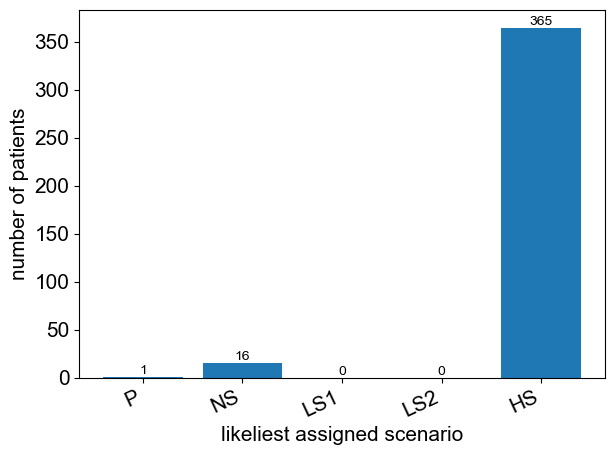

<Figure size 640x480 with 0 Axes>

In [71]:
likeliest_scenario = np.array([np.argmax(freqs) for freqs in processed_frequencies])


counts = []
for i, name in enumerate(group_names):
    print(i, name)
    counts.append(len(np.where(likeliest_scenario==i)[0]))



np.save("tracerx_likeliest_scenarios.npy", likeliest_scenario)


fig, ax = plt.subplots()
p= ax.bar(range(len(counts)), counts)
plt.xticks(range(len(counts)), labels=group_names, rotation=25, horizontalalignment='right', verticalalignment='top', fontsize=15)
plt.bar_label(p, label_type='edge', fontsize=10)
plt.ylabel("number of patients", fontsize=15)
plt.xlabel("likeliest assigned scenario", fontsize=15)
plt.tight_layout()
fig.savefig(base_filepath+"/figs_0512"+"/likeliest_scen.png", format="png", dpi=300)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.show()
plt.clf()



Look at those with a high prob. of being reported plastic.
THERE IS ONE THAT KEEPS SHOWING UP AS 50/50. Exclude it from further analyses.

Calculate correlations of assigned scenarios with clinical variables.

LUSC-smoking
neutral 0 plastic 0 highsel 61
LUSC-not-smoking
neutral 1 plastic 0 highsel 63
LUAD-smoking
neutral 3 plastic 1 highsel 75
LUAD-not-smoking
neutral 11 plastic 0 highsel 123
other-smoking
neutral 0 plastic 0 highsel 19
other-not-smoking
neutral 1 plastic 0 highsel 24
fraction of LUAD assigned high selection 0.9295774647887324
fraction of LUSC assigned high selection 0.992
All subclon are drivers: 1.0
All subclon are drivers: 1.0
All subclon are drivers: 1.0
All subclon are drivers: 2.0
All subclon are drivers: 2.0
age
pack years smoked
no. truncal drivers
no. subclonal drivers
no. subclonal mutations
fraction of subclonal muts which are drivers
average purity of sampled regions
minimum purity of sampled regions
number of regions
age neutral v highsel stat -1.6895928931941337 adjusted pval 0.33137434812111777
pack years smoked neutral v highsel stat -2.989547342933752 adjusted pval 0.016543280395084466
pack years smoked neutral v highsel stat -2.989547342933752 adjusted pval

C:\Users\44749\Anaconda3\lib\site-packages\seaborn\categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.
  warnings.warn(msg, FutureWarning)
C:\Users\44749\Anaconda3\lib\site-packages\seaborn\_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)


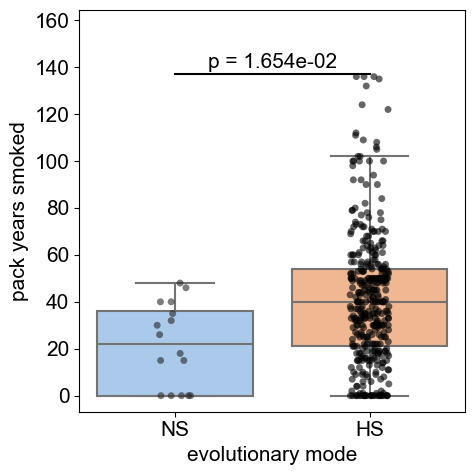

no. truncal drivers neutral v highsel stat 3.284095451973773 adjusted pval 0.008682974732678834
no. truncal drivers neutral v highsel stat 3.284095451973773 adjusted pval 0.008682974732678834


C:\Users\44749\Anaconda3\lib\site-packages\seaborn\categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.
  warnings.warn(msg, FutureWarning)
C:\Users\44749\Anaconda3\lib\site-packages\seaborn\_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)


<Figure size 640x480 with 0 Axes>

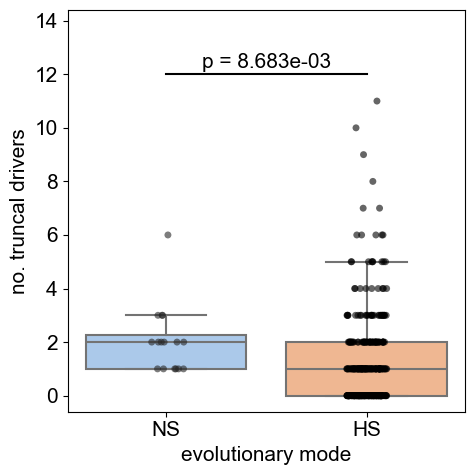

no. subclonal drivers neutral v highsel stat 0.6296835559398865 adjusted pval 1.0
no. subclonal drivers correlation with plasticity stat 0.432055330774428 adjusted pval 1.0635314676900724e-17


<Figure size 640x480 with 0 Axes>

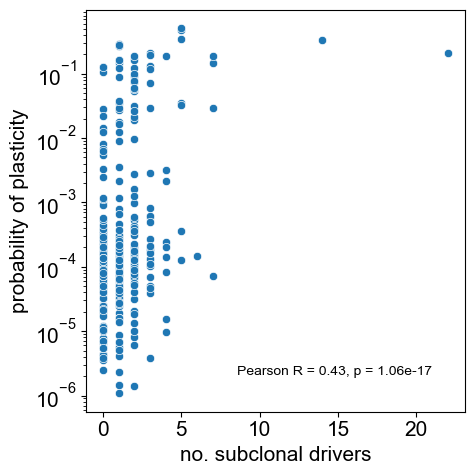

no. subclonal mutations neutral v highsel stat -6.5183264602911635 adjusted pval 1.8101581745237625e-09
no. subclonal mutations neutral v highsel stat -6.5183264602911635 adjusted pval 1.8101581745237625e-09


C:\Users\44749\Anaconda3\lib\site-packages\seaborn\categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.
  warnings.warn(msg, FutureWarning)
C:\Users\44749\Anaconda3\lib\site-packages\seaborn\_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)


<Figure size 640x480 with 0 Axes>

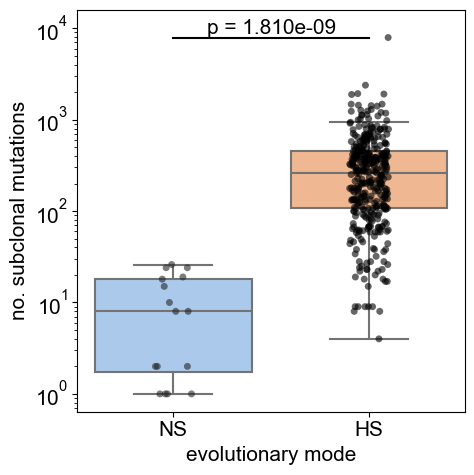

no. subclonal mutations correlation with plasticity stat 0.5572711575273708 adjusted pval 3.8412151695149185e-31


<Figure size 640x480 with 0 Axes>

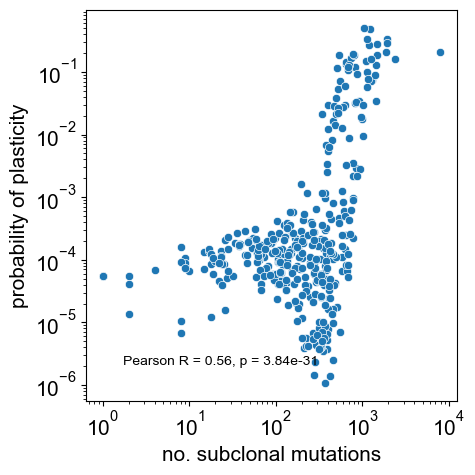

fraction of subclonal muts which are drivers neutral v highsel stat 3.9856765778368137 adjusted pval 0.0008566017350372805
fraction of subclonal muts which are drivers neutral v highsel stat 3.9856765778368137 adjusted pval 0.0008566017350372805


C:\Users\44749\Anaconda3\lib\site-packages\seaborn\categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.
  warnings.warn(msg, FutureWarning)
C:\Users\44749\Anaconda3\lib\site-packages\seaborn\_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)


<Figure size 640x480 with 0 Axes>

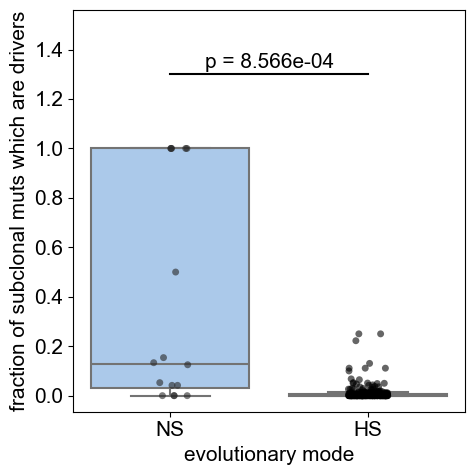

average purity of sampled regions neutral v highsel stat 2.943161813951072 adjusted pval 0.016543280395084466
average purity of sampled regions neutral v highsel stat 2.943161813951072 adjusted pval 0.016543280395084466


C:\Users\44749\Anaconda3\lib\site-packages\seaborn\categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.
  warnings.warn(msg, FutureWarning)
C:\Users\44749\Anaconda3\lib\site-packages\seaborn\_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)


<Figure size 640x480 with 0 Axes>

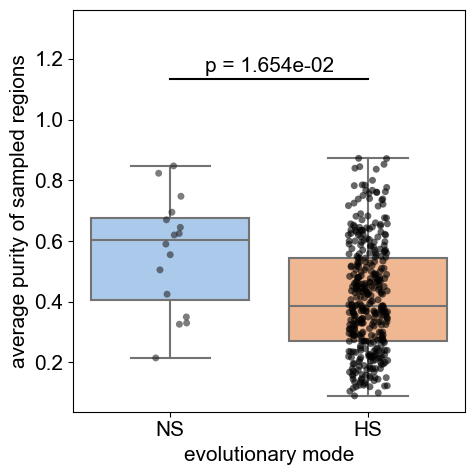

minimum purity of sampled regions neutral v highsel stat 2.6288998550934117 adjusted pval 0.03635008487162049
minimum purity of sampled regions neutral v highsel stat 2.6288998550934117 adjusted pval 0.03635008487162049


C:\Users\44749\Anaconda3\lib\site-packages\seaborn\categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.
  warnings.warn(msg, FutureWarning)
C:\Users\44749\Anaconda3\lib\site-packages\seaborn\_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)


<Figure size 640x480 with 0 Axes>

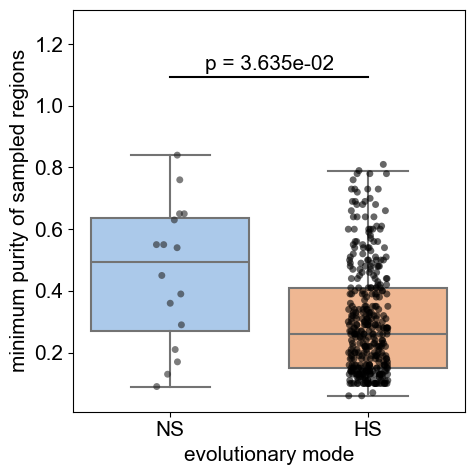

number of regions neutral v highsel stat -0.35021074381923706 adjusted pval 1.0


<lifelines.CoxPHFitter: fitted with 381 total observations, 196 right-censored observations>
             duration col = 'duration'
                event col = 'event'
      baseline estimation = breslow
   number of observations = 381
number of events observed = 185
   partial log-likelihood = -1023.32
         time fit was run = 2024-12-19 17:11:18 UTC

---
           coef exp(coef)  se(coef)  coef lower 95%  coef upper 95% exp(coef) lower 95% exp(coef) upper 95%
covariate                                                                                                  
highsel    0.05      1.05      0.36           -0.66            0.76                0.52                2.14

           cmp to    z    p  -log2(p)
covariate                            
highsel      0.00 0.14 0.89      0.18
---
Concordance = 0.50
Partial AIC = 2048.64
log-likelihood ratio test = 0.02 on 1 df
-log2(p) of ll-ratio test = 0.18

<Figure size 640x480 with 0 Axes>

In [79]:
from scipy.stats import pearsonr, ranksums, false_discovery_control

likeliest_scenario = np.load("tracerx_likeliest_scenarios.npy", allow_pickle=True)
clinical_var_matrix = np.load("clinical_var_matrix.npy", allow_pickle=True)
init_plastic, init_highsel, init_neutral = np.where(likeliest_scenario==0)[0], np.where(likeliest_scenario==4)[0], np.where(likeliest_scenario==1)[0]
#EXCLUDE the tumour that kepdf switching categories by excluding those whose prob. of plasticity exceeds 45%)
#included = np.where(processed_freq[:, 0] < 0.45)[0] 
#print("excluded", np.where(processed_freq[:, 0] >= 0.45)[0]) not necessary now because it comes up plastic
#init_highsel = np.intersect1d(init_highsel, included)[0]
age, clinical_sex, histology, smoking_status, pack_years, num_clonal_drivers, num_subclonal_drivers, av_pur, min_pur, dfs, cens_dfs, dfs_any_event, cens_dfs_any_event = clinical_var_matrix[:, 0], clinical_var_matrix[:, 1], clinical_var_matrix[:, 2], clinical_var_matrix[:, 3], clinical_var_matrix[:, 4], clinical_var_matrix[:, 5], clinical_var_matrix[:, 6],  clinical_var_matrix[:, 7],  clinical_var_matrix[:, 8], clinical_var_matrix[:, 9],  clinical_var_matrix[:, 10],  clinical_var_matrix[:, 11],  clinical_var_matrix[:, 12]
all_drivers_seen = np.load("all_driv_identities.npy", allow_pickle=True)
clinical_driver_matrix = np.load("clinical_driver_matrix.npy", allow_pickle=True)
num_subclonal_mutations = np.load("cruk_number_subclonal_mutations_108.npy", allow_pickle=True)

samples_per_tumour = np.load("samples_per_tumour.npy", allow_pickle=True) 

processed_freq = np.load("cruk_rearranged_proc_freqs_108.npy", allow_pickle=True)
prob_neutral, prob_plastic, prob_highsel = processed_freq[:, 1], processed_freq[:, 0], processed_freq[:, 4]

#print(all_drivers_seen)

luad, notluad, lusc, notlusc = np.where(histology==0)[0], np.where(histology!=0)[0], np.where(histology==1)[0], np.where(histology!=1)[0]
other_hist = np.where(histology==2)[0]
current_smokers, not_current_smokers = np.where(smoking_status == 0)[0], np.where(smoking_status>0)[0]

#look within luad and lusc, for current smokers and not current smokers
lusc_smoking = np.intersect1d(lusc, current_smokers)
lusc_not_smoking = np.intersect1d(lusc, not_current_smokers)
luad_smoking = np.intersect1d(luad, current_smokers)
luad_not_smoking = np.intersect1d(luad, not_current_smokers)
other_smoking = np.intersect1d(other_hist, current_smokers)
other_not_smoking = np.intersect1d(other_hist, not_current_smokers)

#make heatmap

pops = [lusc_smoking, lusc_not_smoking, luad_smoking, luad_not_smoking, other_smoking, other_not_smoking]
popnames = ['LUSC-smoking', 'LUSC-not-smoking', 'LUAD-smoking', 'LUAD-not-smoking', 'other-smoking', 'other-not-smoking']


for pop, name in zip(pops, popnames):
    print(name)
    neutral, plastic, highsel = np.intersect1d(init_neutral, pop), np.intersect1d(init_plastic, pop), np.intersect1d(init_highsel, pop)
    print("neutral", len(neutral), "plastic", len(plastic), "highsel", len(highsel))

print("fraction of LUAD assigned high selection", len(np.intersect1d(luad, init_highsel))/len(luad))
print("fraction of LUSC assigned high selection", len(np.intersect1d(lusc, init_highsel))/len(lusc))



#comparison_names = ["plastic vs all", "plastic vs neutral", "plastic vs highsel", "highsel vs all", "neutral vs all", "neutral vs highsel"]
trait_names = ["age", "pack_years", "num_clonal_drivers", "num_subclonal_drivers", "num_subclonal_mutations", "subclonal_driv_to_mut_ratio", "av_purity", "min_purity", "num_samples"]
trait_names_for_display = ["age", "pack years smoked", "no. truncal drivers", "no. subclonal drivers", "no. subclonal mutations", "fraction of subclonal muts which are drivers", "average purity of sampled regions", "minimum purity of sampled regions", "number of regions"]
traits = [age, pack_years, num_clonal_drivers, num_subclonal_drivers, num_subclonal_mutations, num_subclonal_drivers/num_subclonal_mutations, av_pur, min_pur,samples_per_tumour]
#first comparison is between categories
#second is by probability of plasticity

for (sub, clon) in zip(num_subclonal_drivers, num_subclonal_mutations):
    if sub==clon:
        print("All subclon are drivers: "+str(sub))

all_res, all_pvals = np.zeros((len(trait_names), 2)), np.zeros((len(trait_names), 2))



for index, (name, trait) in enumerate(zip(trait_names_for_display, traits)):

    print(name)

    neutral, plastic, highsel = init_neutral, init_plastic, init_highsel
    


    test = ranksums(trait[neutral], trait[highsel])
    all_res[index][0] = test.statistic
    all_pvals[index][0] = test.pvalue

    #track correlation with probability of plasticity


    test = pearsonr(trait, prob_plastic)
    all_res[index][1] = test.statistic
    all_pvals[index][1] = test.pvalue
    
    
    # if test.pvalue <= 0.05:
    #     print("plastic vs all", test.statistic, test.pvalue)

    # test = ranksums(trait[plastic], trait[neutral])

    # if test.pvalue <= 0.05:
    #     print("plastic vs neutral", test.statistic, test.pvalue)
    
    # test = ranksums(trait[plastic], trait[highsel])
    # if test.pvalue <= 0.05:
    #     print("plastic vs highsel", test.statistic, test.pvalue)

    # test = ranksums(trait[highsel], np.concatenate((trait[neutral], trait[plastic])))
    # if test.pvalue <= 0.05:
    #     print("highsel vs all", test.statistic, test.pvalue)

    # test = ranksums(trait[neutral], np.concatenate((trait[highsel], trait[plastic])))
    # if test.pvalue <= 0.05:
    #     print("neutral vs all", test.statistic, test.pvalue)

    # test = ranksums(trait[neutral], trait[highsel])
    # if test.pvalue <= 0.05:
    #     print("neutral vs highsel", test.statistic, test.pvalue)

adjusted_pvals = false_discovery_control(all_pvals, method='by') #because tests are not independent

for n, (traitname, trait) in enumerate(zip(trait_names_for_display, traits)):
    print(traitname, "neutral v highsel", "stat", all_res[n][0], "adjusted pval", adjusted_pvals[n][0])
    if adjusted_pvals[n][0] <= 0.05:
        print(traitname, "neutral v highsel", "stat", all_res[n][0], "adjusted pval", adjusted_pvals[n][0])
        fig, ax = plt.subplots(figsize=(5, 5))
        all_data = np.concatenate((trait[neutral],  trait[highsel]))
        sns.boxplot(data=[ trait[neutral],  trait[highsel]],  palette="pastel", showfliers=False)
        sns.stripplot(data=[trait[neutral],  trait[highsel]], color='black', alpha=0.6, jitter=True)
        plt.xlabel("evolutionary mode")
        plt.ylabel(traitname)
        plt.xticks([0, 1], ["NS", "HS"])
        
        # Annotate the p-value
        x1, x2 = 0, 1  # positions for categories A and B
        maxval = max(np.max(trait[neutral]), np.max(trait[highsel]))
        y =maxval + min(0.3*maxval, 1)  # height of the annotation
        plt.plot([x1, x2], [y, y], color='black', lw=1.5)  # Add the line between categories
        plt.text((x1 + x2) / 2, y+1 if y>100 else (y+0.1 if y>10 else y+0.01), f'p = {adjusted_pvals[n][0]:.3e}', ha='center', va='bottom')
        #plt.ylim(top=y*1.1)
        if np.max(all_data)/np.min(all_data) > 1000 and np.min(all_data)>0:
            plt.yscale("log")
            plt.ylim(top=2*y)
        else:
            plt.ylim(top=1.2*y)
        plt.tight_layout()
        plt.show()
        fig.savefig(base_filepath+"/figs_0512"+"/tumours_by_"+traitname+".png", dpi=300)
        plt.clf()
    if adjusted_pvals[n][1] <= 0.05:
        print(traitname, "correlation with plasticity", "stat", all_res[n][1], "adjusted pval", adjusted_pvals[n][1])
        
        fig, ax = plt.subplots(figsize=(5, 5))
        all_data = np.concatenate((trait[neutral],  trait[highsel]))
        # Annotate the correlation coefficient and p-value
        df = pd.DataFrame({
            'trait': trait,
            'prob': prob_plastic
         })
    

        sns.scatterplot(data=df, x='trait', y='prob')
        plt.xlabel(traitname)
        plt.ylabel("probability of plasticity")
        plt.yscale("log")
        if np.max(all_data)/np.min(all_data) > 1000 and np.min(all_data)>0:
            plt.xscale("log")
            x, y = 0.1, 0.1
        else:
            x, y = 0.4, 0.1
        plt.text(
            x, y,  # Position: bottom left of the plot
            f'Pearson R = {all_res[n][1]:.2f}, p = {adjusted_pvals[n][1]:.2e}',
            ha='left', va='center', transform=plt.gca().transAxes, fontsize=10)
        #plog = np.around(-np.log10(adjusted_pvals[n][1]), decimals=0)
        #base_title = "R=" +str(np.around(all_res[n][1], decimals=2))+ ", p"
        #ptitle = "=" + str(np.around(adjusted_pvals[n][1], decimals=2)) if adjusted_pvals[n][1] >= 0.01 else "<$10^{%i}$" % int(np.log10(adjusted_pvals[n][1]))
        #plt.title(base_title+ptitle, fontsize=20)
        plt.tight_layout()
        plt.show()
        fig.savefig(base_filepath+"/figs_0512"+"/prob_with"+traitname+".png", dpi=300)
        plt.clf()

#survival analysis
#using one set of data (not sure what 'any event' means)

def compute_survival(dfs_data, cens_data, init_highsel, init_neutral):
    dur_high, dur_neut = dfs_data[init_highsel], dfs_data[init_neutral]
    cens_high, cens_neut =  cens_data[init_highsel], cens_data[init_neutral]
    #ok, now we have only those patients (high selection and neutral)
    assigned_high_selection = np.zeros(len(init_highsel)+len(init_neutral))
    assigned_high_selection[:len(init_highsel)] = 1
    all_dfs, all_cens = np.concatenate((dur_high, dur_neut)), np.concatenate((cens_high, cens_neut))
    #put everything into a dataframe
    data = pd.DataFrame({
    'highsel': assigned_high_selection,
    'duration': all_dfs,
    'event': all_cens
    })
    
    cph = CoxPHFitter()
    cph.fit(data, duration_col='duration', event_col='event')

    cph.print_summary()

compute_survival(dfs, cens_dfs, init_highsel, init_neutral)
        

Display the probability-distribution assigned to each tumour as bar chart.

Number with more than 20% prob of plasticity 9


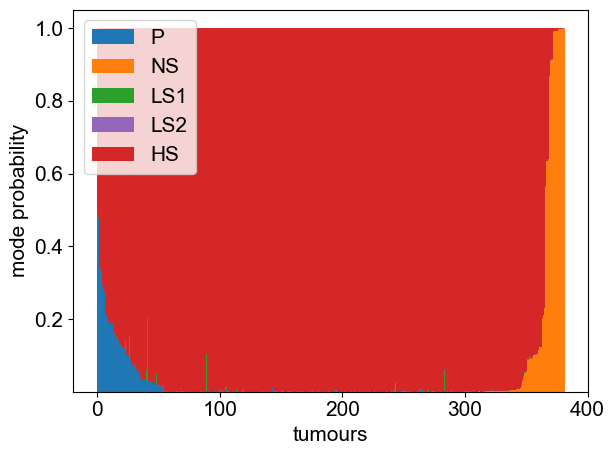

<Figure size 640x480 with 0 Axes>

In [62]:

processed_freq = np.load("cruk_rearranged_proc_freqs_108.npy", allow_pickle=True)

#rearrange so they appear the order we want- AGAIN
group_names  =  ["P", "NS", "LS1", "LS2", "HS"]
group_names_reordered = ["P", "NS", "LS1", "LS2", "HS"]

rearranged_processed_frequencies = np.zeros_like(processed_freq)
for n, name in enumerate(group_names_reordered):
    for m, label in enumerate(group_names):
        if name == label:
           rearranged_processed_frequencies[:, n] = processed_freq[:, m]

processed_freq = rearranged_processed_frequencies
prob_plastic = processed_freq[:, 0]

print("Number with more than 20% prob of plasticity", len(np.where(prob_plastic>=0.2)[0]))

num_patients = len(prob_plastic)


fig, ax = plt.subplots()
order = np.flip(np.argsort(prob_plastic))
order_threshold=np.min(np.where(prob_plastic[order]<0.01)[0])
#then order by increasing neutrality
less_than_visible_probs = processed_freq[order[order_threshold:], 1]
suborder = np.argsort(less_than_visible_probs) 
less_than_visible_reordered = order[order_threshold:][suborder]
order[order_threshold:] = less_than_visible_reordered
default_colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#9467bd', '#d62728']

bottoms = np.zeros(num_patients)
for i, name in enumerate(group_names_reordered):
    relevant_prob = processed_freq[order, i]
    ax.bar(range(num_patients), relevant_prob, width=1, bottom=bottoms, label=name, color=default_colors[i])
    bottoms += relevant_prob
plt.xlabel("tumours")
plt.ylabel("mode probability")
plt.legend(fontsize=15)
plt.tight_layout()
plt.show()
fig.savefig(base_filepath+"/figs_0512"+"/tumours_by_mode_prob.png", format="png", dpi=300)
plt.clf()
    


Make a plot of the probability that a fitness boost is lost at the nth division, or *will have been* lost by the nth division, by heritability.

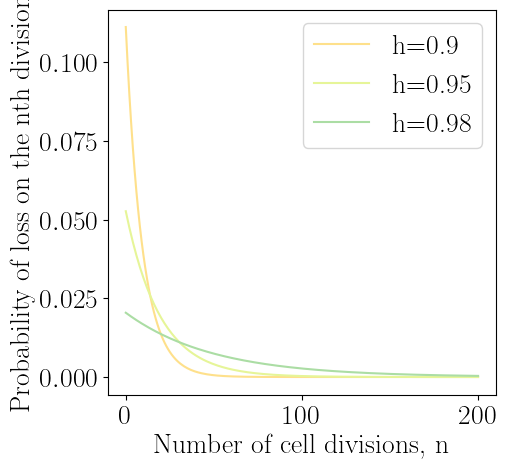

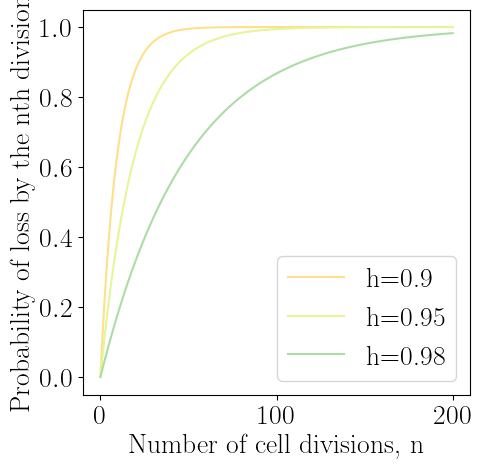

In [33]:
def is_lost(h, n):
    return (1-h)*np.power(h, n-1)

def has_been_lost(h, n):
    return 1-np.power(h, n)

ns = np.arange(201)

fig, ax = plt.subplots(figsize=(5, 5))
for h, color in zip([0.9, 0.95, 0.98], ["#fee08b", "#e6f598", "#abdda4"]):
    ax.plot(ns, [is_lost(h, n) for n in ns], color=color, label="h="+str(h))
plt.xlabel("Number of cell divisions, n")
plt.ylabel("Probability of loss on the nth division")
plt.legend()
fig.savefig(base_filepath+"/figs_0512"+"/loss_on_n.png", format="png", dpi=300)
plt.show()

fig, ax = plt.subplots(figsize=(5, 5))
for h, color in zip([0.9, 0.95, 0.98], ["#fee08b", "#e6f598", "#abdda4"]):
    ax.plot(ns, [has_been_lost(h, n) for n in ns], color=color, label="h="+str(h))
plt.xlabel("Number of cell divisions, n")
plt.ylabel("Probability of loss by the nth division")
plt.legend()
fig.savefig(base_filepath+"/figs_0512"+"/loss_by_n.png", format="png", dpi=300)
plt.show()




Make histograms of summary statistics for all levels of plasticity for high and low selection, both mutation rates, for all sample numbers
First, high selection, low mutation rate.

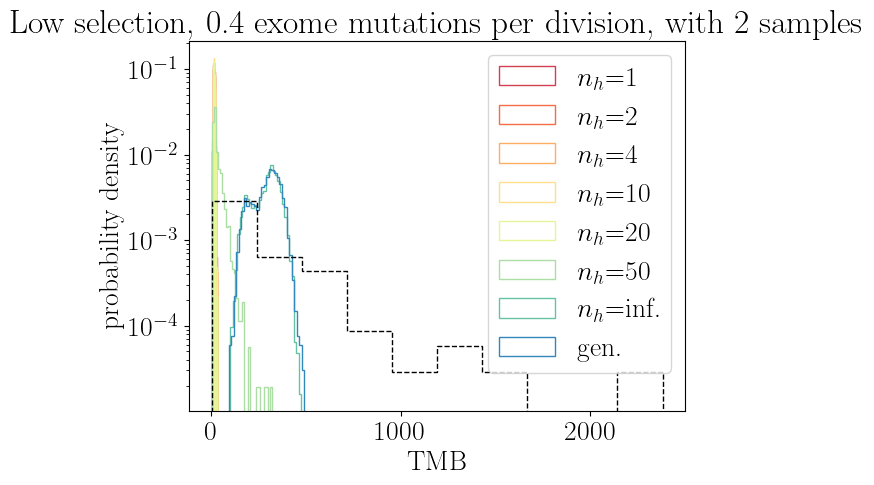

<Figure size 640x480 with 0 Axes>

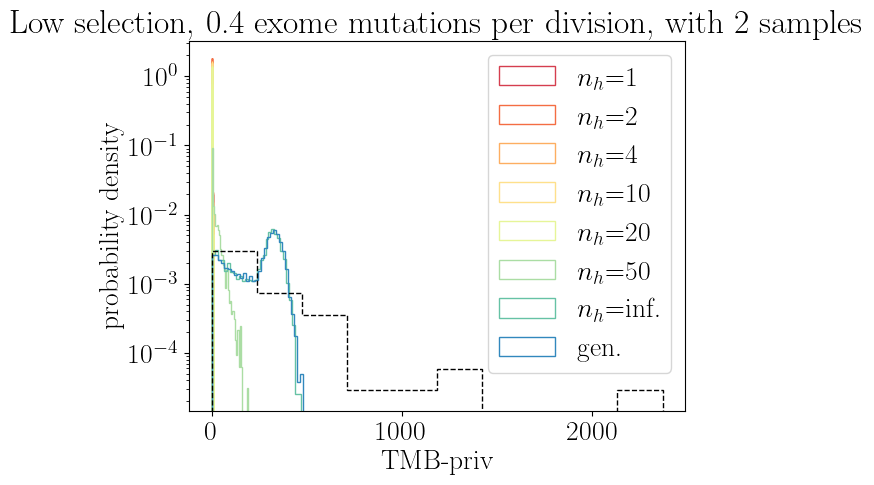

<Figure size 640x480 with 0 Axes>

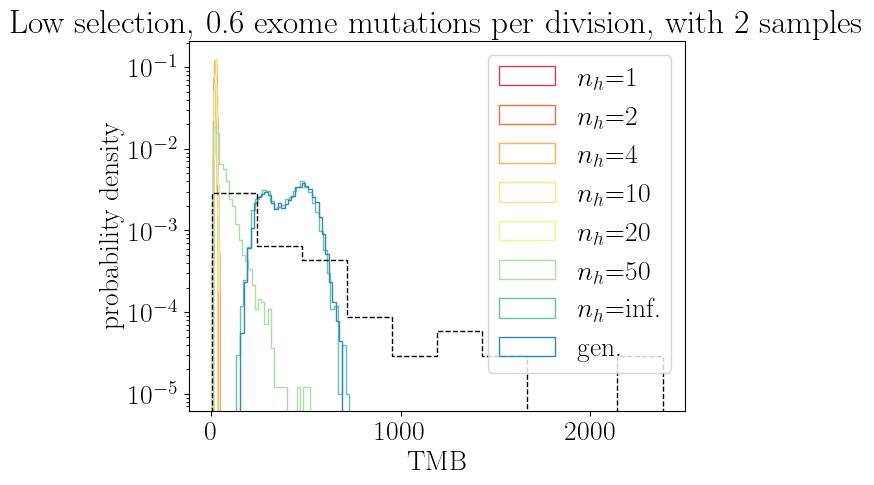

<Figure size 640x480 with 0 Axes>

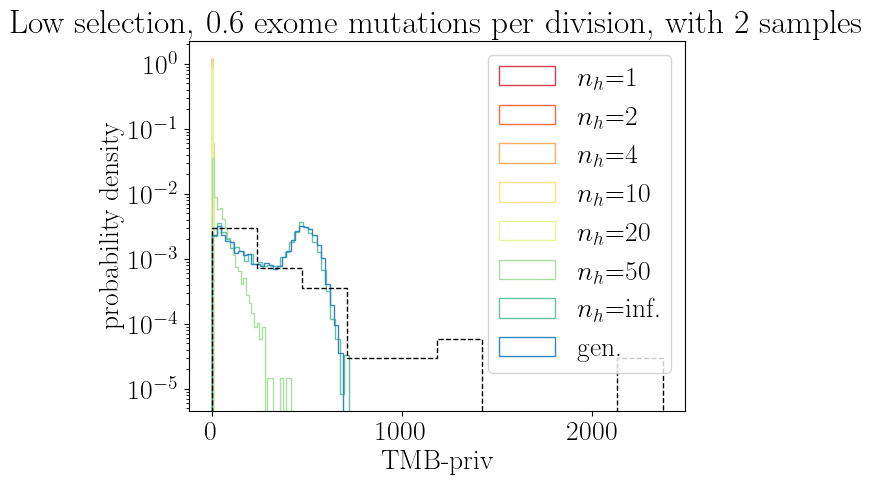

<Figure size 640x480 with 0 Axes>

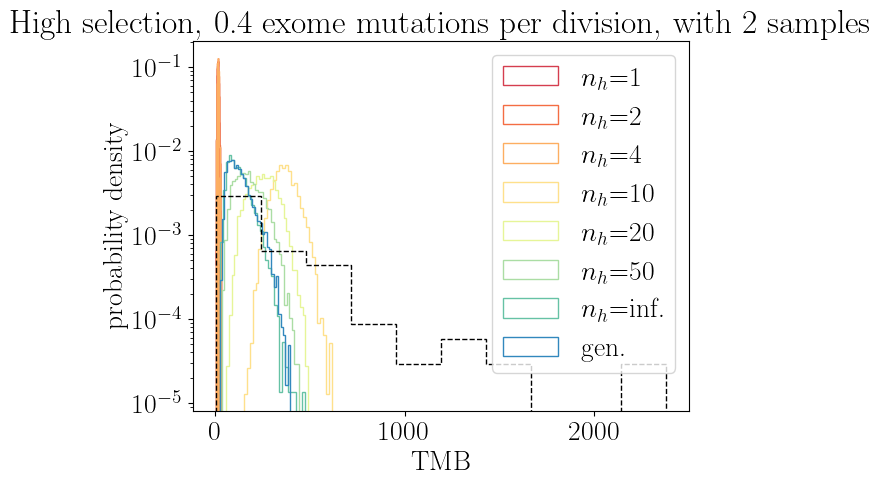

<Figure size 640x480 with 0 Axes>

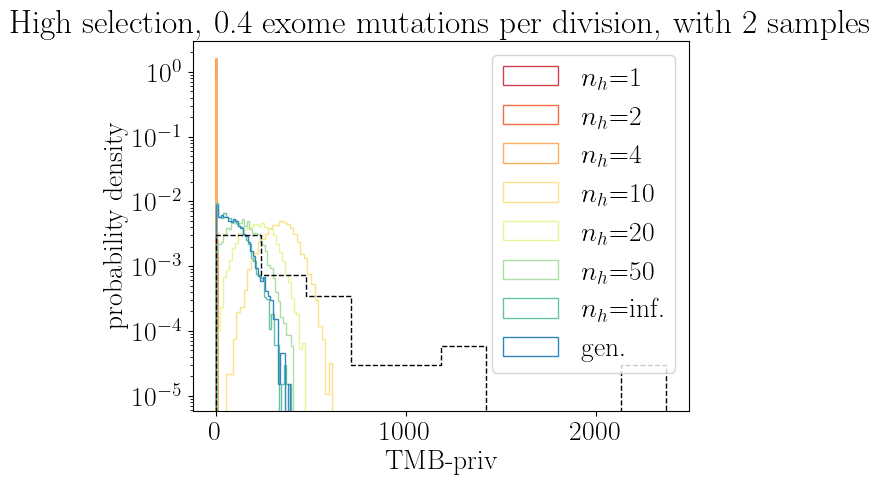

<Figure size 640x480 with 0 Axes>

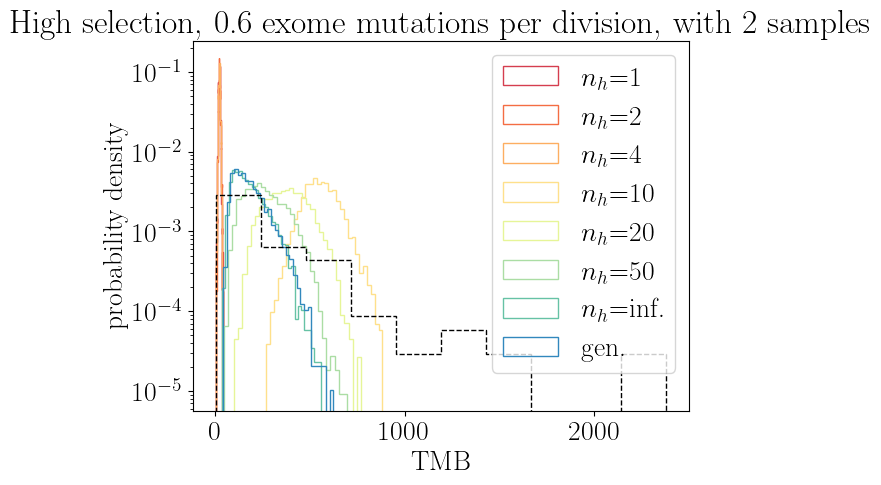

<Figure size 640x480 with 0 Axes>

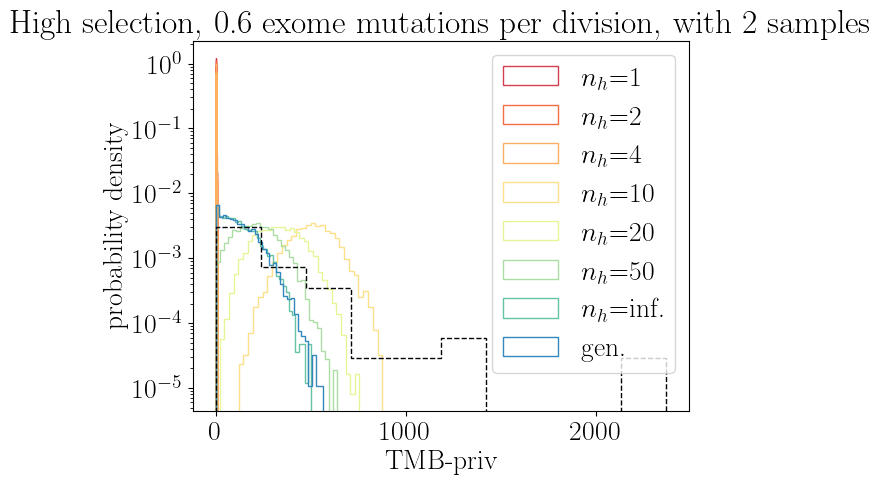

<Figure size 640x480 with 0 Axes>

In [34]:

def plot_histogram(mut, sel, title, savetitle, bins=30, prefix="27Jul"):
    for no_samples in [2]:
        stat_names = ["TMB", "TMB-priv"] + ["F"+str(s) for s in range(1, no_samples)]+ ["F-priv"] + ["A"+str(s) for s in range(2, no_samples+1)]
        div_color_list = ["#d53e4f", "#f46d43", "#fdae61", "#fee08b", "#e6f598", "#abdda4", "#66c2a5", "#3288bd"]
        plast_levels = ["0.0", "0.5", "0.75", "0.9", "0.95", "0.98", "1.0", "gen"]
        labels_for_display = ["$n_h$"+"=1", "$n_h$"+"=2", "$n_h$"+"=4", "$n_h$"+"=10", "$n_h$"+"=20","$n_h$"+"=50", "$n_h$"+"=inf.", "gen."]
        ordered_labels = []
        for plast in plast_levels:
            ordered_labels.append(prefix + "_" + plast + "_" + str(mut) + "_" + sel)
        cruk_tumour_stats = np.load("cruk_"+str(no_samples)+"_samples_stat.npy", allow_pickle=True)
        all_stats = []
        for label in ordered_labels:
            stats = np.load(base_filepath+label+"_"+str(no_samples)+"_samples.npy", allow_pickle=True)
            all_stats.append(stats)
        for n, name in enumerate(stat_names[0:2]):
            fig, ax = plt.subplots()
            for m, (stats, color) in enumerate(zip(all_stats, div_color_list)):
                ax.hist(stats[:, n], bins=bins, density=True, log=True, histtype='step', label=labels_for_display[m], color=color)
                #print(m, max(stats[:, n]))
            ax.hist(cruk_tumour_stats[:, n], color='black', density=True, log=True, histtype="step", linestyle='--')
            #ax.axvline(x=np.percentile(cruk_tumour_stats[:, n], 5), color='black', linestyle='--')
            plt.xlabel(name)
            plt.ylabel("probability density")
            plt.title(title + ", with "+str(no_samples)+" samples")
            plt.legend()
            plt.show()
            fig.savefig(base_filepath+"/figs_0512"+"/"+savetitle+"_"+str(no_samples)+"_"+name+"_samples_with_indic_lines.png", dpi=300)
            plt.clf()
            # fig, ax = plt.subplots()
            # for m, (stats, color) in enumerate(zip(all_stats, div_color_list)):
            #     ax.hist(stats[:, n], bins=bins, density=True, log=True, histtype='step', label=labels_for_display[m], color=color)
            # #ax.axvline(x=np.percentile(cruk_tumour_stats[:, n], 95), color='black', linestyle='--')
            # #ax.axvline(x=np.percentile(cruk_tumour_stats[:, n], 5), color='black', linestyle='--')
            # plt.xlabel(name)
            # plt.ylabel("probability density")
            # plt.title(title + ", with "+str(no_samples)+" samples")
            # plt.legend()
            # plt.show()
            # fig.savefig(base_filepath+"/figs_0512"+"/"+savetitle+"_"+str(no_samples)+"_samples_without_indic_lines.png", dpi=300)
            # plt.clf()
            
plot_histogram(0.4, "lowsel", "Low selection, 0.4 exome mutations per division", "lowsel_0.4")
plot_histogram(0.6, "lowsel", "Low selection, 0.6 exome mutations per division", "lowsel_0.6")
plot_histogram(0.4, "highsel", "High selection, 0.4 exome mutations per division", "highsel_0.4")
plot_histogram(0.6, "highsel", "High selection, 0.6 exome mutations per division", "highsel_0.6")

Here's a different way of visualising the same idea: show a distribution of summary statistics assigned to each heritability level (at 2 samples).

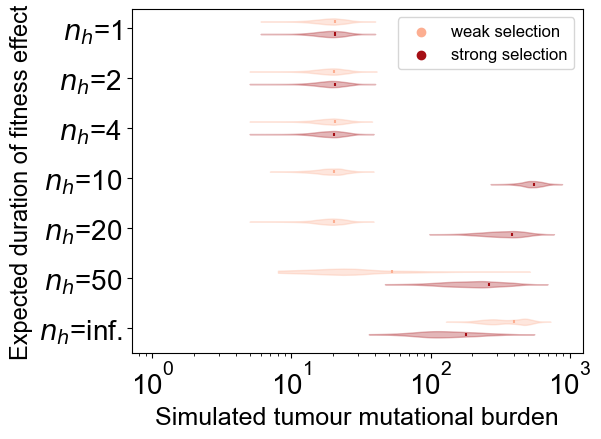

<Figure size 640x480 with 0 Axes>

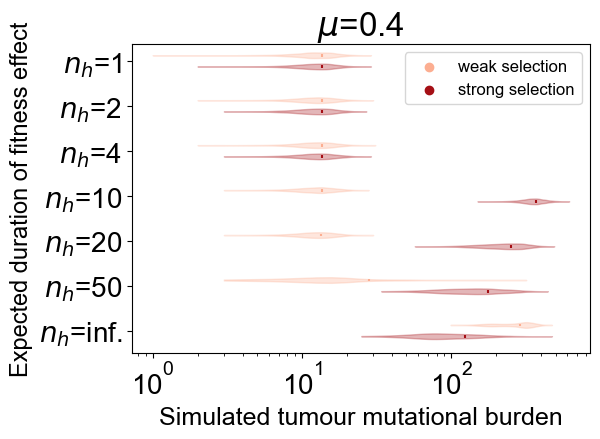

<Figure size 640x480 with 0 Axes>

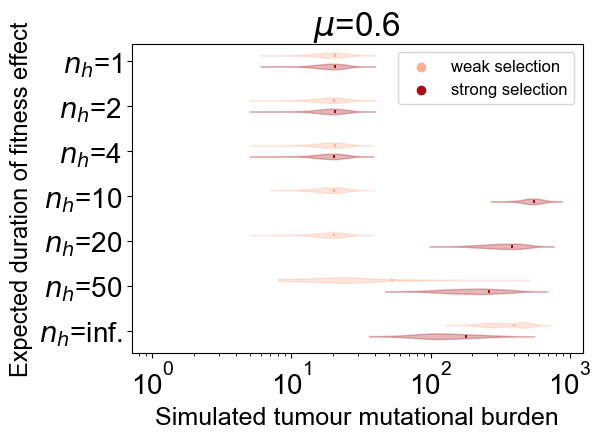

<Figure size 640x480 with 0 Axes>

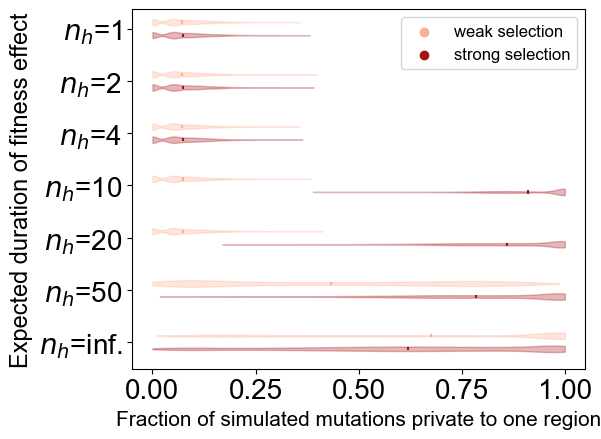

<Figure size 640x480 with 0 Axes>

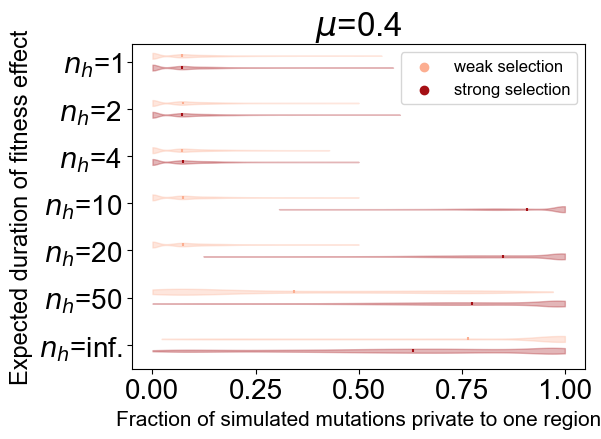

<Figure size 640x480 with 0 Axes>

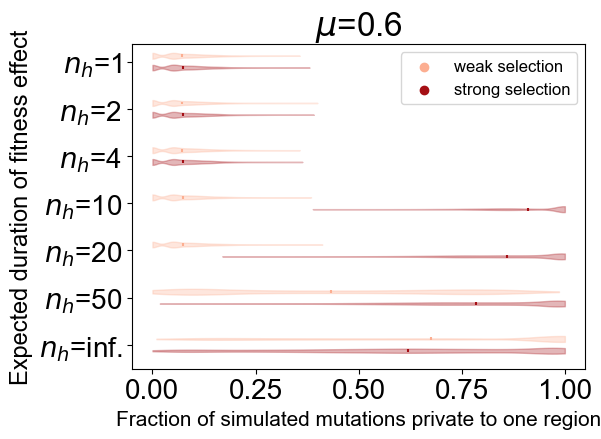

<Figure size 640x480 with 0 Axes>

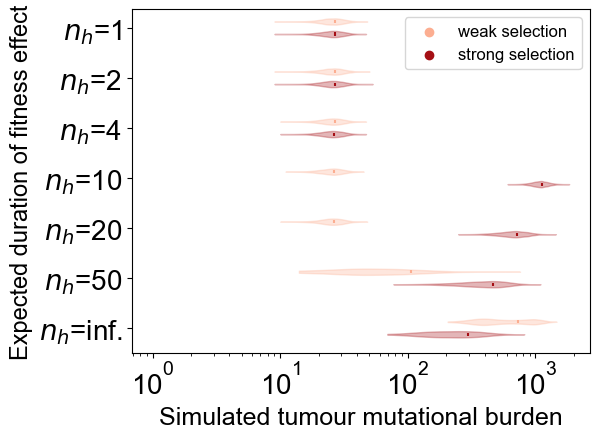

<Figure size 640x480 with 0 Axes>

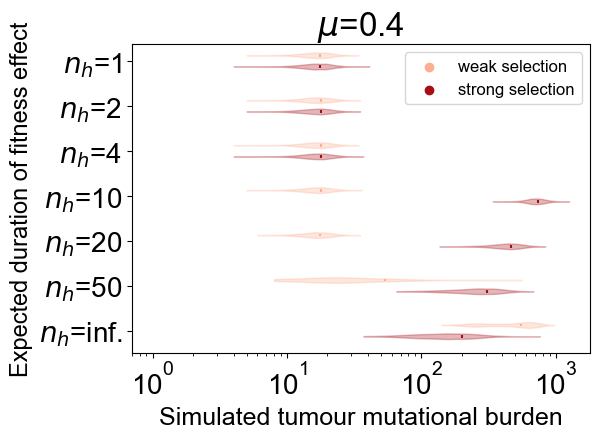

<Figure size 640x480 with 0 Axes>

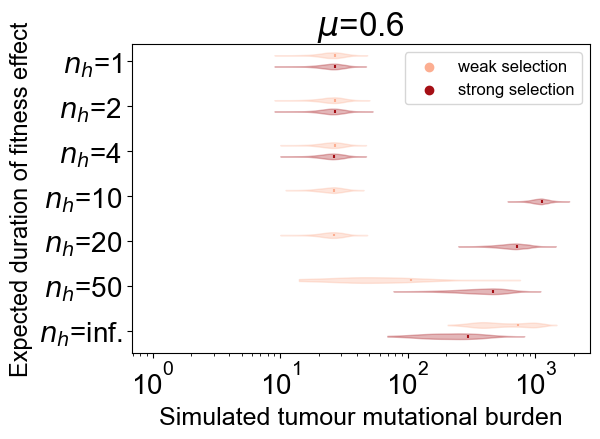

<Figure size 640x480 with 0 Axes>

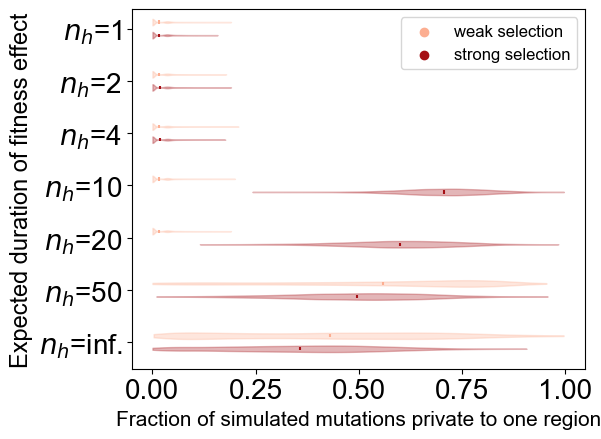

<Figure size 640x480 with 0 Axes>

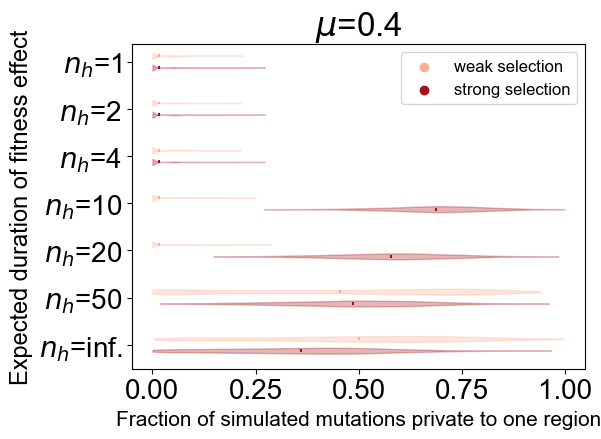

<Figure size 640x480 with 0 Axes>

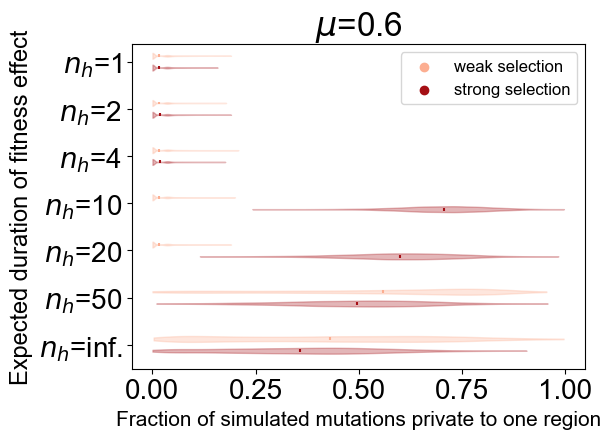

<Figure size 640x480 with 0 Axes>

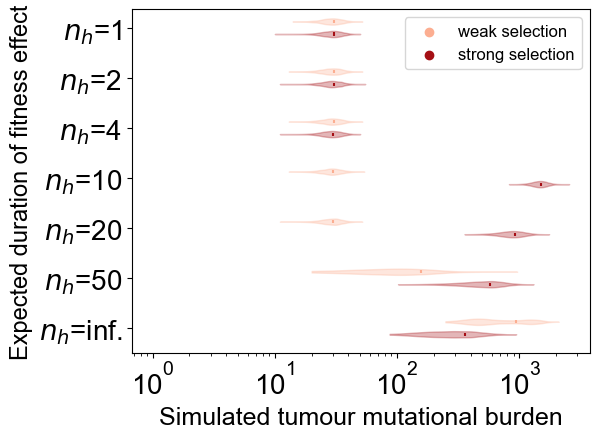

<Figure size 640x480 with 0 Axes>

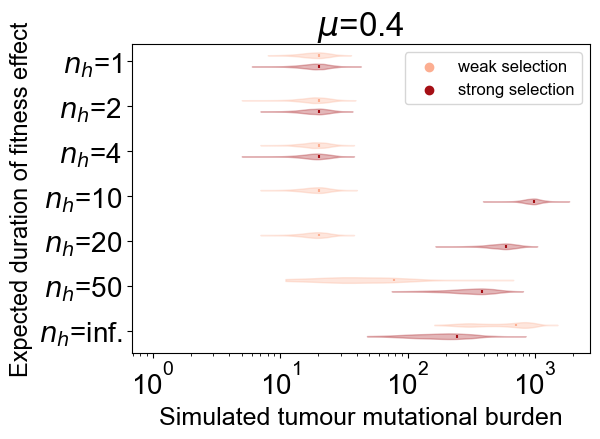

<Figure size 640x480 with 0 Axes>

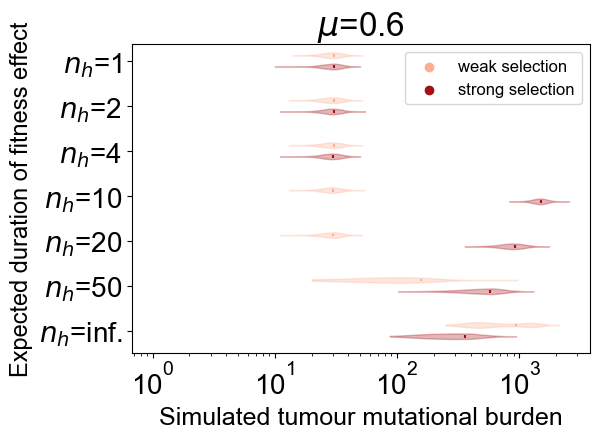

<Figure size 640x480 with 0 Axes>

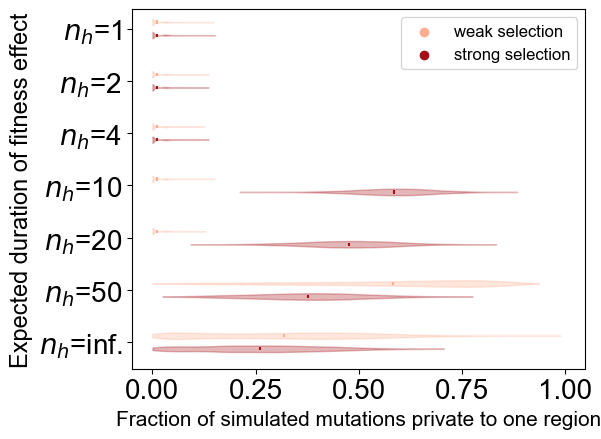

<Figure size 640x480 with 0 Axes>

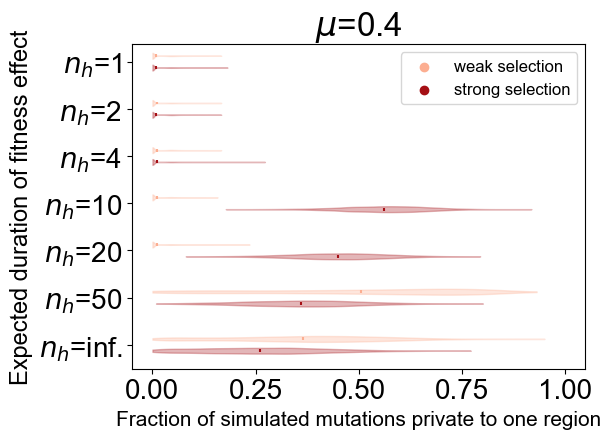

<Figure size 640x480 with 0 Axes>

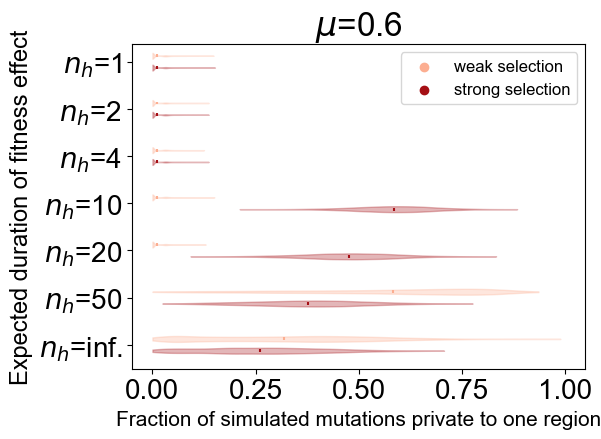

<Figure size 640x480 with 0 Axes>

In [6]:
#plt.rcParams['font.size'] = 15
#plot ranges for a specific stat

def plot_ranges(mut, savetitle, no_samples, stat_index, stat_name, bins=30, prefix="27Jul", sel_colors=["#FCAE91","#A50F15"], with_title=False):
    #stat_names = ["TMB", "TMB-priv"] + ["F"+str(s) for s in range(1, no_samples)]+ ["F-priv"] + ["A"+str(s) for s in range(2, no_samples+1)]
    #div_color_list = ["#d53e4f", "#f46d43", "#fdae61", "#fee08b", "#e6f598", "#abdda4", "#66c2a5"
    plast_levels = ["0.0", "0.5", "0.75", "0.9", "0.95", "0.98", "1.0"]
    labels_for_display = ["$n_h$"+"=1", "$n_h$"+"=2", "$n_h$"+"=4", "$n_h$"+"=10", "$n_h$"+"=20","$n_h$"+"=50", "$n_h$"+"=inf."]
    ordered_labels = []
    fig, ax = plt.subplots()
    colors = []
    positions = []
    tick_positions = []
    count = 1
    for plast in plast_levels:
        tick_positions.append(count + 0.5)
        for (sel, color) in zip(["lowsel", "highsel"], sel_colors):
            ordered_labels.append(prefix + "_" + plast + "_" + str(mut) + "_" + sel)
            colors.append(color)
            positions.append(count)
            count += 1
        count += 2
        
    #cruk_tumour_stats = np.load("cruk_"+str(no_samples)+"_samples_stat.npy", allow_pickle=True)
    all_stats = []
    for label in ordered_labels:
        stats = np.load(base_filepath+label+"_"+str(no_samples)+"_samples.npy", allow_pickle=True)
    #print(np.min(stats))
        all_stats.append(stats)
    #violin_parts = ax.violinplot([stats[:, n] for stats in all_stats] + [cruk_tumour_stats[:, n]], showmeans=True, showextrema=False, vert=False)
    #ax.set_yticks(range(1, len(labels_for_display)+2), labels=labels_for_display+["true data"])
    if stat_index != -1:
        stats_to_plot = [stats[:, stat_index] for stats in all_stats]
    else:
        stats_to_plot = [stats[:, 1]/stats[:, 0] for stats in all_stats] #fraction private
    violin_parts = ax.violinplot(stats_to_plot, positions=positions, showmeans=True, showextrema=False, vert=False)
    ax.set_yticks(tick_positions, labels=labels_for_display)
    for n_, pc in enumerate(violin_parts['bodies']):
        pc.set_color(colors[n_])
    violin_parts['cmeans'].set_colors(colors)
    if stat_index != -1:
        ax.set_xscale("log")
    plt.xlabel(stat_name, fontsize=18 if stat_index != -1 else 15)
    plt.ylabel("Expected duration of fitness effect", fontsize=17)
    #ax.set_yscale("log")
    #plt.xlabel(name)
    #plt.ylabel("Probability density")
    #plt.title(("With weak selection" if sel=="lowsel" else "With strong selection") + ", "+(r'$\mu$'+"=0.4" if mut==0.4 else r'$\mu$'+"=0.6") )
    plt.ylim(bottom=0)
    plt.scatter(1, -10, color=sel_colors[0], label="weak selection")
    plt.scatter(1, -10, color=sel_colors[1], label="strong selection")
    ax.legend(fontsize=12, loc="upper right")
    if with_title:
        plt.title(r'$\mu$'+"="+str(mut))
    plt.tight_layout()
    ax.invert_yaxis()
    plt.show()
    savename = base_filepath+"/figs_0512/desired_violin_plots"+"/"+savetitle+"_"+str(mut)+"_"+str(no_samples)+("_with_title" if with_title else "")+"_"+stat_name+"_samples_with_violin"
    fig.savefig(savename+".png", format="png", dpi=300)
    fig.savefig(savename+".pdf", format="pdf", dpi=300)
    plt.clf()
                
# for no_samples in [2]:
#     stat_names = ["tumour mutational burden", "TMB-priv"] + ["F"+str(s) for s in range(1, no_samples)]+ ["F-priv"] + ["A"+str(s) for s in range(2, no_samples+1)]
#     stat_names = ["Simulated "+name for name in stat_names]
#     for stat_index, stat_name in enumerate(stat_names):
#         plot_ranges(0.4, "combined_violin", no_samples, stat_index, stat_name)
#         plot_ranges(0.6, "combined_violin", no_samples, stat_index, stat_name)
#         plot_ranges(0.4, "combined_violin", no_samples, stat_index, stat_name, with_title=True)
#         plot_ranges(0.6, "combined_violin", no_samples, stat_index, stat_name, with_title=True)
#     plot_ranges(0.4, "combined_violin", no_samples, -1, "Fraction of simulated mutations private to one region")
#     plot_ranges(0.6, "combined_violin", no_samples, -1, "Fraction of simulated mutations private to one region")
#     plot_ranges(0.4, "combined_violin", no_samples, -1, "Fraction of simulated mutations private to one region", with_title=True)
#     plot_ranges(0.6, "combined_violin", no_samples, -1, "Fraction of simulated mutations private to one region", with_title=True)

# plot_ranges(0.4, "lowsel", "s=0.02, "+r'$\mu$'+"=0.4", "lowsel_0.4", color="#41b6c4")
# plot_ranges(0.6, "lowsel", "s=0.02, "+r'$\mu$'+"=0.6", "lowsel_0.6", color="#41b6c4")
# plot_ranges(0.4, "highsel", "s=0.1, "+r'$\mu$'+"=0.4", "highsel_0.4", color="#253494")
# plot_ranges(0.6, "highsel", "s=0.1, "+r'$\mu$'+"=0.6", "highsel_0.6", color="#253494")

for no_samples in [2, 5, 8]:
    stat_names = ["tumour mutational burden", "TMB-priv"] + ["F"+str(s) for s in range(1, no_samples)]+ ["F-priv"] + ["A"+str(s) for s in range(2, no_samples+1)]
    stat_names = ["Simulated "+name for name in stat_names]
    for stat_index, stat_name in enumerate(stat_names):
        if stat_index == 0:
        #plot_ranges(0.4, "combined_violin", no_samples, stat_index, stat_name)
            plot_ranges(0.6, "combined_violin", no_samples, stat_index, stat_name)
            plot_ranges(0.4, "combined_violin", no_samples, stat_index, stat_name, with_title=True)
            plot_ranges(0.6, "combined_violin", no_samples, stat_index, stat_name, with_title=True)
    #plot_ranges(0.4, "combined_violin", no_samples, -1, "Fraction of simulated mutations private to one region")
    plot_ranges(0.6, "combined_violin", no_samples, -1, "Fraction of simulated mutations private to one region")
    plot_ranges(0.4, "combined_violin", no_samples, -1, "Fraction of simulated mutations private to one region", with_title=True)
    plot_ranges(0.6, "combined_violin", no_samples, -1, "Fraction of simulated mutations private to one region", with_title=True)


Visual takeaway here is that for low selection you need to last 50 divisions to be distinguishable; for high selection it's 10.

Now plot TRACERx comparisons, for all samples.

['27Jul_gen_0.4_nosel', '27Jul_0.0_0.4_lowsel', '27Jul_0.5_0.4_lowsel', '27Jul_0.75_0.4_lowsel', '27Jul_0.9_0.4_lowsel', '27Jul_0.95_0.4_lowsel', '27Jul_0.98_0.4_lowsel', '27Jul_1.0_0.4_lowsel', '27Jul_gen_0.4_lowsel', '27Jul_0.0_0.4_highsel', '27Jul_0.5_0.4_highsel', '27Jul_0.75_0.4_highsel', '27Jul_0.9_0.4_highsel', '27Jul_0.95_0.4_highsel', '27Jul_0.98_0.4_highsel', '27Jul_1.0_0.4_highsel', '27Jul_gen_0.4_highsel', '27Jul_gen_0.6_nosel', '27Jul_0.0_0.6_lowsel', '27Jul_0.5_0.6_lowsel', '27Jul_0.75_0.6_lowsel', '27Jul_0.9_0.6_lowsel', '27Jul_0.95_0.6_lowsel', '27Jul_0.98_0.6_lowsel', '27Jul_1.0_0.6_lowsel', '27Jul_gen_0.6_lowsel', '27Jul_0.0_0.6_highsel', '27Jul_0.5_0.6_highsel', '27Jul_0.75_0.6_highsel', '27Jul_0.9_0.6_highsel', '27Jul_0.95_0.6_highsel', '27Jul_0.98_0.6_highsel', '27Jul_1.0_0.6_highsel', '27Jul_gen_0.6_highsel']
27Jul_gen_0.4_nosel gen_0.4_nosel 5000
27Jul_0.0_0.4_lowsel 0.0_0.4_lowsel 5000
27Jul_0.5_0.4_lowsel 0.5_0.4_lowsel 4992
27Jul_0.75_0.4_lowsel 0.75_0.4_lowse

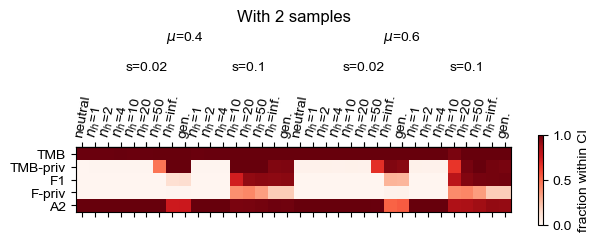

['27Jul_gen_0.4_nosel', '27Jul_0.0_0.4_lowsel', '27Jul_0.5_0.4_lowsel', '27Jul_0.75_0.4_lowsel', '27Jul_0.9_0.4_lowsel', '27Jul_0.95_0.4_lowsel', '27Jul_0.98_0.4_lowsel', '27Jul_1.0_0.4_lowsel', '27Jul_gen_0.4_lowsel', '27Jul_0.0_0.4_highsel', '27Jul_0.5_0.4_highsel', '27Jul_0.75_0.4_highsel', '27Jul_0.9_0.4_highsel', '27Jul_0.95_0.4_highsel', '27Jul_0.98_0.4_highsel', '27Jul_1.0_0.4_highsel', '27Jul_gen_0.4_highsel', '27Jul_gen_0.6_nosel', '27Jul_0.0_0.6_lowsel', '27Jul_0.5_0.6_lowsel', '27Jul_0.75_0.6_lowsel', '27Jul_0.9_0.6_lowsel', '27Jul_0.95_0.6_lowsel', '27Jul_0.98_0.6_lowsel', '27Jul_1.0_0.6_lowsel', '27Jul_gen_0.6_lowsel', '27Jul_0.0_0.6_highsel', '27Jul_0.5_0.6_highsel', '27Jul_0.75_0.6_highsel', '27Jul_0.9_0.6_highsel', '27Jul_0.95_0.6_highsel', '27Jul_0.98_0.6_highsel', '27Jul_1.0_0.6_highsel', '27Jul_gen_0.6_highsel']
27Jul_gen_0.4_nosel gen_0.4_nosel 5000
27Jul_0.0_0.4_lowsel 0.0_0.4_lowsel 5000
27Jul_0.5_0.4_lowsel 0.5_0.4_lowsel 4992
27Jul_0.75_0.4_lowsel 0.75_0.4_lowse

<Figure size 640x480 with 0 Axes>

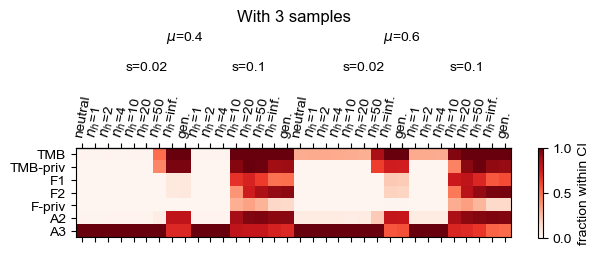

['27Jul_gen_0.4_nosel', '27Jul_0.0_0.4_lowsel', '27Jul_0.5_0.4_lowsel', '27Jul_0.75_0.4_lowsel', '27Jul_0.9_0.4_lowsel', '27Jul_0.95_0.4_lowsel', '27Jul_0.98_0.4_lowsel', '27Jul_1.0_0.4_lowsel', '27Jul_gen_0.4_lowsel', '27Jul_0.0_0.4_highsel', '27Jul_0.5_0.4_highsel', '27Jul_0.75_0.4_highsel', '27Jul_0.9_0.4_highsel', '27Jul_0.95_0.4_highsel', '27Jul_0.98_0.4_highsel', '27Jul_1.0_0.4_highsel', '27Jul_gen_0.4_highsel', '27Jul_gen_0.6_nosel', '27Jul_0.0_0.6_lowsel', '27Jul_0.5_0.6_lowsel', '27Jul_0.75_0.6_lowsel', '27Jul_0.9_0.6_lowsel', '27Jul_0.95_0.6_lowsel', '27Jul_0.98_0.6_lowsel', '27Jul_1.0_0.6_lowsel', '27Jul_gen_0.6_lowsel', '27Jul_0.0_0.6_highsel', '27Jul_0.5_0.6_highsel', '27Jul_0.75_0.6_highsel', '27Jul_0.9_0.6_highsel', '27Jul_0.95_0.6_highsel', '27Jul_0.98_0.6_highsel', '27Jul_1.0_0.6_highsel', '27Jul_gen_0.6_highsel']
27Jul_gen_0.4_nosel gen_0.4_nosel 5000
27Jul_0.0_0.4_lowsel 0.0_0.4_lowsel 5000
27Jul_0.5_0.4_lowsel 0.5_0.4_lowsel 4992
27Jul_0.75_0.4_lowsel 0.75_0.4_lowse

<Figure size 640x480 with 0 Axes>

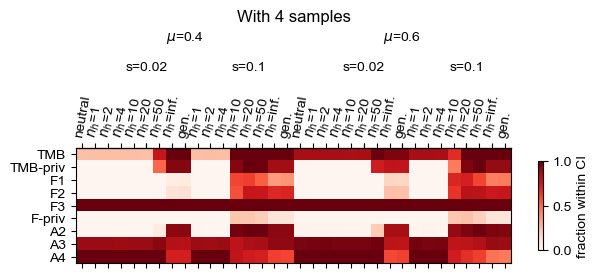

['27Jul_gen_0.4_nosel', '27Jul_0.0_0.4_lowsel', '27Jul_0.5_0.4_lowsel', '27Jul_0.75_0.4_lowsel', '27Jul_0.9_0.4_lowsel', '27Jul_0.95_0.4_lowsel', '27Jul_0.98_0.4_lowsel', '27Jul_1.0_0.4_lowsel', '27Jul_gen_0.4_lowsel', '27Jul_0.0_0.4_highsel', '27Jul_0.5_0.4_highsel', '27Jul_0.75_0.4_highsel', '27Jul_0.9_0.4_highsel', '27Jul_0.95_0.4_highsel', '27Jul_0.98_0.4_highsel', '27Jul_1.0_0.4_highsel', '27Jul_gen_0.4_highsel', '27Jul_gen_0.6_nosel', '27Jul_0.0_0.6_lowsel', '27Jul_0.5_0.6_lowsel', '27Jul_0.75_0.6_lowsel', '27Jul_0.9_0.6_lowsel', '27Jul_0.95_0.6_lowsel', '27Jul_0.98_0.6_lowsel', '27Jul_1.0_0.6_lowsel', '27Jul_gen_0.6_lowsel', '27Jul_0.0_0.6_highsel', '27Jul_0.5_0.6_highsel', '27Jul_0.75_0.6_highsel', '27Jul_0.9_0.6_highsel', '27Jul_0.95_0.6_highsel', '27Jul_0.98_0.6_highsel', '27Jul_1.0_0.6_highsel', '27Jul_gen_0.6_highsel']
27Jul_gen_0.4_nosel gen_0.4_nosel 5000
27Jul_0.0_0.4_lowsel 0.0_0.4_lowsel 5000
27Jul_0.5_0.4_lowsel 0.5_0.4_lowsel 4992
27Jul_0.75_0.4_lowsel 0.75_0.4_lowse

<Figure size 640x480 with 0 Axes>

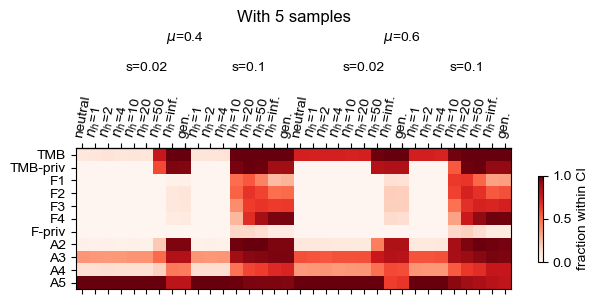

['27Jul_gen_0.4_nosel', '27Jul_0.0_0.4_lowsel', '27Jul_0.5_0.4_lowsel', '27Jul_0.75_0.4_lowsel', '27Jul_0.9_0.4_lowsel', '27Jul_0.95_0.4_lowsel', '27Jul_0.98_0.4_lowsel', '27Jul_1.0_0.4_lowsel', '27Jul_gen_0.4_lowsel', '27Jul_0.0_0.4_highsel', '27Jul_0.5_0.4_highsel', '27Jul_0.75_0.4_highsel', '27Jul_0.9_0.4_highsel', '27Jul_0.95_0.4_highsel', '27Jul_0.98_0.4_highsel', '27Jul_1.0_0.4_highsel', '27Jul_gen_0.4_highsel', '27Jul_gen_0.6_nosel', '27Jul_0.0_0.6_lowsel', '27Jul_0.5_0.6_lowsel', '27Jul_0.75_0.6_lowsel', '27Jul_0.9_0.6_lowsel', '27Jul_0.95_0.6_lowsel', '27Jul_0.98_0.6_lowsel', '27Jul_1.0_0.6_lowsel', '27Jul_gen_0.6_lowsel', '27Jul_0.0_0.6_highsel', '27Jul_0.5_0.6_highsel', '27Jul_0.75_0.6_highsel', '27Jul_0.9_0.6_highsel', '27Jul_0.95_0.6_highsel', '27Jul_0.98_0.6_highsel', '27Jul_1.0_0.6_highsel', '27Jul_gen_0.6_highsel']
27Jul_gen_0.4_nosel gen_0.4_nosel 5000
27Jul_0.0_0.4_lowsel 0.0_0.4_lowsel 5000
27Jul_0.5_0.4_lowsel 0.5_0.4_lowsel 4992
27Jul_0.75_0.4_lowsel 0.75_0.4_lowse

<Figure size 640x480 with 0 Axes>

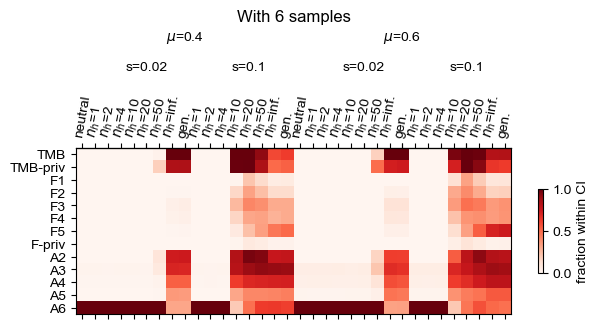

['27Jul_gen_0.4_nosel', '27Jul_0.0_0.4_lowsel', '27Jul_0.5_0.4_lowsel', '27Jul_0.75_0.4_lowsel', '27Jul_0.9_0.4_lowsel', '27Jul_0.95_0.4_lowsel', '27Jul_0.98_0.4_lowsel', '27Jul_1.0_0.4_lowsel', '27Jul_gen_0.4_lowsel', '27Jul_0.0_0.4_highsel', '27Jul_0.5_0.4_highsel', '27Jul_0.75_0.4_highsel', '27Jul_0.9_0.4_highsel', '27Jul_0.95_0.4_highsel', '27Jul_0.98_0.4_highsel', '27Jul_1.0_0.4_highsel', '27Jul_gen_0.4_highsel', '27Jul_gen_0.6_nosel', '27Jul_0.0_0.6_lowsel', '27Jul_0.5_0.6_lowsel', '27Jul_0.75_0.6_lowsel', '27Jul_0.9_0.6_lowsel', '27Jul_0.95_0.6_lowsel', '27Jul_0.98_0.6_lowsel', '27Jul_1.0_0.6_lowsel', '27Jul_gen_0.6_lowsel', '27Jul_0.0_0.6_highsel', '27Jul_0.5_0.6_highsel', '27Jul_0.75_0.6_highsel', '27Jul_0.9_0.6_highsel', '27Jul_0.95_0.6_highsel', '27Jul_0.98_0.6_highsel', '27Jul_1.0_0.6_highsel', '27Jul_gen_0.6_highsel']
27Jul_gen_0.4_nosel gen_0.4_nosel 5000
27Jul_0.0_0.4_lowsel 0.0_0.4_lowsel 5000
27Jul_0.5_0.4_lowsel 0.5_0.4_lowsel 4992
27Jul_0.75_0.4_lowsel 0.75_0.4_lowse

<Figure size 640x480 with 0 Axes>

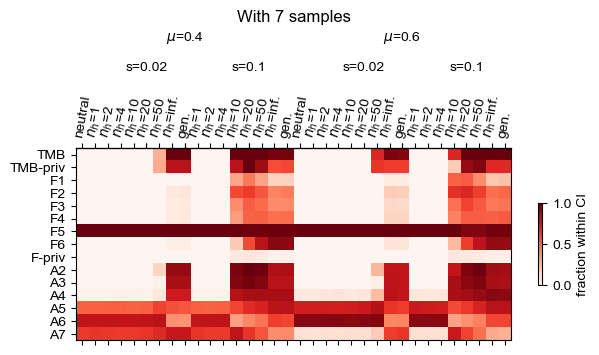

['27Jul_gen_0.4_nosel', '27Jul_0.0_0.4_lowsel', '27Jul_0.5_0.4_lowsel', '27Jul_0.75_0.4_lowsel', '27Jul_0.9_0.4_lowsel', '27Jul_0.95_0.4_lowsel', '27Jul_0.98_0.4_lowsel', '27Jul_1.0_0.4_lowsel', '27Jul_gen_0.4_lowsel', '27Jul_0.0_0.4_highsel', '27Jul_0.5_0.4_highsel', '27Jul_0.75_0.4_highsel', '27Jul_0.9_0.4_highsel', '27Jul_0.95_0.4_highsel', '27Jul_0.98_0.4_highsel', '27Jul_1.0_0.4_highsel', '27Jul_gen_0.4_highsel', '27Jul_gen_0.6_nosel', '27Jul_0.0_0.6_lowsel', '27Jul_0.5_0.6_lowsel', '27Jul_0.75_0.6_lowsel', '27Jul_0.9_0.6_lowsel', '27Jul_0.95_0.6_lowsel', '27Jul_0.98_0.6_lowsel', '27Jul_1.0_0.6_lowsel', '27Jul_gen_0.6_lowsel', '27Jul_0.0_0.6_highsel', '27Jul_0.5_0.6_highsel', '27Jul_0.75_0.6_highsel', '27Jul_0.9_0.6_highsel', '27Jul_0.95_0.6_highsel', '27Jul_0.98_0.6_highsel', '27Jul_1.0_0.6_highsel', '27Jul_gen_0.6_highsel']
27Jul_gen_0.4_nosel gen_0.4_nosel 5000
27Jul_0.0_0.4_lowsel 0.0_0.4_lowsel 5000
27Jul_0.5_0.4_lowsel 0.5_0.4_lowsel 4992
27Jul_0.75_0.4_lowsel 0.75_0.4_lowse

<Figure size 640x480 with 0 Axes>

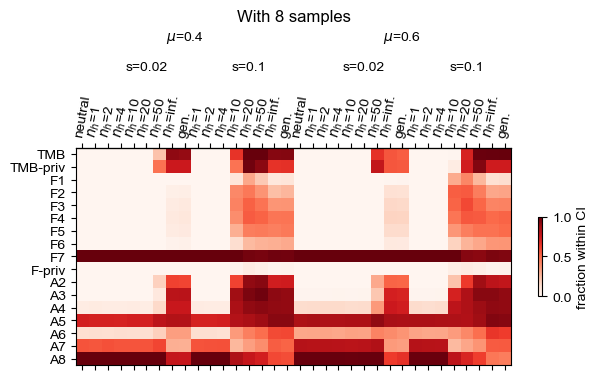

<Figure size 640x480 with 0 Axes>

In [38]:
ordered_labels = []
plt.rcParams['font.size'] = 10

plast_levels = ["0.0", "0.5", "0.75", "0.9", "0.95", "0.98", "1.0", "gen"]
sel_levels = ["nosel", "lowsel", "highsel"]
mut_rates = [0.4, 0.6]

for mut in mut_rates:
    for sel in sel_levels:
        for plast in plast_levels:
            if plast == "gen" or sel != "nosel":
                ordered_labels.append(plast + "_" + str(mut) + "_" + sel)

altered_plast_labels =  ["neutral", 
                "$n_h$"+"=1", "$n_h$"+"=2", "$n_h$"+"=4", "$n_h$"+"=10", "$n_h$"+"=20","$n_h$"+"=50", "$n_h$"+"=inf.", "gen.",
               "$n_h$"+"=1", "$n_h$"+"=2", "$n_h$"+"=4", "$n_h$"+"=10", "$n_h$"+"=20","$n_h$"+"=50", "$n_h$"+"=inf.", "gen."]*2

def get_suitability_matrix(no_samples, ordered_labels, altered_plast_labels, prefix="27Jul", level_mut=70, level_sel=50):
    Xs, ys, all_labels_in_order= load_data(no_samples, prefix=prefix)
    all_labels_in_order = all_labels_in_order[:, 0]
    stat_names = ["TMB", "TMB-priv"] + ["F"+str(s) for s in range(1, no_samples)]+ ["F-priv"] + ["A"+str(s) for s in range(2, no_samples+1)]
    cruk_tumour_stats = np.load("cruk_"+str(no_samples)+"_samples_stat.npy", allow_pickle=True)
    ys = ys[:, 0]
    #get labels in order
    heatmap = np.zeros((len(ordered_labels), len(stat_names)))
    for n, label in enumerate(ordered_labels):
        indices = np.where(ys==label)[0]
        #print(label, plast_labels[n])
        suitable_by_all_metrics = indices
        for m in range(len(stat_names)):
            p5, p95 = np.percentile(cruk_tumour_stats[:, m], 5), np.percentile(cruk_tumour_stats[:, m], 95)
            relevant_stats = Xs[indices, m]
            suitable = np.intersect1d(np.where(relevant_stats>=p5)[0], np.where(relevant_stats<=p95)[0])
            suitable_by_all_metrics = np.intersect1d(suitable_by_all_metrics, suitable)
            heatmap[n][m] = len(suitable)/len(indices)
        #heatmap[n][len(stat_names)] = len(suitable_by_all_metrics)/len(indices)
        #print(heatmap[:, len(stat_names)])
    fig, ax = plt.subplots()
    im=ax.matshow(heatmap.T, cmap=mpl.cm.Reds, vmin=0, vmax=1)
    ax.set_xticks(range(len(ordered_labels)), labels=altered_plast_labels, rotation=80)
    ax2 =ax.secondary_xaxis(location='top')
    ax2.set_xticks([5, 13, 22, 30], labels=[ 's=0.02', 's=0.1',  's=0.02', 's=0.1'])
    #ax2.spines['top'].set_position(('outward', level_sel))
    ax2.tick_params(axis='x', which='major', pad=level_sel)
    ax3 = ax.secondary_xaxis(location='top')
    ax3.set_xticks([8, 25], labels=[ r'$\mu$'+"=0.4",  r'$\mu$'+"=0.6"])
    ax3.tick_params(axis='x', which='major', pad=level_mut)
    ax.set_yticks(range(len(stat_names)), labels=stat_names, rotation=0)
    plt.colorbar(im, pad=0.05, location='right', label='fraction within CI', shrink=0.2)
    plt.title("With "+str(no_samples) + " samples")
    plt.tight_layout()
    plt.show()
    fig.savefig(base_filepath+"/figs_0512"+"/"+prefix+"_"+str(no_samples)+"_TRACERx_comparison_matrix.png", dpi=300)
    plt.clf()

for no_samples in range(2, 9):
    get_suitability_matrix(no_samples, ordered_labels, altered_plast_labels)
    
            

Now plot a dendrogram to show the clustering between scenarios. Remember:
Group 0: plastic, purple.
Group 1: (generally) neutral growth, high plasticity, high mutation rate, orange.
Group 2: low/no plasticity, high selection, red.
Group 3: no plasticity, low selection, low mutation rate, green.
Group 4: (generally) neutral growth, high plasticity, lower mutation rate, yellow.
Group 5: no plasticity, low selection, high mutation rate, blue.

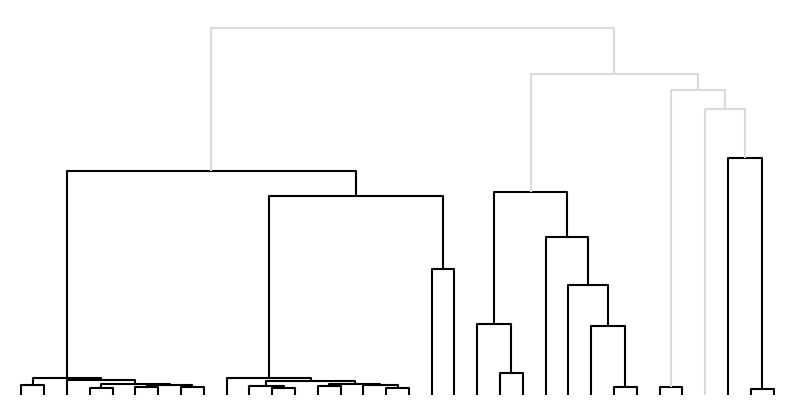

<Figure size 640x480 with 0 Axes>

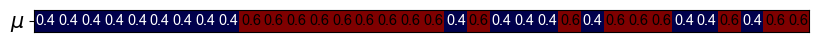

<Figure size 640x480 with 0 Axes>

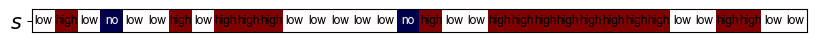

<Figure size 640x480 with 0 Axes>

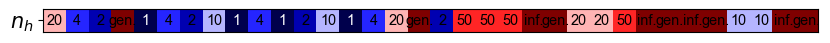

<Figure size 640x480 with 0 Axes>

In [23]:
from scipy.cluster.hierarchy import dendrogram, set_link_color_palette

#the list of labels provides labels in order used in clustering, corresponding to the samples understood by the model
model_children, model_labels, model_distances, provided_labels = np.load(base_filepath+"/clustered_child_matrix_for_tree_plotting_108.npy", allow_pickle=True), np.load(base_filepath+"/clustered_labels_for_tree_plotting_108.npy", allow_pickle=True), np.load(base_filepath+"/clustered_distances_for_tree_plotting_108.npy", allow_pickle=True), np.load(base_filepath+"/clustering_labels_108.npy", allow_pickle=True)


label_dict = np.load(base_filepath+"/clustering_label_dict_108.npy", allow_pickle=True).item()
labels = np.unique(list(label_dict.values())) #all labels in a fixed order

color_list = ["#e41a1c", "#377eb8", "#4daf4a", "#984ea3", "#ff7f00", "#ffff33"]
reordered_color_list = ["#ffff33", "#ff7f00", "#e41a1c", "#4daf4a", "#377eb8", "#984ea3"]
#labels_in_color_order = np.unique(list(label_dict.values()))



set_link_color_palette(['black' for color in reordered_color_list])

def plot_dendrogram(model_children, model_distances, **kwargs):


    # Distances between each pair of children
    # We will use a uniform shape for plotting, just for safety
    distance = np.arange(model_children.shape[0])

    # The number of observations contained in each cluster level
    no_of_observations = np.arange(2, model_children.shape[0]+2)

    # Create linkage matrix and then plot the dendrogram
    linkage_matrix = np.column_stack([model_children, model_distances, no_of_observations]).astype(float)

    # Plot the corresponding dendrogram
    dend = dendrogram(linkage_matrix, **kwargs)
    return dend['ivl']


fig, ax = plt.subplots(figsize=(10, 5))
#plt.title('Hierarchical Clustering Dendrogram')
dend_labels = plot_dendrogram(model_children, model_distances, labels=None, truncate_mode=None, color_threshold=1.0, above_threshold_color="#dbdad5")
plt.axis("off")
fig.savefig(base_filepath+"/figs_0512"+"/dendrogram.svg", format="svg")
plt.show()
plt.clf()

dend_categ_labels = [provided_labels[int(lbl)] for lbl in dend_labels]
np.save("dendrogram_ordered_labels.npy", dend_categ_labels)

def get_plast(label, poss_tags=["0.0", "0.5", "0.75", "0.9", "0.95", "0.98", "1.0", "gen"]):
    plast = None
    for n, tag in enumerate(poss_tags):
        if tag+"_" in label:
            plast = n
    return plast

def get_sel(label, poss_tags=["nosel", "lowsel", "highsel"]):
    sel = None
    for n, tag in enumerate(poss_tags):
        if "_"+tag in label:
            sel = n
    return sel

#marker refers to 
def get_mut_rate(label, poss_tags=["0.4", "0.6"]):
    rate = None
    for n, tag in enumerate(poss_tags):
        #print(tag, label)
        if tag+"_" in label:
            rate = n
    return rate

mut_rates = ["0.4", "0.6"]
sel_levels = ["no", "low", "high"]
plast_levels = ["1", "2", "4", "10", "20", "50", "inf.", "gen."]
param_heatmap = np.zeros((3, len(dend_categ_labels)))
mut_labels, sel_labels, plast_labels = [], [], []
for n, label in enumerate(dend_categ_labels):
    mu = get_mut_rate(label)
    param_heatmap[0][n] = mu/(len(mut_rates)-1)
    mut_labels.append(mut_rates[mu])

    sel = get_sel(label)
    param_heatmap[1][n] = sel/(len(sel_levels)-1)
    sel_labels.append(sel_levels[sel])

    plast = get_plast(label)
    param_heatmap[2][n] = plast/(len(plast_levels)-1) if plast != (len(plast_levels)-2) else 1
    plast_labels.append(plast_levels[plast])


param_text_heatmap = [mut_labels, sel_labels, plast_labels]
# fig, ax = plt.subplots(figsize=(10, 8))
# ax.imshow(param_heatmap, cmap=mpl.cm.viridis)
# ax.set_yticks([0, 1, 2], [r'$\mu$', "s", "$n_h$"])
# ax.set_xticks([], [])
# for i in range(3):
#         for j in range(len(dend_categ_labels)):
#             ax.text(j, i, param_text_heatmap[i][j], va='center', ha='center', color='black', fontsize='x-small')

fig, ax = plt.subplots(figsize=(10, 3))
ax.matshow([param_heatmap[0]], cmap=mpl.cm.seismic)
ax.set_yticks([0], [r'$\mu$'])
ax.set_xticks([], [])
for j in range(len(dend_categ_labels)):
    ax.text(j, 0, param_text_heatmap[0][j], va='center', ha='center', color='black' if param_text_heatmap[0][j]=="0.6" else 'white', fontsize='x-small')
fig.savefig(base_filepath+"/figs_0512"+"/dendrogram_mu.svg", format="svg")
plt.show()
plt.clf()

fig, ax = plt.subplots(figsize=(10, 3))
ax.matshow([param_heatmap[1]], cmap=mpl.cm.seismic)
ax.set_yticks([0], [r'$s$'])
ax.set_xticks([], [])
for j in range(len(dend_categ_labels)):
    ax.text(j, 0, param_text_heatmap[1][j], va='center', ha='center', color='black' if param_text_heatmap[1][j]!= "no" else 'white', fontsize='xx-small')
fig.savefig(base_filepath+"/figs_0512"+"/dendrogram_s.svg", format="svg")
plt.show()
plt.clf()

fig, ax = plt.subplots(figsize=(10, 3))
ax.matshow([param_heatmap[2]], cmap=mpl.cm.seismic)
ax.set_yticks([0], [r'$n_h$'])
ax.set_xticks([], [])
for j in range(len(dend_categ_labels)):
    ax.text(j, 0, param_text_heatmap[2][j], va='center', ha='center', color='black' if param_text_heatmap[2][j] != "1" else 'white', fontsize='x-small')
fig.savefig(base_filepath+"/figs_0512"+"/dendrogram_nh.svg", format="svg")
plt.show()
plt.clf()

Plastic tumours have more subclonal drivers. Not sure how to interpret this yet. (They also have more subclonal mutations.) Neutral muts are very easy to identify because we're no longer separating by mutation rate.

Okay, now add in genetic + nongenetic selection. Limit the number of scenarios we're asking to tell apart. We have as a baseline weak genetic selection with plasticity on top: we want to ask whether that is identifiable when compared to:
1. Weak genetic selection alone (at either mutation rate).
2. Strong genetic selection alone (at either mutation rate).
3. Weak genetic + strong nongenetic with different strengths and frequencies.


In [88]:

#load this limited set of scenarios
#all overlay scenarios are run at 0.4 by default-- the mutation rate is not written into file names
def load_data_with_overlay(no_samples, base_prefix="27Jul", overlay_prefix="1Aug"):
    all_file_names = [base_prefix+"_gen_0.4_lowsel", base_prefix+"_gen_0.4_highsel", base_prefix+"_gen_0.6_lowsel", base_prefix+"_gen_0.6_highsel"] #baseline scenarios- weak gen + strong selection
    all_labels = ["gen_0.4_lowsel", "gen_0.4_highsel", "gen_0.6_lowsel", "gen_0.6_highsel"]
    plast_levels = ["0.0", "0.5", "0.75", "0.9", "0.95", "0.98", "1.0"]
    suffices = ["strength_1", "strength_2", "strength_5", "freq_10",  "freq_100",  "freq_1000"]
    for plast in plast_levels:
        for suffix in suffices:
            filename = overlay_prefix+"_"+plast+"_"+suffix+"_lowsel"
            label = plast+"_"+suffix+"_lowsel"
            all_file_names.append(filename)
            all_labels.append(label)
    #print(all_file_names)
    Xs, ys = np.array([]), np.array([])
    for filename, label in zip(all_file_names, all_labels):
        stats = np.load(base_filepath+filename+"_"+str(no_samples)+"_samples.npy", allow_pickle=True)
        labels = np.tile(label, (len(stats), 1))
        #print(filename, label, len(stats))
        if len(Xs)==0:
            Xs = stats
            ys = labels
        else:
            Xs = np.concatenate((Xs, stats))
            ys = np.concatenate((ys, labels))
    #get a unique list of all the labels
    all_labels_in_order = np.unique(ys, axis=0)
    return Xs, ys, all_labels_in_order
    
def get_all_data_with_overlay(no_samples, valid_size=0.1, base_prefix="27Jul", overlay_prefix="1Aug"):
    Xs, ys, all_labels_in_order =  load_data_with_overlay(no_samples, base_prefix=base_prefix, overlay_prefix=overlay_prefix)
    X_tt, X_valid, y_tt, y_valid = train_test_split(Xs, ys, test_size=valid_size)
    return X_tt, X_valid, y_tt, y_valid, all_labels_in_order

    

#run for 10 train/test splits, consider consistency of outcomes
def test_and_validate_overlay_problem(savename, no_samples, params, num_trials=10, test_size=0.2, valid_size=0.1, base_prefix="27Jul", overlay_prefix="1Aug"):
    X_tt, X_valid, y_tt, y_valid, all_labels_in_order =  get_all_data_with_overlay(no_samples, valid_size=valid_size, base_prefix=base_prefix, overlay_prefix=overlay_prefix)
    y_tt_bin, y_valid_bin = manual_label_conversion(y_tt, all_labels_in_order), manual_label_conversion(y_valid, all_labels_in_order)
    stat_names = ["TMB", "TMB-priv"] + ["F"+str(s) for s in range(1, no_samples)]+ ["F-priv"] + ["A"+str(s) for s in range(2, no_samples+1)]
    overall_outcomes_assigned = []
    total_importances = []
    #save the validation set, since these are the relative values you want to test
    np.save(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_X_valid.npy", X_valid)
    np.save(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_y_valid.npy", y_valid)
    for no_trial in range(num_trials):
        X_train, X_test, y_train, y_test = tt_split(X_tt, y_tt_bin, test_size=test_size) #split a different way, keeping validation set
        classifiers, assigned_outcomes, class_matrix, confusion_matrix, fprs, tprs, all_threshes = train_model_opt(X_train, X_test, y_train, y_test, all_labels_in_order, params)
        y_pred_valid = predict_on_test_set(classifiers, X_valid)
        valid_assigned_outcomes, y_pred_valid_norm = assign_outcomes(y_pred_valid) #normalise predictions and make classifications
        overall_outcomes_assigned.append(valid_assigned_outcomes) #these should all be the same
        np.save(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_trial_"+str(no_trial)+"_rocs_per_class.npy", np.array([fprs, tprs, all_threshes], dtype=object))
        np.save(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_trial_"+str(no_trial)+"_matrices.npy", [class_matrix, confusion_matrix])
        all_importances = []
        for label, clf in zip(all_labels_in_order[:, 0], classifiers):
            importances = clf.feature_importances_
            all_importances.append(importances)
        total_importances.append(all_importances)
    num_valid_points, num_classes = y_valid_bin.shape
    y_as_number = np.array([np.where(y_valid_bin[n]==1)[0][0] for n in range(num_valid_points)])
    return y_as_number, overall_outcomes_assigned, all_labels_in_order, total_importances

def train_classifiers_on_overlay(savename, no_samples, params= {'learning_rate': 0.2, 'max_depth': 3, 'subsample': 0.6, 'colsample_bytree': 0.8, 'min_child_weight': 1, 'reg_alpha': 0.1, 'reg_lambda': 1, 'gamma': 0.5, 'n_estimators': 100}, num_trials=10, test_size=0.2, valid_size=0.1,  base_prefix="27Jul", overlay_prefix="1Aug"):
    y_as_number, overall_outcomes_assigned, all_labels_in_order, total_importances = test_and_validate_overlay_problem(savename, no_samples, params, num_trials=num_trials, test_size=test_size, valid_size=valid_size, base_prefix=base_prefix, overlay_prefix=overlay_prefix)
    np.save(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_y_as_number.npy", y_as_number) #numerical labels
    np.save(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_overall_outcomes_assigned.npy", np.array(overall_outcomes_assigned)) #results of classification
    np.save(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_all_labels_in_order.npy", all_labels_in_order) 
    np.save(base_filepath+"/"+savename+"_samples_"+str(no_samples)+"_total_importances.npy", np.array(total_importances)) #all importances across runs

#trial this for all sample numbers
for no_samples in range(2, 9):
    train_classifiers_on_overlay("5Aug_overlay", no_samples)
    
    

Plot these as matrices.

In [45]:


#Load 10 classification matrices and measure confusion with any set of scenarios
#return both the average and the maximum
def get_cross_confusion_matrix(no_samples, label_matrix, target_labels, prefix="5Aug_overlay", num_trials=10):
    all_labels_in_order = np.load(base_filepath+"/"+prefix+"_samples_"+str(no_samples)+"_all_labels_in_order.npy", allow_pickle=True)
    target_indices = []
    for n, label in enumerate(all_labels_in_order):
        if label in target_labels:
            target_indices.append(n) #we are interested in the odds that any scenario will be confused for something in target_labels
    target_indices = np.array(target_indices)
    
    rows, cols = label_matrix.shape
    av_conf_matrix, max_conf_matrix = np.zeros((rows, cols, num_trials)), np.zeros((rows, cols, num_trials)) #mimic shape not datatype
    for trial_num in range(num_trials):
        [class_matrix, confusion_matrix]= np.load(base_filepath+prefix+"_samples_"+str(no_samples)+"_trial_"+str(trial_num)+"_matrices.npy", allow_pickle=True)
        for n in range(rows):
            for m in range(cols):
                source_label = label_matrix[n][m]
                source_index = -1
                for n_, label in enumerate(all_labels_in_order):
                    if label==source_label:
                        source_index = n_
                        break
                av_conf_matrix[n][m][trial_num] = np.average(class_matrix[source_index][target_indices]) #odds that source will be assigned as target
                max_conf_matrix[n][m][trial_num] = np.max(class_matrix[source_index][target_indices])
                
    #now average this across 10 runs
    av_conf_matrix_ens, max_conf_matrix_ens =  np.zeros((rows, cols)), np.zeros((rows, cols))
    for n in range(rows):
        for m in range(cols):
            av_conf_matrix_ens[n][m] = np.average(av_conf_matrix[n][m])
            max_conf_matrix_ens[n][m] = np.average(max_conf_matrix[n][m])

    return av_conf_matrix_ens, max_conf_matrix_ens

#Load 10 classification matrices and measure similarity to any other matrix
def get_similarity_matrix(no_samples, label_matrix, target_label, prefix="5Aug_overlay", num_trials=10):
    all_labels_in_order = np.load(base_filepath+"/"+prefix+"_samples_"+str(no_samples)+"_all_labels_in_order.npy", allow_pickle=True)
    target_index = -1
    for n, label in enumerate(all_labels_in_order):
        if label==target_label:
            target_index = n #we are interested in the odds that any scenario will be confused for something in target_labels
            break
            
    rows, cols = label_matrix.shape
    sim_matrix = np.zeros((rows, cols, num_trials)) #mimic shape not datatype
    for trial_num in range(num_trials):
        [class_matrix, confusion_matrix]= np.load(base_filepath+prefix+"_samples_"+str(no_samples)+"_trial_"+str(trial_num)+"_matrices.npy", allow_pickle=True)
        for n in range(rows): #iterate over the matrix
            for m in range(cols):
                source_label = label_matrix[n][m]
                source_index = -1
                for n_, label in enumerate(all_labels_in_order):
                    if label==source_label:
                        source_index = n_
                        break
                #find the angle between the two similarity vectors
                sim_matrix[n][m][trial_num] = np.sum(np.multiply(class_matrix[source_index], class_matrix[target_index]))/(np.linalg.norm(class_matrix[source_index])*np.linalg.norm(class_matrix[target_index]))

    #now average this
    averaged_sim_matrix =  np.zeros((rows, cols))
    for n in range(rows):
        for m in range(cols):
            averaged_sim_matrix[n][m] = np.average(sim_matrix[n][m])

    return averaged_sim_matrix

#Load 10 classification matrices and measure whether each scenario is accurately identified as itself
def get_identification_matrix(no_samples, label_matrix, prefix="5Aug_overlay", num_trials=10):
    all_labels_in_order = np.load(base_filepath+"/"+prefix+"_samples_"+str(no_samples)+"_all_labels_in_order.npy", allow_pickle=True)
    
    rows, cols = label_matrix.shape
    conf_matrix = np.zeros((rows, cols, num_trials)) #mimic shape not datatype
    for trial_num in range(num_trials):
        [class_matrix, confusion_matrix]= np.load(base_filepath+prefix+"_samples_"+str(no_samples)+"_trial_"+str(trial_num)+"_matrices.npy", allow_pickle=True)
        for n in range(rows):
            for m in range(cols):
                source_label = label_matrix[n][m]
                source_index = -1
                for n_, label in enumerate(all_labels_in_order):
                    if label==source_label:
                        source_index = n_
                        break
                conf_matrix[n][m][trial_num] = np.sum(class_matrix[source_index][source_index]) #odds that source will be assigned as target
                
    #now average this
    averaged_conf_matrix =  np.zeros((rows, cols))
    for n in range(rows):
        for m in range(cols):
            averaged_conf_matrix[n][m] = np.average(conf_matrix[n][m])

    return averaged_conf_matrix


#confused for weak genetic selection?
weak_target_labels = ["gen_0.4_lowsel", "gen_0.6_lowsel"]
#strong genetic selection
strong_target_labels = ["gen_0.4_highsel", "gen_0.6_highsel"]
#confused for something with overlaid plasticity?
with_plast_labels = []

plast_levels = ["0.0", "0.5", "0.75", "0.9", "0.95", "0.98", "1.0"]
suffices = ["strength_1", "strength_2", "strength_5", "freq_10",  "freq_100",  "freq_1000"]
for plast in plast_levels:
    for suffix in suffices:
        label = plast+"_"+suffix+"_lowsel"
        with_plast_labels.append(label)


savename = "5Aug_with_overlay"
for no_samples in range(2, 9):
    #work out confusion rates for increasing strength
    weak_conf_strength_mat_av, weak_conf_strength_mat_max = get_cross_confusion_matrix(no_samples, strength_mat, weak_target_labels)
    strong_conf_strength_mat_av, strong_conf_strength_mat_max =  get_cross_confusion_matrix(no_samples, strength_mat, strong_target_labels)
    all_plast_conf_strength_mat_av, all_plast_conf_strength_mat_max  = get_cross_confusion_matrix(no_samples, strength_mat, with_plast_labels)
    strength_iden_matrix = get_identification_matrix(no_samples, strength_mat)
    strength_sim_weak_matrix = get_similarity_matrix(no_samples, strength_mat, "gen_0.4_lowsel")
    strength_sim_strong_matrix = get_similarity_matrix(no_samples, strength_mat, "gen_0.4_highsel")
    
    np.save(base_filepath+"/weak_conf_strength_mat_"+savename+"_"+str(no_samples)+"_samples.npy", [weak_conf_strength_mat_av, weak_conf_strength_mat_max])
    np.save(base_filepath+"/strong_conf_strength_mat_"+savename+"_"+str(no_samples)+"_samples.npy", [strong_conf_strength_mat_av, strong_conf_strength_mat_max])
    np.save(base_filepath+"/all_plast_conf_strength_mat_"+savename+"_"+str(no_samples)+"_samples.npy", [all_plast_conf_strength_mat_av, all_plast_conf_strength_mat_max])
    np.save(base_filepath+"/strength_iden_mat_"+savename+"_"+str(no_samples)+"_samples.npy", strength_iden_matrix)
    np.save(base_filepath+"/strength_sim_"+savename+"_"+str(no_samples)+"_samples.npy", [strength_sim_weak_matrix, strength_sim_strong_matrix])

    
    #work out confusion rates for increasing frequencies
    weak_conf_freq_mat_av, weak_conf_freq_mat_max = get_cross_confusion_matrix(no_samples, freq_mat, weak_target_labels)
    strong_conf_freq_mat_av, strong_conf_freq_mat_max =  get_cross_confusion_matrix(no_samples, freq_mat, strong_target_labels)
    all_plast_conf_freq_mat_av, all_plast_conf_freq_mat_max  = get_cross_confusion_matrix(no_samples, freq_mat, with_plast_labels)
    freq_iden_matrix = get_identification_matrix(no_samples, freq_mat)
    freq_sim_weak_matrix = get_similarity_matrix(no_samples, freq_mat, "gen_0.4_lowsel")
    freq_sim_strong_matrix = get_similarity_matrix(no_samples, freq_mat, "gen_0.4_highsel")
    

    np.save(base_filepath+"/weak_conf_freq_mat_"+savename+"_"+str(no_samples)+"_samples.npy", [weak_conf_freq_mat_av, weak_conf_freq_mat_max])
    np.save(base_filepath+"/strong_conf_freq_mat_"+savename+"_"+str(no_samples)+"_samples.npy", [strong_conf_freq_mat_av, strong_conf_freq_mat_max])
    np.save(base_filepath+"/all_plast_conf_freq_mat_"+savename+"_"+str(no_samples)+"_samples.npy", [all_plast_conf_freq_mat_av, all_plast_conf_freq_mat_max])
    np.save(base_filepath+"/freq_iden_mat_"+savename+"_"+str(no_samples)+"_samples.npy", freq_iden_matrix)
    np.save(base_filepath+"/freq_sim_"+savename+"_"+str(no_samples)+"_samples.npy", [freq_sim_weak_matrix, freq_sim_strong_matrix])

    
    


#Load 10 classification matrices and measure confusion with any set of scenarios
#return both the average and the maximum
def get_cross_confusion_matrix(no_samples, label_matrix, target_labels, prefix="5Aug_overlay", num_trials=10):
    all_labels_in_order = np.load(base_filepath+"/"+prefix+"_samples_"+str(no_samples)+"_all_labels_in_order.npy", allow_pickle=True)
    target_indices = []
    for n, label in enumerate(all_labels_in_order):
        if label in target_labels:
            target_indices.append(n) #we are interested in the odds that any scenario will be confused for something in target_labels
    target_indices = np.array(target_indices)
    
    rows, cols = label_matrix.shape
    av_conf_matrix, max_conf_matrix = np.zeros((rows, cols, num_trials)), np.zeros((rows, cols, num_trials)) #mimic shape not datatype
    for trial_num in range(num_trials):
        [class_matrix, confusion_matrix]= np.load(base_filepath+prefix+"_samples_"+str(no_samples)+"_trial_"+str(trial_num)+"_matrices.npy", allow_pickle=True)
        for n in range(rows):
            for m in range(cols):
                source_label = label_matrix[n][m]
                source_index = -1
                for n_, label in enumerate(all_labels_in_order):
                    if label==source_label:
                        source_index = n_
                        break
                av_conf_matrix[n][m][trial_num] = np.average(class_matrix[source_index][target_indices]) #odds that source will be assigned as target
                max_conf_matrix[n][m][trial_num] = np.max(class_matrix[source_index][target_indices])
                
    #now average this across 10 runs
    av_conf_matrix_ens, max_conf_matrix_ens =  np.zeros((rows, cols)), np.zeros((rows, cols))
    for n in range(rows):
        for m in range(cols):
            av_conf_matrix_ens[n][m] = np.average(av_conf_matrix[n][m])
            max_conf_matrix_ens[n][m] = np.average(max_conf_matrix[n][m])

    return av_conf_matrix_ens, max_conf_matrix_ens

#Load 10 classification matrices and measure similarity to any other matrix
def get_similarity_matrix(no_samples, label_matrix, target_label, prefix="5Aug_overlay", num_trials=10):
    all_labels_in_order = np.load(base_filepath+"/"+prefix+"_samples_"+str(no_samples)+"_all_labels_in_order.npy", allow_pickle=True)
    target_index = -1
    for n, label in enumerate(all_labels_in_order):
        if label==target_label:
            target_index = n #we are interested in the odds that any scenario will be confused for something in target_labels
            break
            
    rows, cols = label_matrix.shape
    sim_matrix = np.zeros((rows, cols, num_trials)) #mimic shape not datatype
    for trial_num in range(num_trials):
        [class_matrix, confusion_matrix]= np.load(base_filepath+prefix+"_samples_"+str(no_samples)+"_trial_"+str(trial_num)+"_matrices.npy", allow_pickle=True)
        for n in range(rows): #iterate over the matrix
            for m in range(cols):
                source_label = label_matrix[n][m]
                source_index = -1
                for n_, label in enumerate(all_labels_in_order):
                    if label==source_label:
                        source_index = n_
                        break
                #find the angle between the two similarity vectors
                sim_matrix[n][m][trial_num] = np.sum(np.multiply(class_matrix[source_index], class_matrix[target_index]))/(np.linalg.norm(class_matrix[source_index])*np.linalg.norm(class_matrix[target_index]))

    #now average this
    averaged_sim_matrix =  np.zeros((rows, cols))
    for n in range(rows):
        for m in range(cols):
            averaged_sim_matrix[n][m] = np.average(sim_matrix[n][m])

    return averaged_sim_matrix

#Load 10 classification matrices and measure whether each scenario is accurately identified as itself
def get_identification_matrix(no_samples, label_matrix, prefix="5Aug_overlay", num_trials=10):
    all_labels_in_order = np.load(base_filepath+"/"+prefix+"_samples_"+str(no_samples)+"_all_labels_in_order.npy", allow_pickle=True)
    
    rows, cols = label_matrix.shape
    conf_matrix = np.zeros((rows, cols, num_trials)) #mimic shape not datatype
    for trial_num in range(num_trials):
        [class_matrix, confusion_matrix]= np.load(base_filepath+prefix+"_samples_"+str(no_samples)+"_trial_"+str(trial_num)+"_matrices.npy", allow_pickle=True)
        for n in range(rows):
            for m in range(cols):
                source_label = label_matrix[n][m]
                source_index = -1
                for n_, label in enumerate(all_labels_in_order):
                    if label==source_label:
                        source_index = n_
                        break
                conf_matrix[n][m][trial_num] = np.sum(class_matrix[source_index][source_index]) #odds that source will be assigned as target
                
    #now average this
    averaged_conf_matrix =  np.zeros((rows, cols))
    for n in range(rows):
        for m in range(cols):
            averaged_conf_matrix[n][m] = np.average(conf_matrix[n][m])

    return averaged_conf_matrix


#confused for weak genetic selection?
weak_target_labels = ["gen_0.4_lowsel", "gen_0.6_lowsel"]
#strong genetic selection
strong_target_labels = ["gen_0.4_highsel", "gen_0.6_highsel"]
#confused for something with overlaid plasticity?
with_plast_labels = []

plast_levels = ["0.0", "0.5", "0.75", "0.9", "0.95", "0.98", "1.0"]
suffices = ["strength_1", "strength_2", "strength_5", "freq_10",  "freq_100",  "freq_1000"]
for plast in plast_levels:
    for suffix in suffices:
        label = plast+"_"+suffix+"_lowsel"
        with_plast_labels.append(label)





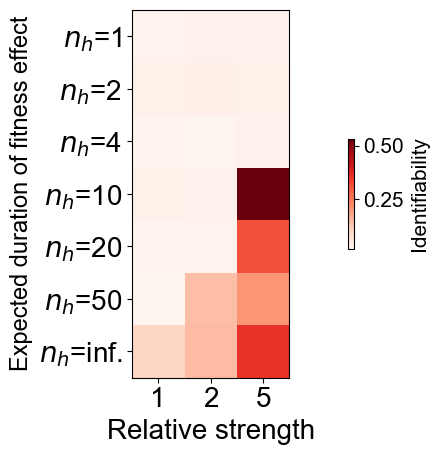

<Figure size 640x480 with 0 Axes>

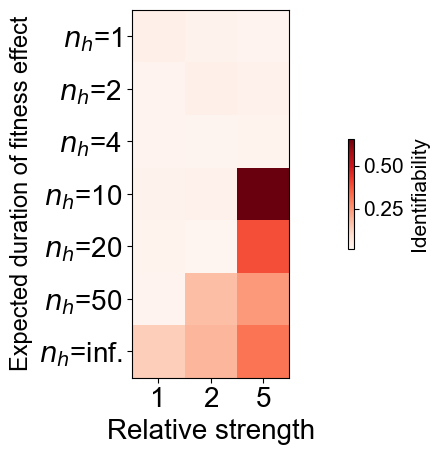

<Figure size 640x480 with 0 Axes>

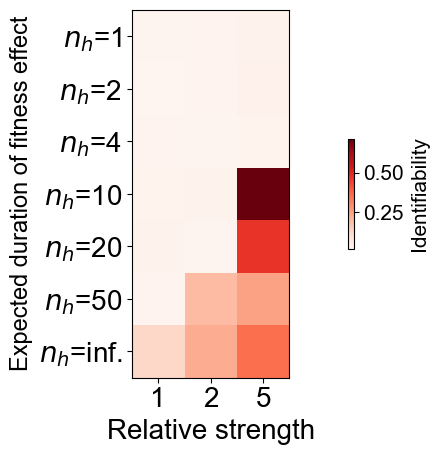

<Figure size 640x480 with 0 Axes>

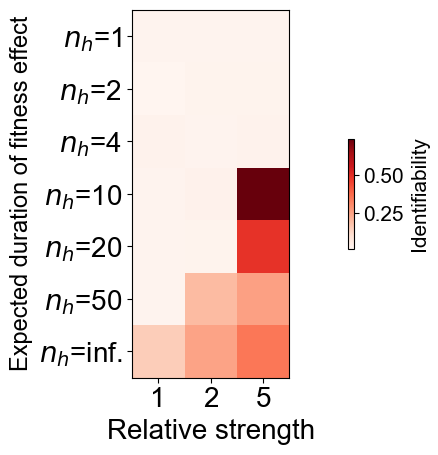

<Figure size 640x480 with 0 Axes>

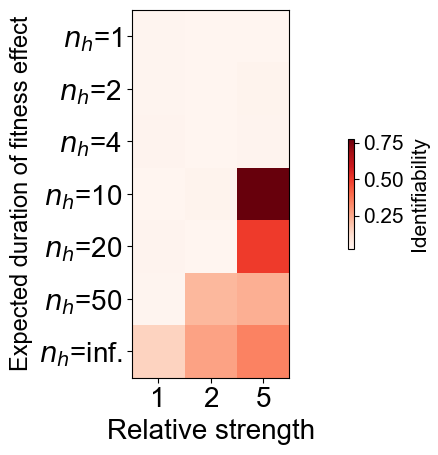

<Figure size 640x480 with 0 Axes>

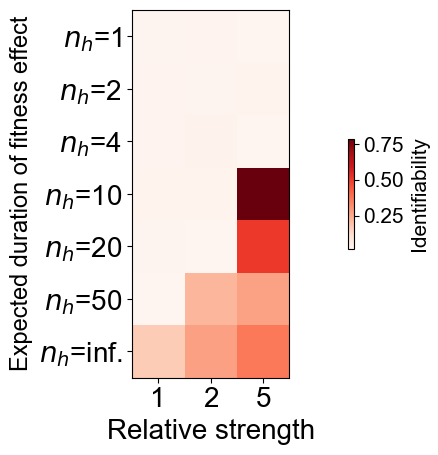

<Figure size 640x480 with 0 Axes>

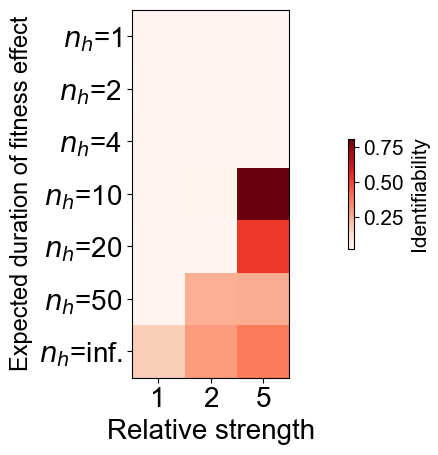

<Figure size 640x480 with 0 Axes>

In [82]:
#plt.rcParams["font.size"] = 20

def display_comparison_matrices_strength(no_samples, savename, plast_levels=["$n_h$"+"=1", "$n_h$"+"=2", "$n_h$"+"=4", "$n_h$"+"=10", "$n_h$"+"=20","$n_h$"+"=50", "$n_h$"+"=inf."], strength_levels=["1", "2", "5"]):
    [weak_conf_strength_mat_av, weak_conf_strength_mat_max]  = np.load(base_filepath+"/weak_conf_strength_mat_"+savename+"_"+str(no_samples)+"_samples.npy", allow_pickle=True)
    [strong_conf_strength_mat_av, strong_conf_strength_mat_max] =  np.load(base_filepath+"/strong_conf_strength_mat_"+savename+"_"+str(no_samples)+"_samples.npy", allow_pickle=True)
    [all_plast_conf_strength_mat_av, all_plast_conf_strength_mat_max] = np.load(base_filepath+"/all_plast_conf_strength_mat_"+savename+"_"+str(no_samples)+"_samples.npy", allow_pickle=True)
    strength_iden_mat = np.load(base_filepath+"/strength_iden_mat_"+savename+"_"+str(no_samples)+"_samples.npy", allow_pickle=True)
    [strength_sim_weak_matrix, strength_sim_strong_matrix] = np.load(base_filepath+"/strength_sim_"+savename+"_"+str(no_samples)+"_samples.npy", allow_pickle=True)

    
    rows, cols = len(plast_levels), len(strength_levels)
    # max_conf_matrix = np.zeros((rows, cols)) #records which scenario is the likeliest

    # for n in range(rows):
    #     for m in range(cols):
    #         max_conf_matrix[n][m] = np.argmax(np.array([weak_conf_strength_mat[n][m], strong_conf_strength_mat[n][m], all_plast_conf_strength_mat[n][m]]))
    #         #this is 0 if the scenario is most likely to be classed as weak gen selection, 1 if most likely to be classed as strong, 2 if most likely to be classed as weak gen+ plast
    #         #print(np.array([weak_conf_strength_mat[n][m], strong_conf_strength_mat[n][m], all_plast_conf_strength_mat[n][m]]))

    # fig, ax1 = plt.subplots()
    # im=ax1.matshow(strength_sim_weak_matrix, origin='lower', cmap='Blues')
    # ax1.set_yticks(range(rows), plast_levels, fontsize=20)
    # ax1.set_xticks(range(cols), strength_levels, fontsize=20)
    # ax1.set_ylabel("plasticity")
    # ax1.set_xlabel('relative strength', fontsize=20)
    # cbar = fig.colorbar(im, location='right', pad=0.1, shrink=0.3)
    # cbar.ax.set_ylabel("similarity to weak gen. selection", fontsize=15)
    # ax1.tick_params(top=False, bottom=True,
    #                labeltop=False, labelbottom=True)
    # #plt.title("With "+str(no_samples)+" samples")
    # plt.tight_layout()
    # plt.tight_layout()
    # plt.show()
    # fig.savefig(base_filepath+"/figs_0512"+"/weak_sim_"+savename+"_"+str(no_samples)+"_samples_strength.png", dpi=300)
    # plt.clf()
    
    # fig, ax1 = plt.subplots()
    # im=ax1.matshow(strength_sim_strong_matrix, origin='lower', cmap='Greens')
    # ax1.set_yticks(range(rows), plast_levels, fontsize=20)
    # ax1.set_xticks(range(cols), strength_levels, fontsize=20)
    # ax1.set_ylabel("plasticity")
    # ax1.set_xlabel('relative strength', fontsize=20)
    # cbar = fig.colorbar(im, location='right', pad=0.1, shrink=0.3)
    # cbar.ax.set_ylabel("similarity to strong gen. selection", fontsize=15)
    # #plt.title("With "+str(no_samples)+" samples")
    # ax1.tick_params(top=False, bottom=True,
    #                labeltop=False, labelbottom=True)
    # plt.tight_layout()
    # plt.show()
    # fig.savefig(base_filepath+"/figs_0512"+"/strong_sim_"+savename+"_"+str(no_samples)+"_samples_strength.png", dpi=300)
    # plt.clf()
    
    fig, ax1 = plt.subplots()
    im=ax1.matshow(strength_iden_mat, origin='lower', cmap='Reds')
    ax1.set_yticks(range(rows), plast_levels, fontsize=20)
    ax1.set_xticks(range(cols), strength_levels, fontsize=20)
    ax1.set_ylabel("Expected duration of fitness effect", fontsize=17)
    ax1.set_xlabel('Relative strength', fontsize=20)
    cbar = fig.colorbar(im, location='right', pad=0.1, shrink=0.3)
    cbar.ax.set_ylabel("Identifiability", fontsize=15)
    #plt.title("With "+str(no_samples)+" samples")
    ax1.tick_params(top=False, bottom=True,
                   labeltop=False, labelbottom=True)
    ax1.invert_yaxis()
    plt.tight_layout()
    plt.show()
    fig.savefig(base_filepath+"/figs_0512"+"/strength_iden_mat_"+savename+"_"+str(no_samples)+"_samples.png", dpi=300)
    plt.clf()

for no_samples in range(2, 9):
    display_comparison_matrices_strength(no_samples, "5Aug_with_overlay")

Put identifiability figure in supp. but not main figure.

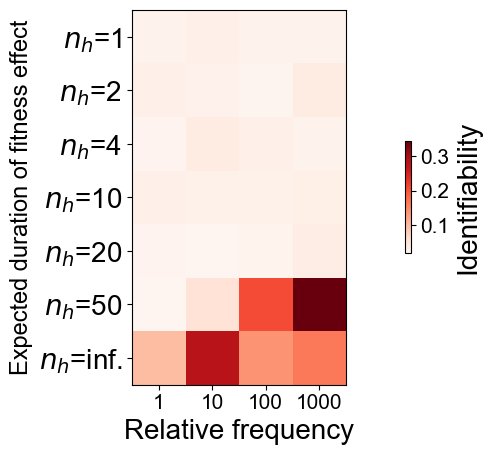

<Figure size 640x480 with 0 Axes>

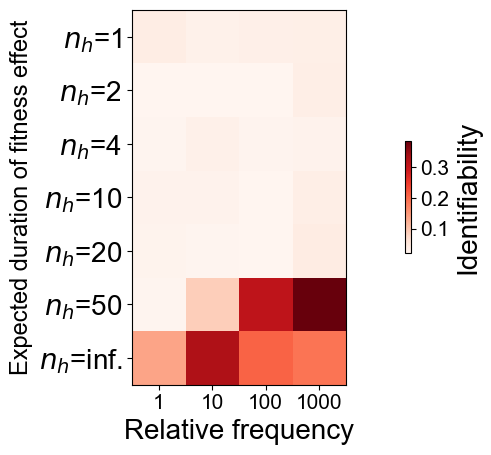

<Figure size 640x480 with 0 Axes>

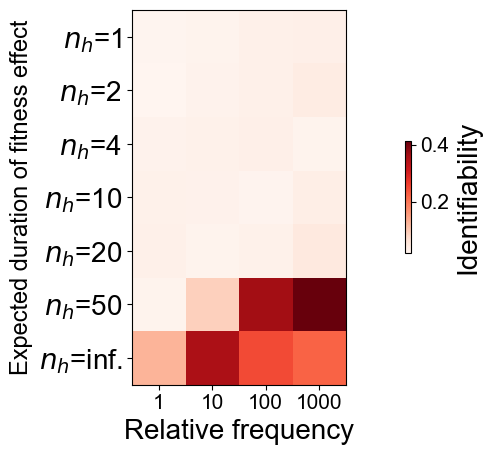

<Figure size 640x480 with 0 Axes>

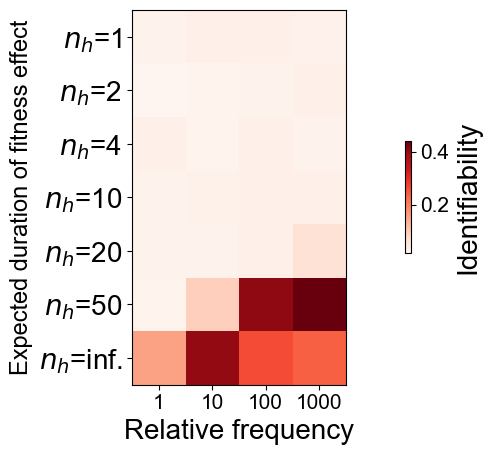

<Figure size 640x480 with 0 Axes>

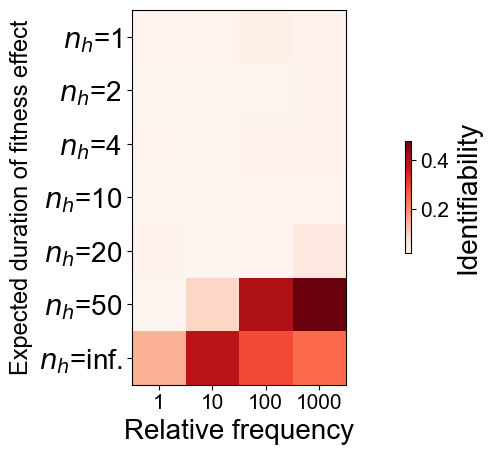

<Figure size 640x480 with 0 Axes>

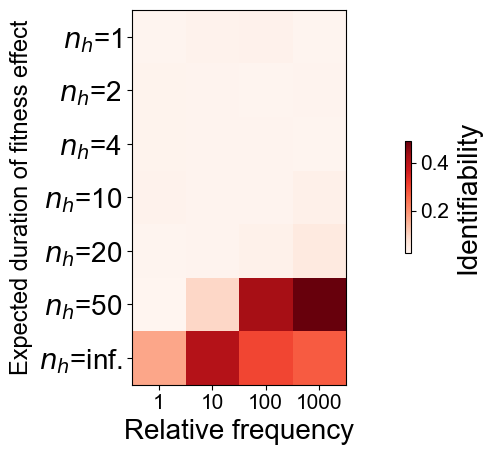

<Figure size 640x480 with 0 Axes>

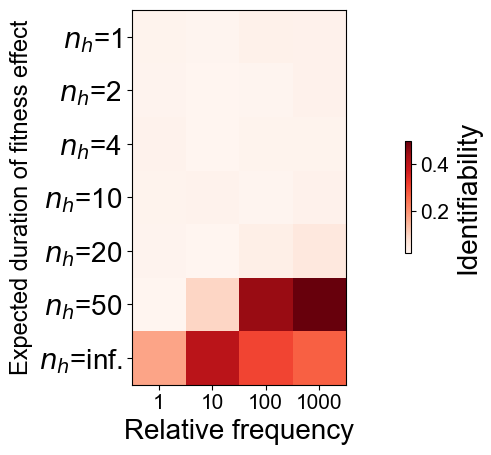

<Figure size 640x480 with 0 Axes>

In [81]:
def display_comparison_matrices_freq(no_samples, savename, plast_levels=["$n_h$"+"=1", "$n_h$"+"=2", "$n_h$"+"=4", "$n_h$"+"=10", "$n_h$"+"=20","$n_h$"+"=50", "$n_h$"+"=inf."], freq_levels=["1", "10", "100", "1000"]):
    [weak_conf_freq_mat_av, weak_conf_freq_mat_max]  = np.load(base_filepath+"/weak_conf_freq_mat_"+savename+"_"+str(no_samples)+"_samples.npy", allow_pickle=True)
    [strong_conf_freq_mat_av, strong_conf_freq_mat_max] =  np.load(base_filepath+"/strong_conf_freq_mat_"+savename+"_"+str(no_samples)+"_samples.npy", allow_pickle=True)
    [all_plast_conf_freq_mat_av, all_plast_conf_freq_mat_max] = np.load(base_filepath+"/all_plast_conf_freq_mat_"+savename+"_"+str(no_samples)+"_samples.npy", allow_pickle=True)
    freq_iden_mat = np.load(base_filepath+"/freq_iden_mat_"+savename+"_"+str(no_samples)+"_samples.npy", allow_pickle=True)
    [freq_sim_weak_matrix, freq_sim_strong_matrix] = np.load(base_filepath+"/freq_sim_"+savename+"_"+str(no_samples)+"_samples.npy", allow_pickle=True)

    rows, cols = len(plast_levels), len(freq_levels)
    #max_conf_matrix = np.zeros((rows, cols)) #records which scenario is the likeliest

    # for n in range(rows):
    #     for m in range(cols):
    #         max_conf_matrix[n][m] = np.argmax(np.array([weak_conf_freq_mat[n][m], strong_conf_freq_mat[n][m], all_plast_conf_freq_mat[n][m]]))
    #         #this is 0 if the scenario is most likely to be classed as weak gen selection, 1 if most likely to be classed as strong, 2 if most likely to be classed as weak gen+ plast

    # fig, ax1 = plt.subplots()
    # im=ax1.matshow(freq_sim_weak_matrix, origin='lower', cmap='Blues')
    # ax1.set_yticks(range(rows), plast_levels, fontsize=20)
    # ax1.set_xticks(range(cols), freq_levels, fontsize=15)
    # ax1.set_ylabel("plasticity", fontsize=20)
    # ax1.set_xlabel('relative $\\bf{freq}$ of nongen. alts.', fontsize=20)
    # cbar = fig.colorbar(im, location='right', pad=0.1, shrink=0.3)
    # cbar.ax.set_ylabel("similarity to weak gen. selection", fontsize=20)
    # #plt.title("With "+str(no_samples)+" samples")
    # ax1.tick_params(top=False, bottom=True,
    #                labeltop=False, labelbottom=True)
    # plt.tight_layout()
    # plt.show()
    # fig.savefig(base_filepath+"/figs_0512"+"/weak_sim_"+savename+"_"+str(no_samples)+"_samples_freq.png", dpi=300)
    # plt.clf()
    
    # fig, ax1 = plt.subplots()
    # im=ax1.matshow(freq_sim_strong_matrix, origin='lower', cmap='Greens')
    # ax1.set_yticks(range(rows), plast_levels, fontsize=20)
    # ax1.set_xticks(range(cols), freq_levels, fontsize=15)
    # ax1.set_ylabel("plasticity", fontsize=20)
    # ax1.set_xlabel('relative $\\bf{freq}$ of nongen. alts.', fontsize=20)
    # cbar = fig.colorbar(im, location='right', pad=0.1, shrink=0.3)
    # cbar.ax.set_ylabel("similarity to strong gen. selection", fontsize=20)
    # #plt.title("With "+str(no_samples)+" samples")
    # ax1.tick_params(top=False, bottom=True,
    #                labeltop=False, labelbottom=True)
    # plt.tight_layout()
    # plt.show()
    # fig.savefig(base_filepath+"/figs_0512"+"/strong_sim_"+savename+"_"+str(no_samples)+"_samples_freq.png", dpi=300)
    # plt.clf()
    
    # fig, ax1 = plt.subplots(figsize=(5, 10))
    # im=ax1.matshow(weak_conf_freq_mat_av, origin='lower', cmap='Blues')
    # ax1.set_yticks(range(rows), plast_levels, fontsize=10)
    # ax1.set_xticks(range(cols), freq_levels, fontsize=10)
    # ax1.set_ylabel("plasticity")
    # ax1.set_xlabel('relative $\\bf{frequency}$ of nongen. alts.', fontsize=10)
    # cbar = fig.colorbar(im, location='right', pad=0.1, shrink=0.6)
    # cbar.ax.set_ylabel("av. prob. of confusion with weak gen. selection", fontsize=10)
    # plt.show()
    # fig.savefig(base_filepath+"/figs_0512"+"/weak_conf_freq_mat_av_"+savename+"_"+str(no_samples)+"_samples.png", dpi=300)
    # plt.clf()

    # fig, ax1 = plt.subplots(figsize=(5, 10))
    # im=ax1.matshow(weak_conf_freq_mat_max, origin='lower', cmap='Blues')
    # ax1.set_yticks(range(rows), plast_levels, fontsize=10)
    # ax1.set_xticks(range(cols), freq_levels, fontsize=10)
    # ax1.set_ylabel("plasticity")
    # ax1.set_xlabel('relative $\\bf{frequency}$ of nongen. alts.', fontsize=10)
    # cbar = fig.colorbar(im, location='right', pad=0.1, shrink=0.6)
    # cbar.ax.set_ylabel("max. prob. of confusion with weak gen. selection", fontsize=10)
    # plt.show()
    # fig.savefig(base_filepath+"/figs_0512"+"/weak_conf_freq_mat_max_"+savename+"_"+str(no_samples)+"_samples.png", dpi=300)
    # plt.clf()

    # comp_matrix = np.zeros_like(all_plast_conf_freq_mat_max)
    # rows, cols = comp_matrix.shape
    # for n in range(rows):
    #     for m in range(cols): #record whether maximum comes from weak gen, plast or strong
    #         comp_matrix[n][m] = np.argmax([weak_conf_freq_mat_max[n][m], all_plast_conf_freq_mat_max[n][m], strong_conf_freq_mat_max[n][m]])
    
    
    # fig, ax1 = plt.subplots(figsize=(5, 10))
    # im=ax1.matshow(comp_matrix, origin='lower', cmap=mpl.cm.Dark2)
    # ax1.set_yticks(range(rows), plast_levels, fontsize=10)
    # ax1.set_xticks(range(cols), freq_levels, fontsize=10)
    # ax1.set_ylabel("plasticity")
    # ax1.set_xlabel('relative $\\bf{frequency}$ of nongen. alts.', fontsize=10)
    # cbar = fig.colorbar(im, location='right', pad=0.1, shrink=0.6)
    # cbar.ax.set_ylabel("Likeliest assigned scenario", fontsize=10) 
    # plt.show()
    # fig.savefig(base_filepath+"/figs_0512"+"/categ_max_freq_"+savename+"_"+str(no_samples)+"_samples.png", dpi=300)
    # plt.clf()

    # fig, ax1 = plt.subplots(figsize=(5, 10))
    # im=ax1.matshow(strong_conf_freq_mat_av, origin='lower', cmap='Greens')
    # ax1.set_yticks(range(rows), plast_levels, fontsize=10)
    # ax1.set_xticks(range(cols), freq_levels, fontsize=10)
    # ax1.set_ylabel("plasticity")
    # ax1.set_xlabel('relative $\\bf{frequency}$ of nongen. alts.', fontsize=10)
    # cbar = fig.colorbar(im, location='right', pad=0.1, shrink=0.6)
    # cbar.ax.set_ylabel("av. prob. of confusion with strong gen. selection", fontsize=10)
    # plt.show()
    # fig.savefig(base_filepath+"/figs_0512"+"/strong_conf_freq_mat_av_"+savename+"_"+str(no_samples)+"_samples.png", dpi=300)
    # plt.clf()

    # fig, ax1 = plt.subplots(figsize=(5, 10))
    # im=ax1.matshow(strong_conf_freq_mat_max, origin='lower', cmap='Greens')
    # ax1.set_yticks(range(rows), plast_levels, fontsize=10)
    # ax1.set_xticks(range(cols), freq_levels, fontsize=10)
    # ax1.set_ylabel("plasticity")
    # ax1.set_xlabel('relative $\\bf{frequency}$ of nongen. alts.', fontsize=10)
    # cbar = fig.colorbar(im, location='right', pad=0.1, shrink=0.6)
    # cbar.ax.set_ylabel("max. prob. of confusion with strong gen. selection", fontsize=10)
    # plt.show()
    # fig.savefig(base_filepath+"/figs_0512"+"/strong_conf_freq_mat_max_"+savename+"_"+str(no_samples)+"_samples.png", dpi=300)
    # plt.clf()
    
    
    # fig, ax1 = plt.subplots(figsize=(5, 10))
    # im=ax1.matshow(all_plast_conf_freq_mat_av, origin='lower', cmap='Oranges')
    # ax1.set_yticks(range(rows), plast_levels, fontsize=10)
    # ax1.set_xticks(range(cols), freq_levels, fontsize=10)
    # ax1.set_ylabel("plasticity")
    # ax1.set_xlabel('relative $\\bf{frequency}$ of nongen. alts.', fontsize=10)
    # cbar = fig.colorbar(im, location='right', pad=0.1, shrink=0.6)
    # cbar.ax.set_ylabel("av. prob. of identifying plasticity", fontsize=10)
    # plt.show()
    # fig.savefig(base_filepath+"/figs_0512"+"/all_plast_conf_freq_mat_av_"+savename+"_"+str(no_samples)+"_samples.png", dpi=300)
    # plt.clf()

    # fig, ax1 = plt.subplots(figsize=(5, 10))
    # im=ax1.matshow(all_plast_conf_freq_mat_max, origin='lower', cmap='Oranges')
    # ax1.set_yticks(range(rows), plast_levels, fontsize=10)
    # ax1.set_xticks(range(cols), freq_levels, fontsize=10)
    # ax1.set_ylabel("plasticity")
    # ax1.set_xlabel('relative $\\bf{frequency}$ of nongen. alts.', fontsize=10)
    # cbar = fig.colorbar(im, location='right', pad=0.1, shrink=0.6)
    # cbar.ax.set_ylabel("max. prob. of identifying plasticity", fontsize=10)
    # plt.show()
    # fig.savefig(base_filepath+"/figs_0512"+"/all_plast_conf_freq_mat_"+savename+"_"+str(no_samples)+"_samples.png", dpi=300)
    # plt.clf()

    # fig, ax1 = plt.subplots(figsize=(5, 10))
    # im=ax1.matshow(all_plast_conf_freq_mat_av/weak_conf_freq_mat_av, origin='lower', cmap='Purples')
    # ax1.set_yticks(range(rows), plast_levels, fontsize=10)
    # ax1.set_xticks(range(cols), freq_levels, fontsize=10)
    # ax1.set_ylabel("plasticity")
    # ax1.set_xlabel('relative $\\bf{frequency}$ of nongen. alts.', fontsize=10)
    # cbar = fig.colorbar(im, location='right', pad=0.1, shrink=0.6)
    # cbar.ax.set_ylabel("likelihood of plasticity vs weak gen. selection", fontsize=10)
    # plt.show()
    # fig.savefig(base_filepath+"/figs_0512"+"/plast_vs_weak_av_"+savename+"_"+str(no_samples)+"_samples.png", dpi=300)
    # plt.clf()

    # fig, ax1 = plt.subplots(figsize=(5, 10))
    # im=ax1.matshow(all_plast_conf_freq_mat_max/weak_conf_freq_mat_max, origin='lower', cmap='Purples')
    # ax1.set_yticks(range(rows), plast_levels, fontsize=10)
    # ax1.set_xticks(range(cols), freq_levels, fontsize=10)
    # ax1.set_ylabel("plasticity")
    # ax1.set_xlabel('relative $\\bf{frequency}$ of nongen. alts.', fontsize=10)
    # cbar = fig.colorbar(im, location='right', pad=0.1, shrink=0.6)
    # cbar.ax.set_ylabel("likelihood of plasticity vs weak gen. selection", fontsize=10)
    # plt.show()
    # fig.savefig(base_filepath+"/figs_0512"+"/plast_vs_weak_max_"+savename+"_"+str(no_samples)+"_samples.png", dpi=300)
    # plt.clf()

    # fig, ax1 = plt.subplots(figsize=(5, 10))
    # im=ax1.matshow(all_plast_conf_freq_mat_av/strong_conf_freq_mat_av, origin='lower', cmap='Purples')
    # ax1.set_yticks(range(rows), plast_levels, fontsize=10)
    # ax1.set_xticks(range(cols), freq_levels, fontsize=10)
    # ax1.set_ylabel("plasticity")
    # ax1.set_xlabel('relative $\\bf{frequency}$ of nongen. alts.', fontsize=10)
    # cbar = fig.colorbar(im, location='right', pad=0.1, shrink=0.6)
    # cbar.ax.set_ylabel("likelihood of plasticity vs strong gen. selection", fontsize=10)
    # plt.show()
    # fig.savefig(base_filepath+"/figs_0512"+"/plast_vs_strong_av_"+savename+"_"+str(no_samples)+"_samples.png", dpi=300)
    # plt.clf()

    # fig, ax1 = plt.subplots(figsize=(5, 10))
    # im=ax1.matshow(all_plast_conf_freq_mat_max/strong_conf_freq_mat_max, origin='lower', cmap='Purples')
    # ax1.set_yticks(range(rows), plast_levels, fontsize=10)
    # ax1.set_xticks(range(cols), freq_levels, fontsize=10)
    # ax1.set_ylabel("plasticity")
    # ax1.set_xlabel('relative $\\bf{frequency}$ of nongen. alts.', fontsize=10)
    # cbar = fig.colorbar(im, location='right', pad=0.1, shrink=0.6)
    # cbar.ax.set_ylabel("likelihood of plasticity vs strong gen. selection", fontsize=10)
    # plt.show()
    # fig.savefig(base_filepath+"/figs_0512"+"/plast_vs_strong_max_"+savename+"_"+str(no_samples)+"_samples.png", dpi=300)
    # plt.clf()

    fig, ax1 = plt.subplots()
    im=ax1.matshow(freq_iden_mat, origin='lower', cmap='Reds')
    ax1.set_yticks(range(rows), plast_levels, fontsize=20)
    ax1.set_xticks(range(cols), freq_levels, fontsize=15)
    ax1.set_ylabel("Expected duration of fitness effect", fontsize=17)
    ax1.set_xlabel('Relative frequency', fontsize=20)
    cbar = fig.colorbar(im, location='right', pad=0.1, shrink=0.3)
    cbar.ax.set_ylabel("Identifiability", fontsize=20)
    ax1.tick_params(top=False, bottom=True,
                   labeltop=False, labelbottom=True)
    #plt.title("With "+str(no_samples)+" samples", fontsize=20)
    ax1.invert_yaxis()
    plt.tight_layout()
    plt.show()
    fig.savefig(base_filepath+"/figs_0512"+"/freq_iden_mat_"+savename+"_"+str(no_samples)+"_samples.png", dpi=300)
    plt.clf()

for no_samples in range(2, 9):
    display_comparison_matrices_freq(no_samples, "5Aug_with_overlay")

Make heatmaps looking at how the averages of each summary statistic vary with size and selection. 
We can also plot the overlap with the central statistic, but we only have 200 simulations per category so it's hard to work out histograms. Instead look at the overlap of the 5th and 95th centile of each simulation category with the central scenario (5m cells, etc).


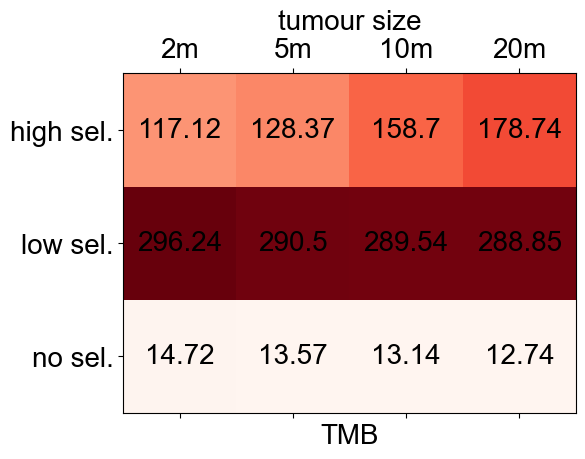

<Figure size 640x480 with 0 Axes>

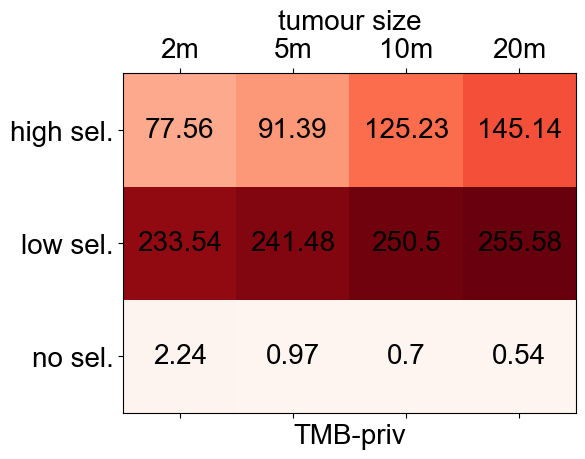

<Figure size 640x480 with 0 Axes>

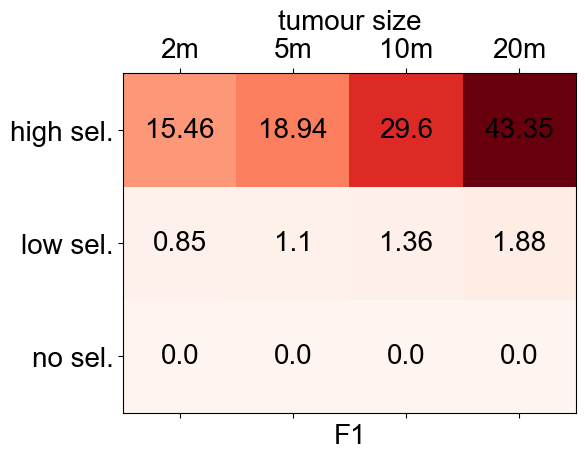

<Figure size 640x480 with 0 Axes>

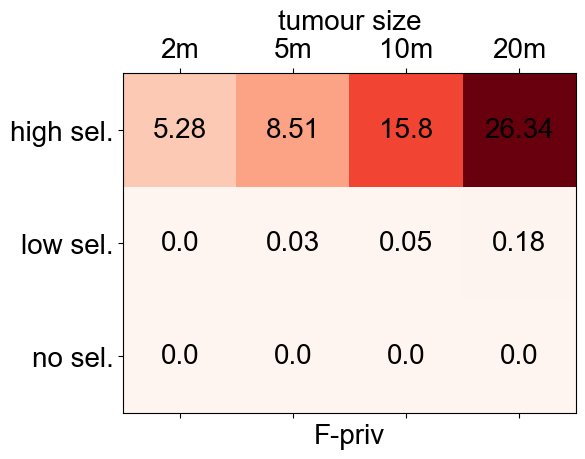

<Figure size 640x480 with 0 Axes>

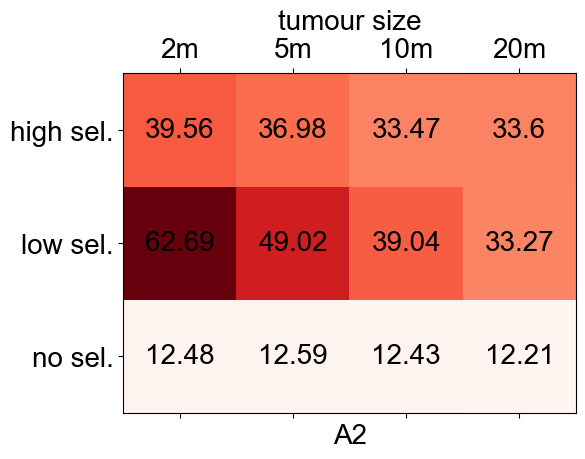

average overlap 0.8633021561716759


<Figure size 640x480 with 0 Axes>

In [18]:
filenames = ["22Jul_2m", "27Jul_gen_0.4", "22Jul_10m", "22Jul_20m"]
prefixes = ["nosel", "lowsel", "highsel"]

rows, cols = 3, 4

#measure overlap of 2 ranges, expressed as a fraction of total range covered by either distribution
def overlap(a1, b1, a2, b2):
    if b1 < a2 or b2 < a1:
        return 0 #completely non-overlapping
    else:
        if max(max(b1, b2), max(a1, a2))==min(min(b1, b2), min(a1, a2)):
            return 1
        else:
            return (min(b1, b2)-max(a1, a2))/(max(b1, b2)-min(a1, a2))
        

central_index = 1 #this is the 5m-cell scenario to which all else should be compared

row_labels = ["no sel.", "low sel.", "high sel."]
col_labels = ["2m", "5m", "10m", "20m"]

for no_samples in [2]:
    stat_names = ["TMB", "TMB-priv"] + ["F"+str(s) for s in range(1, no_samples)]+ ["F-priv"] + ["A"+str(s) for s in range(2, no_samples+1)]
    av_overlap = []
    for index, stat_name in enumerate(stat_names):
        av_matrix = np.zeros((rows, cols))
        overlap_matrix = np.zeros((rows, cols))
        centile_limits = [] #record 5th and 95th percentile
        for i, prefix in enumerate(prefixes):
            centiles = []
            for j, filename in enumerate(filenames):
                matrix_name = filename+"_"+prefix
                stat_matrix = np.load(base_filepath+"/"+matrix_name+"_"+str(no_samples)+"_samples.npy", allow_pickle=True)
                centiles.append([np.percentile(stat_matrix[:, index], 5), np.percentile(stat_matrix[:, index], 95)])
                av_matrix[i][j] = np.average(stat_matrix[:, index])
            [a1, b1] = centiles[central_index] #the 5th and 95th centile of the baseline scenario
            for j, [a2, b2] in enumerate(centiles):
                overlap_matrix[i][j] = overlap(a1, b1, a2, b2)
                if overlap_matrix[i][j] > 1:
                    print(a1, b1, a2, b2)
                
        fig, ax1 = plt.subplots(figsize=(7, 5))
        im=ax1.matshow(av_matrix, origin='lower', cmap=mpl.cm.Reds)
        ax1.set_yticks(range(rows), row_labels, fontsize=20)
        ax1.set_xticks(range(cols), col_labels, fontsize=20)
        #ax1.set_ylabel("plasticity")
        ax1.set_xlabel(stat_name,  fontsize=20)
        #cbar = fig.colorbar(im, location='right', pad=0.1, shrink=0.1)
        #cbar.ax.set_ylabel("average value", fontsize=10) 
        plt.title('tumour size', fontsize=20)
        for i in range(rows):
            for j in range(cols):
                ax1.text(j, i, str(np.around(av_matrix[i][j], decimals=2)), va='center', ha='center', color='black', fontsize='medium')
        plt.tight_layout()
        plt.show()
        fig.savefig(base_filepath+"/figs_0512"+"/sizefig_"+stat_name+"_av_"+str(no_samples)+"_samples.png", dpi=300)
        plt.clf()

        av_overlap.append(np.average(overlap_matrix)) ##isn't helpful because it counts itself
        
        # fig, ax1 = plt.subplots(figsize=(7, 5))
        # im=ax1.matshow(overlap_matrix, origin='lower', cmap=mpl.cm.Greens)
        # ax1.set_yticks(range(rows), row_labels, fontsize=20)
        # ax1.set_xticks(range(cols), col_labels, fontsize=20)
        # #ax1.set_ylabel("plasticity")
        # ax1.set_xlabel('tumour size', fontsize=20)
        # cbar = fig.colorbar(im, location='right', pad=0.1, shrink=0.1)
        # cbar.ax.set_ylabel("overlap with baseline", fontsize=10) 
        # for i in range(rows):
        #     for j in range(cols):
        #         ax1.text(j, i, str(np.around(overlap_matrix[i][j], decimals=2)), va='center', ha='center', color='black', fontsize='small')
        # plt.title(stat_name +", "+ str(no_samples) + " samples", fontsize=20)
        # plt.tight_layout()
        # plt.show()
        # fig.savefig(base_filepath+"/figs_0512"+"/sizefig_"+stat_name+"_overlap_"+str(no_samples)+"_samples.png", dpi=300)
        # plt.clf()

    print("average overlap", np.average(av_overlap))
    
        
            


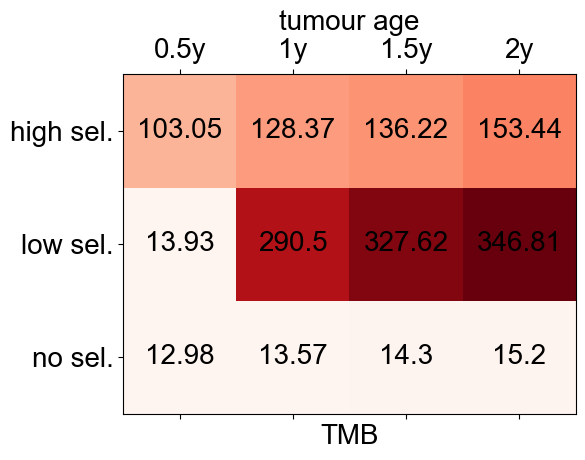

<Figure size 640x480 with 0 Axes>

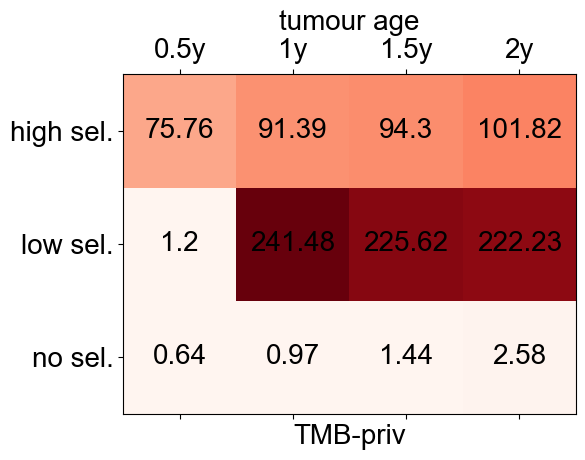

<Figure size 640x480 with 0 Axes>

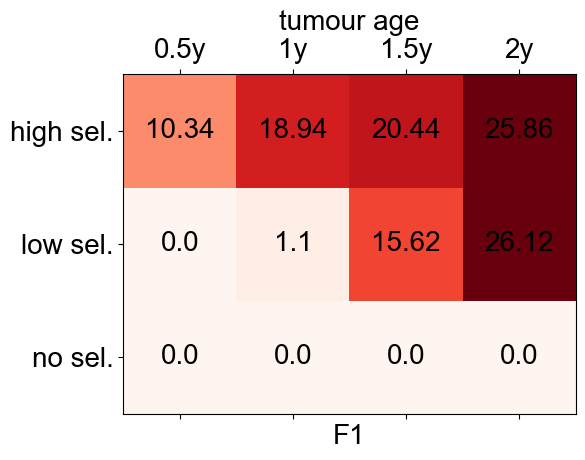

<Figure size 640x480 with 0 Axes>

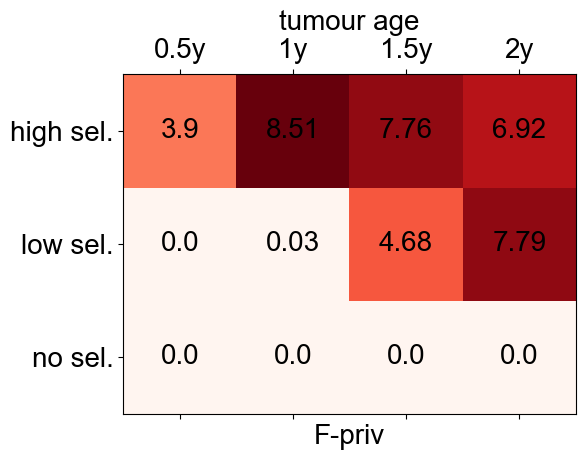

<Figure size 640x480 with 0 Axes>

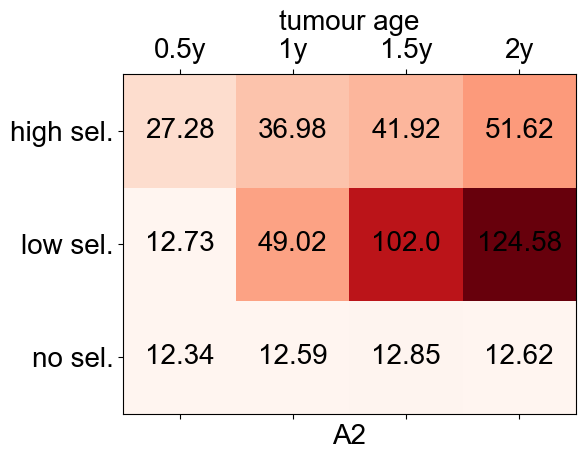

<Figure size 640x480 with 0 Axes>

In [19]:
filenames = ["22Jul_6mo", "27Jul_gen_0.4", "22Jul_18mo", "22Jul_2y"]
prefixes = ["nosel", "lowsel", "highsel"]

rows, cols = 3, 4



central_index = 1 #this is the 5m-cell scenario to which all else should be compared

row_labels = ["no sel.", "low sel.", "high sel."]
col_labels = ["0.5y", "1y", "1.5y", "2y"]

for no_samples in [2]:
    stat_names = ["TMB", "TMB-priv"] + ["F"+str(s) for s in range(1, no_samples)]+ ["F-priv"] + ["A"+str(s) for s in range(2, no_samples+1)]
    for index, stat_name in enumerate(stat_names):
        av_matrix = np.zeros((rows, cols))
        overlap_matrix = np.zeros((rows, cols))
        centile_limits = [] #record 5th and 95th percentile
        for i, prefix in enumerate(prefixes):
            centiles = []
            for j, filename in enumerate(filenames):
                matrix_name = filename+"_"+prefix
                stat_matrix = np.load(base_filepath+"/"+matrix_name+"_"+str(no_samples)+"_samples.npy", allow_pickle=True)
                centiles.append([np.percentile(stat_matrix[:, index], 5), np.percentile(stat_matrix[:, index], 95)])
                av_matrix[i][j] = np.average(stat_matrix[:, index])
            [a1, b1] = centiles[central_index] #the 5th and 95th centile of the baseline scenario
            for j, [a2, b2] in enumerate(centiles):
                overlap_matrix[i][j] = overlap(a1, b1, a2, b2)
                
        fig, ax1 = plt.subplots(figsize=(7, 5))
        im=ax1.matshow(av_matrix, origin='lower', cmap=mpl.cm.Reds)
        ax1.set_yticks(range(rows), row_labels, fontsize=20)
        ax1.set_xticks(range(cols), col_labels, fontsize=20)
        #ax1.set_ylabel("plasticity")
        ax1.set_xlabel(stat_name,  fontsize=20)
        #cbar = fig.colorbar(im, location='right', pad=0.1, shrink=0.1)
        #cbar.ax.set_ylabel("average value", fontsize=10) 
        plt.title('tumour age', fontsize=20)
        for i in range(rows):
            for j in range(cols):
                ax1.text(j, i, str(np.around(av_matrix[i][j], decimals=2)), va='center', ha='center', color='black', fontsize='medium')
        plt.tight_layout()
        plt.show()
        fig.savefig(base_filepath+"/figs_0512"+"/agefig_"+stat_name+"_av_"+str(no_samples)+"_samples.png", dpi=300)
        plt.clf()
        
        # fig, ax1 = plt.subplots(figsize=(7, 5))
        # im=ax1.matshow(overlap_matrix, origin='lower', cmap=mpl.cm.Greens)
        # ax1.set_yticks(range(rows), row_labels, fontsize=20)
        # ax1.set_xticks(range(cols), col_labels, fontsize=20)
        # #ax1.set_ylabel("plasticity")
        # ax1.set_xlabel('tumour age', fontsize=20)
        # cbar = fig.colorbar(im, location='right', pad=0.1, shrink=0.1)
        # cbar.ax.set_ylabel("overlap with baseline", fontsize=10) 
        # for i in range(rows):
        #     for j in range(cols):
        #         ax1.text(j, i, str(np.around(overlap_matrix[i][j], decimals=2)), va='center', ha='center', color='black', fontsize='medium')
        # plt.title(stat_name +", "+ str(no_samples) + " samples", fontsize=20)
        # plt.tight_layout()
        # plt.show()
        # fig.savefig(base_filepath+"/figs_0512"+"/agefig_"+stat_name+"_overlap_"+str(no_samples)+"_samples.png", dpi=300)
        # plt.clf()

    
        
            


As you would expect, time matters a lot more here. 
The number of mutations, always highest when selection is low, increases massively when as time goes on. With low selection, the tree broadens and increasingly disparate lineages spread through the tumour. (Low selection leads to more diversity, as we have a large number of medium-prevalence mutations rather than a lot of low prevalence mutations that can easily go extinct and take over by drift, or a few high prevalence mutations). There is a huge difference between 6mo and 1y for low selection. For neutral growth, the number of mutations increases over time (as the tree broadens more slowly) until at the 2y mark it has almost caught up with high selection.

Luckily for us, the number of private mutations remains massively different between high selection and neutral growth at the 2y mark. For all selection levels, time increases the number of private mutations, as cell turnover evolution at disparate points on the tumour allows distant samples to become less related. Fixed mutations follow the same pattern.

Fixed and private mutations, however, increase with time for no/low selection, but *decrease* with time for with high selection, presumably because fixed mutations spread with time for high selection and so become less private. At the 2y mark low selection has more fixed and private muts than high mutations.

The number appearing in 2 samples increases with time for all selection levels, because time allows spread.

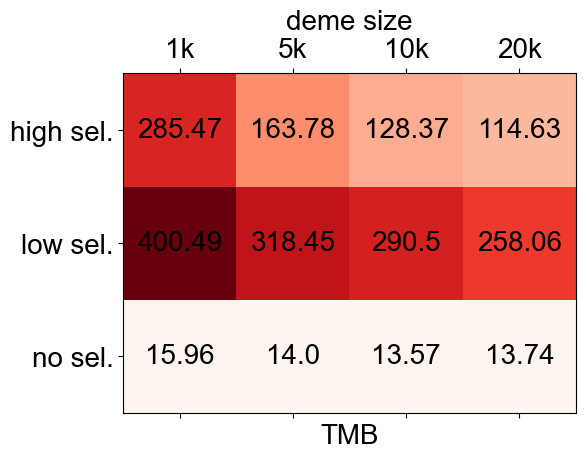

<Figure size 640x480 with 0 Axes>

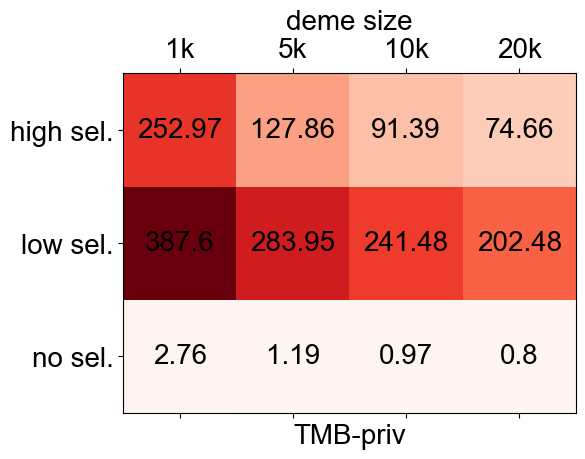

<Figure size 640x480 with 0 Axes>

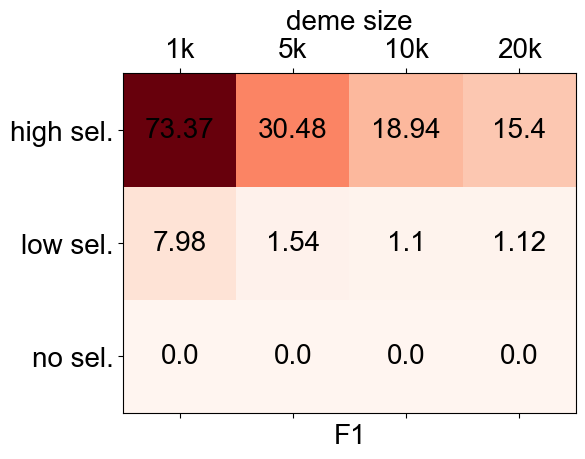

<Figure size 640x480 with 0 Axes>

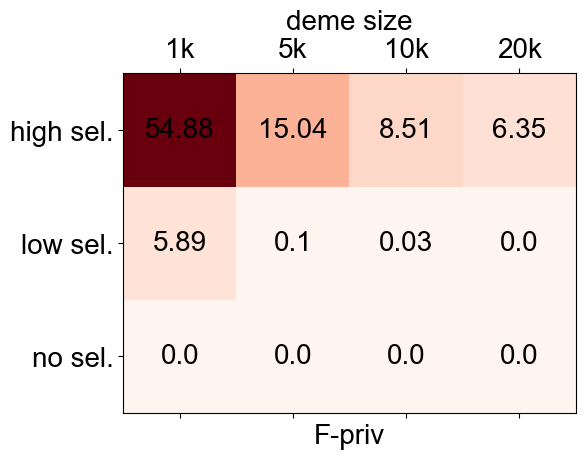

<Figure size 640x480 with 0 Axes>

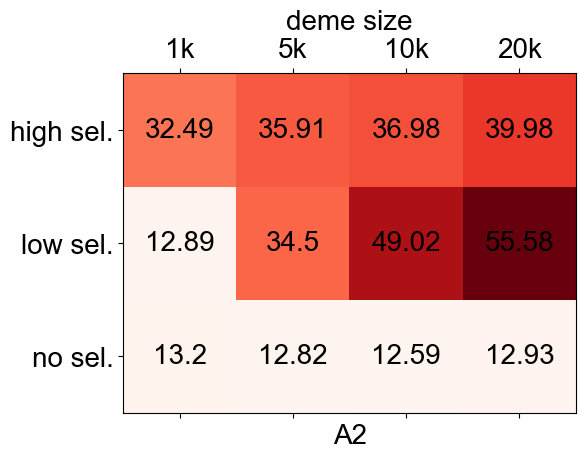

<Figure size 640x480 with 0 Axes>

In [20]:
filenames = ["22Jul_deme_1k", "22Jul_deme_5k",  "27Jul_gen_0.4", "22Jul_deme_20k"]
prefixes = ["nosel", "lowsel", "highsel"]

rows, cols = 3, 4

central_index = 2 #this is the 5m-cell scenario to which all else should be compared

row_labels = ["no sel.", "low sel.", "high sel."]
col_labels = ["1k", "5k", "10k", "20k"]

for no_samples in [2]:
    stat_names = ["TMB", "TMB-priv"] + ["F"+str(s) for s in range(1, no_samples)]+ ["F-priv"] + ["A"+str(s) for s in range(2, no_samples+1)]
    for index, stat_name in enumerate(stat_names):
        av_matrix = np.zeros((rows, cols))
        overlap_matrix = np.zeros((rows, cols))
        centile_limits = [] #record 5th and 95th percentile
        for i, prefix in enumerate(prefixes):
            centiles = []
            for j, filename in enumerate(filenames):
                matrix_name = filename+"_"+prefix
                stat_matrix = np.load(base_filepath+"/"+matrix_name+"_"+str(no_samples)+"_samples.npy", allow_pickle=True)
                centiles.append([np.percentile(stat_matrix[:, index], 5), np.percentile(stat_matrix[:, index], 95)])
                av_matrix[i][j] = np.average(stat_matrix[:, index])
            [a1, b1] = centiles[central_index] #the 5th and 95th centile of the baseline scenario
            for j, [a2, b2] in enumerate(centiles):
                overlap_matrix[i][j] = overlap(a1, b1, a2, b2)
                
        fig, ax1 = plt.subplots(figsize=(7, 5))
        im=ax1.matshow(av_matrix, origin='lower', cmap=mpl.cm.Reds)
        ax1.set_yticks(range(rows), row_labels, fontsize=20)
        ax1.set_xticks(range(cols), col_labels, fontsize=20)
        #ax1.set_ylabel("plasticity")
        ax1.set_xlabel(stat_name,  fontsize=20)
        #cbar = fig.colorbar(im, location='right', pad=0.1, shrink=0.1)
        #cbar.ax.set_ylabel("average value", fontsize=10) 
        plt.title('deme size', fontsize=20)
        for i in range(rows):
            for j in range(cols):
                ax1.text(j, i, str(np.around(av_matrix[i][j], decimals=2)), va='center', ha='center', color='black', fontsize='medium')
        plt.tight_layout()
        plt.show()
        fig.savefig(base_filepath+"/figs_0512"+"/demefig_"+stat_name+"_av_"+str(no_samples)+"_samples.png", dpi=300)
        plt.clf()
    
        # fig, ax1 = plt.subplots(figsize=(7, 5))
        # im=ax1.matshow(overlap_matrix, origin='lower', cmap=mpl.cm.Greens)
        # ax1.set_yticks(range(rows), row_labels, fontsize=20)
        # ax1.set_xticks(range(cols), col_labels, fontsize=20)
        # #ax1.set_ylabel("plasticity")
        # ax1.set_xlabel('deme size', fontsize=20)
        # cbar = fig.colorbar(im, location='right', pad=0.1, shrink=0.1)
        # cbar.ax.set_ylabel("overlap with baseline", fontsize=10) 
        # for i in range(rows):
        #     for j in range(cols):
        #         ax1.text(j, i, str(np.around(overlap_matrix[i][j], decimals=2)), va='center', ha='center', color='black', fontsize='small')
        # plt.title(stat_name +", "+ str(no_samples) + " samples", fontsize=20)
        # plt.tight_layout()
        # plt.show()
        # fig.savefig(base_filepath+"/figs_0512"+"/demefig_"+stat_name+"_overlap_"+str(no_samples)+"_samples.png", dpi=300)
        # plt.clf()

    
        
            


Number of detected mutations decreases with deme size, as larger deme size leads to more competition, and so it's harder for individual mutations to take over a deme (i.e. size decreases the effect of drift, AND makes it harder for advantaged mutations to take over a deme).

Same pattern happens with private mutations/fixed/fixed and private: where demes are larger, it's harder to take over a deme/any region of space.

The number of mutations appearing in 2 samples decreases with deme size when evolution is neutral, as clonal mutations are excluded and drift makes it likelier that any given mutation will be driven extinct. But where selection is present, decreasing deme size increases the number of mutations in both samples: it means that fewer replacement events are needed to transport cells across the tumour (because you can have replacement events only when you have selection differentials; all neutral evolution has no replacement).

Again, look at writeup-- not sure the above is true, because it's easier for mutations to fix in 1 sample, so can't be harder to spread.

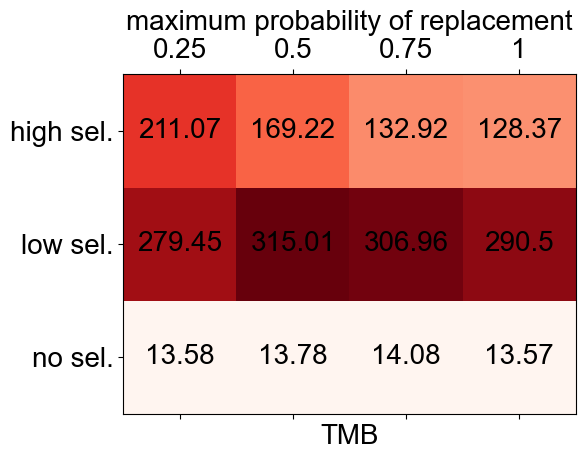

<Figure size 640x480 with 0 Axes>

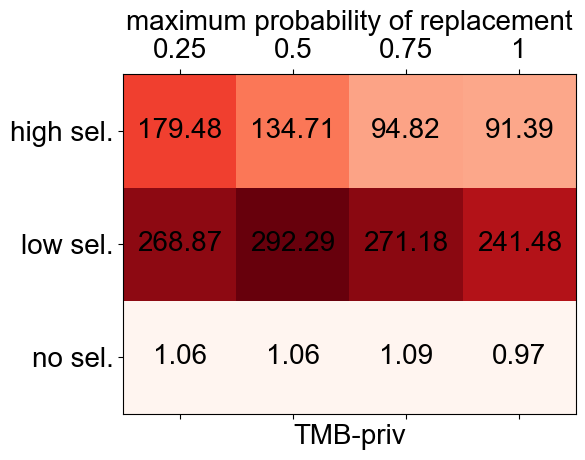

<Figure size 640x480 with 0 Axes>

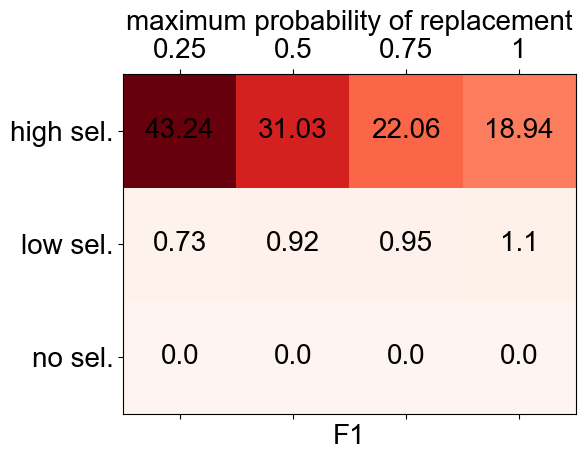

<Figure size 640x480 with 0 Axes>

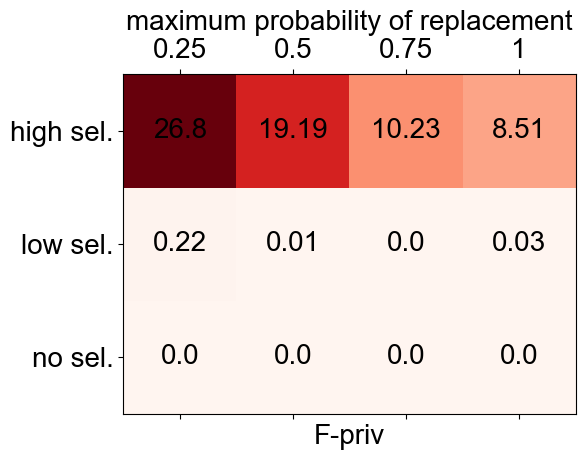

<Figure size 640x480 with 0 Axes>

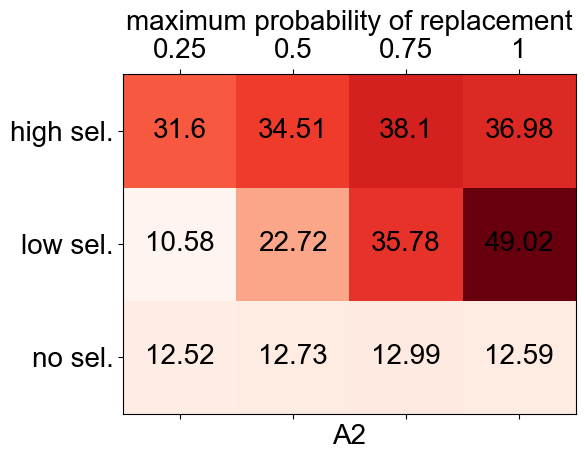

<Figure size 640x480 with 0 Axes>

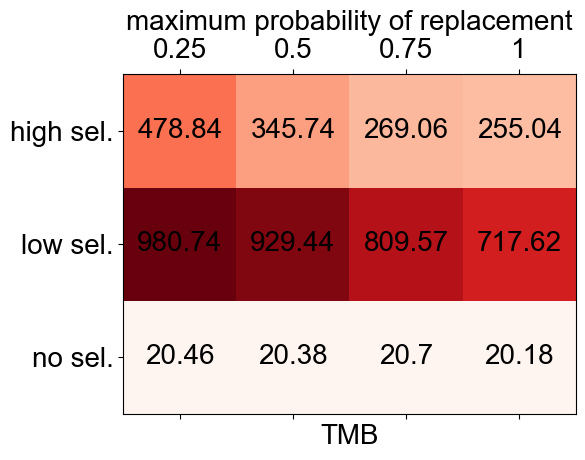

<Figure size 640x480 with 0 Axes>

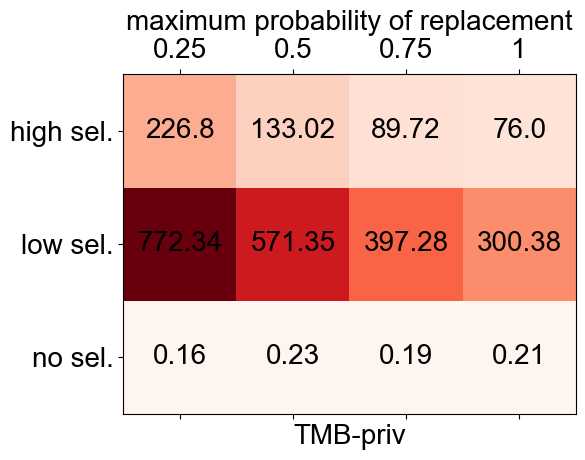

<Figure size 640x480 with 0 Axes>

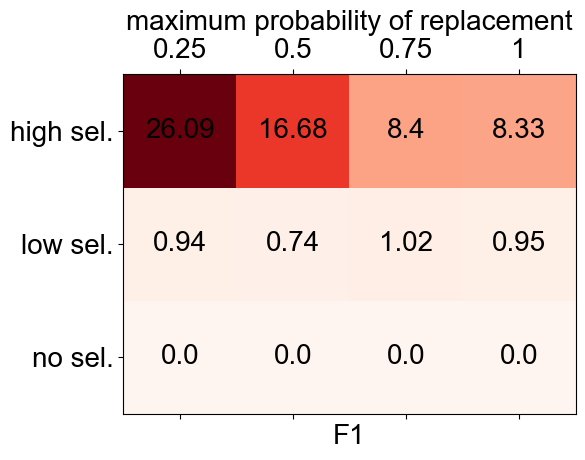

<Figure size 640x480 with 0 Axes>

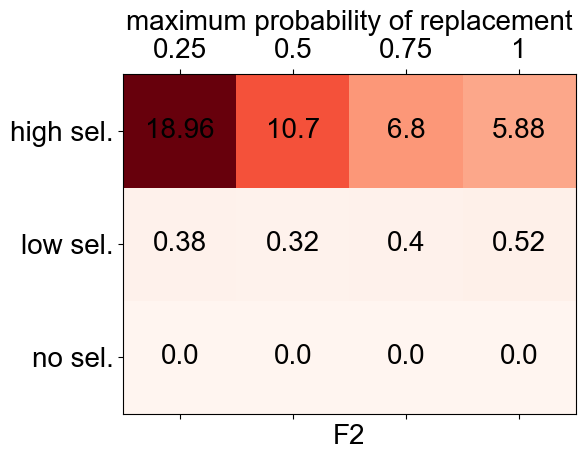

<Figure size 640x480 with 0 Axes>

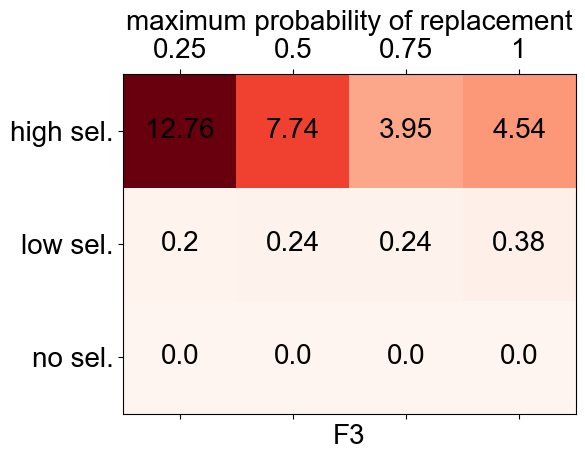

<Figure size 640x480 with 0 Axes>

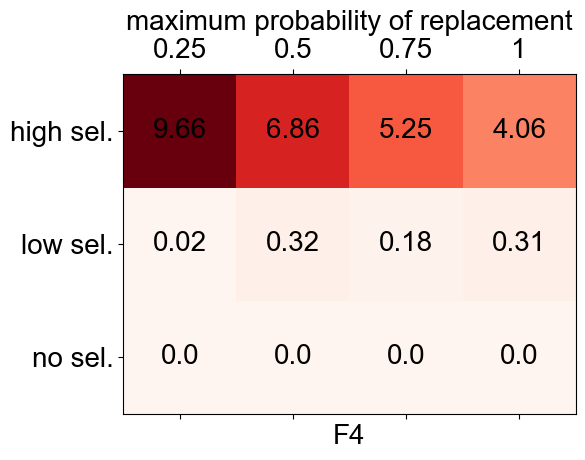

<Figure size 640x480 with 0 Axes>

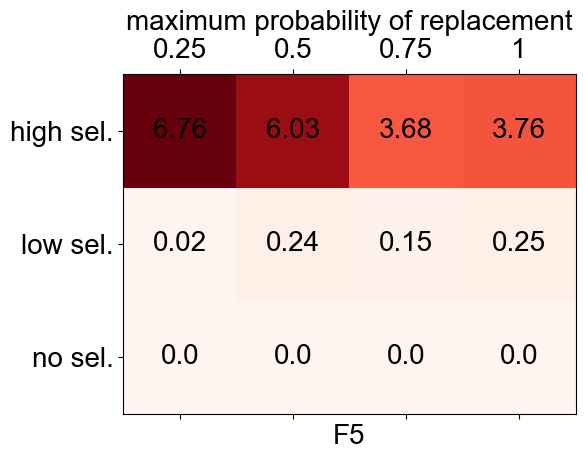

<Figure size 640x480 with 0 Axes>

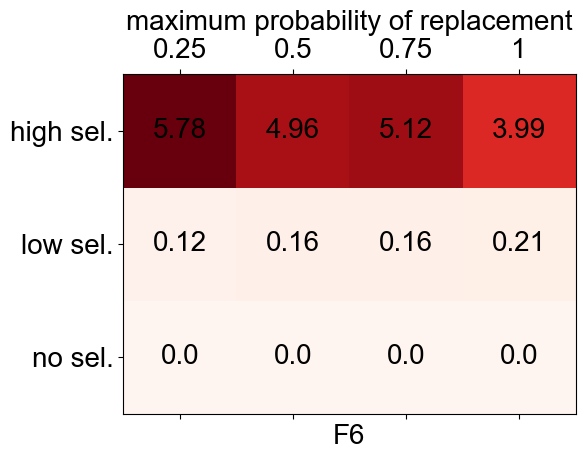

<Figure size 640x480 with 0 Axes>

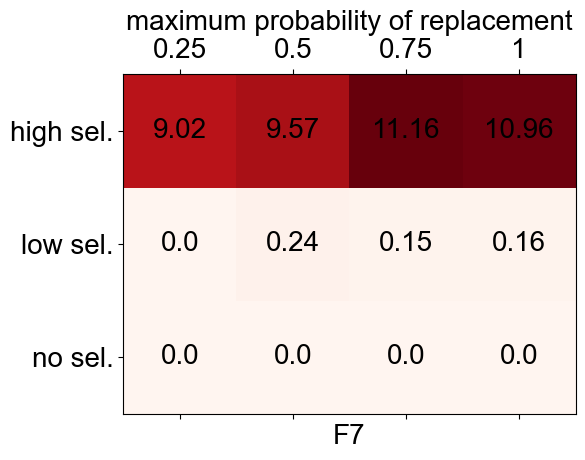

<Figure size 640x480 with 0 Axes>

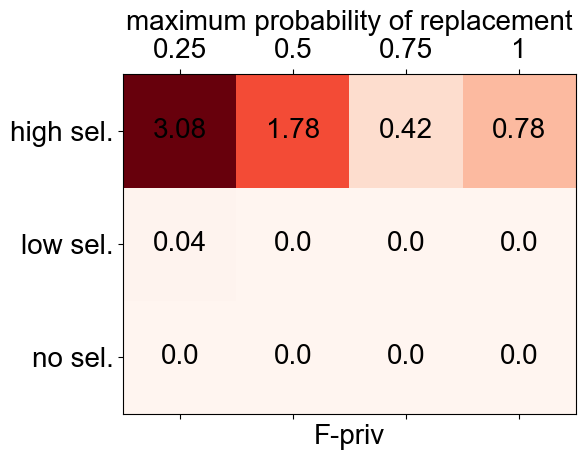

<Figure size 640x480 with 0 Axes>

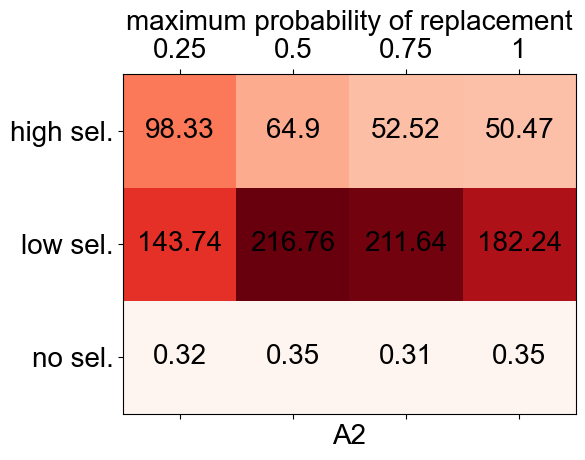

<Figure size 640x480 with 0 Axes>

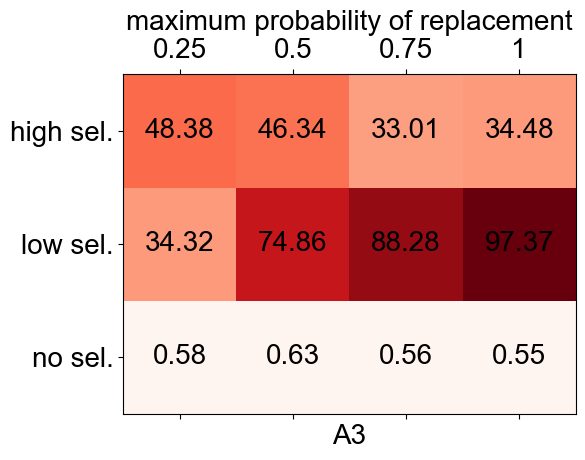

<Figure size 640x480 with 0 Axes>

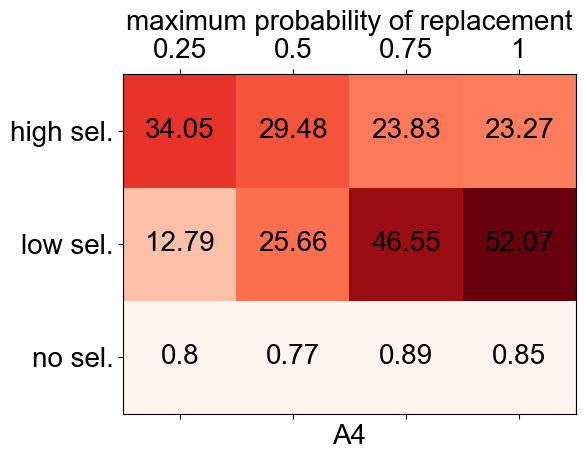

<Figure size 640x480 with 0 Axes>

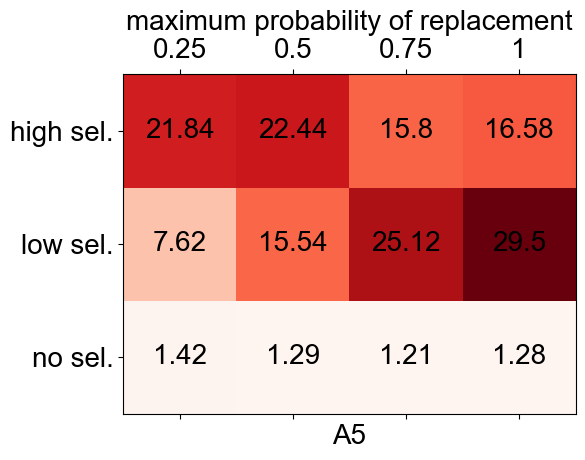

<Figure size 640x480 with 0 Axes>

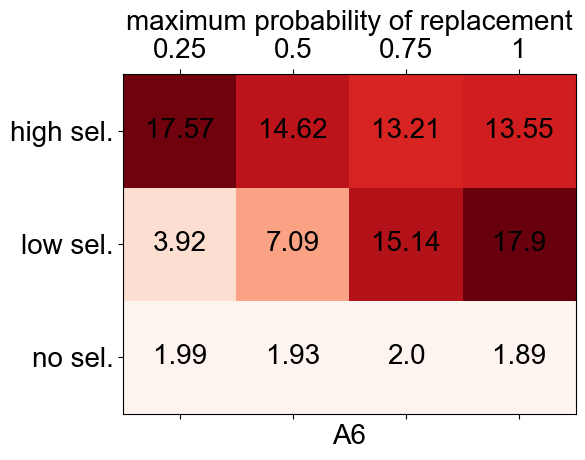

<Figure size 640x480 with 0 Axes>

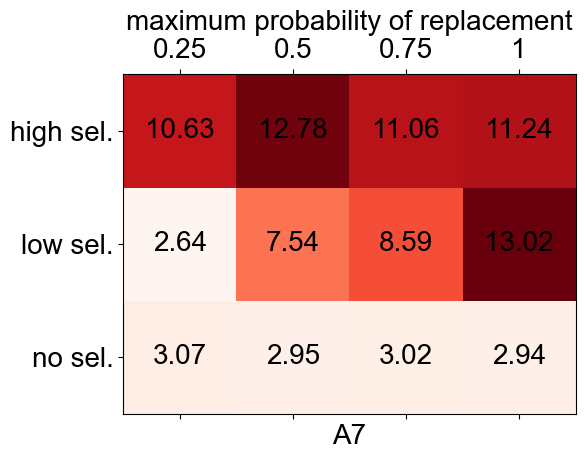

<Figure size 640x480 with 0 Axes>

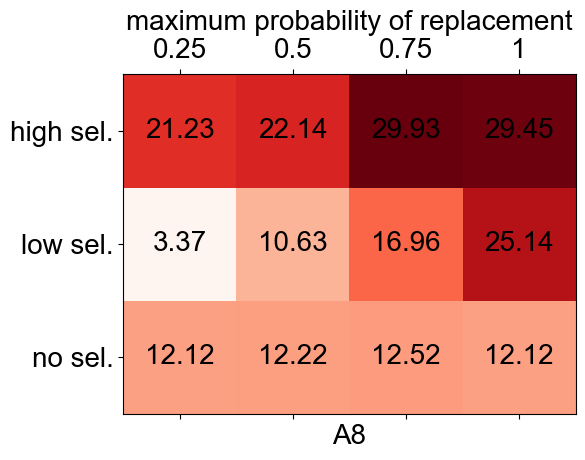

<Figure size 640x480 with 0 Axes>

In [21]:
filenames = ["22Jul_rep_0.25", "22Jul_rep_0.5", "22Jul_rep_0.75", "27Jul_gen_0.4"]
prefixes = ["nosel", "lowsel", "highsel"]

rows, cols = 3, 4

central_index = 3 #this is the 5m-cell scenario to which all else should be compared

row_labels = ["no sel.", "low sel.", "high sel."]
col_labels = ["0.25", "0.5", "0.75", "1"]

for no_samples in [2, 8]:
    stat_names = ["TMB", "TMB-priv"] + ["F"+str(s) for s in range(1, no_samples)]+ ["F-priv"] + ["A"+str(s) for s in range(2, no_samples+1)]
    for index, stat_name in enumerate(stat_names):
        av_matrix = np.zeros((rows, cols))
        overlap_matrix = np.zeros((rows, cols))
        centile_limits = [] #record 5th and 95th percentile
        for i, prefix in enumerate(prefixes):
            centiles = []
            for j, filename in enumerate(filenames):
                matrix_name = filename+"_"+prefix
                stat_matrix = np.load(base_filepath+"/"+matrix_name+"_"+str(no_samples)+"_samples.npy", allow_pickle=True)
                centiles.append([np.percentile(stat_matrix[:, index], 5), np.percentile(stat_matrix[:, index], 95)])
                av_matrix[i][j] = np.average(stat_matrix[:, index])
            [a1, b1] = centiles[central_index] #the 5th and 95th centile of the baseline scenario
            for j, [a2, b2] in enumerate(centiles):
                overlap_matrix[i][j] = overlap(a1, b1, a2, b2)
                
        fig, ax1 = plt.subplots(figsize=(7, 5))
        im=ax1.matshow(av_matrix, origin='lower', cmap=mpl.cm.Reds)
        ax1.set_yticks(range(rows), row_labels, fontsize=20)
        ax1.set_xticks(range(cols), col_labels, fontsize=20)
        #ax1.set_ylabel("plasticity")
        ax1.set_xlabel(stat_name,  fontsize=20)
        #cbar = fig.colorbar(im, location='right', pad=0.1, shrink=0.1)
        #cbar.ax.set_ylabel("average value", fontsize=10) 
        plt.title('maximum probability of replacement', fontsize=20)
        for i in range(rows):
            for j in range(cols):
                ax1.text(j, i, str(np.around(av_matrix[i][j], decimals=2)), va='center', ha='center', color='black', fontsize='medium')
        plt.tight_layout()
        plt.show()
        fig.savefig(base_filepath+"/figs_0512"+"/repfig_"+stat_name+"_av_"+str(no_samples)+"_samples.png", dpi=300)
        plt.clf()
    
        # fig, ax1 = plt.subplots(figsize=(7, 5))
        # im=ax1.matshow(overlap_matrix, origin='lower', cmap=mpl.cm.Greens)
        # ax1.set_yticks(range(rows), row_labels, fontsize=20)
        # ax1.set_xticks(range(cols), col_labels, fontsize=20)
        # #ax1.set_ylabel("plasticity")
        # ax1.set_xlabel('maximum probability of replacement', fontsize=20)
        # cbar = fig.colorbar(im, location='right', pad=0.1, shrink=0.1)
        # cbar.ax.set_ylabel("overlap with baseline", fontsize=10) 
        # for i in range(rows):
        #     for j in range(cols):
        #         ax1.text(j, i, str(np.around(overlap_matrix[i][j], decimals=2)), va='center', ha='center', color='black', fontsize='small')
        # plt.title(stat_name +", "+ str(no_samples) + " samples", fontsize=20)
        # plt.tight_layout()
        # plt.show()
        # fig.savefig(base_filepath+"/figs_0512"+"/repfig_"+stat_name+"_overlap_"+str(no_samples)+"_samples.png", dpi=300)
        # plt.clf()

    
        
            


The below analysis asks: if we simulate tumours with high selection and variable heritability, and 'only know' about genetic selection (i.e. try to classify tumours into no, low and high genetic selection), how does heritability affect our classifications?

['27Jul_gen_0.4_nosel', '27Jul_gen_0.4_lowsel', '27Jul_gen_0.4_highsel', '27Jul_gen_0.6_nosel', '27Jul_gen_0.6_lowsel', '27Jul_gen_0.6_highsel']
27Jul_gen_0.4_nosel gen_0.4_nosel 5000
27Jul_gen_0.4_lowsel gen_0.4_lowsel 5000
27Jul_gen_0.4_highsel gen_0.4_highsel 4994
27Jul_gen_0.6_nosel gen_0.6_nosel 4993
27Jul_gen_0.6_lowsel gen_0.6_lowsel 4987
27Jul_gen_0.6_highsel gen_0.6_highsel 5000


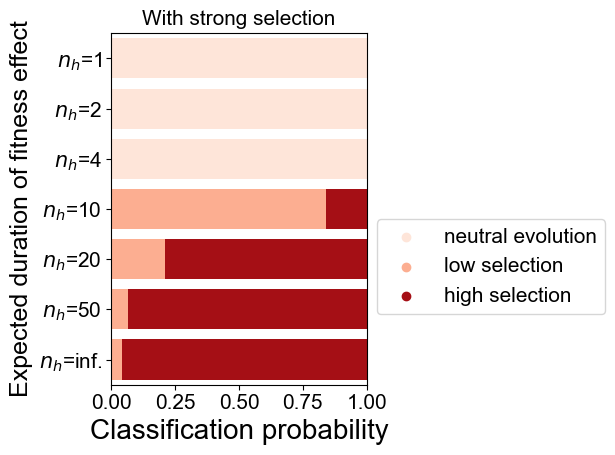

['27Jul_gen_0.4_nosel', '27Jul_gen_0.4_lowsel', '27Jul_gen_0.4_highsel', '27Jul_gen_0.6_nosel', '27Jul_gen_0.6_lowsel', '27Jul_gen_0.6_highsel']
27Jul_gen_0.4_nosel gen_0.4_nosel 5000
27Jul_gen_0.4_lowsel gen_0.4_lowsel 5000
27Jul_gen_0.4_highsel gen_0.4_highsel 4994
27Jul_gen_0.6_nosel gen_0.6_nosel 4993
27Jul_gen_0.6_lowsel gen_0.6_lowsel 4987
27Jul_gen_0.6_highsel gen_0.6_highsel 5000


<Figure size 640x480 with 0 Axes>

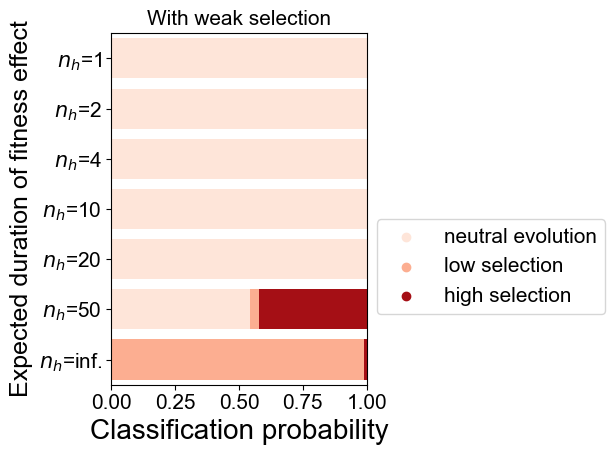

['27Jul_gen_0.4_nosel', '27Jul_gen_0.4_lowsel', '27Jul_gen_0.4_highsel', '27Jul_gen_0.6_nosel', '27Jul_gen_0.6_lowsel', '27Jul_gen_0.6_highsel']
27Jul_gen_0.4_nosel gen_0.4_nosel 5000
27Jul_gen_0.4_lowsel gen_0.4_lowsel 5000
27Jul_gen_0.4_highsel gen_0.4_highsel 4994
27Jul_gen_0.6_nosel gen_0.6_nosel 4993
27Jul_gen_0.6_lowsel gen_0.6_lowsel 4987
27Jul_gen_0.6_highsel gen_0.6_highsel 5000


<Figure size 640x480 with 0 Axes>

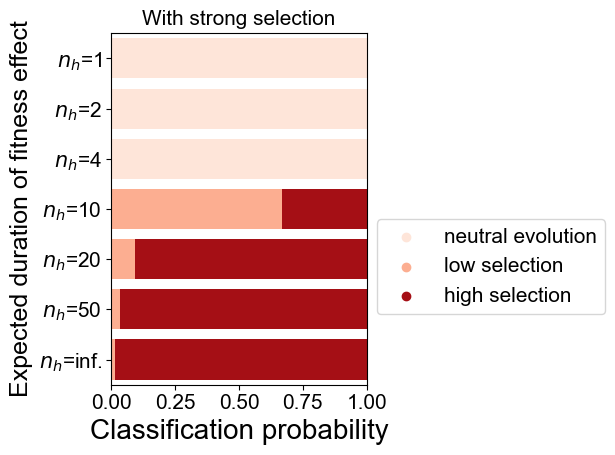

['27Jul_gen_0.4_nosel', '27Jul_gen_0.4_lowsel', '27Jul_gen_0.4_highsel', '27Jul_gen_0.6_nosel', '27Jul_gen_0.6_lowsel', '27Jul_gen_0.6_highsel']
27Jul_gen_0.4_nosel gen_0.4_nosel 5000
27Jul_gen_0.4_lowsel gen_0.4_lowsel 5000
27Jul_gen_0.4_highsel gen_0.4_highsel 4994
27Jul_gen_0.6_nosel gen_0.6_nosel 4993
27Jul_gen_0.6_lowsel gen_0.6_lowsel 4987
27Jul_gen_0.6_highsel gen_0.6_highsel 5000


<Figure size 640x480 with 0 Axes>

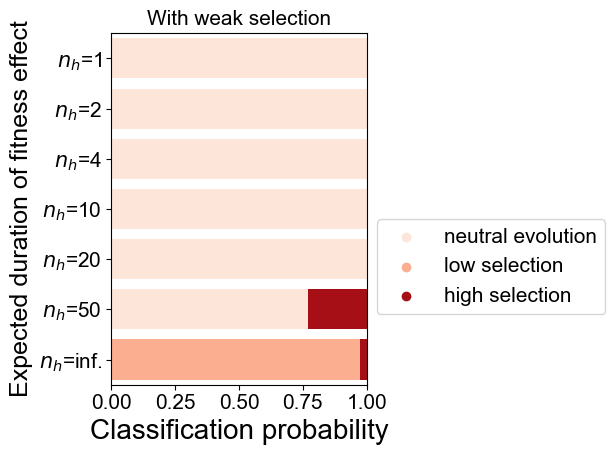

['27Jul_gen_0.4_nosel', '27Jul_gen_0.4_lowsel', '27Jul_gen_0.4_highsel', '27Jul_gen_0.6_nosel', '27Jul_gen_0.6_lowsel', '27Jul_gen_0.6_highsel']
27Jul_gen_0.4_nosel gen_0.4_nosel 5000
27Jul_gen_0.4_lowsel gen_0.4_lowsel 5000
27Jul_gen_0.4_highsel gen_0.4_highsel 4994
27Jul_gen_0.6_nosel gen_0.6_nosel 4993
27Jul_gen_0.6_lowsel gen_0.6_lowsel 4987
27Jul_gen_0.6_highsel gen_0.6_highsel 5000


<Figure size 640x480 with 0 Axes>

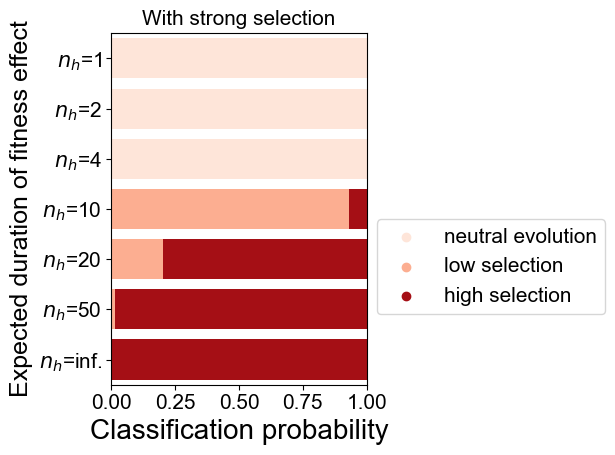

['27Jul_gen_0.4_nosel', '27Jul_gen_0.4_lowsel', '27Jul_gen_0.4_highsel', '27Jul_gen_0.6_nosel', '27Jul_gen_0.6_lowsel', '27Jul_gen_0.6_highsel']
27Jul_gen_0.4_nosel gen_0.4_nosel 5000
27Jul_gen_0.4_lowsel gen_0.4_lowsel 5000
27Jul_gen_0.4_highsel gen_0.4_highsel 4994
27Jul_gen_0.6_nosel gen_0.6_nosel 4993
27Jul_gen_0.6_lowsel gen_0.6_lowsel 4987
27Jul_gen_0.6_highsel gen_0.6_highsel 5000


<Figure size 640x480 with 0 Axes>

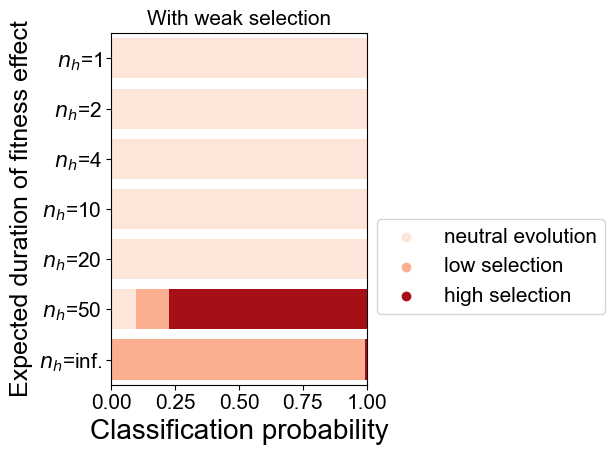

['27Jul_gen_0.4_nosel', '27Jul_gen_0.4_lowsel', '27Jul_gen_0.4_highsel', '27Jul_gen_0.6_nosel', '27Jul_gen_0.6_lowsel', '27Jul_gen_0.6_highsel']
27Jul_gen_0.4_nosel gen_0.4_nosel 5000
27Jul_gen_0.4_lowsel gen_0.4_lowsel 5000
27Jul_gen_0.4_highsel gen_0.4_highsel 4994
27Jul_gen_0.6_nosel gen_0.6_nosel 4993
27Jul_gen_0.6_lowsel gen_0.6_lowsel 4987
27Jul_gen_0.6_highsel gen_0.6_highsel 5000


<Figure size 640x480 with 0 Axes>

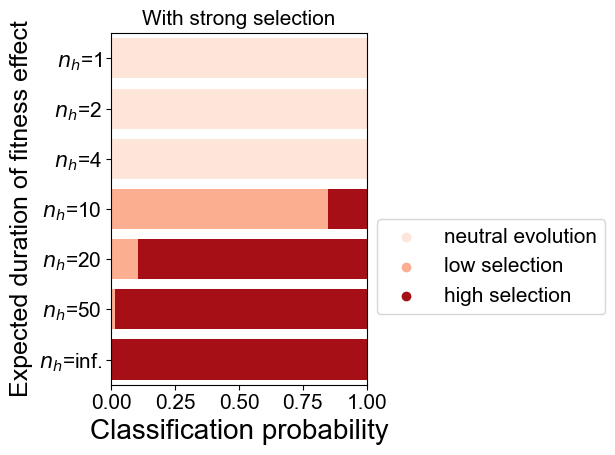

['27Jul_gen_0.4_nosel', '27Jul_gen_0.4_lowsel', '27Jul_gen_0.4_highsel', '27Jul_gen_0.6_nosel', '27Jul_gen_0.6_lowsel', '27Jul_gen_0.6_highsel']
27Jul_gen_0.4_nosel gen_0.4_nosel 5000
27Jul_gen_0.4_lowsel gen_0.4_lowsel 5000
27Jul_gen_0.4_highsel gen_0.4_highsel 4994
27Jul_gen_0.6_nosel gen_0.6_nosel 4993
27Jul_gen_0.6_lowsel gen_0.6_lowsel 4987
27Jul_gen_0.6_highsel gen_0.6_highsel 5000


<Figure size 640x480 with 0 Axes>

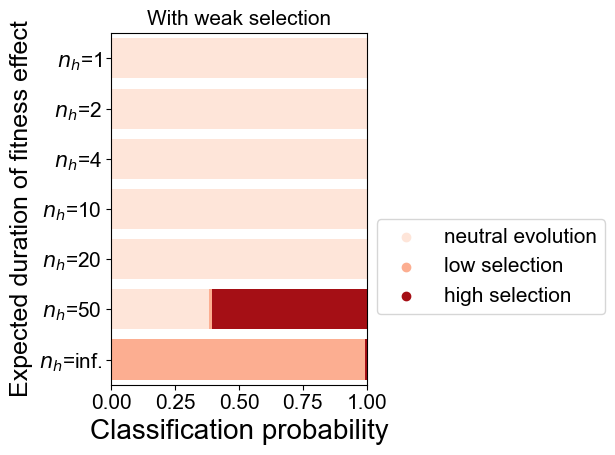

<Figure size 640x480 with 0 Axes>

In [15]:

#load, with a train test split
def load_gen_data(no_samples, prefix="27Jul"):
    sel_levels = ["nosel", "lowsel", "highsel"]
    mut_rates = [0.4, 0.6]
    all_file_names = []
    all_labels = []
    for mut in mut_rates:
        for sel in sel_levels:
            all_file_names.append(prefix + "_gen_" + str(mut) + "_" + sel)
            all_labels.append("gen_" + str(mut) + "_" + sel)
    print(all_file_names)
    Xs, ys = np.array([]), np.array([])
    for filename, label in zip(all_file_names, all_labels):
        stats = np.load(base_filepath+filename+"_"+str(no_samples)+"_samples.npy", allow_pickle=True)
        labels = np.tile(label, (len(stats), 1))
        print(filename, label, len(stats))
        if len(Xs)==0:
            Xs = stats
            ys = labels
        else:
            Xs = np.concatenate((Xs, stats))
            ys = np.concatenate((ys, labels))
    #get a unique list of all the labels
    all_labels_in_order = np.unique(ys, axis=0)
    return Xs, ys, all_labels_in_order
    
def get_all_gen_data(no_samples, valid_size=0.1, prefix="27Jul"):
    Xs, ys, all_labels_in_order =  load_gen_data(no_samples, prefix=prefix)
    X_tt, X_valid, y_tt, y_valid = train_test_split(Xs, ys, test_size=valid_size)
    return X_tt, X_valid, y_tt, y_valid, all_labels_in_order

    

#generate a genetic model
def generate_gen_model(no_samples, params, valid_size=0.1, prefix="27Jul"):
    X_tt, X_valid, y_tt, y_valid, all_labels_in_order =  get_all_gen_data(no_samples, valid_size=valid_size, prefix=prefix) #valid_sizeno validation size
    #print(y_tt, all_labels_in_order)
    #print(all_labels_in_order)
    y_tt_bin, y_valid_bin = manual_label_conversion(y_tt, all_labels_in_order), manual_label_conversion(y_valid, all_labels_in_order)
    num_categs = len(all_labels_in_order)
    classifiers = []
    for i in range(num_categs):
        clf, no_samples = classify_on_class_with_params(i, X_tt, y_tt_bin, params)
        #discard information on sample number
        classifiers.append(clf)
    return classifiers, all_labels_in_order

# #return probabilities for all test examples
# def predict_on_test_set(classifiers, X_test):
#     y_predict_prob = np.zeros((len(X_test), len(classifiers)))
#     for i, clf in enumerate(classifiers):
#         y_predict_prob[:, i] = clf.predict_proba(X_test)[:, 1] #probability that it is in that class
#     return y_predict_prob

def classify_all_plast_levels(no_samples, mut, sel, classifiers, known_labels, prefix="27Jul"):
    plast_levels = ["0.0", "0.5", "0.75", "0.9", "0.95", "0.98", "1.0"]
    sel_levels = ["lowsel", "highsel"]
    mut_rates = [0.4, 0.6]
    all_file_names = []
    all_labels = []
    for plast in plast_levels:
        if plast == "gen" or sel != "nosel":
            all_file_names.append(prefix + "_" + plast + "_" + str(mut) + "_" + sel)
            all_labels.append(plast + "_" + str(mut) + "_" + sel)
    probs_per_categ = np.zeros((len(all_labels), len(known_labels))) #rows are forms of plasticity, cols are forms of evolution the pipeline 'knows' about
    #take each of these and work out how many of them are classified in each category
    for m, (filename, label) in enumerate(zip(all_file_names, all_labels)):
        stats = np.load(base_filepath+filename+"_"+str(no_samples)+"_samples.npy", allow_pickle=True)
        probs_per_sim = predict_on_test_set(classifiers, stats) #one unnormalised prob. dist per sim 
        predictions_per_sim = [np.argmax(probs) for probs in probs_per_sim] #which category has the highest probability?
        label_indices, counts = np.unique(predictions_per_sim, return_counts=True)
        freqs = counts/np.sum(counts)
        for (ind, freq) in zip(label_indices, freqs): #iterate over known labels
            probs_per_categ[m][ind] = freq
    return probs_per_categ

#having done this, now group predictions together by selection level and plot them    
def produce_gen_prediction(no_samples, mut, sel, params, valid_size=0.1, prefix="27Jul"):
    plast_levels = ["0.0", "0.5", "0.75", "0.9", "0.95", "0.98", "1.0"]
    sel_levels = ["nosel", "lowsel", "highsel"]
    mut_rates = [0.4, 0.6]
    #known models
    classifiers, known_labels = generate_gen_model(no_samples, params, valid_size=valid_size, prefix=prefix)
    #produce a probability vector for each probability level
    probs_per_categ = classify_all_plast_levels(no_samples, mut, sel, classifiers, known_labels, prefix=prefix)
    #now group according to sel level
    #print(probs_per_categ)
    probs_per_sel_level = np.zeros((len(plast_levels), len(sel_levels)))
    for j, sel_ in enumerate(sel_levels):
        for mut_ in mut_rates:
            relevant_label = "gen_" + str(mut_) + "_" + sel_
            relevant_index = np.where(known_labels==relevant_label)[0][0]#this is at the right sel level
            probs_per_sel_level[:, j] += probs_per_categ[:, relevant_index]
    return plast_levels, probs_per_sel_level

def plot_bar_chart_of_gen_prediction_per_mut(no_samples, mut, prefix="27Jul", valid_size=0.1, neut_color="#ffeda0", low_color="#feb24c", high_color="#f03b20", params= {'learning_rate': 0.2, 'max_depth': 3, 'subsample': 0.6, 'colsample_bytree': 0.8, 'min_child_weight': 1, 'reg_alpha': 0.1, 'reg_lambda': 1, 'gamma': 0.5, 'n_estimators': 100}):
    #always in increasing order of selection
    colors = [neut_color, low_color, high_color]
    sel_labels, plast_labels = ["neutral", "weak sel.", "strong sel."], ["$n_h$"+"=1", "$n_h$"+"=2", "$n_h$"+"=4", "$n_h$"+"=10", "$n_h$"+"=20","$n_h$"+"=50", "$n_h$"+"=inf."]
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10,6))
    for ax, sel in zip([ax1, ax2], ["lowsel", "highsel"]): #refers to selection level in nongenetic sims being tested
        plast_levels, probs_per_sel_level = produce_gen_prediction(no_samples, mut, sel, params=params, valid_size=valid_size, prefix=prefix)
        print(probs_per_sel_level)
        ypos = range(len(plast_labels))
        lefts = np.zeros(len(plast_labels))
        for j in range(len(sel_labels)):
            ax.barh(ypos, probs_per_sel_level[:, j], left=lefts, color=colors[j])
            lefts += probs_per_sel_level[:, j]
        ax.set_title("With weak selection" if sel=="lowsel" else "With strong selection")
    ax1.set_yticks(ypos, labels=plast_labels)
    ax1.set_ylabel("expected duration of fitness effect (in cell divisions)")
    ax1.set_xlabel("classification probability")
    ax2.set_xlabel("classification probability")
    ax2.set_yticks([], [])
    plt.scatter([-1], [-1], color=neut_color, label="neutral") #to insert legend
    plt.scatter([-1], [-1], color=low_color, label="low heritable sel.") #to insert legend
    plt.scatter([-1], [-1], color=high_color, label="high heritable sel.") #to insert legend
    ax1.set_xlim(0, 1)
    ax1.set_ylim(0.5, 6.75)
    ax2.set_xlim(0, 1)
    ax2.set_ylim(0.5, 6.75)
    plt.legend()
    plt.show()
    plt.clf()



def plot_bar_chart_of_gen_prediction(no_samples, mut, sel, with_legend=True, with_title=False, prefix="27Jul", valid_size=0.1, neut_color="#FEE5D9", low_color="#FCAE91", high_color="#A50F15", params= {'learning_rate': 0.2, 'max_depth': 3, 'subsample': 0.6, 'colsample_bytree': 0.8, 'min_child_weight': 1, 'reg_alpha': 0.1, 'reg_lambda': 1, 'gamma': 0.5, 'n_estimators': 100}):
    #always in increasing order of selection
    colors = [neut_color, low_color, high_color]
    sel_labels, plast_labels = ["neutral", "weak sel.", "strong sel."], ["$n_h$"+"=1", "$n_h$"+"=2", "$n_h$"+"=4", "$n_h$"+"=10", "$n_h$"+"=20","$n_h$"+"=50", "$n_h$"+"=inf."]
    plast_levels, probs_per_sel_level = produce_gen_prediction(no_samples, mut, sel, params=params, valid_size=valid_size, prefix=prefix)
    ypos = range(len(plast_labels))
    lefts = np.zeros(len(plast_labels))
    fig, ax = plt.subplots()
    for j in range(len(sel_labels)):
        ax.barh(ypos, probs_per_sel_level[:, j], left=lefts, color=colors[j])
        lefts += probs_per_sel_level[:, j]
    ax.set_yticks(ypos, labels=plast_labels)
    ax.set_ylabel("Expected duration of fitness effect", fontsize=18)
    ax.set_xlabel("Classification probability", fontsize=20)
    
    plt.scatter([-1], [-1], color=neut_color, label="neutral evolution") #to insert legend
    plt.scatter([-1], [-1], color=low_color, label="low selection") #to insert legend
    plt.scatter([-1], [-1], color=high_color, label="high selection") #to insert legend
    ax.set_xlim(0, 1)
    ax.set_ylim(-0.5, 6.5)
    if with_legend:
        ax.legend(bbox_to_anchor=(1.0, 0.5), fontsize=15)
    if with_title:
        title = r'$\mu$'+"="+str(mut)+ ", s="
        if sel=="lowsel":
            title += "0.02"
        else:
            title += "0.1"
    else:
        title = "With "+ ("strong" if sel == "highsel" else "weak") +" selection"
    ax.set_title(title, fontsize=15)

    #plt.legend(loc="center right")
    ax.invert_yaxis()
    plt.tight_layout()
    plt.show()
    save_name = base_filepath+"/figs_0512"+"/"+prefix+"_"+str(mut)+"_"+sel
    if with_legend:
        save_name += "_with_legend_"
    if with_title:
        save_name += "_with_title_"
    save_name += "_"+str(no_samples)+"_classification_by_gen"
    fig.savefig(save_name+".png", format="png", dpi=300)
    fig.savefig(save_name+".pdf", format="pdf", dpi=300)
    plt.clf()

#only plot this for 2 samples, with and without titles-- the 4 with titles go in the appendix
for no_samples in [2, 8]:
    plot_bar_chart_of_gen_prediction(no_samples, 0.6, "highsel", prefix="27Jul")
    plot_bar_chart_of_gen_prediction(no_samples, 0.6, "lowsel", prefix="27Jul")
    plot_bar_chart_of_gen_prediction(no_samples, 0.4, "highsel", prefix="27Jul")
    plot_bar_chart_of_gen_prediction(no_samples, 0.4, "lowsel", prefix="27Jul")
    #plot_bar_chart_of_gen_prediction(no_samples, 0.6, "highsel", prefix="27Jul", with_legend=True, with_title=True)
    #plot_bar_chart_of_gen_prediction(no_samples, 0.4, "highsel", prefix="27Jul", with_legend=False, with_title=True)
    #plot_bar_chart_of_gen_prediction(no_samples, 0.6, "lowsel", prefix="27Jul", with_legend=False, with_title=True)
    #plot_bar_chart_of_gen_prediction(no_samples, 0.4, "lowsel", prefix="27Jul", with_legend=False, with_title=True)


Now demonstrate how scenario-groups change with the number of samples (previously we assumed 2 samples to be conservative).

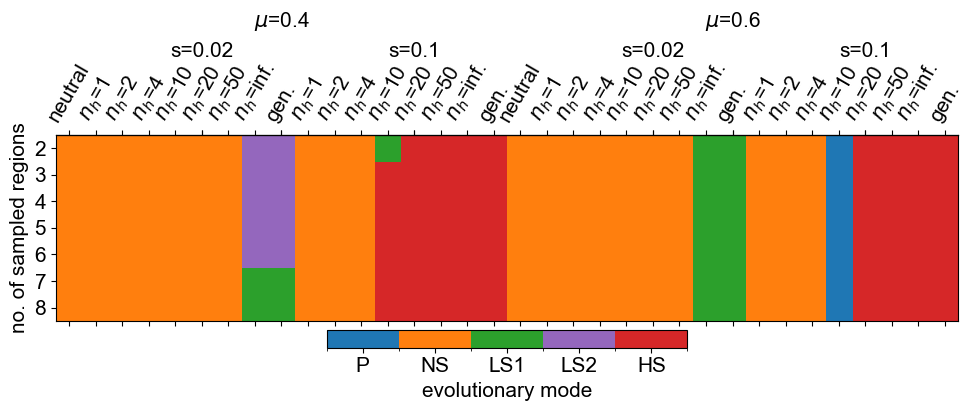

<Figure size 640x480 with 0 Axes>

In [43]:
level_mut = 70
level_sel = 50

default_colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#9467bd', '#d62728']
#group_names_in_order = ["Moderate plast. (high mut.)", "Neutral/high plast.", "Low selection or moderate plast", "High selection, low plast.", "Low selection, no plast., low mut."]

plast_labels_for_plot = ["neutral", 
                "$n_h$"+"=1", "$n_h$"+"=2", "$n_h$"+"=4", "$n_h$"+"=10", "$n_h$"+"=20","$n_h$"+"=50", "$n_h$"+"=inf.", "gen.",
               "$n_h$"+"=1", "$n_h$"+"=2", "$n_h$"+"=4", "$n_h$"+"=10", "$n_h$"+"=20","$n_h$"+"=50", "$n_h$"+"=inf.", "gen."]*2

ordered_labels = []
plast_levels = ["0.0", "0.5", "0.75", "0.9", "0.95", "0.98", "1.0", "gen"]
sel_levels = ["nosel", "lowsel", "highsel"]
mut_rates = [0.4, 0.6]
ordered_labels = []
for mut in mut_rates:
    for sel in sel_levels:
        for plast in plast_levels:
            if plast == "gen" or sel != "nosel":
                ordered_labels.append(plast + "_" + str(mut) + "_" + sel)

#assign clusters to numbers-- these are the modes which define a cluster
key_modes = ["0.9_0.6_highsel", "0.0_0.4_lowsel", "gen_0.6_lowsel",  "gen_0.4_lowsel", "gen_0.6_highsel"]

clustering_by_sample_numbers = np.zeros((len(ordered_labels), 7))

for no_samples in range(2, 9):
    clust_label_dict = np.load(base_filepath+"/clustering_labels_"+str(no_samples)+".npy", allow_pickle=True)
    clust_label_dict = clust_label_dict.item() 
    #reconstruct lists
    clust_labels = []
    for cluster_num in np.unique(list(clust_label_dict.values())):
        clust = []
        for (key, value) in clust_label_dict.items():
            if value == cluster_num:
                clust.append(key)
        clust_labels.append(clust)
    for cluster in clust_labels:
        for m, mode in enumerate(key_modes):
            if mode in cluster:
                for mode_ in cluster:
                    for loc, label in enumerate(ordered_labels):
                        if label==mode_:
                            clustering_by_sample_numbers[loc][no_samples-2] = m
                            #print(loc, label, mode_, m)
                            break
                break #so we can't reclassify once we've assigned a cluster

cmap = mcolors.ListedColormap(default_colors, name="default_map")
norm = mcolors.BoundaryNorm([i-0.5 for i in range(len(default_colors)+1)], cmap.N)


plt.rcParams['font.size'] = 15

fig, ax = plt.subplots(figsize=(10, 5))
im = ax.matshow(clustering_by_sample_numbers.T, cmap=cmap, norm=norm)
ax.set_xticks(range(len(ordered_labels)), labels=plast_labels_for_plot, rotation=60)
ax2 =ax.secondary_xaxis(location='top')
ax2.set_xticks([5, 13, 22, 30], labels=[ 's=0.02', 's=0.1',  's=0.02', 's=0.1'])
#ax2.spines['top'].set_position(('outward', level_sel))
ax2.tick_params(axis='x', which='major', pad=level_sel)
ax3 = ax.secondary_xaxis(location='top')
ax3.set_xticks([8, 25], labels=[ r'$\mu$'+"=0.4",  r'$\mu$'+"=0.6"])
ax3.tick_params(axis='x', which='major', pad=level_mut)
plt.xticks(rotation=60)
ax.set_yticks(range(0, 7), range(2, 9))
ax.set_ylabel("no. of sampled regions")
cbar = plt.colorbar(im, ticks=range(int(np.max(clustering_by_sample_numbers))+1), location='bottom', pad=0.02, shrink=0.4)
cbar.ax.set_xticklabels(labels=["P", "NS", "LS1","LS2", "HS"]) 
cbar.ax.set_xlabel("evolutionary mode")
plt.tight_layout()
fig.savefig(base_filepath+"/figs_0512"+"/"+savename+"_samples_"+"clustering_number.png", dpi=300)
plt.show()
plt.clf()
    

OK, upshot here is that at 2 samples the n_h=10 level at low mut rate gets clustered with low selection and later it's classified with high. Also low-selection categories merge at high sample number.

Plot the cumulative probability that an alteration will have been lost after n divisions, given heritability h.

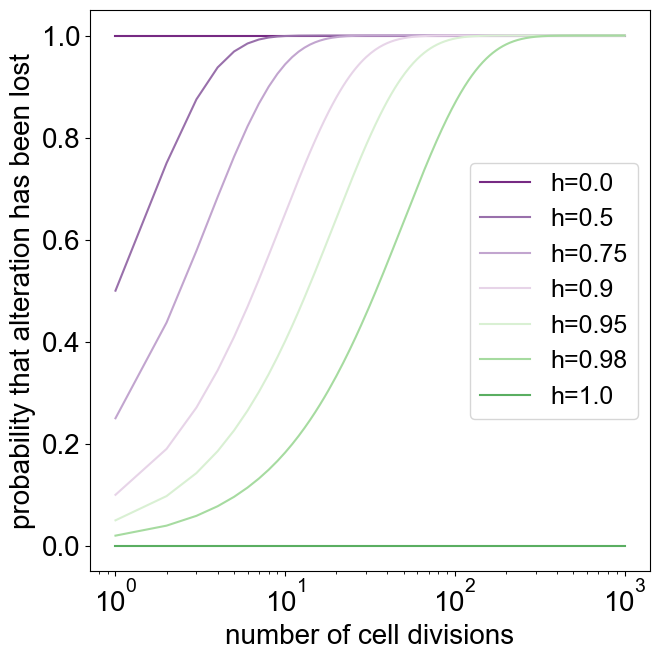

<Figure size 640x480 with 0 Axes>

In [7]:
def plot_prob_vs_duration(hs, colors, max_n=1000, savetitle="title"):
    ns = np.arange(1, max_n+1)
    fig, ax = plt.subplots(figsize=(7, 7))
    for h, color in zip(hs, colors):
        ps = 1-np.power(h, ns) #loss AT OR BEFORE n, i.e. 1 - prob it is inherited for n divisions
        ax.plot(ns, ps, label="h="+str(h), color=color)
        #ax.axvline(np.sum(ns*ps), linestyle='--', color=color)
        #print(np.sum(ps*ns))
    ax.set_xscale("log")
    #ax.set_xticks([1, 10, 100, 1000], labels=["1", "10", "100", "1000"])
    #plt.plot([-1], [0.05], '--', color='black', label='mean')
    plt.xlabel("number of cell divisions")
    plt.ylabel("probability that alteration has been lost", fontsize=20)
    plt.legend(fontsize=18)
    plt.tight_layout()
    plt.show()
    fig.savefig(base_filepath+"/figs_0512"+"/"+savetitle+".png", format="png", dpi=300)
    fig.savefig(base_filepath+"/figs_0512"+"/"+savetitle+".pdf", format="pdf", dpi=300)
    plt.clf()
    
div_color_list = ["#d73027", "#fc8d59", "#fee090", "#ffffbf", "#e0f3f8", "#91bfdb", "#4575b4"]
alt_color_list = ["#762a83", "#9970ab", "#c2a5cf", "#e7d4e8", "#d9f0d3", "#a6dba0", "#5aae61"]

hs = [0.0, 0.5, 0.75, 0.9, 0.95, 0.98, 1.0]
plot_prob_vs_duration(hs, alt_color_list, savetitle="cum_duration_comparison")
        


As before: add non-genetic alterations with varying heritability to weak genetic selection. How does the heritability of the alterations affect our abiility to distinguish the presence of non-genetic alterations? How does that change if we're trying to distinguish it from a) weak or b) strong genetic selection? Measure this using AUC.

In [83]:

#load this limited set of scenarios
#all overlay scenarios are run at 0.4 by default-- the mutation rate is not written into file names
#return two cohorts per overlay scenario- one mixed with weak, one with strong
def load_data_with_overlay_ind_cohort(no_samples, base_prefix="27Jul", overlay_prefix="1Aug"):
    base_file_names = [base_prefix+"_gen_0.4_lowsel", base_prefix+"_gen_0.4_highsel"] #baseline scenarios- weak + strong selecti
    base_labels = ["gen_0.4_lowsel", "gen_0.4_highsel"]
    overlay_labels, overlay_file_names = [], []
    plast_levels = ["0.0", "0.5", "0.75", "0.9", "0.95", "0.98", "1.0"]
    suffices = ["strength_1", "strength_2", "strength_5", "freq_10",  "freq_100",  "freq_1000"]
    for plast in plast_levels:
        for suffix in suffices:
            filename = overlay_prefix+"_"+plast+"_"+suffix+"_lowsel"
            label = plast+"_"+suffix+"_lowsel"
            overlay_file_names.append(filename)
            overlay_labels.append(label)
    #print(all_file_names)
    cohort_Xs_weak, cohort_ys_weak = [], [] 
    cohort_Xs_strong, cohort_ys_strong = [], [] #one set of Xs per label
    weak_stats, strong_stats = np.load(base_filepath+base_prefix+"_gen_0.4_lowsel_"+str(no_samples)+"_samples.npy", allow_pickle=True), np.load(base_filepath+base_prefix+"_gen_0.4_highsel_"+str(no_samples)+"_samples.npy", allow_pickle=True)
    weak_labels, strong_labels = np.tile("gen_0.4_lowsel", (len(weak_stats), 1)), np.tile("gen_0.4_highsel", (len(strong_stats), 1))
    for filename, label in zip(overlay_file_names, overlay_labels):
        stats = np.load(base_filepath+filename+"_"+str(no_samples)+"_samples.npy", allow_pickle=True)
        labels = np.tile(label, (len(stats), 1))
        cohort_Xs_weak.append(np.concatenate((stats, weak_stats)))
        cohort_ys_weak.append(np.concatenate((labels, weak_labels)))
        cohort_Xs_strong.append(np.concatenate((stats, strong_stats)))
        cohort_ys_strong.append(np.concatenate((labels, strong_labels)))
    #get a unique list of all the labels
    return cohort_Xs_weak, cohort_ys_weak, cohort_Xs_strong, cohort_ys_strong, overlay_labels

#take a cohort (one overlay scenario + an alternative, train a classifier, and return an ROC)
#this is done on an 80/20 test split
def get_binary_roc(Xs, ys, params, test_size=0.2, base_prefix="27Jul", overlay_prefix="1Aug"):
    all_labels_in_order = np.unique(ys, axis=0)
    X_train, X_test, y_train, y_test = train_test_split(Xs, ys, test_size=test_size)
    y_train_bin, y_test_bin = manual_label_conversion(y_train, all_labels_in_order), manual_label_conversion(y_test, all_labels_in_order)
    classifiers, assigned_outcomes, class_matrix, confusion_matrix, fprs, tprs, all_threshes = train_model_opt(X_train, X_test, y_train_bin, y_test_bin, all_labels_in_order, params)
    #both classifiers are attacking the same binary problem from opposite angles, so we will have two AUCs which should be the same-- average them and we're taking 2 repeats
    aucs = []
    for i in range(0, 2):
        aucs.append(np.trapz(y=tprs[i], x=fprs[i]))
    print(aucs)
    return np.average(aucs)
    
#put this together and get a list of AUROCs
def get_auroc_dicts(no_samples, params, base_prefix="27Jul", overlay_prefix="1Aug"):
    cohort_Xs_weak, cohort_ys_weak, cohort_Xs_strong, cohort_ys_strong, overlay_labels = load_data_with_overlay_ind_cohort(no_samples, base_prefix=base_prefix, overlay_prefix=overlay_prefix)
    weak_auroc_dict, strong_auroc_dict = {}, {}
    for ind_, cohort_label in enumerate(overlay_labels):
        Xs_weak, ys_weak, Xs_strong, ys_strong = cohort_Xs_weak[ind_], cohort_ys_weak[ind_], cohort_Xs_strong[ind_], cohort_ys_strong[ind_]
        weak_auc, strong_auc = get_binary_roc(Xs_weak, ys_weak, params, base_prefix=base_prefix, overlay_prefix=overlay_prefix), get_binary_roc(Xs_strong, ys_strong, params, base_prefix=base_prefix, overlay_prefix=overlay_prefix)
        weak_auroc_dict[cohort_label] = weak_auc
        strong_auroc_dict[cohort_label] = strong_auc
    return weak_auroc_dict, strong_auroc_dict


def return_auroc_matrices(no_samples, params = {'learning_rate': 0.2, 'max_depth': 3, 'subsample': 0.6, 'colsample_bytree': 0.8, 'min_child_weight': 1, 'reg_alpha': 0.1, 'reg_lambda': 1, 'gamma': 0.5, 'n_estimators': 100}, base_prefix="27Jul", overlay_prefix="1Aug"):
    #now get the aurocs
    weak_auroc_dict, strong_auroc_dict = get_auroc_dicts(no_samples, params, base_prefix=base_prefix, overlay_prefix=overlay_prefix)
    #now get 4 matrices
    plast_levels = ["0.0", "0.5", "0.75", "0.9", "0.95", "0.98", "1.0"]
    strength_suffices = ["strength_1", "strength_2", "strength_5"]
    freq_suffices = ["strength_1", "freq_10",  "freq_100",  "freq_1000"]
    w_strength_aurocs, s_strength_aurocs = np.zeros((len(plast_levels), len(strength_suffices))), np.zeros((len(plast_levels), len(strength_suffices)))
    w_freq_aurocs, s_freq_aurocs = np.zeros((len(plast_levels), len(freq_suffices))), np.zeros((len(plast_levels), len(freq_suffices)))
    #fill with values
    for m, plast in enumerate(plast_levels):
        strength_row, freq_row = [], []
        for s, suffix in enumerate(strength_suffices):
            label = plast+"_"+suffix+"_lowsel"
            w_strength_aurocs[m][s] = weak_auroc_dict[label]
            s_strength_aurocs[m][s] = strong_auroc_dict[label]
        for s, suffix in enumerate(freq_suffices):
            label = plast+"_"+suffix+"_lowsel"
            w_freq_aurocs[m][s] = weak_auroc_dict[label]
            s_freq_aurocs[m][s] = strong_auroc_dict[label]
    return w_strength_aurocs, s_strength_aurocs, w_freq_aurocs, s_freq_aurocs

    
for no_samples in [2, 8]:
    w_strength_aurocs, s_strength_aurocs, w_freq_aurocs, s_freq_aurocs = return_auroc_matrices(no_samples)
    np.save(base_filepath+"/figs_0512"+"/"+savename+"_"+str(no_samples)+"_strength_auroc_mat.npy", [w_strength_aurocs, s_strength_aurocs] )
    np.save(base_filepath+"/figs_0512"+"/"+savename+"_"+str(no_samples)+"_freq_auroc_mat.npy", [w_freq_aurocs, s_freq_aurocs])
    

[0.5118967013888889, 0.5113997395833334]
[0.9980583051017224, 0.9979868348703781]
[0.5123924412509475, 0.513884352671731]
[0.9987554944147002, 0.9987183141648491]
[0.4955560017808446, 0.49723391028234903]
[0.9974207722027222, 0.997455114769829]
[0.4961730875451682, 0.4943826975700872]
[0.99841420241566, 0.9984131611828404]
[0.47954661368074786, 0.47899451002554105]
[0.9988641538098005, 0.9988864650742508]
[0.49086758681311593, 0.49249608877276174]
[0.9987297214569942, 0.998737883889399]
[0.5025746219592373, 0.4981564760026298]
[0.9990196994783599, 0.9990975894176503]
[0.5120592469484683, 0.5128937464348915]
[0.9973727170696868, 0.9973941434547494]
[0.4898348506895052, 0.48869696084131553]
[0.9982504460314983, 0.9982672082252084]
[0.49635167837108085, 0.4990563539684763]
[0.9982343926620888, 0.9981445616406566]
[0.4734602802513986, 0.4695173400606787]
[0.9972429483840903, 0.997221019160659]
[0.5181375454147233, 0.5172398155067124]
[0.9986375869200198, 0.9986223132307824]
[0.4975255, 0.4

Now plot these as matrices.

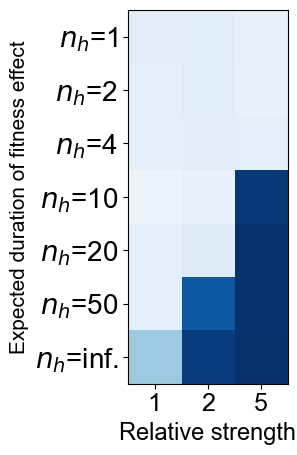

<Figure size 640x480 with 0 Axes>

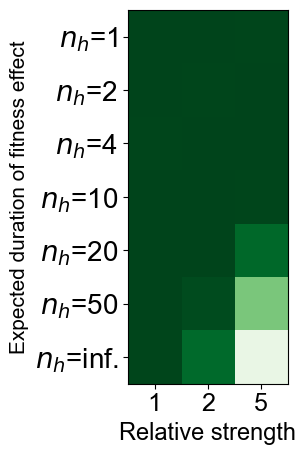

True


<Figure size 640x480 with 0 Axes>

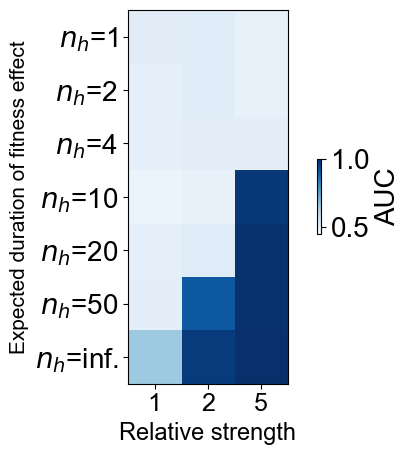

True


<Figure size 640x480 with 0 Axes>

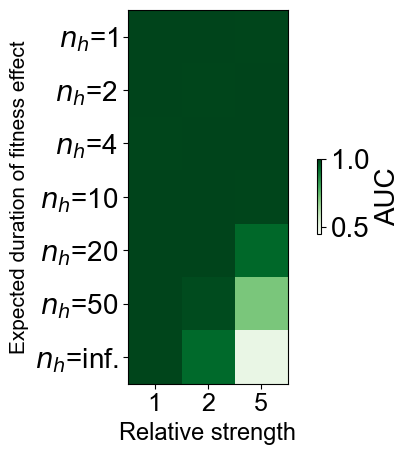

<Figure size 640x480 with 0 Axes>

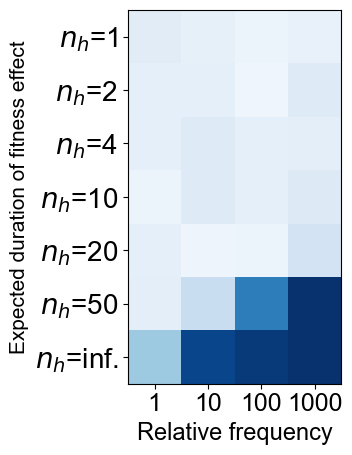

<Figure size 640x480 with 0 Axes>

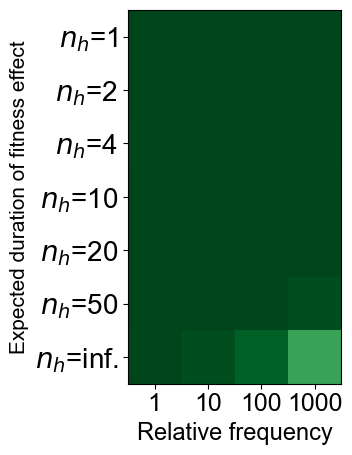

True


<Figure size 640x480 with 0 Axes>

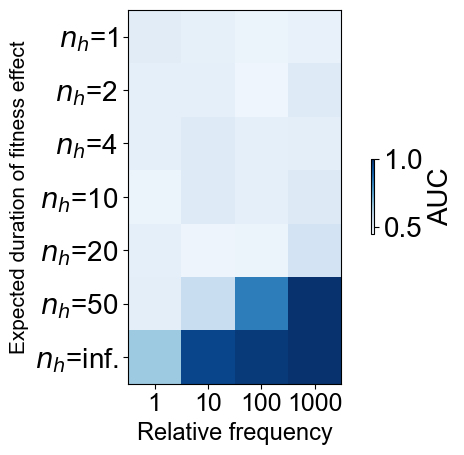

True


<Figure size 640x480 with 0 Axes>

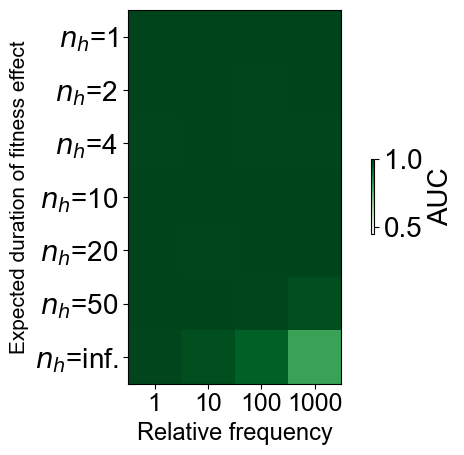

<Figure size 640x480 with 0 Axes>

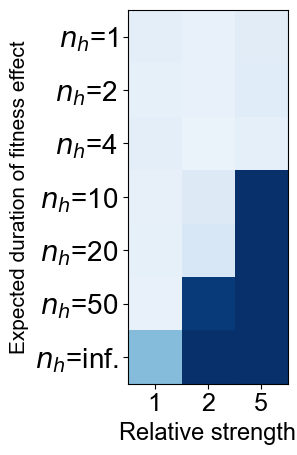

<Figure size 640x480 with 0 Axes>

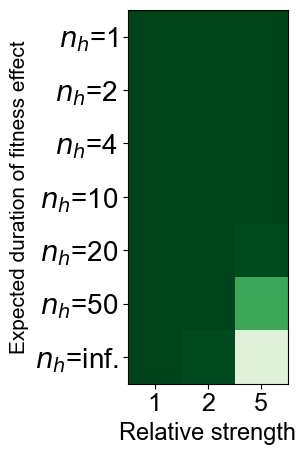

True


<Figure size 640x480 with 0 Axes>

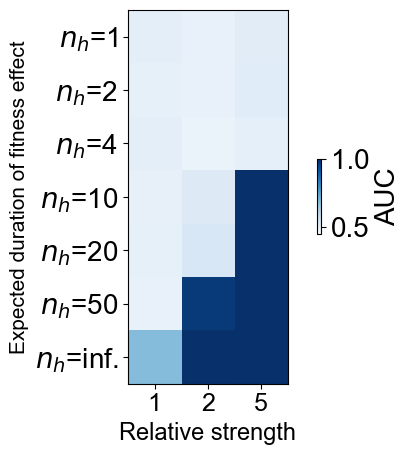

True


<Figure size 640x480 with 0 Axes>

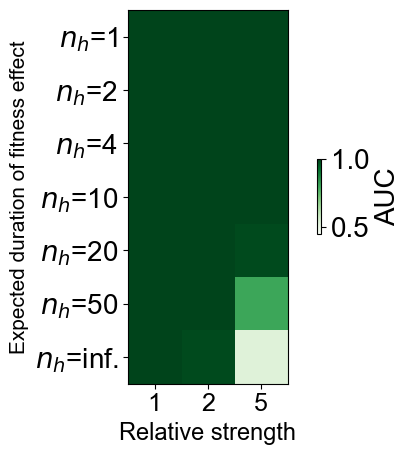

<Figure size 640x480 with 0 Axes>

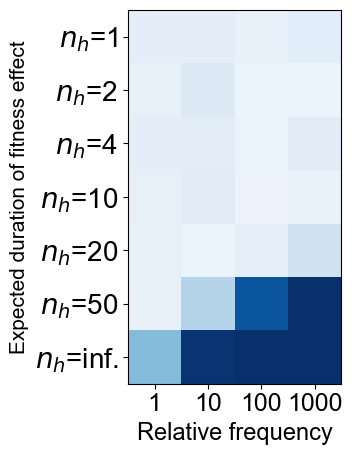

<Figure size 640x480 with 0 Axes>

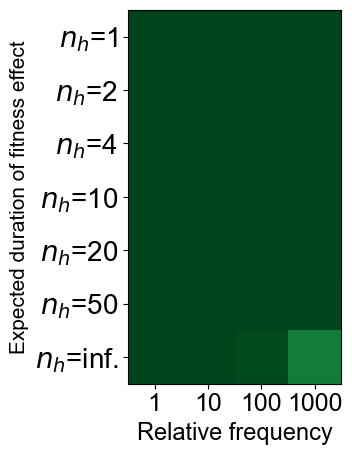

True


<Figure size 640x480 with 0 Axes>

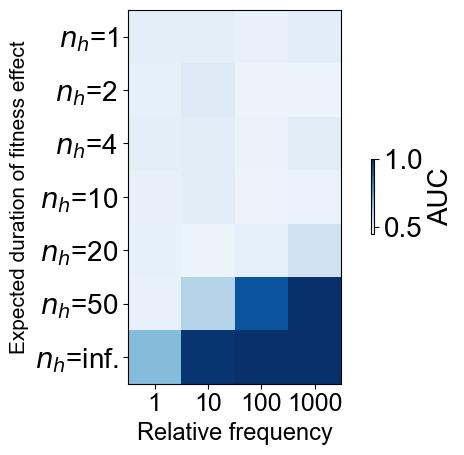

True


<Figure size 640x480 with 0 Axes>

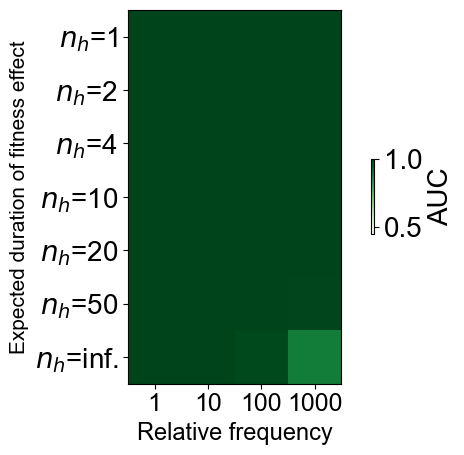

<Figure size 640x480 with 0 Axes>

In [84]:
def plot_auc_matrix(auc_mat, cmap, xlabel, xticks, save_title, with_colorbar=False):
    fig, ax = plt.subplots()
    plast_labels = ["$n_h$"+"=1", "$n_h$"+"=2", "$n_h$"+"=4", "$n_h$"+"=10", "$n_h$"+"=20","$n_h$"+"=50", "$n_h$"+"=inf."]
    im=ax.matshow(auc_mat, origin='lower', cmap=cmap, vmin=0.45, vmax=1)
    plt.xlabel(xlabel,  fontsize=17)
    ax.set_xticks(range(len(xticks)), labels=xticks, fontsize=18)
    ax.tick_params(top=False, labeltop=False, bottom=True, labelbottom=True)
    ax.set_ylabel("Expected duration of fitness effect", fontsize=15)
    ax.set_yticks(range(len(plast_labels)), labels=plast_labels, fontsize=20)
    filesave = base_filepath+"/figs_0512/"+savename+"_"+str(no_samples)+"_"+save_title
    if with_colorbar:
        cbar = plt.colorbar(im, pad=0.05, shrink=0.2, location="right")
        cbar.ax.set_ylabel("AUC", fontsize=20)
        for t in cbar.ax.get_yticklabels():
            t.set_fontsize(20)
        filesave += "_with_cbar"
        print("True")
    ax.invert_yaxis()
    plt.tight_layout()
    plt.show()
    fig.savefig(filesave+".png", format="png", dpi=300)
    fig.savefig(filesave+".pdf", format="pdf", dpi=300)
    plt.clf()

for no_samples in [2, 8]:
    savename="1Aug"
    [w_strength_aurocs, s_strength_aurocs] = np.load(base_filepath+"/figs_0512"+"/"+savename+"_"+str(no_samples)+"_strength_auroc_mat.npy", allow_pickle=True)
    [w_freq_aurocs, s_freq_aurocs] = np.load(base_filepath+"/figs_0512"+"/"+savename+"_"+str(no_samples)+"_freq_auroc_mat.npy", allow_pickle=True)
    plot_auc_matrix(w_strength_aurocs, mpl.cm.Blues, "Relative strength", [1, 2, 5], "weak_s", with_colorbar=False)
    plot_auc_matrix(s_strength_aurocs, mpl.cm.Greens, "Relative strength", [1, 2, 5], "strong_s", with_colorbar=False)
    plot_auc_matrix(w_strength_aurocs, mpl.cm.Blues, "Relative strength", [1, 2, 5], "weak_s", with_colorbar=True)
    plot_auc_matrix(s_strength_aurocs, mpl.cm.Greens, "Relative strength", [1, 2, 5], "strong_s", with_colorbar=True)
    plot_auc_matrix(w_freq_aurocs, mpl.cm.Blues, "Relative frequency", [1, 10, 100, 1000], "weak_f", with_colorbar=False)
    plot_auc_matrix(s_freq_aurocs, mpl.cm.Greens, "Relative frequency", [1, 10, 100, 1000], "strong_f", with_colorbar=False)
    plot_auc_matrix(w_freq_aurocs, mpl.cm.Blues, "Relative frequency", [1, 10, 100, 1000], "weak_f", with_colorbar=True)
    plot_auc_matrix(s_freq_aurocs, mpl.cm.Greens, "Relative frequency", [1, 10, 100, 1000], "strong_f", with_colorbar=True)
    
    

If we have weak genetic selection, then adding nongenetic selection doesn't help until it's 5x as strong at 90%. But then it starts to be harder to distinguish from strong selection. 

Now: plot the effect of additional non-genetic alterations on summary statistics.

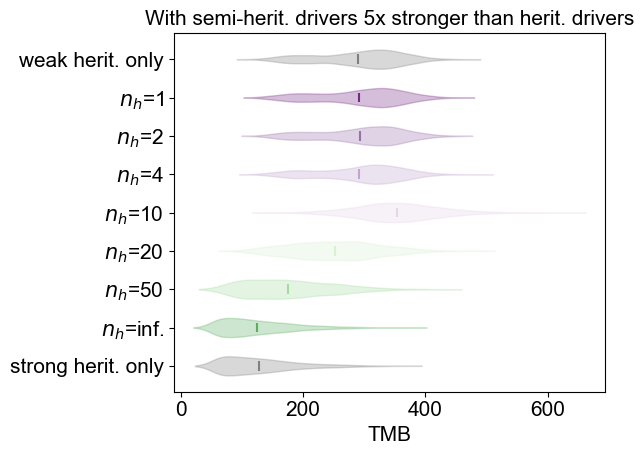

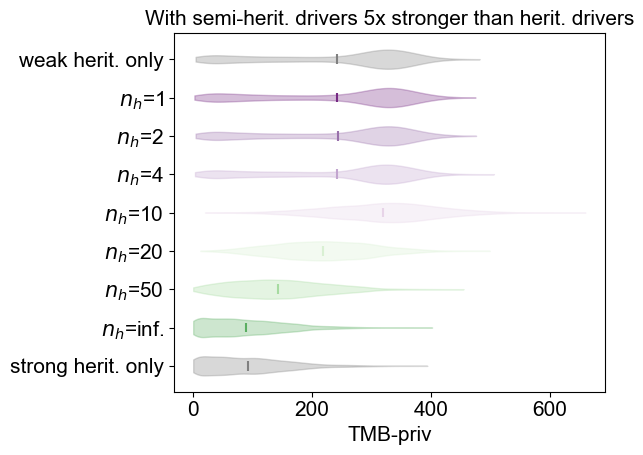

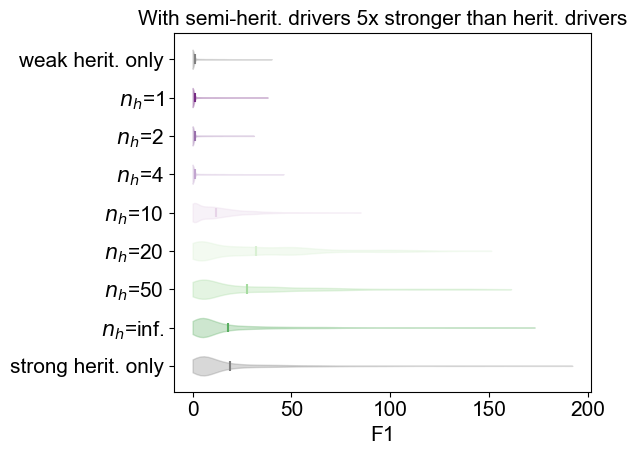

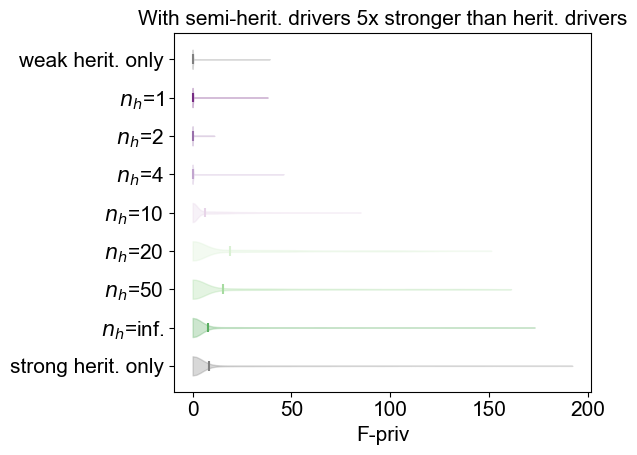

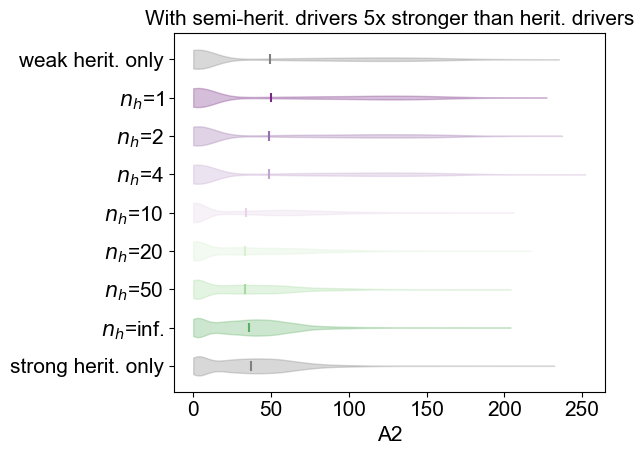

...

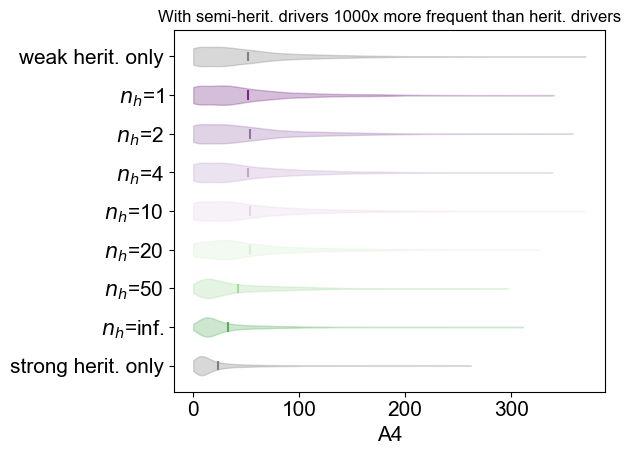

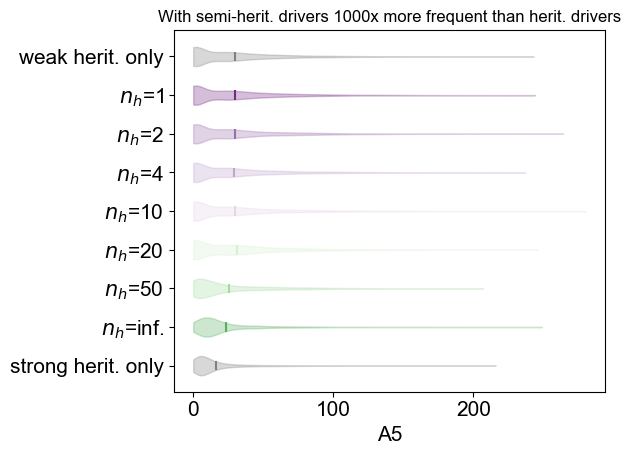

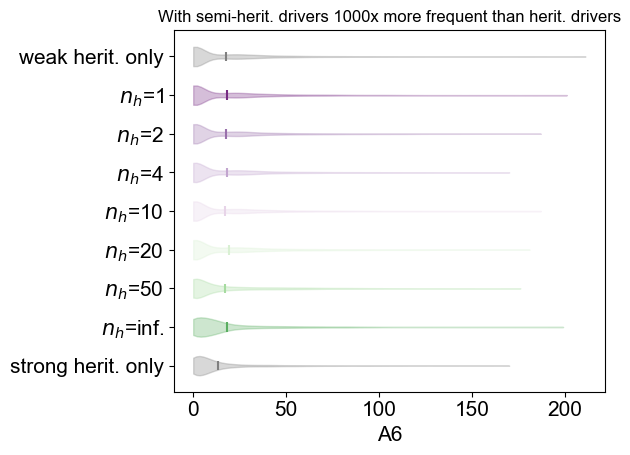

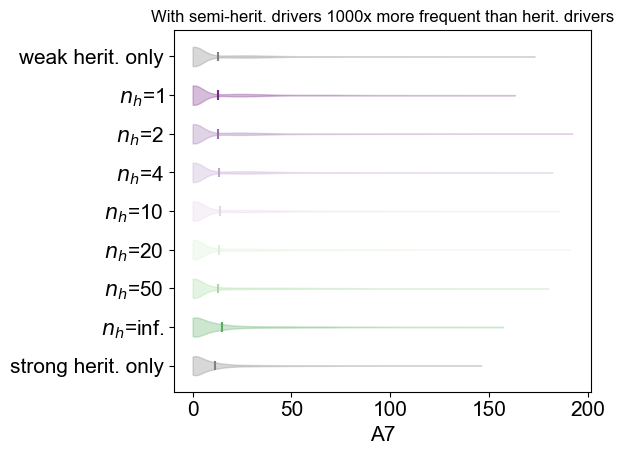

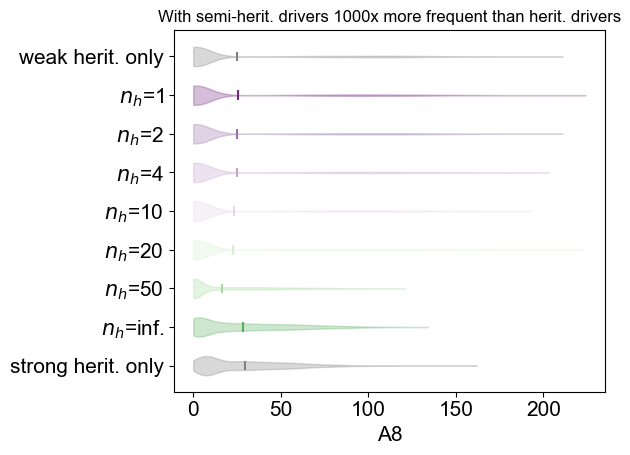

In [93]:
alt_color_list = ["#762a83", "#9970ab", "#c2a5cf", "#e7d4e8", "#d9f0d3", "#a6dba0", "#5aae61"]
        
def make_overlay_histograms_strength(no_samples, strength, base_prefix="27Jul", overlay_prefix="1Aug", color_list=alt_color_list):
    Xs, ys, all_labels_in_order = load_data_with_overlay(no_samples, base_prefix=base_prefix, overlay_prefix=overlay_prefix)
    stat_names = ["TMB", "TMB-priv"] + ["F"+str(s) for s in range(1, no_samples)]+ ["F-priv"] + ["A"+str(s) for s in range(2, no_samples+1)]
    for stat_ind, stat_name in enumerate(stat_names):
        fig, ax = plt.subplots()
        plast_levels = ["0.0", "0.5", "0.75", "0.9", "0.95", "0.98", "1.0"]
        plast_labels=["$n_h$"+"=1", "$n_h$"+"=2", "$n_h$"+"=4", "$n_h$"+"=10", "$n_h$"+"=20","$n_h$"+"=50", "$n_h$"+"=inf."]
        labels_for_display = ["weak herit. only"] +  plast_labels + ["strong herit. only"]
        stats_for_display, colors_for_display = [], ["grey"]+color_list+["grey"]
        for color_ind, label in enumerate(["gen_0.4_lowsel"]+[str(h)+"_strength_"+str(strength)+"_lowsel" for h in plast_levels]+["gen_0.4_highsel"]):
            indices = np.where(ys==label)[0]
            stats = Xs[indices]
            stats_for_display.append(stats)
        violin_parts = ax.violinplot([stats[:, stat_ind] for stats in stats_for_display], showmeans=True, showextrema=False, vert=False)
        ax.set_yticks(np.arange(1, len(labels_for_display)+1), labels=labels_for_display)
        for n_, pc in enumerate(violin_parts['bodies']):
            pc.set_color(colors_for_display[n_])
        violin_parts['cmeans'].set_colors(colors_for_display)
        plt.xlabel(stat_name)
        ax.invert_yaxis()
        #plt.ylabel("Expected duration of fitness effect", fontsize=12)
        plt.title("With semi-herit. drivers " +str(strength) + "x stronger than herit. drivers", fontsize=15)
        plt.tight_layout()
        fig.savefig(base_filepath+"/figs_0512"+"/"+savename+"_overlay_comparison_"+str(no_samples)+"_strength_"+str(strength)+"_"+stat_name+".png", dpi=300)
        plt.show()



        
def make_overlay_histograms_freq(no_samples, freq, base_prefix="27Jul", overlay_prefix="1Aug", color_list=alt_color_list):
    Xs, ys, all_labels_in_order = load_data_with_overlay(no_samples, base_prefix=base_prefix, overlay_prefix=overlay_prefix)
    stat_names = ["TMB", "TMB-priv"] + ["F"+str(s) for s in range(1, no_samples)]+ ["F-priv"] + ["A"+str(s) for s in range(2, no_samples+1)]
    for stat_ind, stat_name in enumerate(stat_names):
        fig, ax = plt.subplots()
        plast_levels = ["0.0", "0.5", "0.75", "0.9", "0.95", "0.98", "1.0"]
        plast_labels=["$n_h$"+"=1", "$n_h$"+"=2", "$n_h$"+"=4", "$n_h$"+"=10", "$n_h$"+"=20","$n_h$"+"=50", "$n_h$"+"=inf."]
        labels_for_display = ["weak herit. only"] + plast_labels + ["strong herit. only"]
        stats_for_display, colors_for_display = [], ["grey"]+color_list+["grey"]
        for color_ind, label in enumerate(["gen_0.4_lowsel"]+[str(h)+"_freq_"+str(freq)+"_lowsel" for h in plast_levels] + ["gen_0.4_highsel"]):
            indices = np.where(ys==label)[0]
            stats = Xs[indices]
            stats_for_display.append(stats)
        violin_parts = ax.violinplot([stats[:, stat_ind] for stats in stats_for_display], showmeans=True, showextrema=False, vert=False)
        ax.set_yticks(np.arange(1, len(labels_for_display)+1), labels=labels_for_display)
        for n_, pc in enumerate(violin_parts['bodies']):
            pc.set_color(colors_for_display[n_])
        violin_parts['cmeans'].set_colors(colors_for_display)
        plt.xlabel(stat_name)
        ax.invert_yaxis()
        #plt.ylabel("expected duration of fitness effect (in cell divisions)", fontsize=12)
        plt.title("With semi-herit. drivers " +str(freq) + "x more frequent than herit. drivers", fontsize=12)
        plt.tight_layout()
        fig.savefig(base_filepath+"/figs_0512"+"/"+savename+"_overlay_comparison_"+str(no_samples)+"_freq_"+str(freq)+"_"+stat_name+".png", dpi=300)
        plt.show()

make_overlay_histograms_strength(2, 5)
make_overlay_histograms_freq(2, 1000)
make_overlay_histograms_strength(8, 5)
make_overlay_histograms_freq(8, 1000)